# Style Transfer
In this notebook we will implement the style transfer technique from ["Image Style Transfer Using Convolutional Neural Networks" (Gatys et al., CVPR 2015)](http://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Gatys_Image_Style_Transfer_CVPR_2016_paper.pdf).

The general idea is to take two images, and produce a new image that reflects the content of one but the artistic "style" of the other. We will do this by first formulating a loss function that matches the content and style of each respective image in the feature space of a deep network, and then performing gradient descent on the pixels of the image itself.

The deep network we use as a feature extractor is [SqueezeNet](https://arxiv.org/abs/1602.07360), a small model that has been trained on ImageNet. You could use any network, but we chose SqueezeNet here for its small size and efficiency.

Here's an example of the images you'll be able to produce by the end of this notebook:

![caption](example_styletransfer.png)


## Setup

In [1]:
import torch
import torch.nn as nn
from torch.autograd import Variable
import torchvision
import torchvision.transforms as T
import PIL

import numpy as np

from scipy.misc import imread
from collections import namedtuple
import matplotlib.pyplot as plt

from cs231n.image_utils import SQUEEZENET_MEAN, SQUEEZENET_STD
%matplotlib inline

We provide you with some helper functions to deal with images, since for this part of the assignment we're dealing with real JPEGs, not CIFAR-10 data.

In [4]:
def preprocess(img, size=512):
    transform = T.Compose([
        T.Scale(size),
        T.ToTensor(),
        T.Normalize(mean=SQUEEZENET_MEAN.tolist(),
                    std=SQUEEZENET_STD.tolist()),
        T.Lambda(lambda x: x[None]),
    ])
    return transform(img)

def deprocess(img):
    transform = T.Compose([
        T.Lambda(lambda x: x[0]),
        T.Normalize(mean=[0, 0, 0], std=[1.0 / s for s in SQUEEZENET_STD.tolist()]),
        T.Normalize(mean=[-m for m in SQUEEZENET_MEAN.tolist()], std=[1, 1, 1]),
        T.Lambda(rescale),
        T.ToPILImage(),
    ])
    return transform(img)

def rescale(x):
    low, high = x.min(), x.max()
    x_rescaled = (x - low) / (high - low)
    return x_rescaled

def rel_error(x,y):
    return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

def features_from_img(imgpath, imgsize):
    img = preprocess(PIL.Image.open(imgpath), size=imgsize)
    img_var = Variable(img.type(dtype))
    return extract_features(img_var, cnn), img_var

# Older versions of scipy.misc.imresize yield different results
# from newer versions, so we check to make sure scipy is up to date.
def check_scipy():
    import scipy
    vnum = int(scipy.__version__.split('.')[1])
    #assert vnum >= 16, "You must install SciPy >= 0.16.0 to complete this notebook."

check_scipy()

answers = np.load('style-transfer-checks.npz')


As in the last assignment, we need to set the dtype to select either the CPU or the GPU

In [5]:
dtype = torch.FloatTensor
# Uncomment out the following line if you're on a machine with a GPU set up for PyTorch!
# dtype = torch.cuda.FloatTensor 

In [19]:
# Load the pre-trained SqueezeNet model.
cnn = torchvision.models.squeezenet1_1(pretrained=True).features
cnn.type(dtype)
# We don't want to train the model any further, so we don't want PyTorch to waste computation 
# computing gradients on parameters we're never going to update.
for param in cnn.parameters():
    param.requires_grad = False
    
# We provide this helper code which takes an image, a model (cnn), and returns a list of
# feature maps, one per layer.
def extract_features(x, cnn):
    """
    Use the CNN to extract features from the input image x.
    
    Inputs:
    - x: A PyTorch Variable of shape (N, C, H, W) holding a minibatch of images that
      will be fed to the CNN.
    - cnn: A PyTorch model that we will use to extract features.
    
    Returns:
    - features: A list of feature for the input images x extracted using the cnn model.
      features[i] is a PyTorch Variable of shape (N, C_i, H_i, W_i); recall that features
      from different layers of the network may have different numbers of channels (C_i) and
      spatial dimensions (H_i, W_i).
    """
    features = []
    prev_feat = x
    for i, module in enumerate(cnn._modules.values()):
        next_feat = module(prev_feat)
        features.append(next_feat)
        prev_feat = next_feat
    return features

## Computing Loss

We're going to compute the three components of our loss function now. The loss function is a weighted sum of three terms: content loss + style loss + total variation loss. You'll fill in the functions that compute these weighted terms below.

## Content loss
We can generate an image that reflects the content of one image and the style of another by incorporating both in our loss function. We want to penalize deviations from the content of the content image and deviations from the style of the style image. We can then use this hybrid loss function to perform gradient descent **not on the parameters** of the model, but instead **on the pixel values** of our original image.

Let's first write the content loss function. Content loss measures how much the feature map of the generated image differs from the feature map of the source image. We only care about the content representation of one layer of the network (say, layer $\ell$), that has feature maps $A^\ell \in \mathbb{R}^{1 \times C_\ell \times H_\ell \times W_\ell}$. $C_\ell$ is the number of filters/channels in layer $\ell$, $H_\ell$ and $W_\ell$ are the height and width. We will work with reshaped versions of these feature maps that combine all spatial positions into one dimension. Let $F^\ell \in \mathbb{R}^{N_\ell \times M_\ell}$ be the feature map for the current image and $P^\ell \in \mathbb{R}^{N_\ell \times M_\ell}$ be the feature map for the content source image where $M_\ell=H_\ell\times W_\ell$ is the number of elements in each feature map. Each row of $F^\ell$ or $P^\ell$ represents the vectorized activations of a particular filter, convolved over all positions of the image. Finally, let $w_c$ be the weight of the content loss term in the loss function.

Then the content loss is given by:

$L_c = w_c \times \sum_{i,j} (F_{ij}^{\ell} - P_{ij}^{\ell})^2$

In [26]:
def content_loss(content_weight, content_current, content_original):
    """
    Compute the content loss for style transfer.
    
    Inputs:
    - content_weight: Scalar giving the weighting for the content loss.
    - content_current: features of the current image; this is a PyTorch Tensor of shape
      (1, C_l, H_l, W_l).
    - content_target: features of the content image, Tensor with shape (1, C_l, H_l, W_l).
    
    Returns:
    - scalar content loss
    """
    loss = content_weight * (content_current - content_original).pow(2).sum()
    return loss


Test your content loss. You should see errors less than 0.001.

In [27]:
def content_loss_test(correct):
    content_image = 'styles/tubingen.jpg'
    image_size =  192
    content_layer = 3
    content_weight = 6e-2
    
    c_feats, content_img_var = features_from_img(content_image, image_size)
    
    bad_img = Variable(torch.zeros(*content_img_var.data.size()))
    feats = extract_features(bad_img, cnn)
    
    student_output = content_loss(content_weight, c_feats[content_layer], feats[content_layer]).data.numpy()
    error = rel_error(correct, student_output)
    print('Maximum error is {:.3f}'.format(error))

content_loss_test(answers['cl_out'])

[tensor([[[[1.4045e+00, 1.3991e+00, 1.4167e+00,  ..., 1.6555e+00,
           1.6585e+00, 1.6740e+00],
          [1.3914e+00, 1.4067e+00, 1.4585e+00,  ..., 1.6310e+00,
           1.6535e+00, 1.6837e+00],
          [1.4507e+00, 1.3805e+00, 1.2793e+00,  ..., 1.6648e+00,
           1.6551e+00, 1.7271e+00],
          ...,
          [8.6090e-01, 8.7313e-01, 9.2216e-01,  ..., 4.7700e-01,
           4.1022e-01, 4.2663e-01],
          [8.7173e-01, 8.8907e-01, 9.0449e-01,  ..., 5.4801e-01,
           5.0989e-01, 5.4026e-01],
          [8.6761e-01, 9.1816e-01, 9.0512e-01,  ..., 4.9316e-01,
           4.3647e-01, 5.8950e-01]],

         [[0.0000e+00, 0.0000e+00, 3.1706e-01,  ..., 8.0888e-02,
           7.1759e-02, 5.1046e-02],
          [8.3821e-02, 9.5538e-02, 2.4084e-01,  ..., 7.0147e-02,
           6.1948e-02, 7.1490e-02],
          [4.0346e-01, 6.6374e-02, 1.7668e-02,  ..., 8.7499e-02,
           4.5348e-02, 8.8522e-02],
          ...,
          [4.2776e-03, 0.0000e+00, 3.9169e-02,  ..., 5.996

## Style loss
Now we can tackle the style loss. For a given layer $\ell$, the style loss is defined as follows:

First, compute the Gram matrix G which represents the correlations between the responses of each filter, where F is as above. The Gram matrix is an approximation to the covariance matrix -- we want the activation statistics of our generated image to match the activation statistics of our style image, and matching the (approximate) covariance is one way to do that. There are a variety of ways you could do this, but the Gram matrix is nice because it's easy to compute and in practice shows good results.

Given a feature map $F^\ell$ of shape $(1, C_\ell, M_\ell)$, the Gram matrix has shape $(1, C_\ell, C_\ell)$ and its elements are given by:

$$G_{ij}^\ell  = \sum_k F^{\ell}_{ik} F^{\ell}_{jk}$$

Assuming $G^\ell$ is the Gram matrix from the feature map of the current image, $A^\ell$ is the Gram Matrix from the feature map of the source style image, and $w_\ell$ a scalar weight term, then the style loss for the layer $\ell$ is simply the weighted Euclidean distance between the two Gram matrices:

$$L_s^\ell = w_\ell \sum_{i, j} \left(G^\ell_{ij} - A^\ell_{ij}\right)^2$$

In practice we usually compute the style loss at a set of layers $\mathcal{L}$ rather than just a single layer $\ell$; then the total style loss is the sum of style losses at each layer:

$$L_s = \sum_{\ell \in \mathcal{L}} L_s^\ell$$

Begin by implementing the Gram matrix computation below:

In [34]:
def gram_matrix(features, normalize=True):
    """
    Compute the Gram matrix from features.
    
    Inputs:
    - features: PyTorch Variable of shape (N, C, H, W) giving features for
      a batch of N images.
    - normalize: optional, whether to normalize the Gram matrix
        If True, divide the Gram matrix by the number of neurons (H * W * C)
    
    Returns:
    - gram: PyTorch Variable of shape (N, C, C) giving the
      (optionally normalized) Gram matrices for the N input images.
    """
    N, C, H, W = features.shape
    features = features.reshape((N, C, H * W))
    gram = torch.zeros((N, C, C))
    #print(gram[0].shape)
    #print(torch.dot(features[0], features[0].T).shape)
    for i in range(N):
        gram[i] += torch.mm(features[i], features[i].T)
    if normalize == True:
        gram /= (H * W * C)
    return gram


Test your Gram matrix code. You should see errors less than 0.001.

In [35]:
def gram_matrix_test(correct):
    style_image = 'styles/starry_night.jpg'
    style_size = 192
    feats, _ = features_from_img(style_image, style_size)
    student_output = gram_matrix(feats[5].clone()).data.numpy()
    error = rel_error(correct, student_output)
    print('Maximum error is {:.3f}'.format(error))
    
gram_matrix_test(answers['gm_out'])

[tensor([[[[1.8166e+00, 1.6308e+00, 1.4569e+00,  ..., 2.1904e+00,
           1.9603e+00, 8.5170e-01],
          [1.8397e+00, 1.8747e+00, 1.7888e+00,  ..., 2.1118e+00,
           1.8741e+00, 7.8125e-01],
          [2.1174e+00, 2.1603e+00, 2.0022e+00,  ..., 2.0642e+00,
           1.8331e+00, 8.8170e-01],
          ...,
          [9.5129e-01, 1.0966e+00, 8.0272e-01,  ..., 6.2065e-01,
           9.8249e-01, 9.6127e-01],
          [1.3335e+00, 1.2939e+00, 8.7501e-01,  ..., 5.0965e-01,
           7.3079e-01, 9.7331e-01],
          [1.1771e+00, 1.0647e+00, 5.6696e-01,  ..., 6.7878e-01,
           7.6863e-01, 1.0628e+00]],

         [[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           1.3692e-01, 0.0000e+00],
          [1.9428e-01, 1.8554e-01, 1.6587e-02,  ..., 4.5677e-01,
           5.4984e-01, 1.7399e-01],
          [4.0195e-02, 0.0000e+00, 5.5998e-01,  ..., 3.0969e-01,
           9.5841e-02, 0.0000e+00],
          ...,
          [0.0000e+00, 1.5169e-01, 0.0000e+00,  ..., 0.000

Next, implement the style loss:

In [44]:
# Now put it together in the style_loss function...
def style_loss(feats, style_layers, style_targets, style_weights):
    """
    Computes the style loss at a set of layers.
    
    Inputs:
    - feats: list of the features at every layer of the current image, as produced by
      the extract_features function.
    - style_layers: List of layer indices into feats giving the layers to include in the
      style loss.
    - style_targets: List of the same length as style_layers, where style_targets[i] is
      a PyTorch Variable giving the Gram matrix the source style image computed at
      layer style_layers[i].
    - style_weights: List of the same length as style_layers, where style_weights[i]
      is a scalar giving the weight for the style loss at layer style_layers[i].
      
    Returns:
    - style_loss: A PyTorch Variable holding a scalar giving the style loss.
    """
    # Hint: you can do this with one for loop over the style layers, and should
    # not be very much code (~5 lines). You will need to use your gram_matrix function.
    loss=feats[0].new_zeros((1))
    for i in range(len(style_weights)):
        t=gram_matrix(feats[style_layers[i]])
        loss+=style_weights[i]*torch.sum((t-style_targets[i])**2)
    return loss

Test your style loss implementation. The error should be less than 0.001.

In [45]:
def style_loss_test(correct):
    content_image = 'styles/tubingen.jpg'
    style_image = 'styles/starry_night.jpg'
    image_size =  192
    style_size = 192
    style_layers = [1, 4, 6, 7]
    style_weights = [300000, 1000, 15, 3]
    
    c_feats, _ = features_from_img(content_image, image_size)    
    feats, _ = features_from_img(style_image, style_size)
    style_targets = []
    for idx in style_layers:
        style_targets.append(gram_matrix(feats[idx].clone()))
    
    student_output = style_loss(c_feats, style_layers, style_targets, style_weights).data.numpy()
    error = rel_error(correct, student_output)
    print('Error is {:.3f}'.format(error))

    
style_loss_test(answers['sl_out'])

[tensor([[[[1.4045e+00, 1.3991e+00, 1.4167e+00,  ..., 1.6555e+00,
           1.6585e+00, 1.6740e+00],
          [1.3914e+00, 1.4067e+00, 1.4585e+00,  ..., 1.6310e+00,
           1.6535e+00, 1.6837e+00],
          [1.4507e+00, 1.3805e+00, 1.2793e+00,  ..., 1.6648e+00,
           1.6551e+00, 1.7271e+00],
          ...,
          [8.6090e-01, 8.7313e-01, 9.2216e-01,  ..., 4.7700e-01,
           4.1022e-01, 4.2663e-01],
          [8.7173e-01, 8.8907e-01, 9.0449e-01,  ..., 5.4801e-01,
           5.0989e-01, 5.4026e-01],
          [8.6761e-01, 9.1816e-01, 9.0512e-01,  ..., 4.9316e-01,
           4.3647e-01, 5.8950e-01]],

         [[0.0000e+00, 0.0000e+00, 3.1706e-01,  ..., 8.0888e-02,
           7.1759e-02, 5.1046e-02],
          [8.3821e-02, 9.5538e-02, 2.4084e-01,  ..., 7.0147e-02,
           6.1948e-02, 7.1490e-02],
          [4.0346e-01, 6.6374e-02, 1.7668e-02,  ..., 8.7499e-02,
           4.5348e-02, 8.8522e-02],
          ...,
          [4.2776e-03, 0.0000e+00, 3.9169e-02,  ..., 5.996

## Total-variation regularization
It turns out that it's helpful to also encourage smoothness in the image. We can do this by adding another term to our loss that penalizes wiggles or "total variation" in the pixel values. 

You can compute the "total variation" as the sum of the squares of differences in the pixel values for all pairs of pixels that are next to each other (horizontally or vertically). Here we sum the total-variation regualarization for each of the 3 input channels (RGB), and weight the total summed loss by the total variation weight, $w_t$:

$L_{tv} = w_t \times \sum_{c=1}^3\sum_{i=1}^{H-1} \sum_{j=1}^{W-1} \left( (x_{i,j+1, c} - x_{i,j,c})^2 + (x_{i+1, j,c} - x_{i,j,c})^2  \right)$

In the next cell, fill in the definition for the TV loss term. To receive full credit, your implementation should not have any loops.

In [48]:
def tv_loss(img, tv_weight):
    """
    Compute total variation loss.
    
    Inputs:
    - img: PyTorch Variable of shape (1, 3, H, W) holding an input image.
    - tv_weight: Scalar giving the weight w_t to use for the TV loss.
    
    Returns:
    - loss: PyTorch Variable holding a scalar giving the total variation loss
      for img weighted by tv_weight.
    """
    # Your implementation should be vectorized and not require any loops!
    loss = torch.zeros(1)
    loss += torch.sum((img[:, :, 0 : -1, :] - img[:, :, 1 : , :]).pow(2))
    loss += torch.sum((img[:, :, :, 0 : -1] - img[:, :, :, 1 : ]).pow(2))
    loss *= tv_weight
    return loss


Test your TV loss implementation. Error should be less  than 0.001.

In [49]:
def tv_loss_test(correct):
    content_image = 'styles/tubingen.jpg'
    image_size =  192
    tv_weight = 2e-2

    content_img = preprocess(PIL.Image.open(content_image), size=image_size)
    content_img_var = Variable(content_img.type(dtype))
    
    student_output = tv_loss(content_img_var, tv_weight).data.numpy()
    error = rel_error(correct, student_output)
    print('Error is {:.3f}'.format(error))
    
tv_loss_test(answers['tv_out'])

Error is 0.000


Now we're ready to string it all together (you shouldn't have to modify this function):

In [50]:
def style_transfer(content_image, style_image, image_size, style_size, content_layer, content_weight,
                   style_layers, style_weights, tv_weight, init_random = False):
    """
    Run style transfer!
    
    Inputs:
    - content_image: filename of content image
    - style_image: filename of style image
    - image_size: size of smallest image dimension (used for content loss and generated image)
    - style_size: size of smallest style image dimension
    - content_layer: layer to use for content loss
    - content_weight: weighting on content loss
    - style_layers: list of layers to use for style loss
    - style_weights: list of weights to use for each layer in style_layers
    - tv_weight: weight of total variation regularization term
    - init_random: initialize the starting image to uniform random noise
    """
    
    # Extract features for the content image
    content_img = preprocess(PIL.Image.open(content_image), size=image_size)
    content_img_var = Variable(content_img.type(dtype))
    feats = extract_features(content_img_var, cnn)
    content_target = feats[content_layer].clone()

    # Extract features for the style image
    style_img = preprocess(PIL.Image.open(style_image), size=style_size)
    style_img_var = Variable(style_img.type(dtype))
    feats = extract_features(style_img_var, cnn)
    style_targets = []
    for idx in style_layers:
        style_targets.append(gram_matrix(feats[idx].clone()))

    # Initialize output image to content image or nois
    if init_random:
        img = torch.Tensor(content_img.size()).uniform_(0, 1)
    else:
        img = content_img.clone().type(dtype)

    # We do want the gradient computed on our image!
    img_var = Variable(img, requires_grad=True)

    # Set up optimization hyperparameters
    initial_lr = 3.0
    decayed_lr = 0.1
    decay_lr_at = 180

    # Note that we are optimizing the pixel values of the image by passing
    # in the img_var Torch variable, whose requires_grad flag is set to True
    optimizer = torch.optim.Adam([img_var], lr=initial_lr)
    
    f, axarr = plt.subplots(1,2)
    axarr[0].axis('off')
    axarr[1].axis('off')
    axarr[0].set_title('Content Source Img.')
    axarr[1].set_title('Style Source Img.')
    axarr[0].imshow(deprocess(content_img.cpu()))
    axarr[1].imshow(deprocess(style_img.cpu()))
    plt.show()
    plt.figure()
    
    for t in range(200):
        if t < 190:
            img.clamp_(-1.5, 1.5)
        optimizer.zero_grad()

        feats = extract_features(img_var, cnn)
        
        # Compute loss
        c_loss = content_loss(content_weight, feats[content_layer], content_target)
        s_loss = style_loss(feats, style_layers, style_targets, style_weights)
        t_loss = tv_loss(img_var, tv_weight) 
        loss = c_loss + s_loss + t_loss
        
        loss.backward()

        # Perform gradient descents on our image values
        if t == decay_lr_at:
            optimizer = torch.optim.Adam([img_var], lr=decayed_lr)
        optimizer.step()

        if t % 100 == 0:
            print('Iteration {}'.format(t))
            plt.axis('off')
            plt.imshow(deprocess(img.cpu()))
            plt.show()
    print('Iteration {}'.format(t))
    plt.axis('off')
    plt.imshow(deprocess(img.cpu()))
    plt.show()

## Generate some pretty pictures!

Try out `style_transfer` on the three different parameter sets below. Make sure to run all three cells. Feel free to add your own, but make sure to include the results of style transfer on the third parameter set (starry night) in your submitted notebook.

* The `content_image` is the filename of content image.
* The `style_image` is the filename of style image.
* The `image_size` is the size of smallest image dimension of the content image (used for content loss and generated image).
* The `style_size` is the size of smallest style image dimension.
* The `content_layer` specifies which layer to use for content loss.
* The `content_weight` gives weighting on content loss in the overall loss function. Increasing the value of this parameter will make the final image look more realistic (closer to the original content).
* `style_layers` specifies a list of which layers to use for style loss. 
* `style_weights` specifies a list of weights to use for each layer in style_layers (each of which will contribute a term to the overall style loss). We generally use higher weights for the earlier style layers because they describe more local/smaller scale features, which are more important to texture than features over larger receptive fields. In general, increasing these weights will make the resulting image look less like the original content and more distorted towards the appearance of the style image.
* `tv_weight` specifies the weighting of total variation regularization in the overall loss function. Increasing this value makes the resulting image look smoother and less jagged, at the cost of lower fidelity to style and content. 

Below the next three cells of code (in which you shouldn't change the hyperparameters), feel free to copy and paste the parameters to play around them and see how the resulting image changes. 

[tensor([[[[1.4045e+00, 1.3991e+00, 1.4167e+00,  ..., 1.6555e+00,
           1.6585e+00, 1.6740e+00],
          [1.3914e+00, 1.4067e+00, 1.4585e+00,  ..., 1.6310e+00,
           1.6535e+00, 1.6837e+00],
          [1.4507e+00, 1.3805e+00, 1.2793e+00,  ..., 1.6648e+00,
           1.6551e+00, 1.7271e+00],
          ...,
          [8.6090e-01, 8.7313e-01, 9.2216e-01,  ..., 4.7700e-01,
           4.1022e-01, 4.2663e-01],
          [8.7173e-01, 8.8907e-01, 9.0449e-01,  ..., 5.4801e-01,
           5.0989e-01, 5.4026e-01],
          [8.6761e-01, 9.1816e-01, 9.0512e-01,  ..., 4.9316e-01,
           4.3647e-01, 5.8950e-01]],

         [[0.0000e+00, 0.0000e+00, 3.1706e-01,  ..., 8.0888e-02,
           7.1759e-02, 5.1046e-02],
          [8.3821e-02, 9.5538e-02, 2.4084e-01,  ..., 7.0147e-02,
           6.1948e-02, 7.1490e-02],
          [4.0346e-01, 6.6374e-02, 1.7668e-02,  ..., 8.7499e-02,
           4.5348e-02, 8.8522e-02],
          ...,
          [4.2776e-03, 0.0000e+00, 3.9169e-02,  ..., 5.996

[tensor([[[[1.8669, 1.7054, 2.2354,  ..., 1.7494, 1.8019, 1.8607],
          [1.7567, 1.3795, 1.5092,  ..., 1.7354, 1.7777, 1.8283],
          [2.3645, 1.9904, 1.7242,  ..., 1.6800, 1.7272, 1.7770],
          ...,
          [0.0840, 0.0000, 0.0000,  ..., 0.4876, 0.3692, 0.1293],
          [0.1329, 0.0000, 0.0242,  ..., 0.5695, 0.4657, 0.1898],
          [0.0000, 0.0000, 0.0000,  ..., 0.5475, 0.4662, 0.2811]],

         [[0.1561, 0.0374, 0.0000,  ..., 0.0000, 0.1082, 0.0000],
          [0.0000, 0.2247, 0.5578,  ..., 0.0352, 0.0000, 0.0383],
          [0.0331, 0.0000, 0.0000,  ..., 0.0448, 0.0558, 0.0000],
          ...,
          [0.0874, 0.1399, 0.0000,  ..., 0.1083, 0.1713, 0.0661],
          [0.0000, 0.0000, 0.0000,  ..., 0.2995, 0.0000, 0.1117],
          [0.0000, 0.0000, 0.6651,  ..., 0.0000, 0.2487, 0.0000]],

         [[0.1308, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.6191, 1.8678,  ..., 0.0936, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

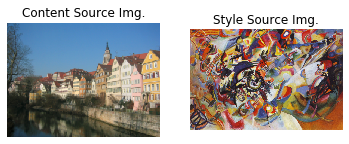

[tensor([[[[1.4045e+00, 1.3991e+00, 1.4167e+00,  ..., 1.6555e+00,
           1.6585e+00, 1.6740e+00],
          [1.3914e+00, 1.4067e+00, 1.4585e+00,  ..., 1.6310e+00,
           1.6535e+00, 1.6837e+00],
          [1.4507e+00, 1.3805e+00, 1.2793e+00,  ..., 1.6648e+00,
           1.6551e+00, 1.7271e+00],
          ...,
          [8.0056e-01, 7.8659e-01, 7.9820e-01,  ..., 4.7700e-01,
           4.1022e-01, 4.2663e-01],
          [7.8924e-01, 7.7921e-01, 8.2491e-01,  ..., 5.4801e-01,
           5.0989e-01, 5.4026e-01],
          [7.9524e-01, 7.7917e-01, 8.5735e-01,  ..., 4.9316e-01,
           4.3647e-01, 5.8950e-01]],

         [[0.0000e+00, 0.0000e+00, 3.1706e-01,  ..., 8.0888e-02,
           7.1759e-02, 5.1046e-02],
          [8.3821e-02, 9.5538e-02, 2.4084e-01,  ..., 7.0147e-02,
           6.1948e-02, 7.1490e-02],
          [4.0346e-01, 6.6374e-02, 1.7668e-02,  ..., 8.7499e-02,
           4.5348e-02, 8.8522e-02],
          ...,
          [1.7013e-02, 8.3940e-04, 8.9472e-03,  ..., 5.996

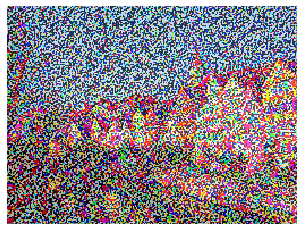

[tensor([[[[1.6155, 2.2818, 4.1760,  ..., 2.6208, 0.4455, 0.2881],
          [2.6002, 3.7219, 2.0919,  ..., 0.6210, 0.5360, 1.7124],
          [3.2343, 0.0000, 0.4470,  ..., 0.0000, 0.8434, 2.7256],
          ...,
          [1.6546, 1.1693, 3.7879,  ..., 0.1827, 0.0000, 2.8836],
          [5.6233, 4.8003, 4.4483,  ..., 0.0000, 0.0414, 4.4731],
          [5.7138, 5.8228, 3.5984,  ..., 3.2474, 0.0000, 6.0490]],

         [[0.9325, 0.0000, 1.3063,  ..., 2.9371, 1.6354, 0.0000],
          [1.1541, 0.0000, 3.5089,  ..., 0.0000, 0.0000, 0.4643],
          [4.3698, 0.0000, 1.3792,  ..., 0.2911, 0.0000, 1.4351],
          ...,
          [4.7656, 0.0000, 0.0000,  ..., 0.0000, 3.4519, 0.0000],
          [0.0000, 0.0801, 1.6303,  ..., 0.8335, 0.0000, 0.0000],
          [0.0000, 0.0000, 2.9055,  ..., 2.8692, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 6.6443, 1.8705],
          [0.0000, 2.9255, 2.2461,  ..., 0.0000, 0.0000, 0.0000],
          [5.4013, 1.2296, 0.0000,  ..., 

[tensor([[[[0.2551, 0.0000, 0.0000,  ..., 0.0000, 0.9647, 2.0718],
          [0.0000, 1.4764, 0.0000,  ..., 0.8879, 1.8805, 0.6101],
          [0.0000, 2.0866, 4.1785,  ..., 2.7300, 0.0000, 0.0000],
          ...,
          [0.0000, 0.1774, 0.3496,  ..., 3.5638, 5.2097, 1.4273],
          [2.9832, 0.0000, 0.0000,  ..., 2.6137, 2.5317, 0.0000],
          [1.6460, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.3568, 0.0000,  ..., 0.0000, 3.7674, 0.0000],
          [0.0000, 0.2771, 1.1392,  ..., 4.2628, 0.0000, 1.7063],
          [0.0000, 0.7767, 0.0000,  ..., 2.0435, 1.7499, 0.0000],
          ...,
          [0.0000, 3.1026, 0.0000,  ..., 0.0000, 0.0000, 5.4559],
          [2.8899, 0.0000, 0.2198,  ..., 0.0000, 1.1852, 0.0441],
          [0.0000, 0.6546, 0.0000,  ..., 0.0000, 0.0000, 0.4037]],

         [[3.9068, 0.0000, 1.9167,  ..., 0.8445, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.9528, 4.2056, 1.8807],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.0072, 0.0000, 0.0000,  ..., 0.0000, 0.0627, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.2705, 0.0000],
          [0.0000, 2.3517, 4.0729,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 3.1332, 1.8469],
          [3.1519, 0.0000, 0.0000,  ..., 1.2701, 0.9090, 1.9699],
          [2.0556, 0.0000, 0.0000,  ..., 0.0000, 0.4231, 0.0000]],

         [[0.0000, 1.4399, 0.0000,  ..., 0.0000, 2.2755, 0.0000],
          [1.5565, 1.5536, 0.0000,  ..., 2.7440, 0.7738, 0.0000],
          [0.0000, 0.8364, 0.0000,  ..., 0.4378, 2.2390, 0.0000],
          ...,
          [1.0116, 1.5933, 0.0000,  ..., 0.0000, 0.0000, 2.4266],
          [0.8283, 0.0000, 0.3128,  ..., 0.5085, 1.1152, 0.0000],
          [0.7808, 0.9880, 0.0000,  ..., 0.0000, 0.0000, 0.7868]],

         [[0.0000, 0.0000, 1.5244,  ..., 0.1538, 5.2944, 0.0000],
          [1.8916, 0.0000, 1.4957,  ..., 1.7256, 3.9845, 3.9670],
          [0.0000, 2.1400, 1.1934,  ..., 

[tensor([[[[0.0000, 0.0000, 1.2105,  ..., 0.0000, 0.3531, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.7682, 0.4305,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 2.0225, 2.5034],
          [1.0579, 0.0000, 0.0000,  ..., 1.5972, 0.3681, 4.5563],
          [0.1184, 0.0000, 0.8539,  ..., 0.0000, 0.7959, 0.0000]],

         [[0.0000, 2.0181, 0.0000,  ..., 0.0000, 1.0836, 0.1831],
          [2.6872, 0.1495, 1.6204,  ..., 2.0978, 0.0000, 0.0000],
          [3.0528, 0.3222, 0.5367,  ..., 0.0000, 1.4308, 0.0000],
          ...,
          [3.6008, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.5811,  ..., 2.0151, 1.2070, 0.0000],
          [0.6624, 1.2947, 0.5847,  ..., 0.0000, 0.0000, 1.1710]],

         [[0.0000, 0.1652, 1.0252,  ..., 0.6137, 6.1577, 0.2777],
          [2.1111, 0.6160, 2.7747,  ..., 2.3373, 2.9098, 1.5914],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[5.9771e-02, 0.0000e+00, 2.2033e+00,  ..., 0.0000e+00,
           3.0958e-01, 0.0000e+00],
          [0.0000e+00, 1.0746e+00, 9.1126e-04,  ..., 0.0000e+00,
           0.0000e+00, 7.1968e-03],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 7.0482e-02],
          ...,
          [0.0000e+00, 1.4851e-02, 0.0000e+00,  ..., 1.8310e-01,
           1.7497e+00, 1.9818e+00],
          [0.0000e+00, 0.0000e+00, 6.3093e-02,  ..., 2.4293e+00,
           1.0811e+00, 5.1281e+00],
          [0.0000e+00, 0.0000e+00, 1.3033e+00,  ..., 0.0000e+00,
           8.0327e-01, 1.7219e+00]],

         [[0.0000e+00, 2.1215e+00, 0.0000e+00,  ..., 4.7723e-01,
           0.0000e+00, 2.7970e-01],
          [1.9410e+00, 7.9935e-01, 1.5805e+00,  ..., 4.0196e-01,
           0.0000e+00, 0.0000e+00],
          [3.9337e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           4.8274e-01, 6.3963e-01],
          ...,
          [3.3963e+00, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[0.3701, 1.3870, 2.7549,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 2.3283, 1.5874,  ..., 0.0000, 0.0000, 0.0929],
          [0.0000, 1.2034, 0.0000,  ..., 0.0000, 0.0000, 0.0735],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 1.8372, 1.5845],
          [0.0000, 0.3055, 0.2411,  ..., 2.3460, 1.0968, 5.0538],
          [0.0000, 0.0000, 0.7524,  ..., 0.0000, 0.2848, 3.6468]],

         [[0.0000, 2.3571, 0.0000,  ..., 0.7117, 0.0000, 0.0000],
          [1.5064, 0.3689, 1.8707,  ..., 0.0000, 0.0000, 0.0000],
          [3.9166, 0.0000, 0.5442,  ..., 0.0000, 0.0000, 0.9858],
          ...,
          [2.9981, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0959, 0.0000, 0.6428,  ..., 0.0000, 0.3484, 0.9136],
          [0.0000, 0.9477, 0.1183,  ..., 1.3640, 0.0000, 1.5962]],

         [[0.0000, 1.6543, 0.3875,  ..., 2.4415, 4.4915, 1.9513],
          [2.4319, 0.9577, 2.0752,  ..., 0.0324, 1.3582, 0.0000],
          [0.6560, 0.0000, 0.0000,  ..., 

[tensor([[[[0.4060, 2.1916, 2.4604,  ..., 0.0885, 0.0000, 0.0000],
          [0.1184, 3.1063, 1.8904,  ..., 0.0000, 0.1052, 0.9586],
          [0.0000, 2.6889, 0.0000,  ..., 0.0000, 0.0000, 0.3981],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 1.6540, 1.4001],
          [0.0000, 1.4310, 0.1928,  ..., 1.5330, 0.7872, 4.3356],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0180, 5.0314]],

         [[0.0000, 2.7005, 0.0000,  ..., 0.9109, 0.0000, 0.0000],
          [1.3618, 0.0000, 1.4222,  ..., 0.0000, 0.0000, 0.7776],
          [3.1107, 0.0000, 0.3028,  ..., 0.0380, 0.0000, 1.2304],
          ...,
          [2.1157, 0.0000, 0.0000,  ..., 0.0000, 0.0415, 0.0000],
          [0.4840, 0.0000, 0.5092,  ..., 0.0000, 0.0000, 1.3904],
          [0.0000, 0.6894, 0.0000,  ..., 2.1988, 0.0000, 1.0743]],

         [[0.0000, 2.1299, 0.9823,  ..., 2.3075, 3.5276, 2.6783],
          [1.4343, 1.8199, 1.5903,  ..., 0.0000, 0.7322, 0.0000],
          [0.2077, 1.1625, 0.1635,  ..., 

[tensor([[[[0.6245, 2.3992, 1.5882,  ..., 0.2413, 0.0417, 1.6451],
          [0.4318, 2.9212, 1.1806,  ..., 0.0000, 0.9545, 1.7922],
          [0.2884, 3.3804, 0.0000,  ..., 0.0000, 0.0000, 0.1136],
          ...,
          [0.0000, 0.0000, 0.0464,  ..., 0.0000, 1.9066, 1.5876],
          [0.0000, 1.6746, 0.0000,  ..., 0.8864, 0.4192, 3.7530],
          [0.0000, 0.0418, 0.0000,  ..., 0.2234, 0.1446, 5.0746]],

         [[0.0000, 2.8475, 0.0000,  ..., 0.6407, 0.0000, 0.0000],
          [1.1722, 0.0000, 0.8182,  ..., 0.0000, 0.0000, 1.5705],
          [2.0747, 0.0000, 0.3601,  ..., 0.6848, 0.0000, 1.1988],
          ...,
          [1.2965, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.8079, 0.0000, 0.1420,  ..., 0.0000, 0.0000, 1.5347],
          [0.0000, 0.8229, 0.0000,  ..., 1.6225, 0.0000, 0.6735]],

         [[0.0000, 2.5346, 1.3649,  ..., 1.7009, 1.9068, 2.4502],
          [0.0000, 2.2383, 0.8752,  ..., 0.0000, 0.0460, 0.0000],
          [0.3744, 2.5947, 1.5630,  ..., 

[tensor([[[[1.0225, 2.1496, 0.7889,  ..., 0.6381, 1.1200, 2.9462],
          [1.3004, 2.6884, 0.7394,  ..., 0.0000, 1.5306, 1.9780],
          [0.3394, 2.7296, 0.3699,  ..., 0.3147, 0.1504, 0.0000],
          ...,
          [0.0000, 0.2783, 0.4814,  ..., 0.6113, 2.3080, 2.2814],
          [0.0000, 1.2216, 0.0000,  ..., 0.6020, 0.2873, 3.1389],
          [0.0000, 0.0000, 0.0000,  ..., 0.7239, 0.1264, 3.6721]],

         [[0.0000, 2.4501, 0.0000,  ..., 0.2703, 0.0000, 0.0000],
          [1.0690, 0.0000, 0.4337,  ..., 0.0000, 0.0000, 1.2542],
          [1.2622, 0.3515, 0.5811,  ..., 1.1129, 0.0000, 0.7450],
          ...,
          [0.8565, 0.3892, 0.0000,  ..., 0.2636, 0.0000, 0.0000],
          [0.6727, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 1.5084],
          [0.0000, 0.8919, 0.4149,  ..., 0.7526, 0.0000, 0.4313]],

         [[0.0000, 2.9039, 1.5408,  ..., 1.1237, 0.5268, 2.1071],
          [0.0000, 1.7814, 0.2540,  ..., 0.0000, 0.4129, 1.2703],
          [0.8902, 2.9272, 2.0863,  ..., 

[tensor([[[[1.2017, 1.8679, 0.5191,  ..., 1.1835, 2.1337, 3.5083],
          [2.2170, 2.4968, 0.7635,  ..., 0.0000, 1.9849, 1.8676],
          [0.3179, 1.8374, 0.7704,  ..., 0.9785, 0.7015, 0.0000],
          ...,
          [0.0000, 0.6141, 0.6854,  ..., 0.8850, 2.7048, 2.6842],
          [0.0000, 0.4150, 0.0000,  ..., 0.3717, 0.3588, 2.5481],
          [0.0000, 0.0000, 0.0000,  ..., 0.7893, 0.0635, 2.0702]],

         [[0.0000, 1.6503, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.9620, 0.2680, 0.0000,  ..., 0.0000, 0.0000, 0.2973],
          [0.3612, 0.7373, 0.8853,  ..., 1.2276, 0.6311, 0.0072],
          ...,
          [0.7205, 0.2770, 0.0000,  ..., 0.4352, 0.0000, 0.2454],
          [0.2102, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.8929],
          [0.0000, 0.7771, 0.6483,  ..., 0.1998, 0.0000, 0.1417]],

         [[0.0000, 3.0509, 1.5109,  ..., 0.6608, 0.0000, 1.9343],
          [0.1175, 0.4636, 0.3480,  ..., 0.0690, 1.0206, 2.4396],
          [1.2552, 1.6679, 2.2379,  ..., 

[tensor([[[[1.1180, 1.5843, 0.5356,  ..., 1.8152, 3.0751, 3.4777],
          [2.8864, 2.1813, 1.0455,  ..., 0.1255, 2.5052, 1.7283],
          [0.3128, 1.2185, 1.1309,  ..., 1.3555, 1.1499, 0.0000],
          ...,
          [0.3874, 0.8307, 0.8649,  ..., 1.0510, 2.9439, 2.7746],
          [0.0000, 0.0000, 0.0000,  ..., 0.5057, 0.6439, 2.1626],
          [0.0000, 0.0000, 0.0000,  ..., 0.9774, 0.0997, 0.8486]],

         [[0.0000, 0.7997, 0.2986,  ..., 0.0000, 0.0000, 0.0000],
          [0.9653, 0.5827, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.7832, 1.0514,  ..., 1.2058, 1.1434, 0.0000],
          ...,
          [0.5314, 0.0000, 0.3420,  ..., 0.3259, 0.0000, 0.4760],
          [0.0000, 0.6295, 0.0000,  ..., 0.0000, 0.0000, 0.1088],
          [0.0000, 0.5394, 0.5105,  ..., 0.0000, 0.0000, 0.0474]],

         [[0.1920, 2.8110, 1.3076,  ..., 0.3040, 0.0000, 1.7208],
          [0.9897, 0.0000, 0.8251,  ..., 1.3146, 1.0511, 2.5935],
          [1.4455, 0.1864, 1.7632,  ..., 

[tensor([[[[8.0246e-01, 1.4744e+00, 7.6022e-01,  ..., 2.4578e+00,
           3.6703e+00, 3.2158e+00],
          [2.8490e+00, 2.0851e+00, 1.2668e+00,  ..., 3.0720e-01,
           2.7594e+00, 1.6336e+00],
          [1.4130e-01, 8.3397e-01, 1.3549e+00,  ..., 1.4847e+00,
           1.1909e+00, 0.0000e+00],
          ...,
          [7.9380e-01, 1.0667e+00, 9.4313e-01,  ..., 1.2360e+00,
           2.6086e+00, 2.7711e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.0417e+00,
           9.5369e-01, 1.9474e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.4067e+00,
           3.7960e-01, 3.8186e-01]],

         [[0.0000e+00, 2.4248e-01, 5.1683e-01,  ..., 0.0000e+00,
           9.2023e-02, 0.0000e+00],
          [9.0350e-01, 7.6180e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 6.6275e-01, 9.7629e-01,  ..., 1.0788e+00,
           1.4409e+00, 0.0000e+00],
          ...,
          [4.8379e-01, 0.0000e+00, 7.2949e-01,  ..., 0.000

[tensor([[[[0.4173, 1.4153, 0.7718,  ..., 2.7885, 3.4115, 2.6730],
          [2.1200, 2.0135, 1.2770,  ..., 0.2210, 2.6665, 1.4682],
          [0.0000, 0.5785, 1.2929,  ..., 1.4067, 0.9879, 0.0870],
          ...,
          [0.9685, 1.0552, 1.0154,  ..., 1.4619, 2.1332, 2.3812],
          [0.5911, 0.0000, 0.0000,  ..., 1.5944, 1.1802, 1.7783],
          [0.0000, 0.0000, 0.0000,  ..., 1.7862, 0.7342, 0.3671]],

         [[0.1312, 0.0188, 0.3830,  ..., 0.0000, 0.7539, 0.0000],
          [0.8228, 0.6684, 0.5640,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.6327, 0.5908,  ..., 0.9063, 1.3322, 0.0000],
          ...,
          [0.5845, 0.1256, 0.9199,  ..., 0.0000, 0.0000, 0.4814],
          [0.1551, 0.1568, 0.0774,  ..., 0.0000, 0.0000, 0.0000],
          [0.0202, 0.1589, 0.0000,  ..., 0.3520, 0.4607, 0.1805]],

         [[0.9139, 1.5424, 0.7669,  ..., 0.3296, 0.1406, 1.6017],
          [0.8101, 0.9203, 1.7577,  ..., 2.2137, 0.7243, 0.0641],
          [0.9531, 0.0000, 0.4785,  ..., 

[tensor([[[[0.0998, 1.3784, 0.4912,  ..., 3.0036, 2.7374, 1.9506],
          [1.1426, 1.6638, 1.0064,  ..., 0.1225, 2.4883, 1.3228],
          [0.0000, 0.4385, 0.8348,  ..., 1.2862, 0.9509, 0.5025],
          ...,
          [1.1489, 1.1706, 1.2178,  ..., 1.4416, 1.5789, 1.8421],
          [1.2588, 0.0000, 0.4967,  ..., 2.1672, 1.3634, 1.6061],
          [0.0000, 0.0000, 0.0000,  ..., 2.0702, 0.9416, 0.5821]],

         [[0.2613, 0.0000, 0.0871,  ..., 0.0000, 1.3872, 0.0000],
          [0.6026, 0.5751, 0.5985,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.8554, 0.0321,  ..., 0.6136, 1.0724, 0.0000],
          ...,
          [0.6942, 0.4647, 0.8936,  ..., 0.0000, 0.0000, 0.1980],
          [0.4328, 0.0000, 0.4171,  ..., 0.0000, 0.2456, 0.0000],
          [0.8546, 0.0000, 0.0000,  ..., 0.4112, 0.6730, 0.1660]],

         [[1.2383, 0.8706, 0.3642,  ..., 0.5463, 0.4933, 1.6226],
          [0.0000, 1.6125, 1.5299,  ..., 1.8222, 0.4850, 0.0000],
          [0.5894, 0.0000, 0.5519,  ..., 

[tensor([[[[0.0000e+00, 1.3482e+00, 1.5086e-01,  ..., 2.8849e+00,
           2.0303e+00, 1.3562e+00],
          [4.9482e-01, 1.2626e+00, 7.0902e-01,  ..., 0.0000e+00,
           2.3913e+00, 1.3530e+00],
          [0.0000e+00, 3.0321e-01, 2.9629e-01,  ..., 1.1600e+00,
           1.1305e+00, 1.1400e+00],
          ...,
          [1.2052e+00, 1.2564e+00, 1.3275e+00,  ..., 1.2822e+00,
           1.0723e+00, 1.4213e+00],
          [1.5502e+00, 0.0000e+00, 9.3131e-01,  ..., 2.2045e+00,
           1.2807e+00, 1.4633e+00],
          [1.0407e-01, 0.0000e+00, 3.5236e-01,  ..., 2.0285e+00,
           7.4396e-01, 8.1623e-01]],

         [[2.4618e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           1.6409e+00, 0.0000e+00],
          [4.5744e-01, 2.8320e-01, 4.2074e-01,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [3.0814e-01, 9.7986e-01, 0.0000e+00,  ..., 3.6933e-01,
           6.9269e-01, 3.7406e-02],
          ...,
          [8.6518e-01, 4.3777e-01, 8.9813e-01,  ..., 0.000

[tensor([[[[0.0000, 1.2200, 0.0000,  ..., 2.5360, 1.4119, 1.0524],
          [0.1002, 0.8311, 0.5068,  ..., 0.0000, 2.4193, 1.5516],
          [0.0000, 0.2860, 0.0000,  ..., 0.9907, 1.2730, 1.7967],
          ...,
          [1.1667, 1.0831, 1.3132,  ..., 1.0047, 0.7134, 1.1586],
          [1.4666, 0.0000, 1.2792,  ..., 1.4992, 0.8966, 1.2912],
          [0.4332, 0.0000, 0.7991,  ..., 1.6128, 0.2102, 0.9325]],

         [[0.1557, 0.0707, 0.0000,  ..., 0.0000, 1.2837, 0.0000],
          [0.3587, 0.0657, 0.1529,  ..., 0.0547, 0.0000, 0.0000],
          [0.6590, 0.7131, 0.0000,  ..., 0.2698, 0.2345, 0.1378],
          ...,
          [0.9005, 0.0000, 0.9012,  ..., 0.0000, 0.3613, 0.0000],
          [0.4382, 0.0000, 0.3941,  ..., 0.0781, 0.1185, 0.0000],
          [1.1354, 0.0000, 0.0000,  ..., 0.4519, 0.6442, 0.0873]],

         [[1.6630, 0.0000, 0.1175,  ..., 0.7554, 0.5976, 0.4566],
          [0.0863, 0.4458, 0.4399,  ..., 0.2963, 0.0000, 0.0000],
          [0.4647, 1.4605, 0.7464,  ..., 

[tensor([[[[0.0000, 1.0950, 0.0000,  ..., 2.2320, 0.9357, 1.0985],
          [0.0000, 0.7104, 0.5028,  ..., 0.0000, 2.4007, 1.7182],
          [0.0000, 0.2983, 0.0000,  ..., 0.8658, 1.3659, 2.3583],
          ...,
          [1.0080, 1.2036, 1.2193,  ..., 0.6844, 0.4733, 0.9402],
          [1.0804, 0.0000, 1.4941,  ..., 0.6660, 0.5226, 1.1061],
          [0.6275, 0.0000, 1.0612,  ..., 1.1136, 0.0000, 0.9937]],

         [[0.0974, 0.2306, 0.0000,  ..., 0.0000, 0.5806, 0.0000],
          [0.2557, 0.0000, 0.0000,  ..., 0.1471, 0.0000, 0.0000],
          [0.8529, 0.3190, 0.0000,  ..., 0.2348, 0.0000, 0.1238],
          ...,
          [0.8528, 0.0000, 0.8793,  ..., 0.0000, 0.5221, 0.0000],
          [0.2638, 0.0000, 0.3593,  ..., 0.1652, 0.0000, 0.3973],
          [0.7042, 0.0000, 0.0000,  ..., 0.4102, 0.4482, 0.0936]],

         [[1.2471, 0.0000, 0.1326,  ..., 0.5919, 0.3814, 0.0000],
          [0.3957, 0.0000, 0.1238,  ..., 0.0000, 0.0000, 0.0000],
          [0.5317, 1.7729, 0.6966,  ..., 

[tensor([[[[0.0000, 1.0710, 0.0000,  ..., 2.0360, 0.6551, 1.4053],
          [0.0000, 0.9114, 0.6094,  ..., 0.2591, 2.3591, 1.7444],
          [0.0000, 0.4620, 0.0000,  ..., 0.9321, 1.4532, 2.6048],
          ...,
          [0.8246, 1.4098, 1.0700,  ..., 0.4794, 0.2855, 0.7935],
          [0.7121, 0.0000, 1.5114,  ..., 0.0713, 0.3188, 0.9759],
          [0.5596, 0.0000, 1.2457,  ..., 0.7653, 0.0000, 1.0102]],

         [[0.0572, 0.3827, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.1332, 0.0000, 0.0000,  ..., 0.0727, 0.2156, 0.0000],
          [0.8199, 0.0000, 0.0000,  ..., 0.1086, 0.0000, 0.0527],
          ...,
          [0.7257, 0.1948, 0.7100,  ..., 0.0000, 0.5411, 0.0000],
          [0.0000, 0.1359, 0.2693,  ..., 0.2237, 0.0000, 0.7091],
          [0.1592, 0.0000, 0.0000,  ..., 0.3074, 0.2194, 0.0742]],

         [[0.8344, 0.0000, 0.2029,  ..., 0.5732, 0.1181, 0.0000],
          [0.5060, 0.0000, 0.0000,  ..., 0.0000, 0.0151, 0.0000],
          [0.4926, 1.5303, 0.5877,  ..., 

[tensor([[[[0.0000, 1.1072, 0.0000,  ..., 1.8352, 0.5811, 1.8027],
          [0.0000, 1.2035, 0.6549,  ..., 0.6662, 2.5083, 1.8060],
          [0.0000, 0.5553, 0.0000,  ..., 1.1345, 1.6403, 2.6933],
          ...,
          [0.6732, 1.4083, 0.9873,  ..., 0.3896, 0.2111, 0.7108],
          [0.4324, 0.0000, 1.4205,  ..., 0.0139, 0.4219, 0.8649],
          [0.1193, 0.0000, 1.4093,  ..., 0.6848, 0.0000, 0.8744]],

         [[0.0000, 0.5148, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0317, 0.0000, 0.0000,  ..., 0.0952, 0.4932, 0.0000],
          [0.6414, 0.0000, 0.1582,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.3429, 0.3221, 0.4056,  ..., 0.0000, 0.5840, 0.0000],
          [0.0314, 0.5140, 0.0000,  ..., 0.2919, 0.0000, 0.7807],
          [0.0000, 0.0000, 0.0000,  ..., 0.1493, 0.0083, 0.0000]],

         [[0.3899, 0.0000, 0.2978,  ..., 0.5406, 0.0000, 0.0000],
          [0.3835, 0.0000, 0.0103,  ..., 0.0000, 0.0928, 0.0000],
          [0.3563, 1.1157, 0.7235,  ..., 

[tensor([[[[0.0000, 1.1607, 0.0000,  ..., 1.5734, 0.5473, 2.1930],
          [0.0000, 1.5044, 0.6184,  ..., 1.1420, 2.7498, 1.9034],
          [0.0000, 0.7091, 0.0000,  ..., 1.3963, 1.8755, 2.7805],
          ...,
          [0.5880, 1.3659, 0.8790,  ..., 0.3628, 0.2256, 0.7258],
          [0.1205, 0.0000, 1.2110,  ..., 0.2089, 0.6567, 0.7944],
          [0.0000, 0.0000, 1.4068,  ..., 0.7739, 0.0000, 0.7034]],

         [[0.0000, 0.6148, 0.0000,  ..., 0.0000, 0.0000, 0.3105],
          [0.0000, 0.0711, 0.0000,  ..., 0.1173, 0.5679, 0.0000],
          [0.4162, 0.0201, 0.2298,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.5036, 0.1652,  ..., 0.0282, 0.6404, 0.0000],
          [0.1672, 0.8520, 0.0000,  ..., 0.2517, 0.1800, 0.6834],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.4304,  ..., 0.0643, 0.0000, 0.0000],
          [0.1185, 0.0000, 0.2219,  ..., 0.0000, 0.0417, 0.0379],
          [0.1685, 0.5759, 0.7973,  ..., 

[tensor([[[[1.0238e-01, 1.2129e+00, 0.0000e+00,  ..., 1.3118e+00,
           4.8165e-01, 2.4717e+00],
          [0.0000e+00, 1.8514e+00, 6.1907e-01,  ..., 1.6406e+00,
           3.0046e+00, 2.0978e+00],
          [0.0000e+00, 9.9386e-01, 9.6239e-02,  ..., 1.6264e+00,
           2.1190e+00, 2.9576e+00],
          ...,
          [5.6701e-01, 1.3147e+00, 6.6587e-01,  ..., 3.6296e-01,
           2.4707e-01, 7.7201e-01],
          [0.0000e+00, 0.0000e+00, 8.5149e-01,  ..., 3.7071e-01,
           8.5137e-01, 7.9671e-01],
          [0.0000e+00, 0.0000e+00, 1.2605e+00,  ..., 8.8730e-01,
           1.4474e-01, 6.2893e-01]],

         [[0.0000e+00, 6.0900e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 5.7607e-01],
          [0.0000e+00, 1.9593e-01, 0.0000e+00,  ..., 4.8692e-02,
           3.9600e-01, 0.0000e+00],
          [2.2055e-01, 1.6594e-01, 3.1536e-01,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          ...,
          [0.0000e+00, 6.2805e-01, 9.0375e-02,  ..., 5.363

[tensor([[[[0.1916, 1.2457, 0.0292,  ..., 1.2549, 0.4692, 2.5853],
          [0.0000, 2.2105, 0.6517,  ..., 2.2272, 3.1822, 2.2739],
          [0.0993, 1.3061, 0.4601,  ..., 1.7476, 2.2427, 3.0754],
          ...,
          [0.5114, 1.1510, 0.4929,  ..., 0.4151, 0.2616, 0.8433],
          [0.0000, 0.0000, 0.5626,  ..., 0.4815, 0.9839, 0.8666],
          [0.0000, 0.0000, 1.0572,  ..., 0.9590, 0.3140, 0.6903]],

         [[0.0000, 0.5022, 0.0000,  ..., 0.0000, 0.0000, 0.5911],
          [0.0000, 0.3016, 0.0000,  ..., 0.0000, 0.0461, 0.0000],
          [0.0580, 0.3602, 0.3653,  ..., 0.0000, 0.4141, 0.0000],
          ...,
          [0.0000, 0.5611, 0.0769,  ..., 0.0443, 0.4390, 0.0000],
          [0.0000, 0.4233, 0.0000,  ..., 0.1815, 0.4555, 0.4401],
          [0.0000, 0.0000, 0.6226,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.5568,  ..., 0.0000, 0.0000, 0.3455],
          [0.0000, 0.2760, 0.3988,  ..., 0.0620, 0.1380, 0.0000],
          [0.0000, 0.0000, 0.5169,  ..., 

[tensor([[[[0.2497, 1.2546, 0.0841,  ..., 1.2988, 0.4963, 2.5621],
          [0.0000, 2.4878, 0.6972,  ..., 2.7143, 3.1874, 2.4039],
          [0.3563, 1.5472, 0.7391,  ..., 1.8354, 2.1127, 2.9674],
          ...,
          [0.3308, 0.9241, 0.4493,  ..., 0.4850, 0.2965, 0.9332],
          [0.0000, 0.0000, 0.4777,  ..., 0.5658, 1.0569, 0.9252],
          [0.0000, 0.0000, 0.8961,  ..., 0.9032, 0.4170, 0.8140]],

         [[0.0000, 0.3528, 0.0000,  ..., 0.0000, 0.0000, 0.2442],
          [0.0000, 0.3889, 0.0000,  ..., 0.0000, 0.0000, 0.0347],
          [0.0000, 0.4987, 0.3029,  ..., 0.1860, 0.3589, 0.1535],
          ...,
          [0.0000, 0.3965, 0.0579,  ..., 0.0584, 0.2812, 0.0000],
          [0.0000, 0.1595, 0.0000,  ..., 0.1433, 0.5048, 0.3368],
          [0.2077, 0.0000, 0.8376,  ..., 0.0000, 0.0000, 0.0422]],

         [[0.0000, 0.0000, 0.4277,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.2675, 0.3607,  ..., 0.0000, 0.0042, 0.0000],
          [0.0000, 0.0000, 0.3370,  ..., 

[tensor([[[[2.8110e-01, 1.2554e+00, 1.1148e-01,  ..., 1.1931e+00,
           5.2357e-01, 2.5209e+00],
          [1.5469e-01, 2.6522e+00, 6.9753e-01,  ..., 2.8185e+00,
           3.0895e+00, 2.4994e+00],
          [5.5955e-01, 1.6778e+00, 8.8104e-01,  ..., 1.9273e+00,
           2.0084e+00, 2.8694e+00],
          ...,
          [1.5886e-01, 8.4404e-01, 4.5241e-01,  ..., 5.2242e-01,
           3.1705e-01, 1.0145e+00],
          [0.0000e+00, 5.7738e-02, 4.6638e-01,  ..., 6.0621e-01,
           1.0509e+00, 9.4766e-01],
          [0.0000e+00, 0.0000e+00, 7.5901e-01,  ..., 7.2985e-01,
           4.5869e-01, 9.0919e-01]],

         [[0.0000e+00, 2.6248e-01, 0.0000e+00,  ..., 0.0000e+00,
           3.7379e-02, 0.0000e+00],
          [0.0000e+00, 4.1927e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 1.3611e-02],
          [0.0000e+00, 5.4385e-01, 1.5788e-01,  ..., 2.4783e-01,
           1.3602e-01, 3.8567e-01],
          ...,
          [9.7906e-02, 3.3587e-01, 3.6249e-02,  ..., 9.979

[tensor([[[[2.8684e-01, 1.2722e+00, 1.4528e-01,  ..., 1.0661e+00,
           4.7614e-01, 2.5090e+00],
          [3.5072e-01, 2.6828e+00, 6.2459e-01,  ..., 2.8014e+00,
           2.8974e+00, 2.4946e+00],
          [6.6708e-01, 1.7316e+00, 8.9611e-01,  ..., 1.9756e+00,
           1.9636e+00, 2.7701e+00],
          ...,
          [5.6454e-02, 8.7959e-01, 4.6328e-01,  ..., 5.2238e-01,
           3.4192e-01, 1.0531e+00],
          [6.1201e-02, 1.7166e-01, 4.7597e-01,  ..., 6.1746e-01,
           9.9838e-01, 9.3059e-01],
          [0.0000e+00, 0.0000e+00, 6.7854e-01,  ..., 5.5697e-01,
           4.9921e-01, 9.9245e-01]],

         [[0.0000e+00, 2.3961e-01, 0.0000e+00,  ..., 2.1936e-02,
           1.9305e-01, 0.0000e+00],
          [1.5744e-02, 3.9630e-01, 8.6411e-02,  ..., 0.0000e+00,
           7.5941e-02, 4.6276e-02],
          [1.0748e-01, 5.1768e-01, 0.0000e+00,  ..., 2.7527e-01,
           0.0000e+00, 4.4264e-01],
          ...,
          [1.8909e-01, 2.6257e-01, 3.0128e-03,  ..., 1.434

[tensor([[[[0.2924, 1.2890, 0.2090,  ..., 0.9861, 0.3254, 2.5243],
          [0.4392, 2.5647, 0.5401,  ..., 2.8197, 2.7365, 2.4677],
          [0.6686, 1.7411, 0.8638,  ..., 1.9771, 1.9832, 2.6644],
          ...,
          [0.0602, 0.9380, 0.4709,  ..., 0.4899, 0.3893, 0.9948],
          [0.2903, 0.2381, 0.4617,  ..., 0.6225, 0.9406, 0.8711],
          [0.2525, 0.0000, 0.6465,  ..., 0.4353, 0.5830, 1.0717]],

         [[0.0000, 0.2045, 0.0000,  ..., 0.0000, 0.2072, 0.0000],
          [0.0349, 0.4140, 0.1356,  ..., 0.0000, 0.2197, 0.1285],
          [0.2382, 0.3492, 0.0000,  ..., 0.3354, 0.0000, 0.3411],
          ...,
          [0.1571, 0.2091, 0.0000,  ..., 0.1630, 0.1788, 0.0000],
          [0.0000, 0.0000, 0.0790,  ..., 0.0281, 0.3217, 0.0259],
          [0.8400, 0.0000, 0.5391,  ..., 0.0000, 0.0000, 0.3178]],

         [[0.0000, 0.1291, 0.0000,  ..., 0.1591, 0.1096, 0.0544],
          [0.2034, 0.0111, 0.1385,  ..., 0.0000, 0.0000, 0.1838],
          [0.0555, 0.1341, 0.0000,  ..., 

[tensor([[[[0.3017, 1.3021, 0.2652,  ..., 0.9180, 0.1842, 2.5409],
          [0.4720, 2.3799, 0.4720,  ..., 2.7858, 2.6116, 2.4539],
          [0.6009, 1.7157, 0.8169,  ..., 2.0118, 2.0387, 2.5585],
          ...,
          [0.2129, 1.0821, 0.5004,  ..., 0.4727, 0.4487, 0.9357],
          [0.5369, 0.3612, 0.5029,  ..., 0.6361, 0.8794, 0.8140],
          [0.5070, 0.0409, 0.7483,  ..., 0.3682, 0.6914, 1.1109]],

         [[0.0000, 0.1771, 0.0000,  ..., 0.0000, 0.1525, 0.0378],
          [0.0220, 0.3974, 0.1628,  ..., 0.0000, 0.2455, 0.0883],
          [0.3762, 0.1139, 0.0000,  ..., 0.3708, 0.0515, 0.0940],
          ...,
          [0.1003, 0.2281, 0.0000,  ..., 0.1281, 0.2832, 0.0000],
          [0.0000, 0.0000, 0.0808,  ..., 0.1367, 0.1571, 0.0000],
          [0.6020, 0.0000, 0.3387,  ..., 0.0000, 0.0000, 0.3843]],

         [[0.0000, 0.2039, 0.0000,  ..., 0.0000, 0.0482, 0.2085],
          [0.0000, 0.0000, 0.0698,  ..., 0.0000, 0.0000, 0.0000],
          [0.0376, 0.0000, 0.0000,  ..., 

[tensor([[[[2.9525e-01, 1.2884e+00, 3.1122e-01,  ..., 7.9546e-01,
           1.2855e-01, 2.5616e+00],
          [4.7613e-01, 2.2144e+00, 4.6584e-01,  ..., 2.6754e+00,
           2.5021e+00, 2.4508e+00],
          [5.2639e-01, 1.6731e+00, 7.6750e-01,  ..., 2.1110e+00,
           2.0709e+00, 2.4799e+00],
          ...,
          [3.9741e-01, 1.2263e+00, 5.4891e-01,  ..., 4.6977e-01,
           4.9672e-01, 9.0124e-01],
          [6.4492e-01, 4.9264e-01, 5.7507e-01,  ..., 6.5083e-01,
           8.4203e-01, 7.7431e-01],
          [6.0323e-01, 2.3495e-01, 9.2274e-01,  ..., 3.0131e-01,
           8.0684e-01, 1.1004e+00]],

         [[0.0000e+00, 1.2077e-01, 0.0000e+00,  ..., 0.0000e+00,
           6.5316e-02, 4.1769e-02],
          [6.3998e-03, 2.9886e-01, 1.5028e-01,  ..., 0.0000e+00,
           2.2530e-01, 0.0000e+00],
          [4.7078e-01, 1.1215e-02, 4.6311e-03,  ..., 3.1891e-01,
           1.4915e-01, 0.0000e+00],
          ...,
          [1.6376e-02, 2.5313e-01, 0.0000e+00,  ..., 5.233

[tensor([[[[0.3148, 1.2851, 0.3589,  ..., 0.7100, 0.2482, 2.6161],
          [0.5101, 2.1475, 0.5083,  ..., 2.5154, 2.4155, 2.4968],
          [0.4709, 1.6507, 0.7346,  ..., 2.1924, 2.0529, 2.4764],
          ...,
          [0.4941, 1.2369, 0.6074,  ..., 0.4876, 0.5590, 0.8725],
          [0.6080, 0.5982, 0.6337,  ..., 0.6644, 0.8133, 0.7441],
          [0.5491, 0.4077, 1.0559,  ..., 0.2234, 0.9123, 1.0513]],

         [[0.0000, 0.0776, 0.0000,  ..., 0.0000, 0.0000, 0.1557],
          [0.0142, 0.1661, 0.1087,  ..., 0.0401, 0.1508, 0.0000],
          [0.4892, 0.0504, 0.0606,  ..., 0.2090, 0.2203, 0.0000],
          ...,
          [0.0000, 0.1912, 0.0000,  ..., 0.0000, 0.3370, 0.0000],
          [0.1463, 0.0000, 0.0000,  ..., 0.3366, 0.0000, 0.0392],
          [0.0409, 0.0000, 0.0275,  ..., 0.0054, 0.0000, 0.3782]],

         [[0.2986, 0.2352, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0559, 0.1145, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.3944, 1.3255, 0.3866,  ..., 0.6759, 0.4493, 2.7155],
          [0.5863, 2.2081, 0.5513,  ..., 2.4056, 2.3807, 2.5816],
          [0.4564, 1.6948, 0.7462,  ..., 2.2330, 2.0257, 2.4990],
          ...,
          [0.5125, 1.2615, 0.6365,  ..., 0.5062, 0.6275, 0.8463],
          [0.5329, 0.6343, 0.6749,  ..., 0.6808, 0.7990, 0.7245],
          [0.4988, 0.5210, 1.1134,  ..., 0.1812, 0.9968, 0.9742]],

         [[0.0000, 0.0720, 0.0000,  ..., 0.0524, 0.0000, 0.3719],
          [0.0198, 0.1061, 0.0643,  ..., 0.1191, 0.0000, 0.0000],
          [0.4496, 0.0845, 0.1002,  ..., 0.0766, 0.2819, 0.0231],
          ...,
          [0.0000, 0.2105, 0.0000,  ..., 0.0000, 0.3706, 0.0000],
          [0.0777, 0.0000, 0.0000,  ..., 0.3896, 0.0000, 0.0735],
          [0.1483, 0.0124, 0.0263,  ..., 0.0531, 0.0000, 0.3575]],

         [[0.2344, 0.1965, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.1558, 0.1685, 0.0603],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.5265, 1.4056, 0.4413,  ..., 0.7122, 0.6453, 2.8406],
          [0.6899, 2.3716, 0.6269,  ..., 2.4511, 2.3866, 2.6581],
          [0.4862, 1.7962, 0.8099,  ..., 2.2577, 1.9706, 2.5224],
          ...,
          [0.4818, 1.2331, 0.6630,  ..., 0.5355, 0.6877, 0.8161],
          [0.5123, 0.6100, 0.7048,  ..., 0.7160, 0.8036, 0.7159],
          [0.4691, 0.5186, 1.0890,  ..., 0.1714, 1.0391, 0.8973]],

         [[0.0000, 0.0653, 0.0000,  ..., 0.0280, 0.0110, 0.4484],
          [0.0000, 0.1313, 0.0000,  ..., 0.1449, 0.0000, 0.0000],
          [0.4432, 0.1032, 0.1204,  ..., 0.1001, 0.2164, 0.2248],
          ...,
          [0.0000, 0.1498, 0.0204,  ..., 0.0000, 0.3756, 0.0000],
          [0.1822, 0.0000, 0.0000,  ..., 0.3828, 0.0000, 0.0999],
          [0.2195, 0.0000, 0.0527,  ..., 0.0953, 0.0000, 0.3417]],

         [[0.1936, 0.1388, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1948, 0.2288],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[6.4746e-01, 1.4675e+00, 5.0199e-01,  ..., 6.5431e-01,
           8.3310e-01, 2.9426e+00],
          [7.4105e-01, 2.5138e+00, 7.3585e-01,  ..., 2.4201e+00,
           2.4211e+00, 2.7181e+00],
          [4.7527e-01, 1.8071e+00, 8.6421e-01,  ..., 2.3024e+00,
           1.9761e+00, 2.5280e+00],
          ...,
          [4.6614e-01, 1.0922e+00, 7.1389e-01,  ..., 5.7276e-01,
           7.3159e-01, 7.8889e-01],
          [4.7704e-01, 5.6701e-01, 7.1201e-01,  ..., 7.6329e-01,
           8.1851e-01, 7.1492e-01],
          [4.9601e-01, 4.9093e-01, 1.0813e+00,  ..., 1.7632e-01,
           1.0312e+00, 8.2467e-01]],

         [[0.0000e+00, 5.4904e-02, 9.4772e-02,  ..., 1.1125e-01,
           4.3319e-02, 3.5651e-01],
          [0.0000e+00, 2.2065e-01, 0.0000e+00,  ..., 9.1674e-02,
           0.0000e+00, 0.0000e+00],
          [4.3505e-01, 1.3758e-01, 1.1633e-01,  ..., 1.8499e-01,
           6.6777e-02, 2.6099e-01],
          ...,
          [0.0000e+00, 1.3285e-03, 7.6278e-02,  ..., 0.000

[tensor([[[[7.4673e-01, 1.5062e+00, 5.6841e-01,  ..., 5.1218e-01,
           9.9087e-01, 2.9735e+00],
          [7.4624e-01, 2.6010e+00, 8.4788e-01,  ..., 2.3149e+00,
           2.5151e+00, 2.8771e+00],
          [4.4250e-01, 1.7658e+00, 8.9315e-01,  ..., 2.3393e+00,
           1.9967e+00, 2.4812e+00],
          ...,
          [4.5773e-01, 9.5334e-01, 7.9477e-01,  ..., 5.7956e-01,
           7.5517e-01, 7.6670e-01],
          [4.3795e-01, 5.2223e-01, 7.0204e-01,  ..., 7.8912e-01,
           8.2933e-01, 7.2314e-01],
          [6.0545e-01, 5.1017e-01, 1.0557e+00,  ..., 1.8370e-01,
           9.7617e-01, 7.5196e-01]],

         [[0.0000e+00, 5.6141e-02, 1.9985e-01,  ..., 2.3555e-01,
           7.4099e-02, 6.6084e-02],
          [0.0000e+00, 2.9483e-01, 0.0000e+00,  ..., 1.3244e-02,
           1.0704e-01, 8.7556e-02],
          [4.0942e-01, 1.6208e-01, 6.7855e-02,  ..., 2.7999e-01,
           0.0000e+00, 1.6502e-01],
          ...,
          [0.0000e+00, 0.0000e+00, 7.0487e-02,  ..., 0.000

[tensor([[[[0.8296, 1.5136, 0.5971,  ..., 0.4095, 1.1120, 3.0137],
          [0.7369, 2.6137, 0.9168,  ..., 2.2345, 2.5878, 3.0462],
          [0.4559, 1.7197, 0.9186,  ..., 2.3821, 2.0939, 2.5022],
          ...,
          [0.4508, 0.8403, 0.8373,  ..., 0.5240, 0.7666, 0.7500],
          [0.3268, 0.4482, 0.7062,  ..., 0.7533, 0.8081, 0.7415],
          [0.6317, 0.5285, 1.0346,  ..., 0.1882, 0.8747, 0.6776]],

         [[0.0000, 0.0670, 0.2582,  ..., 0.2220, 0.0000, 0.0000],
          [0.0000, 0.2976, 0.0000,  ..., 0.0000, 0.1156, 0.2648],
          [0.3737, 0.1632, 0.0000,  ..., 0.2355, 0.0000, 0.0053],
          ...,
          [0.0288, 0.0000, 0.0335,  ..., 0.0000, 0.1364, 0.0772],
          [0.0199, 0.0231, 0.0000,  ..., 0.2573, 0.1027, 0.1317],
          [0.0000, 0.0000, 0.3015,  ..., 0.1651, 0.0000, 0.2915]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0998, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.9034, 1.5024, 0.6106,  ..., 0.4333, 1.2392, 3.0636],
          [0.7334, 2.6029, 0.9499,  ..., 2.2651, 2.6292, 3.1779],
          [0.5284, 1.7484, 0.9568,  ..., 2.4368, 2.1911, 2.5738],
          ...,
          [0.4742, 0.7527, 0.8813,  ..., 0.4624, 0.7919, 0.7312],
          [0.3171, 0.4012, 0.7850,  ..., 0.6759, 0.7803, 0.7585],
          [0.6490, 0.5778, 1.0663,  ..., 0.1940, 0.7534, 0.6104]],

         [[0.0000, 0.0962, 0.2300,  ..., 0.0548, 0.0000, 0.0000],
          [0.0000, 0.2589, 0.0000,  ..., 0.0000, 0.0797, 0.2690],
          [0.3579, 0.1222, 0.0000,  ..., 0.1042, 0.0195, 0.0000],
          ...,
          [0.0527, 0.0000, 0.0000,  ..., 0.0000, 0.0985, 0.1228],
          [0.0000, 0.2189, 0.0000,  ..., 0.1942, 0.1692, 0.1321],
          [0.0000, 0.0000, 0.4604,  ..., 0.1474, 0.0000, 0.2269]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[9.5843e-01, 1.4743e+00, 6.4053e-01,  ..., 5.0188e-01,
           1.3525e+00, 3.0964e+00],
          [7.3578e-01, 2.5116e+00, 9.8487e-01,  ..., 2.3358e+00,
           2.5781e+00, 3.1712e+00],
          [6.5661e-01, 1.7930e+00, 1.0213e+00,  ..., 2.4757e+00,
           2.2059e+00, 2.6183e+00],
          ...,
          [5.2721e-01, 7.5060e-01, 9.1208e-01,  ..., 4.2142e-01,
           8.0330e-01, 7.1458e-01],
          [4.7923e-01, 4.5208e-01, 9.0841e-01,  ..., 5.8487e-01,
           7.7625e-01, 7.9175e-01],
          [6.0899e-01, 6.9237e-01, 1.1850e+00,  ..., 2.0222e-01,
           6.6640e-01, 5.6663e-01]],

         [[0.0000e+00, 1.2163e-01, 1.6017e-01,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 2.2041e-01, 4.2485e-02,  ..., 0.0000e+00,
           0.0000e+00, 3.4095e-05],
          [3.8453e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           1.4129e-01, 4.6669e-02],
          ...,
          [9.1713e-02, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[9.8083e-01, 1.4593e+00, 6.5345e-01,  ..., 4.7548e-01,
           1.3857e+00, 3.1066e+00],
          [7.0476e-01, 2.4083e+00, 1.0356e+00,  ..., 2.2598e+00,
           2.4433e+00, 3.0117e+00],
          [7.4011e-01, 1.8296e+00, 1.0542e+00,  ..., 2.4931e+00,
           2.1766e+00, 2.6700e+00],
          ...,
          [5.7513e-01, 8.1487e-01, 9.5923e-01,  ..., 3.8074e-01,
           7.8310e-01, 6.8657e-01],
          [5.7747e-01, 5.6344e-01, 1.0463e+00,  ..., 4.9361e-01,
           7.8522e-01, 8.0124e-01],
          [5.8776e-01, 7.8997e-01, 1.2016e+00,  ..., 2.3481e-01,
           6.2173e-01, 5.3404e-01]],

         [[0.0000e+00, 1.0589e-01, 1.2787e-01,  ..., 0.0000e+00,
           1.3922e-02, 2.0740e-03],
          [0.0000e+00, 2.1738e-01, 9.1146e-02,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [2.9705e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           1.1522e-01, 9.0418e-02],
          ...,
          [1.0462e-01, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[1.0052e+00, 1.4509e+00, 6.5759e-01,  ..., 4.6635e-01,
           1.4213e+00, 3.0611e+00],
          [6.5608e-01, 2.3061e+00, 1.0851e+00,  ..., 2.1914e+00,
           2.4591e+00, 3.0306e+00],
          [7.7897e-01, 1.8132e+00, 1.0234e+00,  ..., 2.4544e+00,
           2.2116e+00, 2.7740e+00],
          ...,
          [6.6788e-01, 8.7906e-01, 1.0034e+00,  ..., 3.3648e-01,
           7.6854e-01, 6.7176e-01],
          [6.2212e-01, 6.6734e-01, 1.1710e+00,  ..., 4.2319e-01,
           8.1558e-01, 8.2667e-01],
          [5.3590e-01, 8.1750e-01, 1.1952e+00,  ..., 2.9561e-01,
           5.9854e-01, 5.1209e-01]],

         [[0.0000e+00, 8.0208e-02, 1.5097e-01,  ..., 6.5701e-02,
           6.1393e-02, 0.0000e+00],
          [2.4459e-02, 2.1562e-01, 1.2745e-01,  ..., 7.7114e-02,
           0.0000e+00, 0.0000e+00],
          [1.0305e-01, 0.0000e+00, 0.0000e+00,  ..., 1.6432e-01,
           3.9952e-02, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[1.0373, 1.4628, 0.6566,  ..., 0.5448, 1.4960, 3.0196],
          [0.6593, 2.2970, 1.1268,  ..., 2.1873, 2.5757, 3.1590],
          [0.8053, 1.8169, 1.0257,  ..., 2.4000, 2.3130, 2.8760],
          ...,
          [0.7410, 0.9387, 1.0123,  ..., 0.2882, 0.7632, 0.6746],
          [0.6003, 0.7166, 1.1616,  ..., 0.3743, 0.8494, 0.8594],
          [0.4522, 0.8122, 1.1742,  ..., 0.3590, 0.5958, 0.5052]],

         [[0.0000, 0.0819, 0.2011,  ..., 0.0976, 0.0246, 0.0000],
          [0.0483, 0.1620, 0.1921,  ..., 0.1934, 0.0000, 0.2026],
          [0.0000, 0.0940, 0.0000,  ..., 0.2288, 0.0251, 0.0000],
          ...,
          [0.0000, 0.0568, 0.0000,  ..., 0.0000, 0.1048, 0.0509],
          [0.0064, 0.0000, 0.0221,  ..., 0.1190, 0.2184, 0.1773],
          [0.0000, 0.0000, 0.5030,  ..., 0.1193, 0.0077, 0.0655]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0752, 0.3282],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0670, 1.4787, 0.6436,  ..., 0.6220, 1.5969, 3.0231],
          [0.6860, 2.3142, 1.1323,  ..., 2.1630, 2.5751, 3.1547],
          [0.7865, 1.8679, 1.0578,  ..., 2.4096, 2.3389, 2.8019],
          ...,
          [0.8011, 0.9519, 1.0152,  ..., 0.2427, 0.7601, 0.6721],
          [0.5828, 0.7358, 1.2147,  ..., 0.3250, 0.8552, 0.8229],
          [0.3744, 0.7891, 1.1493,  ..., 0.4112, 0.6117, 0.4951]],

         [[0.0000, 0.0942, 0.2156,  ..., 0.0852, 0.1107, 0.0556],
          [0.0965, 0.0249, 0.2379,  ..., 0.1343, 0.0000, 0.3566],
          [0.0000, 0.1623, 0.0000,  ..., 0.0950, 0.0000, 0.0502],
          ...,
          [0.0000, 0.0478, 0.0000,  ..., 0.0000, 0.1447, 0.0472],
          [0.1641, 0.0000, 0.0000,  ..., 0.1305, 0.2373, 0.2155],
          [0.0000, 0.0000, 0.6511,  ..., 0.1139, 0.0000, 0.0072]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.2922, 0.3374, 0.7244],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0111, 0.1510],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0934, 1.4902, 0.6091,  ..., 0.5093, 1.6224, 2.9423],
          [0.7310, 2.2974, 1.1161,  ..., 2.1468, 2.4697, 2.9851],
          [0.7762, 1.7811, 1.0107,  ..., 2.5182, 2.3515, 2.7386],
          ...,
          [0.8577, 0.9252, 0.9821,  ..., 0.1792, 0.7425, 0.6595],
          [0.6048, 0.7672, 1.2315,  ..., 0.2783, 0.8570, 0.7652],
          [0.4238, 0.7902, 1.1877,  ..., 0.4545, 0.6312, 0.4874]],

         [[0.0000, 0.0905, 0.1932,  ..., 0.0000, 0.0000, 0.3295],
          [0.1247, 0.0000, 0.1516,  ..., 0.0105, 0.0000, 0.3813],
          [0.0000, 0.3802, 0.0000,  ..., 0.0000, 0.0000, 0.1821],
          ...,
          [0.0000, 0.0350, 0.0000,  ..., 0.0000, 0.1638, 0.0291],
          [0.1839, 0.0000, 0.0000,  ..., 0.1206, 0.2549, 0.2541],
          [0.0000, 0.0000, 0.6242,  ..., 0.1144, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.4627, 0.4569],
          [0.0000, 0.0000, 0.0000,  ..., 0.0495, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0955, 1.5023, 0.6291,  ..., 0.5199, 1.6254, 2.9125],
          [0.7814, 2.2391, 1.1455,  ..., 2.2220, 2.3776, 2.8534],
          [0.8093, 1.6549, 1.0156,  ..., 2.6129, 2.4636, 2.8605],
          ...,
          [0.8834, 0.9409, 0.9381,  ..., 0.1902, 0.7335, 0.6562],
          [0.6358, 0.8269, 1.2367,  ..., 0.2799, 0.8348, 0.7155],
          [0.7349, 0.8220, 1.2566,  ..., 0.4720, 0.6456, 0.4889]],

         [[0.0000, 0.0719, 0.1786,  ..., 0.0000, 0.0000, 0.3238],
          [0.1708, 0.0000, 0.0971,  ..., 0.0000, 0.0495, 0.2232],
          [0.0000, 0.4111, 0.0000,  ..., 0.0000, 0.0000, 0.1244],
          ...,
          [0.0000, 0.0330, 0.0000,  ..., 0.0000, 0.1953, 0.0095],
          [0.0737, 0.0000, 0.0000,  ..., 0.1848, 0.2234, 0.2877],
          [0.0000, 0.0000, 0.5612,  ..., 0.1109, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1514, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.2623, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0904e+00, 1.4929e+00, 6.4522e-01,  ..., 7.1052e-01,
           1.6906e+00, 2.9115e+00],
          [8.2640e-01, 2.2039e+00, 1.1483e+00,  ..., 2.2708e+00,
           2.3758e+00, 2.8792e+00],
          [8.7565e-01, 1.5740e+00, 1.0244e+00,  ..., 2.6096e+00,
           2.5847e+00, 2.9861e+00],
          ...,
          [8.4365e-01, 8.6208e-01, 8.8353e-01,  ..., 2.1672e-01,
           7.2504e-01, 6.4048e-01],
          [6.7856e-01, 8.2759e-01, 1.2316e+00,  ..., 2.8746e-01,
           8.2065e-01, 6.6225e-01],
          [1.0370e+00, 8.6579e-01, 1.3272e+00,  ..., 4.5509e-01,
           6.5167e-01, 5.1796e-01]],

         [[0.0000e+00, 4.4056e-02, 1.8140e-01,  ..., 0.0000e+00,
           0.0000e+00, 8.1404e-02],
          [2.0745e-01, 0.0000e+00, 1.0868e-01,  ..., 0.0000e+00,
           1.3804e-01, 4.0170e-02],
          [0.0000e+00, 4.6576e-01, 0.0000e+00,  ..., 2.9574e-03,
           1.7583e-01, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[1.0858, 1.4860, 0.6509,  ..., 0.8196, 1.8692, 3.0222],
          [0.8699, 2.2213, 1.0930,  ..., 2.1225, 2.4751, 3.0080],
          [0.9490, 1.6137, 1.1009,  ..., 2.5381, 2.5652, 2.9347],
          ...,
          [0.7727, 0.7264, 0.8447,  ..., 0.2327, 0.6952, 0.6429],
          [0.6649, 0.6848, 1.2175,  ..., 0.3028, 0.7942, 0.6269],
          [1.1599, 0.8909, 1.3623,  ..., 0.4447, 0.6588, 0.5668]],

         [[0.0000, 0.0327, 0.1999,  ..., 0.0000, 0.0000, 0.0000],
          [0.2309, 0.0000, 0.1525,  ..., 0.0000, 0.1817, 0.1662],
          [0.1239, 0.3427, 0.0000,  ..., 0.1128, 0.2082, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.2313, 0.0000],
          [0.0000, 0.1008, 0.0000,  ..., 0.2515, 0.1961, 0.2875],
          [0.0000, 0.0000, 0.4039,  ..., 0.1226, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1422],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.2762, 0.5158],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0798, 1.4766, 0.6494,  ..., 0.8743, 1.9344, 3.0717],
          [0.9500, 2.2574, 1.0451,  ..., 2.0280, 2.5198, 3.0424],
          [1.0173, 1.6468, 1.1473,  ..., 2.4905, 2.4835, 2.8374],
          ...,
          [0.6940, 0.6214, 0.8143,  ..., 0.2131, 0.6661, 0.6535],
          [0.6643, 0.5186, 1.2163,  ..., 0.2941, 0.7245, 0.5789],
          [1.2455, 0.9217, 1.3891,  ..., 0.4319, 0.6404, 0.5741]],

         [[0.0000, 0.0660, 0.1740,  ..., 0.0000, 0.1406, 0.0000],
          [0.2267, 0.1450, 0.1452,  ..., 0.0000, 0.0000, 0.1787],
          [0.2445, 0.2570, 0.0000,  ..., 0.1308, 0.1740, 0.0789],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.2197, 0.0000],
          [0.0000, 0.3387, 0.0000,  ..., 0.2527, 0.2205, 0.2939],
          [0.0000, 0.0000, 0.3317,  ..., 0.1170, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.2189, 0.1170, 0.7302],
          [0.0000, 0.1089, 0.0000,  ..., 0.0317, 0.1900, 0.2558],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0779, 1.4429, 0.6417,  ..., 0.9072, 1.8628, 2.9825],
          [1.0579, 2.2388, 1.0375,  ..., 2.0310, 2.3731, 2.7905],
          [1.0227, 1.6057, 1.1476,  ..., 2.4438, 2.3678, 2.8086],
          ...,
          [0.6759, 0.6399, 0.7886,  ..., 0.2090, 0.6410, 0.6489],
          [0.7826, 0.4342, 1.2274,  ..., 0.3084, 0.6441, 0.5079],
          [1.3606, 0.9512, 1.3600,  ..., 0.3956, 0.5924, 0.5365]],

         [[0.0000, 0.0605, 0.1461,  ..., 0.0000, 0.0000, 0.0000],
          [0.2058, 0.3075, 0.1304,  ..., 0.1187, 0.0218, 0.0000],
          [0.2981, 0.2390, 0.0000,  ..., 0.1333, 0.0299, 0.0756],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1834, 0.0000],
          [0.0000, 0.3950, 0.0000,  ..., 0.2271, 0.3166, 0.2679],
          [0.0000, 0.0000, 0.3966,  ..., 0.0931, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.2615, 0.0857, 0.0184],
          [0.0000, 0.0000, 0.0000,  ..., 0.1826, 0.0396, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0848, 1.4303, 0.6690,  ..., 0.7490, 1.7378, 2.9012],
          [1.0904, 2.1478, 1.1003,  ..., 1.9831, 2.2726, 2.5819],
          [1.0006, 1.6078, 1.2320,  ..., 2.4857, 2.3220, 2.7145],
          ...,
          [0.7186, 0.6392, 0.7918,  ..., 0.2227, 0.6134, 0.6506],
          [0.8168, 0.3926, 1.2502,  ..., 0.3175, 0.5814, 0.4540],
          [1.0625, 0.9410, 1.3322,  ..., 0.3689, 0.5604, 0.5103]],

         [[0.0000, 0.0522, 0.1674,  ..., 0.0000, 0.0000, 0.1380],
          [0.2210, 0.2637, 0.0000,  ..., 0.1416, 0.0300, 0.0000],
          [0.3951, 0.2058, 0.0000,  ..., 0.1097, 0.0000, 0.0000],
          ...,
          [0.0227, 0.0000, 0.0000,  ..., 0.0000, 0.1308, 0.0000],
          [0.0000, 0.2239, 0.0000,  ..., 0.1952, 0.3736, 0.2452],
          [0.0000, 0.0000, 0.5206,  ..., 0.0748, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0802, 1.4293, 0.6377,  ..., 0.6987, 1.7763, 2.6534],
          [1.0530, 2.0997, 1.1422,  ..., 1.9258, 2.2252, 2.4835],
          [0.9713, 1.5446, 1.3120,  ..., 2.5616, 2.3650, 2.6419],
          ...,
          [0.7904, 0.5208, 0.7790,  ..., 0.2097, 0.6061, 0.6762],
          [0.7838, 0.4154, 1.2465,  ..., 0.2946, 0.5792, 0.4512],
          [0.8352, 0.9604, 1.2934,  ..., 0.3424, 0.5488, 0.5014]],

         [[0.0000, 0.1169, 0.1644,  ..., 0.0000, 0.0000, 0.3358],
          [0.2899, 0.1652, 0.0000,  ..., 0.0000, 0.0967, 0.0000],
          [0.4415, 0.0816, 0.0000,  ..., 0.1399, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0120,  ..., 0.0000, 0.1129, 0.0365],
          [0.0000, 0.1383, 0.0000,  ..., 0.0898, 0.4082, 0.2041],
          [0.0438, 0.0000, 0.5461,  ..., 0.1019, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0791e+00, 1.4387e+00, 5.9649e-01,  ..., 7.6961e-01,
           1.7929e+00, 2.5009e+00],
          [9.7018e-01, 2.0814e+00, 1.0924e+00,  ..., 1.8737e+00,
           2.2518e+00, 2.6096e+00],
          [9.3735e-01, 1.3805e+00, 1.2479e+00,  ..., 2.5889e+00,
           2.4634e+00, 2.6649e+00],
          ...,
          [8.2990e-01, 5.9926e-01, 8.4218e-01,  ..., 2.3556e-01,
           6.3266e-01, 6.8245e-01],
          [7.4843e-01, 5.0195e-01, 1.2250e+00,  ..., 2.5835e-01,
           5.6230e-01, 4.6080e-01],
          [7.1683e-01, 1.0130e+00, 1.3122e+00,  ..., 3.0772e-01,
           5.3546e-01, 4.9762e-01]],

         [[0.0000e+00, 2.2735e-01, 1.1568e-01,  ..., 6.7368e-02,
           3.0914e-02, 0.0000e+00],
          [4.0227e-01, 6.8925e-02, 2.3478e-01,  ..., 0.0000e+00,
           8.9626e-04, 0.0000e+00],
          [3.9164e-01, 0.0000e+00, 0.0000e+00,  ..., 1.3320e-01,
           0.0000e+00, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 4.8896e-02,  ..., 0.000

[tensor([[[[1.0759e+00, 1.4735e+00, 5.7904e-01,  ..., 8.5947e-01,
           1.7210e+00, 2.4244e+00],
          [9.0553e-01, 2.1285e+00, 1.1061e+00,  ..., 1.7916e+00,
           2.2808e+00, 2.7860e+00],
          [8.9844e-01, 1.3709e+00, 1.2217e+00,  ..., 2.5377e+00,
           2.5545e+00, 2.7583e+00],
          ...,
          [8.8824e-01, 8.7406e-01, 9.6744e-01,  ..., 2.8795e-01,
           6.6527e-01, 6.6435e-01],
          [8.1640e-01, 6.7733e-01, 1.2217e+00,  ..., 2.4440e-01,
           5.4784e-01, 4.6048e-01],
          [6.7090e-01, 1.0065e+00, 1.2661e+00,  ..., 2.6966e-01,
           4.9414e-01, 4.9046e-01]],

         [[0.0000e+00, 3.2822e-01, 8.2877e-02,  ..., 7.0192e-02,
           1.9761e-01, 0.0000e+00],
          [4.7541e-01, 6.5951e-02, 2.5388e-01,  ..., 0.0000e+00,
           1.2057e-01, 0.0000e+00],
          [3.1640e-01, 0.0000e+00, 0.0000e+00,  ..., 5.6616e-02,
           1.5357e-01, 2.3328e-01],
          ...,
          [0.0000e+00, 7.5501e-02, 0.0000e+00,  ..., 0.000

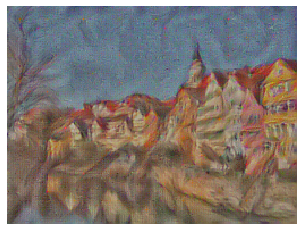

[tensor([[[[1.0624, 1.5052, 0.6216,  ..., 0.9605, 1.6647, 2.3763],
          [0.8433, 2.0807, 1.1715,  ..., 1.7697, 2.2115, 2.8084],
          [0.8730, 1.4934, 1.2955,  ..., 2.4014, 2.5499, 2.7642],
          ...,
          [1.0292, 0.9063, 0.9762,  ..., 0.3509, 0.6762, 0.6371],
          [0.9540, 0.8398, 1.1539,  ..., 0.2350, 0.5208, 0.4517],
          [0.5672, 1.0153, 1.1658,  ..., 0.2243, 0.4665, 0.4941]],

         [[0.0000, 0.3442, 0.0710,  ..., 0.0000, 0.0000, 0.0000],
          [0.4692, 0.0953, 0.0000,  ..., 0.0000, 0.2413, 0.0000],
          [0.3017, 0.0000, 0.0819,  ..., 0.0000, 0.3696, 0.2427],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1086, 0.2074],
          [0.0000, 0.0000, 0.0000,  ..., 0.0406, 0.3565, 0.1396],
          [0.2212, 0.0000, 0.3976,  ..., 0.1394, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0279,  ..., 0.0000, 0.0000, 0.1785],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0549, 0.8360],
          [0.1120, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0457e+00, 1.5548e+00, 6.5335e-01,  ..., 9.6384e-01,
           1.6373e+00, 2.3540e+00],
          [8.1282e-01, 2.0653e+00, 1.1736e+00,  ..., 1.7769e+00,
           2.1631e+00, 2.7318e+00],
          [8.4805e-01, 1.5009e+00, 1.2310e+00,  ..., 2.3367e+00,
           2.5237e+00, 2.6785e+00],
          ...,
          [9.2815e-01, 9.4003e-01, 9.3102e-01,  ..., 3.4064e-01,
           6.7505e-01, 6.1404e-01],
          [1.0282e+00, 9.2462e-01, 1.0562e+00,  ..., 2.3907e-01,
           5.0168e-01, 4.4548e-01],
          [5.9441e-01, 1.0368e+00, 1.1241e+00,  ..., 1.8403e-01,
           4.4869e-01, 5.0010e-01]],

         [[0.0000e+00, 3.6321e-01, 5.9033e-04,  ..., 0.0000e+00,
           0.0000e+00, 1.9357e-01],
          [3.8502e-01, 1.4451e-01, 0.0000e+00,  ..., 2.8452e-02,
           0.0000e+00, 0.0000e+00],
          [2.7685e-01, 0.0000e+00, 8.7455e-02,  ..., 0.0000e+00,
           3.5331e-01, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[1.0572e+00, 1.6117e+00, 6.3254e-01,  ..., 1.0423e+00,
           1.6685e+00, 2.3670e+00],
          [8.1585e-01, 2.0673e+00, 1.1383e+00,  ..., 1.8235e+00,
           2.1616e+00, 2.7277e+00],
          [8.4678e-01, 1.4331e+00, 1.1161e+00,  ..., 2.3812e+00,
           2.4617e+00, 2.5805e+00],
          ...,
          [6.7042e-01, 8.6748e-01, 9.1287e-01,  ..., 3.3324e-01,
           6.7952e-01, 6.1114e-01],
          [1.0347e+00, 9.3552e-01, 1.0208e+00,  ..., 2.5915e-01,
           4.8318e-01, 4.4986e-01],
          [8.4885e-01, 1.0264e+00, 1.1011e+00,  ..., 2.0333e-01,
           4.2270e-01, 4.9553e-01]],

         [[0.0000e+00, 4.0725e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 4.3658e-01],
          [3.1784e-01, 1.8511e-01, 0.0000e+00,  ..., 3.5887e-01,
           0.0000e+00, 0.0000e+00],
          [1.8197e-01, 9.2620e-02, 0.0000e+00,  ..., 0.0000e+00,
           3.6233e-02, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[1.0797e+00, 1.6054e+00, 6.2300e-01,  ..., 1.1963e+00,
           1.6966e+00, 2.4484e+00],
          [8.7074e-01, 2.0560e+00, 1.1541e+00,  ..., 1.9283e+00,
           2.1932e+00, 2.9509e+00],
          [8.9352e-01, 1.4577e+00, 1.1050e+00,  ..., 2.5362e+00,
           2.4527e+00, 2.5411e+00],
          ...,
          [6.1622e-01, 7.1835e-01, 8.8791e-01,  ..., 3.5216e-01,
           6.3222e-01, 6.1959e-01],
          [1.1189e+00, 1.1066e+00, 1.1108e+00,  ..., 3.4433e-01,
           4.9391e-01, 4.5284e-01],
          [1.0234e+00, 1.0824e+00, 1.2542e+00,  ..., 2.2357e-01,
           4.0608e-01, 4.8644e-01]],

         [[0.0000e+00, 3.5305e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 1.5403e-01],
          [2.5895e-01, 2.2013e-01, 0.0000e+00,  ..., 3.0380e-01,
           0.0000e+00, 8.1385e-03],
          [7.6168e-02, 1.7220e-01, 1.9680e-02,  ..., 0.0000e+00,
           0.0000e+00, 3.8423e-02],
          ...,
          [3.4205e-02, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[1.0238e+00, 1.5226e+00, 6.0715e-01,  ..., 1.2925e+00,
           1.7072e+00, 2.5148e+00],
          [9.5139e-01, 2.1213e+00, 1.1510e+00,  ..., 1.9799e+00,
           2.2969e+00, 3.2724e+00],
          [9.6392e-01, 1.6410e+00, 1.2451e+00,  ..., 2.6951e+00,
           2.5992e+00, 2.7127e+00],
          ...,
          [7.0307e-01, 5.8311e-01, 8.8869e-01,  ..., 3.3873e-01,
           5.6603e-01, 6.1536e-01],
          [1.1952e+00, 1.2033e+00, 1.2028e+00,  ..., 4.2218e-01,
           5.1296e-01, 4.3496e-01],
          [1.1715e+00, 1.1741e+00, 1.3994e+00,  ..., 2.4786e-01,
           4.0240e-01, 4.5891e-01]],

         [[0.0000e+00, 3.3902e-01, 1.0371e-02,  ..., 4.1510e-02,
           0.0000e+00, 0.0000e+00],
          [2.1570e-01, 1.4423e-01, 0.0000e+00,  ..., 0.0000e+00,
           6.1053e-02, 1.3967e-02],
          [3.2322e-02, 5.5185e-02, 2.1537e-01,  ..., 0.0000e+00,
           0.0000e+00, 2.5007e-01],
          ...,
          [1.3293e-01, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[0.9477, 1.4337, 0.5616,  ..., 1.1774, 1.6338, 2.5279],
          [0.9889, 2.0994, 1.0668,  ..., 1.7800, 2.3142, 3.2656],
          [1.0488, 1.7251, 1.2304,  ..., 2.6335, 2.6725, 2.8762],
          ...,
          [0.8478, 0.7120, 0.9863,  ..., 0.3077, 0.5542, 0.6027],
          [1.2227, 1.1534, 1.2392,  ..., 0.4184, 0.5136, 0.4324],
          [1.1436, 1.1788, 1.3955,  ..., 0.2715, 0.3949, 0.4197]],

         [[0.0000, 0.4077, 0.0000,  ..., 0.1093, 0.0000, 0.0000],
          [0.2058, 0.0443, 0.0000,  ..., 0.0000, 0.2894, 0.0000],
          [0.0122, 0.0000, 0.2624,  ..., 0.0000, 0.0763, 0.2738],
          ...,
          [0.2131, 0.0000, 0.0000,  ..., 0.0000, 0.1291, 0.2520],
          [0.0000, 0.0000, 0.0347,  ..., 0.0554, 0.2708, 0.0288],
          [0.0000, 0.0705, 0.8048,  ..., 0.1884, 0.0000, 0.0424]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0203, 0.0958, 0.0000,  ..., 0.0000, 0.1867, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[8.5064e-01, 1.3531e+00, 5.9411e-01,  ..., 1.1012e+00,
           1.6144e+00, 2.5028e+00],
          [9.2599e-01, 2.0343e+00, 1.0281e+00,  ..., 1.6160e+00,
           2.3052e+00, 3.1523e+00],
          [1.0898e+00, 1.6484e+00, 1.1049e+00,  ..., 2.4640e+00,
           2.6486e+00, 2.9332e+00],
          ...,
          [9.3300e-01, 7.4296e-01, 1.0902e+00,  ..., 2.1969e-01,
           5.0531e-01, 6.0324e-01],
          [1.2303e+00, 1.0263e+00, 1.2418e+00,  ..., 2.8487e-01,
           4.6355e-01, 4.3807e-01],
          [9.2176e-01, 1.1339e+00, 1.2980e+00,  ..., 2.8073e-01,
           3.8922e-01, 3.7269e-01]],

         [[0.0000e+00, 4.7295e-01, 0.0000e+00,  ..., 1.9832e-01,
           0.0000e+00, 4.5170e-02],
          [1.8546e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           1.9372e-01, 0.0000e+00],
          [1.2269e-01, 0.0000e+00, 2.4259e-02,  ..., 2.3483e-01,
           3.2622e-01, 2.4360e-01],
          ...,
          [2.4020e-01, 4.1574e-02, 0.0000e+00,  ..., 0.000

[tensor([[[[0.7593, 1.2897, 0.6495,  ..., 1.3582, 1.7005, 2.4625],
          [0.9147, 1.9743, 1.0311,  ..., 1.7778, 2.3160, 2.9341],
          [1.1315, 1.6796, 1.1375,  ..., 2.4075, 2.5495, 2.6906],
          ...,
          [0.9754, 0.7405, 1.1819,  ..., 0.1439, 0.4845, 0.6097],
          [0.9956, 0.9688, 1.1969,  ..., 0.1673, 0.4414, 0.4569],
          [0.5856, 1.1301, 1.1415,  ..., 0.2981, 0.4119, 0.3753]],

         [[0.0000, 0.4956, 0.0463,  ..., 0.1785, 0.0000, 0.1414],
          [0.1422, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0818],
          [0.2514, 0.0000, 0.0000,  ..., 0.3528, 0.2582, 0.0999],
          ...,
          [0.1577, 0.0298, 0.0000,  ..., 0.0000, 0.0905, 0.1568],
          [0.1238, 0.0000, 0.0495,  ..., 0.1932, 0.0624, 0.0213],
          [0.0000, 0.2470, 0.1656,  ..., 0.1977, 0.0000, 0.0511]],

         [[0.0000, 0.0000, 0.2750,  ..., 0.2528, 0.4268, 0.2995],
          [0.0000, 0.0000, 0.0000,  ..., 0.3344, 0.0000, 0.4895],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[7.2087e-01, 1.2870e+00, 6.2300e-01,  ..., 1.5357e+00,
           1.6995e+00, 2.4663e+00],
          [9.7279e-01, 2.0052e+00, 1.0481e+00,  ..., 2.0169e+00,
           2.3691e+00, 2.8739e+00],
          [1.1622e+00, 1.7153e+00, 1.1626e+00,  ..., 2.4845e+00,
           2.5342e+00, 2.4205e+00],
          ...,
          [8.6267e-01, 8.9310e-01, 1.1894e+00,  ..., 1.5316e-01,
           5.0031e-01, 6.1620e-01],
          [7.9666e-01, 9.3723e-01, 1.0766e+00,  ..., 1.3238e-01,
           4.7141e-01, 4.8622e-01],
          [4.9106e-01, 1.0604e+00, 1.1100e+00,  ..., 3.3507e-01,
           4.4134e-01, 4.0934e-01]],

         [[0.0000e+00, 4.3344e-01, 2.7120e-02,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [8.3807e-02, 0.0000e+00, 0.0000e+00,  ..., 2.3926e-01,
           0.0000e+00, 3.3033e-02],
          [3.4833e-01, 8.6447e-02, 0.0000e+00,  ..., 2.8016e-01,
           0.0000e+00, 3.7753e-02],
          ...,
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[0.7720, 1.3954, 0.5887,  ..., 1.4409, 1.6392, 2.4701],
          [1.0694, 2.1145, 1.0382,  ..., 2.0662, 2.4227, 2.9704],
          [1.1636, 1.6853, 1.0488,  ..., 2.5663, 2.5638, 2.3691],
          ...,
          [0.8067, 1.2110, 1.1525,  ..., 0.2005, 0.5443, 0.6071],
          [0.7424, 0.9057, 0.9560,  ..., 0.1435, 0.4981, 0.5134],
          [0.5943, 1.0138, 1.3333,  ..., 0.3732, 0.4306, 0.4181]],

         [[0.0000, 0.4430, 0.0000,  ..., 0.0000, 0.3011, 0.0000],
          [0.0443, 0.0000, 0.0031,  ..., 0.2423, 0.0000, 0.0467],
          [0.3549, 0.3127, 0.0000,  ..., 0.1144, 0.0000, 0.0540],
          ...,
          [0.0000, 0.1991, 0.0000,  ..., 0.0000, 0.1763, 0.2095],
          [0.0679, 0.0000, 0.1819,  ..., 0.3126, 0.0264, 0.1755],
          [0.0000, 0.3787, 0.4785,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.3984, 0.3412, 0.4559],
          [0.0000, 0.2414, 0.0000,  ..., 0.2357, 0.6715, 0.1327],
          [0.0000, 0.0988, 0.0000,  ..., 

[tensor([[[[0.8650, 1.5191, 0.6174,  ..., 1.3252, 1.7087, 2.5492],
          [1.1802, 2.2676, 1.0516,  ..., 2.0277, 2.4342, 3.0185],
          [1.1887, 1.7439, 0.9889,  ..., 2.6735, 2.5497, 2.3067],
          ...,
          [0.7944, 1.1220, 1.0581,  ..., 0.1345, 0.6099, 0.6104],
          [0.7314, 0.7702, 0.9027,  ..., 0.1432, 0.5261, 0.5280],
          [0.7312, 1.0385, 1.3631,  ..., 0.3491, 0.4195, 0.4675]],

         [[0.0000, 0.3814, 0.0000,  ..., 0.0000, 0.4133, 0.0000],
          [0.0375, 0.0000, 0.0171,  ..., 0.0361, 0.0000, 0.0000],
          [0.3256, 0.2821, 0.0000,  ..., 0.0000, 0.0061, 0.0891],
          ...,
          [0.0000, 0.0944, 0.0000,  ..., 0.0000, 0.2269, 0.2481],
          [0.2762, 0.0000, 0.0000,  ..., 0.2679, 0.0181, 0.2561],
          [0.0000, 0.2746, 0.6262,  ..., 0.0000, 0.0260, 0.0000]],

         [[0.1198, 0.0000, 0.0000,  ..., 0.0241, 0.2107, 0.3774],
          [0.1326, 0.1915, 0.0000,  ..., 0.0517, 0.5853, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.9571, 1.5782, 0.6939,  ..., 1.3297, 1.8518, 2.7291],
          [1.2310, 2.3460, 1.1503,  ..., 1.9793, 2.4955, 2.9771],
          [1.2114, 1.8259, 0.9702,  ..., 2.6303, 2.4716, 2.1630],
          ...,
          [0.6989, 0.9871, 1.0748,  ..., 0.0877, 0.6616, 0.6171],
          [0.7673, 0.7333, 1.0610,  ..., 0.1220, 0.5676, 0.5273],
          [0.7963, 1.1376, 1.3793,  ..., 0.2993, 0.4057, 0.4972]],

         [[0.0000, 0.2717, 0.0000,  ..., 0.2294, 0.1144, 0.0000],
          [0.0770, 0.0458, 0.0000,  ..., 0.0000, 0.0000, 0.0436],
          [0.3150, 0.1409, 0.0000,  ..., 0.0000, 0.0000, 0.1776],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1569, 0.2981],
          [0.3660, 0.0000, 0.0000,  ..., 0.1458, 0.0376, 0.3308],
          [0.0000, 0.2016, 0.6856,  ..., 0.0000, 0.0297, 0.0000]],

         [[0.1169, 0.0000, 0.0000,  ..., 0.0000, 0.1760, 0.4555],
          [0.1262, 0.0000, 0.0122,  ..., 0.0000, 0.0446, 0.3266],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0219e+00, 1.5921e+00, 7.2821e-01,  ..., 1.3993e+00,
           2.0281e+00, 2.9520e+00],
          [1.2105e+00, 2.2848e+00, 1.2431e+00,  ..., 1.9563e+00,
           2.5676e+00, 2.9541e+00],
          [1.1657e+00, 1.8525e+00, 9.8303e-01,  ..., 2.4711e+00,
           2.4078e+00, 2.0458e+00],
          ...,
          [6.4923e-01, 9.5299e-01, 1.1360e+00,  ..., 1.6772e-01,
           6.7473e-01, 6.2380e-01],
          [9.4771e-01, 9.3012e-01, 1.2647e+00,  ..., 1.6715e-01,
           6.2493e-01, 4.9810e-01],
          [9.9111e-01, 1.2014e+00, 1.5325e+00,  ..., 2.5918e-01,
           3.9068e-01, 4.5247e-01]],

         [[0.0000e+00, 2.3365e-01, 7.2526e-02,  ..., 2.2147e-01,
           0.0000e+00, 9.2387e-02],
          [1.7088e-01, 7.5800e-02, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 3.1254e-01],
          [2.1052e-01, 0.0000e+00, 2.1598e-01,  ..., 0.0000e+00,
           0.0000e+00, 2.0256e-01],
          ...,
          [6.5443e-02, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[1.0510e+00, 1.6664e+00, 6.0525e-01,  ..., 1.4522e+00,
           2.0930e+00, 3.0098e+00],
          [1.1808e+00, 2.1570e+00, 1.1578e+00,  ..., 1.9758e+00,
           2.5663e+00, 2.8538e+00],
          [1.1045e+00, 1.6535e+00, 8.0939e-01,  ..., 2.3397e+00,
           2.3487e+00, 1.9288e+00],
          ...,
          [6.8250e-01, 8.2637e-01, 1.1221e+00,  ..., 2.2502e-01,
           6.3164e-01, 6.4109e-01],
          [1.1234e+00, 1.1706e+00, 1.3033e+00,  ..., 2.8658e-01,
           6.7921e-01, 4.8476e-01],
          [1.2069e+00, 1.2319e+00, 1.6438e+00,  ..., 2.3616e-01,
           3.9970e-01, 3.9376e-01]],

         [[0.0000e+00, 4.4476e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 1.2083e-01],
          [1.9359e-01, 1.6200e-02, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [1.2481e-01, 9.5104e-02, 3.7951e-01,  ..., 6.4280e-02,
           0.0000e+00, 1.2529e-01],
          ...,
          [8.0352e-02, 6.3850e-02, 0.0000e+00,  ..., 0.000

[tensor([[[[1.0774, 1.6989, 0.4963,  ..., 1.4238, 2.0615, 2.9284],
          [1.1999, 2.0786, 1.1553,  ..., 1.9803, 2.5373, 2.7793],
          [1.0702, 1.5618, 0.9086,  ..., 2.3143, 2.3077, 1.8551],
          ...,
          [0.7902, 0.7744, 1.0645,  ..., 0.2024, 0.5643, 0.6415],
          [1.2056, 1.3089, 1.2971,  ..., 0.4471, 0.7126, 0.4743],
          [1.4037, 1.2547, 1.5954,  ..., 0.2600, 0.4209, 0.3072]],

         [[0.0000, 0.5614, 0.0000,  ..., 0.0000, 0.0000, 0.0554],
          [0.2060, 0.1092, 0.0000,  ..., 0.0984, 0.0000, 0.0000],
          [0.0193, 0.0771, 0.4129,  ..., 0.1818, 0.0000, 0.0000],
          ...,
          [0.0000, 0.2442, 0.0000,  ..., 0.0000, 0.0000, 0.2534],
          [0.0000, 0.0000, 0.3195,  ..., 0.0169, 0.2811, 0.1842],
          [0.0000, 0.0000, 0.6374,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.2706, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.1476, 0.7147, 0.0000],
          [0.1212, 0.0000, 0.6372,  ..., 

[tensor([[[[1.0957, 1.6719, 0.5229,  ..., 1.3227, 2.0901, 2.9569],
          [1.2771, 2.1026, 1.2304,  ..., 1.8815, 2.5067, 2.7387],
          [1.0939, 1.7054, 1.2303,  ..., 2.4140, 2.3821, 1.9776],
          ...,
          [0.8500, 0.7966, 1.0582,  ..., 0.2523, 0.5051, 0.6634],
          [1.1347, 1.4524, 1.2331,  ..., 0.5550, 0.7307, 0.5219],
          [1.4251, 1.3066, 1.2134,  ..., 0.2723, 0.4559, 0.2835]],

         [[0.0000, 0.4928, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.2229, 0.2158, 0.0000,  ..., 0.0000, 0.2311, 0.0708],
          [0.0300, 0.0000, 0.5832,  ..., 0.1866, 0.0908, 0.0127],
          ...,
          [0.0000, 0.2914, 0.0000,  ..., 0.0784, 0.0000, 0.3620],
          [0.0000, 0.0000, 0.2794,  ..., 0.0053, 0.2933, 0.1444],
          [0.0000, 0.0000, 0.8168,  ..., 0.0000, 0.0945, 0.0000]],

         [[0.0000, 0.3804, 0.2188,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.2263, 0.1691, 0.7372],
          [0.2411, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0913e+00, 1.6249e+00, 6.3290e-01,  ..., 1.3636e+00,
           2.0883e+00, 3.0432e+00],
          [1.3433e+00, 2.0874e+00, 1.2113e+00,  ..., 1.8884e+00,
           2.5281e+00, 2.6426e+00],
          [1.1132e+00, 1.6560e+00, 1.2196e+00,  ..., 2.5839e+00,
           2.4274e+00, 2.0219e+00],
          ...,
          [7.4923e-01, 8.3574e-01, 9.8165e-01,  ..., 4.3295e-01,
           4.9209e-01, 6.8491e-01],
          [7.8953e-01, 1.2896e+00, 1.1687e+00,  ..., 5.5714e-01,
           6.3975e-01, 5.7158e-01],
          [1.2514e+00, 1.2285e+00, 1.0140e+00,  ..., 2.8008e-01,
           4.6157e-01, 2.6753e-01]],

         [[0.0000e+00, 4.0407e-01, 0.0000e+00,  ..., 0.0000e+00,
           6.5472e-02, 0.0000e+00],
          [2.2655e-01, 4.2082e-02, 0.0000e+00,  ..., 0.0000e+00,
           1.1988e-01, 1.1430e-01],
          [3.1111e-02, 0.0000e+00, 2.8213e-01,  ..., 1.2045e-01,
           1.9219e-01, 1.7902e-01],
          ...,
          [0.0000e+00, 1.4271e-01, 0.0000e+00,  ..., 1.094

[tensor([[[[1.0992, 1.6060, 0.6991,  ..., 1.4572, 2.1108, 3.0567],
          [1.3189, 2.0594, 1.1183,  ..., 1.9555, 2.5393, 2.5453],
          [1.0620, 1.4902, 0.9906,  ..., 2.6086, 2.4134, 1.9728],
          ...,
          [0.7597, 1.0102, 0.8534,  ..., 0.4937, 0.5159, 0.6952],
          [0.7248, 0.9672, 1.0903,  ..., 0.4413, 0.5373, 0.6450],
          [1.0640, 0.9757, 1.1300,  ..., 0.3000, 0.4319, 0.2813]],

         [[0.0000, 0.2394, 0.0000,  ..., 0.0000, 0.2113, 0.0000],
          [0.1802, 0.0000, 0.0361,  ..., 0.0000, 0.1262, 0.0067],
          [0.0624, 0.0000, 0.0000,  ..., 0.0095, 0.1505, 0.1401],
          ...,
          [0.0000, 0.1477, 0.0000,  ..., 0.0000, 0.0000, 0.4052],
          [0.7664, 0.0000, 0.0319,  ..., 0.0835, 0.1800, 0.0719],
          [0.0000, 0.0000, 0.2627,  ..., 0.0673, 0.1805, 0.1392]],

         [[0.0000, 0.3435, 0.6936,  ..., 0.0000, 0.7535, 1.1230],
          [0.2271, 0.3329, 0.0000,  ..., 0.0319, 0.0547, 0.3404],
          [0.1686, 0.1805, 0.0000,  ..., 

[tensor([[[[1.1715, 1.6171, 0.7506,  ..., 1.5977, 2.1031, 2.9110],
          [1.2824, 2.0140, 1.1337,  ..., 2.0136, 2.5880, 2.6543],
          [0.9960, 1.3061, 0.8675,  ..., 2.3563, 2.3162, 1.9706],
          ...,
          [0.8049, 1.0288, 0.8950,  ..., 0.2792, 0.4538, 0.6776],
          [0.7203, 0.7140, 0.9527,  ..., 0.3557, 0.4755, 0.6766],
          [0.9597, 0.8270, 1.1638,  ..., 0.3356, 0.4065, 0.3208]],

         [[0.0529, 0.0835, 0.0000,  ..., 0.0000, 0.0208, 0.0000],
          [0.1605, 0.0000, 0.3280,  ..., 0.2273, 0.0388, 0.0479],
          [0.0803, 0.2112, 0.0000,  ..., 0.0000, 0.1086, 0.0000],
          ...,
          [0.0000, 0.3534, 0.0000,  ..., 0.0000, 0.0000, 0.4979],
          [0.8121, 0.0000, 0.0000,  ..., 0.2052, 0.0930, 0.0576],
          [0.0000, 0.0000, 0.0622,  ..., 0.1315, 0.1231, 0.1890]],

         [[0.0000, 0.3652, 0.2568,  ..., 0.6463, 0.5385, 0.2665],
          [0.0803, 0.3172, 0.0000,  ..., 0.0000, 0.3033, 0.6275],
          [0.0000, 0.2595, 0.0000,  ..., 

[tensor([[[[1.2578, 1.7040, 0.7586,  ..., 1.5482, 2.0255, 2.6532],
          [1.2785, 2.0659, 1.2446,  ..., 2.0309, 2.5480, 2.6775],
          [0.9870, 1.3502, 1.1238,  ..., 2.1727, 2.1607, 1.9725],
          ...,
          [0.7435, 1.0090, 1.0410,  ..., 0.2407, 0.4698, 0.6460],
          [0.6355, 0.7145, 1.2261,  ..., 0.3349, 0.4922, 0.6740],
          [0.7957, 0.8279, 1.1960,  ..., 0.3417, 0.4161, 0.3834]],

         [[0.1824, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.1071, 0.0000, 0.3200,  ..., 0.4163, 0.0945, 0.1007],
          [0.1047, 0.1641, 0.0514,  ..., 0.0760, 0.0000, 0.0000],
          ...,
          [0.0000, 0.7516, 0.0000,  ..., 0.0000, 0.0000, 0.4321],
          [0.8657, 0.0000, 0.0000,  ..., 0.1497, 0.1703, 0.0000],
          [0.0000, 0.0000, 0.1808,  ..., 0.1916, 0.0000, 0.1871]],

         [[0.0000, 0.4102, 0.0000,  ..., 0.8409, 0.0818, 0.0000],
          [0.0000, 0.0414, 0.0000,  ..., 0.0000, 0.3602, 0.3212],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.3221, 1.7522, 0.7999,  ..., 1.5232, 2.0088, 2.4488],
          [1.3071, 2.0813, 1.2525,  ..., 2.1264, 2.5308, 2.5866],
          [0.9961, 1.2911, 1.1979,  ..., 2.1435, 2.0856, 2.0199],
          ...,
          [0.8356, 1.1158, 1.1047,  ..., 0.3643, 0.4757, 0.5946],
          [0.6485, 0.8626, 1.4580,  ..., 0.3779, 0.5309, 0.5957],
          [0.7336, 0.9985, 1.4450,  ..., 0.3393, 0.4258, 0.4278]],

         [[0.2937, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0383, 0.0000, 0.3166,  ..., 0.0219, 0.2134, 0.0212],
          [0.1221, 0.1109, 0.2599,  ..., 0.1105, 0.0000, 0.0000],
          ...,
          [0.0000, 0.8271, 0.0000,  ..., 0.0000, 0.0000, 0.3132],
          [0.7484, 0.0000, 0.0000,  ..., 0.0442, 0.3085, 0.0775],
          [0.0000, 0.0000, 0.3581,  ..., 0.2386, 0.0000, 0.1073]],

         [[0.0251, 0.0859, 0.0000,  ..., 0.3892, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0896, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.3563, 1.7364, 0.9164,  ..., 1.5203, 2.0383, 2.3772],
          [1.3028, 2.0959, 1.2290,  ..., 2.2569, 2.5450, 2.4757],
          [0.9647, 1.1184, 0.9442,  ..., 2.2362, 2.1074, 2.0408],
          ...,
          [0.9660, 1.0864, 1.1890,  ..., 0.3115, 0.4892, 0.5360],
          [0.8633, 0.9438, 1.2883,  ..., 0.4011, 0.5457, 0.4664],
          [0.7811, 1.1178, 1.4866,  ..., 0.3494, 0.4594, 0.4751]],

         [[0.4141, 0.0000, 0.0239,  ..., 0.0000, 0.0000, 0.0784],
          [0.0000, 0.0101, 0.1887,  ..., 0.0000, 0.1442, 0.2296],
          [0.0943, 0.2589, 0.1325,  ..., 0.0041, 0.0926, 0.0000],
          ...,
          [0.0000, 0.4204, 0.0000,  ..., 0.0000, 0.0000, 0.2004],
          [0.8143, 0.0000, 0.0000,  ..., 0.0000, 0.3378, 0.1307],
          [0.0000, 0.0608, 0.3294,  ..., 0.3184, 0.0000, 0.0217]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1048],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.3716, 1.6663, 1.0177,  ..., 1.7110, 2.1865, 2.3705],
          [1.1646, 2.0913, 1.2737,  ..., 2.3186, 2.5061, 2.4053],
          [0.8531, 1.1028, 0.7948,  ..., 2.2943, 2.1713, 2.0051],
          ...,
          [1.0736, 1.0729, 1.3005,  ..., 0.2384, 0.5619, 0.5266],
          [1.0737, 0.9253, 0.9915,  ..., 0.4777, 0.5202, 0.3705],
          [0.9269, 1.1547, 1.2904,  ..., 0.3909, 0.4332, 0.4656]],

         [[0.5562, 0.0000, 0.2606,  ..., 0.0122, 0.0000, 0.1653],
          [0.0000, 0.1421, 0.0000,  ..., 0.0000, 0.0000, 0.2785],
          [0.0433, 0.2694, 0.0631,  ..., 0.0000, 0.4027, 0.0000],
          ...,
          [0.0000, 0.2834, 0.0000,  ..., 0.0000, 0.0000, 0.1493],
          [0.5362, 0.0000, 0.1933,  ..., 0.0000, 0.2532, 0.1012],
          [0.0000, 0.0579, 0.1396,  ..., 0.3588, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.4413],
          [0.0000, 0.0000, 0.0000,  ..., 0.1306, 0.0000, 0.4173],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.4033e+00, 1.5675e+00, 1.1361e+00,  ..., 1.8632e+00,
           2.3411e+00, 2.4627e+00],
          [1.0435e+00, 2.0760e+00, 1.3295e+00,  ..., 2.2427e+00,
           2.5400e+00, 2.3940e+00],
          [7.6154e-01, 1.2389e+00, 9.6461e-01,  ..., 2.3269e+00,
           2.2006e+00, 1.9127e+00],
          ...,
          [1.2636e+00, 1.1264e+00, 1.2730e+00,  ..., 4.6215e-01,
           7.0125e-01, 5.5402e-01],
          [1.1574e+00, 9.9862e-01, 9.4942e-01,  ..., 5.3478e-01,
           4.3578e-01, 3.2999e-01],
          [1.0096e+00, 1.1716e+00, 1.0547e+00,  ..., 4.3872e-01,
           3.8337e-01, 4.8001e-01]],

         [[5.5786e-01, 0.0000e+00, 3.6279e-01,  ..., 1.5926e-01,
           0.0000e+00, 2.8901e-02],
          [0.0000e+00, 2.9385e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 1.4776e-02],
          [0.0000e+00, 8.1591e-02, 1.5477e-01,  ..., 0.0000e+00,
           2.8932e-01, 9.0857e-02],
          ...,
          [0.0000e+00, 3.2153e-01, 1.1627e-01,  ..., 0.000

[tensor([[[[1.3658e+00, 1.5057e+00, 1.0806e+00,  ..., 1.8512e+00,
           2.4400e+00, 2.5778e+00],
          [9.5047e-01, 2.0917e+00, 1.3260e+00,  ..., 2.1606e+00,
           2.5464e+00, 2.3785e+00],
          [7.2626e-01, 1.2637e+00, 1.0248e+00,  ..., 2.3985e+00,
           2.2453e+00, 1.8782e+00],
          ...,
          [9.4771e-01, 9.2622e-01, 1.2022e+00,  ..., 5.5867e-01,
           7.9385e-01, 6.5282e-01],
          [1.0394e+00, 9.9088e-01, 1.0283e+00,  ..., 6.0942e-01,
           3.8878e-01, 3.4044e-01],
          [1.0520e+00, 1.1908e+00, 1.0186e+00,  ..., 5.0456e-01,
           3.6579e-01, 4.9332e-01]],

         [[6.3540e-01, 0.0000e+00, 3.2761e-01,  ..., 7.6125e-02,
           1.7895e-01, 0.0000e+00],
          [0.0000e+00, 3.5031e-01, 0.0000e+00,  ..., 2.7096e-02,
           1.3800e-01, 0.0000e+00],
          [0.0000e+00, 3.0186e-02, 2.1895e-01,  ..., 0.0000e+00,
           2.6272e-02, 1.4732e-01],
          ...,
          [0.0000e+00, 1.9932e-02, 1.4187e-02,  ..., 0.000

[tensor([[[[1.3079e+00, 1.4739e+00, 9.3829e-01,  ..., 1.7493e+00,
           2.4051e+00, 2.6144e+00],
          [9.1134e-01, 2.0615e+00, 1.2689e+00,  ..., 2.0560e+00,
           2.2672e+00, 2.1984e+00],
          [7.8905e-01, 1.2322e+00, 1.0405e+00,  ..., 2.4035e+00,
           2.1590e+00, 1.8548e+00],
          ...,
          [5.8857e-01, 8.2535e-01, 1.1170e+00,  ..., 3.2696e-01,
           7.7495e-01, 7.2613e-01],
          [1.0590e+00, 9.0219e-01, 1.1963e+00,  ..., 5.5181e-01,
           3.3069e-01, 3.7964e-01],
          [1.1929e+00, 1.2023e+00, 1.3408e+00,  ..., 5.2861e-01,
           3.4729e-01, 4.8534e-01]],

         [[6.0930e-01, 0.0000e+00, 2.0766e-01,  ..., 0.0000e+00,
           1.6053e-01, 0.0000e+00],
          [0.0000e+00, 2.9821e-01, 1.6340e-01,  ..., 0.0000e+00,
           3.9038e-01, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 3.5183e-01,  ..., 0.0000e+00,
           0.0000e+00, 1.3658e-01],
          ...,
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.908

[tensor([[[[1.3005, 1.4385, 0.9513,  ..., 1.6912, 2.3199, 2.6273],
          [0.9012, 1.9427, 1.2076,  ..., 1.8580, 1.9182, 2.0287],
          [0.9238, 1.2503, 0.9541,  ..., 2.2778, 1.9657, 1.7134],
          ...,
          [0.3161, 0.9198, 1.1019,  ..., 0.3053, 0.7414, 0.7739],
          [0.9058, 0.9445, 1.2723,  ..., 0.4055, 0.3742, 0.4344],
          [1.1198, 1.2617, 1.5707,  ..., 0.4177, 0.3048, 0.4886]],

         [[0.3508, 0.0000, 0.1055,  ..., 0.0000, 0.0211, 0.0000],
          [0.0297, 0.3310, 0.1110,  ..., 0.0334, 0.1948, 0.1517],
          [0.0000, 0.0000, 0.3298,  ..., 0.0556, 0.0000, 0.2326],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1592],
          [0.0000, 0.1961, 0.2958,  ..., 0.1550, 0.0000, 0.0853],
          [0.0000, 0.4470, 0.0000,  ..., 0.0114, 0.1696, 0.0335]],

         [[0.0911, 0.0000, 0.0000,  ..., 0.3920, 0.8217, 0.3312],
          [0.0605, 0.0000, 0.0000,  ..., 0.3454, 0.8372, 0.7510],
          [0.1857, 0.0000, 0.0000,  ..., 

[tensor([[[[1.3482e+00, 1.4766e+00, 1.0714e+00,  ..., 1.7196e+00,
           2.1560e+00, 2.6205e+00],
          [9.6623e-01, 1.8541e+00, 1.1801e+00,  ..., 1.8452e+00,
           1.8450e+00, 2.1301e+00],
          [1.0512e+00, 1.2077e+00, 7.7206e-01,  ..., 2.2502e+00,
           1.9330e+00, 1.5459e+00],
          ...,
          [4.1534e-01, 1.1036e+00, 1.1481e+00,  ..., 4.4946e-01,
           7.5096e-01, 7.8799e-01],
          [8.5683e-01, 1.0932e+00, 1.3603e+00,  ..., 2.7937e-01,
           4.9199e-01, 4.7628e-01],
          [1.0995e+00, 1.2862e+00, 1.6567e+00,  ..., 2.9538e-01,
           2.6217e-01, 4.7766e-01]],

         [[8.7674e-02, 0.0000e+00, 2.0485e-01,  ..., 0.0000e+00,
           2.1300e-01, 0.0000e+00],
          [1.6077e-01, 2.7140e-01, 0.0000e+00,  ..., 4.3994e-02,
           0.0000e+00, 7.0017e-01],
          [0.0000e+00, 2.4076e-01, 1.7905e-01,  ..., 1.3178e-01,
           0.0000e+00, 2.3463e-01],
          ...,
          [0.0000e+00, 0.0000e+00, 7.7035e-03,  ..., 0.000

[tensor([[[[1.3945e+00, 1.5481e+00, 1.1394e+00,  ..., 1.6714e+00,
           1.9752e+00, 2.4048e+00],
          [1.1082e+00, 1.9021e+00, 1.1395e+00,  ..., 1.8828e+00,
           1.9073e+00, 2.1563e+00],
          [1.1183e+00, 1.1842e+00, 6.7331e-01,  ..., 2.2999e+00,
           2.0550e+00, 1.5622e+00],
          ...,
          [9.8129e-01, 1.1788e+00, 1.1221e+00,  ..., 3.6085e-01,
           7.5185e-01, 7.9640e-01],
          [1.0674e+00, 1.1908e+00, 1.4344e+00,  ..., 2.3788e-01,
           6.5939e-01, 5.0998e-01],
          [9.0991e-01, 1.3069e+00, 1.6152e+00,  ..., 2.7157e-01,
           3.4314e-01, 5.0821e-01]],

         [[0.0000e+00, 0.0000e+00, 3.5459e-01,  ..., 4.0829e-02,
           3.0602e-01, 0.0000e+00],
          [2.3560e-01, 5.3656e-02, 0.0000e+00,  ..., 3.5021e-03,
           0.0000e+00, 8.5616e-01],
          [6.1025e-04, 4.2708e-01, 2.6815e-01,  ..., 1.1473e-01,
           0.0000e+00, 1.3906e-01],
          ...,
          [0.0000e+00, 0.0000e+00, 2.1772e-01,  ..., 0.000

[tensor([[[[1.3975, 1.6350, 1.0470,  ..., 1.5301, 1.9277, 2.0449],
          [1.1793, 2.0352, 1.0355,  ..., 1.8685, 1.8882, 2.0034],
          [1.1342, 1.2355, 0.6604,  ..., 2.2688, 2.1710, 1.7293],
          ...,
          [1.3420, 1.0170, 1.0746,  ..., 0.2164, 0.6545, 0.6662],
          [1.1137, 1.2647, 1.4850,  ..., 0.2799, 0.7976, 0.4949],
          [0.6431, 1.2397, 1.4664,  ..., 0.2555, 0.5274, 0.5864]],

         [[0.0000, 0.0000, 0.3594,  ..., 0.0814, 0.1961, 0.0000],
          [0.2348, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.2778],
          [0.1007, 0.3815, 0.3676,  ..., 0.0619, 0.0000, 0.0292],
          ...,
          [0.0000, 0.0000, 0.2913,  ..., 0.0000, 0.0000, 0.5582],
          [0.0375, 0.2584, 0.1513,  ..., 0.0000, 0.3011, 0.0000],
          [0.1132, 0.0000, 0.4418,  ..., 0.1280, 0.0000, 0.2261]],

         [[0.4029, 0.0000, 0.1527,  ..., 0.1685, 0.0000, 0.4250],
          [0.3283, 0.3672, 0.0000,  ..., 0.2684, 0.0000, 0.0000],
          [0.0000, 0.2202, 0.0733,  ..., 

[tensor([[[[1.3363, 1.7055, 0.9400,  ..., 1.5524, 1.9151, 1.7917],
          [1.0856, 2.1208, 1.0183,  ..., 1.9454, 1.7895, 1.7553],
          [1.2218, 1.3907, 0.7701,  ..., 2.2352, 2.2376, 1.9124],
          ...,
          [0.9901, 0.8975, 1.1997,  ..., 0.4185, 0.5984, 0.5417],
          [1.1121, 1.2018, 1.3422,  ..., 0.3748, 0.8212, 0.4526],
          [0.9736, 1.1392, 1.3108,  ..., 0.2259, 0.6924, 0.6430]],

         [[0.0000, 0.0000, 0.3173,  ..., 0.1363, 0.0143, 0.0000],
          [0.2365, 0.0000, 0.1698,  ..., 0.0000, 0.4240, 0.0000],
          [0.1333, 0.2519, 0.4561,  ..., 0.0000, 0.1074, 0.0000],
          ...,
          [0.0000, 0.0000, 0.3170,  ..., 0.0000, 0.0000, 0.5464],
          [0.0071, 0.4632, 0.0479,  ..., 0.0000, 0.3757, 0.0000],
          [0.2278, 0.1345, 0.3106,  ..., 0.0951, 0.0000, 0.1351]],

         [[0.1344, 0.0000, 0.0000,  ..., 0.1971, 0.0000, 0.0000],
          [0.2059, 0.1610, 0.0000,  ..., 0.0352, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.1344,  ..., 

[tensor([[[[1.2875, 1.7662, 0.9678,  ..., 1.7169, 1.9143, 1.6514],
          [1.0114, 2.2249, 1.0725,  ..., 2.1013, 1.9245, 1.9088],
          [1.3052, 1.5490, 0.8598,  ..., 2.2742, 2.2966, 2.1135],
          ...,
          [0.5738, 0.7008, 1.2641,  ..., 0.5279, 0.5441, 0.5854],
          [1.0497, 1.0075, 1.1579,  ..., 0.3424, 0.6241, 0.4622],
          [1.2370, 1.1007, 1.2266,  ..., 0.2462, 0.7185, 0.6641]],

         [[0.0000, 0.0079, 0.2300,  ..., 0.0824, 0.0000, 0.0411],
          [0.2413, 0.0000, 0.1829,  ..., 0.0000, 0.5506, 0.0000],
          [0.1331, 0.1003, 0.2915,  ..., 0.0000, 0.2625, 0.0000],
          ...,
          [0.0000, 0.0000, 0.3182,  ..., 0.0000, 0.0000, 0.4532],
          [0.0000, 0.4483, 0.0000,  ..., 0.1086, 0.2476, 0.0000],
          [0.1614, 0.2720, 0.0718,  ..., 0.0624, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.4088, 0.2810, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0676, 0.2263, 0.1922],
          [0.0000, 0.0000, 0.0075,  ..., 

[tensor([[[[1.3172, 1.7833, 1.0465,  ..., 1.8289, 1.8558, 1.5337],
          [1.0437, 2.2362, 1.1379,  ..., 2.1683, 2.1878, 2.2332],
          [1.3549, 1.6637, 0.9589,  ..., 2.3935, 2.3101, 2.1367],
          ...,
          [0.5444, 0.5976, 1.2143,  ..., 0.3621, 0.5366, 0.6991],
          [1.0201, 0.8022, 1.0831,  ..., 0.2286, 0.4183, 0.5012],
          [1.2712, 1.0745, 1.2070,  ..., 0.3438, 0.6714, 0.6247]],

         [[0.0000, 0.1414, 0.1300,  ..., 0.0606, 0.0000, 0.1874],
          [0.2210, 0.1620, 0.0100,  ..., 0.1464, 0.2116, 0.0174],
          [0.0474, 0.0593, 0.0212,  ..., 0.0000, 0.2577, 0.0000],
          ...,
          [0.0000, 0.0000, 0.1928,  ..., 0.0000, 0.0000, 0.2557],
          [0.0000, 0.1788, 0.0000,  ..., 0.3002, 0.0237, 0.0000],
          [0.0767, 0.1554, 0.0000,  ..., 0.0000, 0.0677, 0.0000]],

         [[0.0000, 0.0000, 0.0456,  ..., 0.4616, 0.4341, 0.6255],
          [0.0000, 0.0000, 0.0000,  ..., 0.0618, 0.5084, 0.2632],
          [0.0803, 0.0889, 0.0000,  ..., 

[tensor([[[[1.3812, 1.7586, 1.0634,  ..., 1.8119, 1.7074, 1.5102],
          [1.1685, 2.1769, 1.1790,  ..., 2.2095, 2.2697, 2.4014],
          [1.4037, 1.7262, 1.0071,  ..., 2.5266, 2.2818, 2.1575],
          ...,
          [0.7701, 0.8214, 1.1768,  ..., 0.1872, 0.5744, 0.7506],
          [1.0145, 0.7644, 0.9829,  ..., 0.2472, 0.4021, 0.4948],
          [1.4612, 1.0897, 1.1904,  ..., 0.4211, 0.6139, 0.5666]],

         [[0.0546, 0.1557, 0.0501,  ..., 0.0294, 0.3410, 0.1456],
          [0.1654, 0.2838, 0.0000,  ..., 0.1713, 0.0000, 0.1388],
          [0.0000, 0.1633, 0.0000,  ..., 0.0438, 0.0000, 0.0811],
          ...,
          [0.3857, 0.0000, 0.0611,  ..., 0.0000, 0.0900, 0.0615],
          [0.0000, 0.0000, 0.0000,  ..., 0.2492, 0.0662, 0.0052],
          [0.0000, 0.0000, 0.1231,  ..., 0.0000, 0.2297, 0.0000]],

         [[0.0000, 0.0000, 0.0556,  ..., 0.0499, 0.5451, 1.9730],
          [0.0330, 0.0000, 0.0000,  ..., 0.0000, 0.6932, 0.0105],
          [0.2495, 0.1365, 0.0000,  ..., 

[tensor([[[[1.4151, 1.7453, 1.0743,  ..., 1.9274, 1.6104, 1.4403],
          [1.1962, 2.0669, 1.1990,  ..., 2.2648, 2.1660, 2.4009],
          [1.4364, 1.7711, 1.0156,  ..., 2.4798, 2.2941, 2.2772],
          ...,
          [0.9333, 1.1677, 1.1676,  ..., 0.2206, 0.5775, 0.7410],
          [0.8102, 0.9117, 1.0005,  ..., 0.3702, 0.5262, 0.5584],
          [1.0435, 1.0309, 1.2651,  ..., 0.4351, 0.5754, 0.5520]],

         [[0.1055, 0.0797, 0.0000,  ..., 0.0000, 0.2839, 0.0037],
          [0.1196, 0.1574, 0.0000,  ..., 0.0885, 0.0000, 0.1093],
          [0.0000, 0.3208, 0.0000,  ..., 0.2330, 0.0000, 0.2517],
          ...,
          [0.8206, 0.0000, 0.0000,  ..., 0.0000, 0.1381, 0.0356],
          [0.0000, 0.1233, 0.0000,  ..., 0.0960, 0.2374, 0.0000],
          [0.0000, 0.0000, 0.8423,  ..., 0.0000, 0.3157, 0.0000]],

         [[0.2110, 0.0000, 0.0203,  ..., 0.0782, 0.5255, 1.3181],
          [0.0000, 0.0000, 0.0000,  ..., 0.1886, 0.4828, 0.0000],
          [0.1631, 0.2065, 0.0000,  ..., 

[tensor([[[[1.3159, 1.7085, 1.0293,  ..., 1.8463, 1.5003, 1.3864],
          [1.1600, 1.9836, 1.1844,  ..., 2.1773, 2.0087, 2.2688],
          [1.4564, 1.8558, 1.0576,  ..., 2.4244, 2.4588, 2.4748],
          ...,
          [1.0030, 1.1896, 1.0484,  ..., 0.2154, 0.5463, 0.6352],
          [0.7401, 0.8529, 0.9930,  ..., 0.4749, 0.5733, 0.6765],
          [0.5135, 0.9269, 1.3702,  ..., 0.3735, 0.4986, 0.5988]],

         [[0.1490, 0.0515, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0804, 0.0574, 0.0000,  ..., 0.0000, 0.2232, 0.0000],
          [0.0000, 0.2875, 0.0761,  ..., 0.2568, 0.0000, 0.1927],
          ...,
          [1.0083, 0.0000, 0.0239,  ..., 0.0000, 0.0000, 0.2384],
          [0.0000, 0.1969, 0.0000,  ..., 0.0000, 0.3873, 0.0000],
          [0.1623, 0.0000, 1.2147,  ..., 0.0000, 0.1984, 0.0000]],

         [[0.1314, 0.0420, 0.0000,  ..., 0.0000, 0.1622, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.3812, 0.3791, 0.3379],
          [0.0000, 0.1398, 0.0000,  ..., 

[tensor([[[[1.1893, 1.6771, 0.9064,  ..., 1.7257, 1.4293, 1.4033],
          [1.1833, 1.9383, 1.1579,  ..., 1.9867, 1.9344, 2.2585],
          [1.4411, 1.7568, 1.0917,  ..., 2.3147, 2.5013, 2.5732],
          ...,
          [0.9932, 1.1091, 0.9847,  ..., 0.1880, 0.6045, 0.5136],
          [0.9510, 0.8007, 0.8742,  ..., 0.4502, 0.5164, 0.7334],
          [0.4331, 0.9603, 1.3522,  ..., 0.2731, 0.4379, 0.6555]],

         [[0.3624, 0.0000, 0.0179,  ..., 0.0000, 0.0000, 0.0000],
          [0.0308, 0.0000, 0.1303,  ..., 0.0000, 0.7223, 0.0000],
          [0.0939, 0.2410, 0.1831,  ..., 0.1118, 0.0139, 0.0561],
          ...,
          [0.3394, 0.0000, 0.1000,  ..., 0.0000, 0.0000, 0.4976],
          [0.0299, 0.1445, 0.0000,  ..., 0.0000, 0.3884, 0.0257],
          [0.0000, 0.0000, 1.0820,  ..., 0.1573, 0.0430, 0.0000]],

         [[0.0000, 0.0908, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.7204],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.1170, 1.6276, 0.8712,  ..., 1.9713, 1.5054, 1.4855],
          [1.2830, 1.9436, 1.1607,  ..., 2.0674, 2.1112, 2.3467],
          [1.4047, 1.3608, 0.8694,  ..., 2.2452, 2.3291, 2.3336],
          ...,
          [0.9839, 0.9365, 1.0522,  ..., 0.2784, 0.7114, 0.4304],
          [1.0419, 0.7990, 0.9452,  ..., 0.3844, 0.5027, 0.6877],
          [0.7029, 0.9712, 1.3362,  ..., 0.2178, 0.4317, 0.6515]],

         [[0.4610, 0.0000, 0.0637,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.1348,  ..., 0.0000, 0.2893, 0.0402],
          [0.2310, 0.5056, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0047,  ..., 0.1349, 0.0000, 0.4804],
          [0.3444, 0.2081, 0.0000,  ..., 0.0000, 0.3537, 0.1691],
          [0.0000, 0.0000, 0.5935,  ..., 0.2954, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.1280, 0.4771, 0.1512],
          [0.0000, 0.0000, 0.0000,  ..., 0.1108, 0.0000, 0.0000],
          [0.0000, 0.0174, 0.1399,  ..., 

[tensor([[[[1.1432, 1.6561, 0.8838,  ..., 2.1635, 1.6731, 1.6186],
          [1.3272, 2.0663, 1.1175,  ..., 2.2735, 2.2524, 2.3150],
          [1.3358, 1.0963, 0.7634,  ..., 2.2455, 2.0849, 2.0586],
          ...,
          [0.9693, 1.0230, 1.1821,  ..., 0.3514, 0.7867, 0.4613],
          [1.2298, 0.8967, 1.0922,  ..., 0.3301, 0.5466, 0.6328],
          [0.9809, 0.8408, 1.2629,  ..., 0.2497, 0.4582, 0.5998]],

         [[0.4624, 0.0000, 0.0000,  ..., 0.1615, 0.0000, 0.0000],
          [0.0000, 0.0796, 0.0446,  ..., 0.1283, 0.0000, 0.0000],
          [0.3056, 0.5494, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.1583, 0.0000,  ..., 0.0641, 0.0000, 0.2784],
          [0.1426, 0.1386, 0.0000,  ..., 0.0000, 0.2817, 0.1413],
          [0.0000, 0.0268, 0.1153,  ..., 0.2525, 0.0389, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.4003, 0.5602, 0.5372],
          [0.0000, 0.0000, 0.0000,  ..., 0.5845, 0.0802, 0.0000],
          [0.0000, 0.1501, 0.0000,  ..., 

[tensor([[[[1.1887e+00, 1.7138e+00, 7.5383e-01,  ..., 2.0783e+00,
           1.9738e+00, 1.8526e+00],
          [1.3514e+00, 2.1390e+00, 1.0564e+00,  ..., 2.3500e+00,
           2.2635e+00, 2.1280e+00],
          [1.3156e+00, 1.0965e+00, 9.9459e-01,  ..., 2.2434e+00,
           2.0991e+00, 2.0814e+00],
          ...,
          [7.7145e-01, 1.0279e+00, 1.1596e+00,  ..., 4.8921e-01,
           8.2962e-01, 5.6934e-01],
          [1.2571e+00, 1.0229e+00, 1.1733e+00,  ..., 3.7681e-01,
           6.4254e-01, 5.7664e-01],
          [1.1300e+00, 7.1645e-01, 1.1429e+00,  ..., 3.5901e-01,
           5.5006e-01, 5.1952e-01]],

         [[4.3957e-01, 0.0000e+00, 0.0000e+00,  ..., 2.1306e-01,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 2.3738e-01, 9.6801e-02,  ..., 1.7740e-01,
           0.0000e+00, 0.0000e+00],
          [3.3820e-01, 1.2929e-01, 0.0000e+00,  ..., 0.0000e+00,
           6.0901e-02, 1.0083e-01],
          ...,
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[1.2683, 1.8203, 0.5704,  ..., 2.0697, 2.0539, 2.0825],
          [1.4329, 2.2019, 0.9904,  ..., 2.3121, 2.2711, 2.0872],
          [1.3891, 1.0943, 1.0510,  ..., 2.3462, 2.2877, 2.1299],
          ...,
          [0.8297, 1.0019, 1.2486,  ..., 0.3129, 0.5466, 0.6891],
          [1.1094, 1.1533, 1.1493,  ..., 0.4009, 0.5195, 0.6347],
          [1.0845, 0.9827, 1.1341,  ..., 0.4963, 0.5236, 0.6557]],

         [[0.2652, 0.1475, 0.0000,  ..., 0.0718, 0.0000, 0.0000],
          [0.0000, 0.1174, 0.1609,  ..., 0.0000, 0.0000, 0.0000],
          [0.1244, 0.0000, 0.0000,  ..., 0.0000, 0.1605, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.4910],
          [0.0000, 0.0000, 0.0214,  ..., 0.0000, 0.0395, 0.0000],
          [0.0000, 0.1400, 0.0295,  ..., 0.1088, 0.1626, 0.1140]],

         [[0.4388, 0.0000, 0.1806,  ..., 0.0607, 0.3574, 0.5410],
          [0.0000, 0.4179, 0.0000,  ..., 0.2184, 0.5170, 0.6907],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.3412, 1.9102, 0.5895,  ..., 2.1132, 2.0983, 2.1536],
          [1.4673, 2.2059, 1.0119,  ..., 2.2501, 2.2819, 2.0662],
          [1.4019, 1.0627, 1.1021,  ..., 2.3735, 2.3609, 2.1863],
          ...,
          [1.0126, 0.9722, 1.3723,  ..., 0.2800, 0.4241, 0.7142],
          [1.1176, 1.1942, 1.0930,  ..., 0.3468, 0.5113, 0.8055],
          [1.1193, 1.1671, 1.1902,  ..., 0.2872, 0.7144, 0.8264]],

         [[0.0000, 0.2926, 0.0000,  ..., 0.0151, 0.1437, 0.0000],
          [0.1132, 0.1103, 0.1407,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0194, 0.0000,  ..., 0.0327, 0.4199, 0.0557],
          ...,
          [0.0461, 0.0000, 0.0000,  ..., 0.2119, 0.0888, 0.3778],
          [0.0574, 0.0000, 0.0463,  ..., 0.0000, 0.0000, 0.2382],
          [0.0000, 0.0000, 0.2225,  ..., 0.3106, 0.0000, 0.0352]],

         [[0.0000, 0.0000, 0.2374,  ..., 0.0000, 0.7025, 0.6466],
          [0.0000, 0.0482, 0.0000,  ..., 0.5550, 0.7488, 0.8788],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.4291, 1.9475, 0.7540,  ..., 2.1323, 2.1056, 2.2092],
          [1.5216, 2.2346, 1.0811,  ..., 2.1963, 2.2525, 2.0453],
          [1.4066, 1.0802, 1.0961,  ..., 2.4431, 2.3276, 2.1695],
          ...,
          [1.0178, 0.9289, 1.2707,  ..., 0.3092, 0.4313, 0.7515],
          [1.0541, 1.2352, 1.1888,  ..., 0.3757, 0.5378, 0.8335],
          [1.1129, 1.2181, 1.2836,  ..., 0.2907, 0.7571, 0.7707]],

         [[0.0000, 0.2942, 0.0060,  ..., 0.0412, 0.1263, 0.0000],
          [0.2742, 0.0530, 0.1245,  ..., 0.0000, 0.0000, 0.0000],
          [0.0285, 0.1079, 0.0000,  ..., 0.1558, 0.2563, 0.0602],
          ...,
          [0.1845, 0.0000, 0.0000,  ..., 0.2558, 0.2254, 0.1488],
          [0.0000, 0.0512, 0.0000,  ..., 0.0000, 0.0000, 0.3550],
          [0.1289, 0.0000, 0.3776,  ..., 0.3066, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.2924,  ..., 0.0000, 0.8810, 0.5486],
          [0.2225, 0.0000, 0.0000,  ..., 0.7902, 0.7835, 0.7704],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.4862, 1.9639, 0.9181,  ..., 2.1345, 2.0940, 2.2402],
          [1.5891, 2.2540, 1.1288,  ..., 2.1811, 2.1949, 2.0572],
          [1.4154, 1.1080, 1.0682,  ..., 2.5239, 2.3026, 2.1978],
          ...,
          [1.0729, 0.9094, 1.2102,  ..., 0.3834, 0.4240, 0.7907],
          [0.9516, 1.2341, 1.2920,  ..., 0.4235, 0.5678, 0.8355],
          [1.1135, 1.1900, 1.3396,  ..., 0.3165, 0.8027, 0.7158]],

         [[0.0000, 0.2543, 0.0158,  ..., 0.0080, 0.0972, 0.0000],
          [0.2162, 0.0151, 0.1197,  ..., 0.0000, 0.0029, 0.0386],
          [0.2456, 0.1035, 0.0000,  ..., 0.2345, 0.0000, 0.0946],
          ...,
          [0.2274, 0.0000, 0.0000,  ..., 0.1923, 0.2752, 0.0000],
          [0.0000, 0.0911, 0.0000,  ..., 0.0878, 0.0000, 0.3786],
          [0.1522, 0.0000, 0.4669,  ..., 0.2002, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.4115,  ..., 0.1135, 0.7414, 0.4753],
          [0.4507, 0.0000, 0.2182,  ..., 0.8241, 0.6358, 0.5807],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.4886e+00, 1.9744e+00, 1.0533e+00,  ..., 2.1148e+00,
           2.0930e+00, 2.2568e+00],
          [1.6027e+00, 2.2328e+00, 1.1440e+00,  ..., 2.2196e+00,
           2.1870e+00, 2.0682e+00],
          [1.3788e+00, 1.1020e+00, 1.0256e+00,  ..., 2.6348e+00,
           2.3242e+00, 2.2450e+00],
          ...,
          [1.0894e+00, 9.0490e-01, 1.2049e+00,  ..., 4.1322e-01,
           3.9842e-01, 7.8395e-01],
          [8.9942e-01, 1.2196e+00, 1.3611e+00,  ..., 4.4158e-01,
           6.0493e-01, 8.0586e-01],
          [1.1425e+00, 1.1644e+00, 1.3481e+00,  ..., 3.6024e-01,
           8.2345e-01, 6.9225e-01]],

         [[0.0000e+00, 2.4154e-01, 0.0000e+00,  ..., 0.0000e+00,
           1.1630e-01, 0.0000e+00],
          [1.1117e-01, 3.1296e-02, 1.5570e-01,  ..., 4.8827e-02,
           7.6876e-03, 5.8074e-02],
          [4.7399e-01, 1.4768e-01, 0.0000e+00,  ..., 2.7047e-01,
           0.0000e+00, 1.1295e-01],
          ...,
          [1.9718e-01, 0.0000e+00, 0.0000e+00,  ..., 6.254

[tensor([[[[1.4672, 1.9811, 1.1482,  ..., 2.0865, 2.0935, 2.2617],
          [1.5707, 2.2019, 1.1416,  ..., 2.2628, 2.2418, 2.0980],
          [1.3233, 1.1035, 0.9812,  ..., 2.7294, 2.3854, 2.3119],
          ...,
          [1.1040, 0.9234, 1.2098,  ..., 0.3791, 0.3586, 0.7763],
          [0.8823, 1.2082, 1.3863,  ..., 0.4387, 0.6592, 0.8066],
          [1.1752, 1.1546, 1.3554,  ..., 0.4434, 0.8351, 0.7120]],

         [[0.0000, 0.2020, 0.0000,  ..., 0.0000, 0.1118, 0.0000],
          [0.0070, 0.0198, 0.2162,  ..., 0.1935, 0.0168, 0.0149],
          [0.6921, 0.1458, 0.0000,  ..., 0.2178, 0.0000, 0.0824],
          ...,
          [0.1547, 0.0000, 0.0000,  ..., 0.0000, 0.2970, 0.0692],
          [0.0000, 0.0000, 0.0000,  ..., 0.2714, 0.0000, 0.2618],
          [0.0000, 0.0000, 0.4812,  ..., 0.0000, 0.2438, 0.0000]],

         [[0.0000, 0.0000, 0.3659,  ..., 0.4268, 0.3322, 0.5193],
          [0.3228, 0.0000, 0.4990,  ..., 0.4174, 0.4480, 0.2127],
          [0.0000, 0.0945, 0.0000,  ..., 

[tensor([[[[1.4395e+00, 1.9872e+00, 1.2010e+00,  ..., 2.0346e+00,
           2.0932e+00, 2.2327e+00],
          [1.5218e+00, 2.1723e+00, 1.1234e+00,  ..., 2.2731e+00,
           2.2931e+00, 2.1266e+00],
          [1.2637e+00, 1.1134e+00, 9.3502e-01,  ..., 2.7729e+00,
           2.4482e+00, 2.3663e+00],
          ...,
          [1.1030e+00, 9.6280e-01, 1.1890e+00,  ..., 3.7384e-01,
           3.9566e-01, 7.8863e-01],
          [8.7910e-01, 1.2170e+00, 1.3541e+00,  ..., 4.6416e-01,
           7.3351e-01, 8.2936e-01],
          [1.1749e+00, 1.1590e+00, 1.3591e+00,  ..., 5.4253e-01,
           8.2596e-01, 7.3152e-01]],

         [[0.0000e+00, 1.5414e-01, 0.0000e+00,  ..., 0.0000e+00,
           8.7665e-02, 0.0000e+00],
          [0.0000e+00, 3.1086e-02, 2.4865e-01,  ..., 2.0997e-01,
           0.0000e+00, 0.0000e+00],
          [7.8745e-01, 1.1174e-01, 0.0000e+00,  ..., 1.1869e-01,
           0.0000e+00, 4.4422e-02],
          ...,
          [1.2056e-01, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[1.4352, 2.0045, 1.2322,  ..., 1.9557, 2.0940, 2.1853],
          [1.4768, 2.1622, 1.1051,  ..., 2.2491, 2.3145, 2.1430],
          [1.1896, 1.1380, 0.9009,  ..., 2.7420, 2.4974, 2.3917],
          ...,
          [1.0886, 1.0041, 1.1531,  ..., 0.4268, 0.4912, 0.8142],
          [0.9067, 1.2373, 1.3050,  ..., 0.4940, 0.7765, 0.8021],
          [1.1474, 1.1522, 1.3462,  ..., 0.6211, 0.7935, 0.6541]],

         [[0.0848, 0.1099, 0.0000,  ..., 0.0000, 0.0435, 0.0568],
          [0.0000, 0.0602, 0.2255,  ..., 0.1336, 0.0000, 0.0000],
          [0.7128, 0.0577, 0.0000,  ..., 0.0000, 0.0000, 0.0540],
          ...,
          [0.1170, 0.0000, 0.0000,  ..., 0.0000, 0.2032, 0.2129],
          [0.0000, 0.0000, 0.0000,  ..., 0.1990, 0.0000, 0.2088],
          [0.0000, 0.0000, 0.2997,  ..., 0.0463, 0.3112, 0.0000]],

         [[0.1156, 0.0000, 0.2651,  ..., 0.4365, 0.0133, 0.2946],
          [0.1863, 0.0054, 0.4363,  ..., 0.2139, 0.2264, 0.0583],
          [0.2030, 0.0000, 0.0000,  ..., 

[tensor([[[[1.4606e+00, 2.0383e+00, 1.2656e+00,  ..., 1.8545e+00,
           2.0682e+00, 2.1213e+00],
          [1.4540e+00, 2.1919e+00, 1.0935e+00,  ..., 2.2227e+00,
           2.3085e+00, 2.1589e+00],
          [1.1270e+00, 1.1653e+00, 8.7244e-01,  ..., 2.7015e+00,
           2.5207e+00, 2.4028e+00],
          ...,
          [1.0692e+00, 1.0498e+00, 1.1362e+00,  ..., 4.6283e-01,
           5.4185e-01, 7.9769e-01],
          [9.6260e-01, 1.2622e+00, 1.2709e+00,  ..., 5.2402e-01,
           7.9832e-01, 7.3915e-01],
          [1.1051e+00, 1.1178e+00, 1.3171e+00,  ..., 6.8723e-01,
           7.6885e-01, 5.3385e-01]],

         [[2.0772e-01, 7.4404e-02, 0.0000e+00,  ..., 3.2986e-02,
           2.3027e-03, 1.3987e-01],
          [0.0000e+00, 8.5641e-02, 1.7487e-01,  ..., 2.9551e-02,
           1.7258e-02, 0.0000e+00],
          [6.3529e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           3.4532e-02, 8.8856e-02],
          ...,
          [1.2147e-01, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[1.4957e+00, 2.0602e+00, 1.3002e+00,  ..., 1.7491e+00,
           2.0275e+00, 2.0458e+00],
          [1.4401e+00, 2.2054e+00, 1.0726e+00,  ..., 2.2007e+00,
           2.2753e+00, 2.1754e+00],
          [1.0617e+00, 1.1757e+00, 8.3627e-01,  ..., 2.6934e+00,
           2.5152e+00, 2.4083e+00],
          ...,
          [1.0198e+00, 1.1022e+00, 1.1741e+00,  ..., 4.5272e-01,
           5.3407e-01, 7.6161e-01],
          [1.0226e+00, 1.3041e+00, 1.2572e+00,  ..., 5.4013e-01,
           7.7400e-01, 6.7697e-01],
          [1.0440e+00, 1.0941e+00, 1.2767e+00,  ..., 6.9015e-01,
           7.4276e-01, 4.4110e-01]],

         [[3.0091e-01, 5.5457e-02, 0.0000e+00,  ..., 6.5469e-02,
           0.0000e+00, 1.4549e-01],
          [0.0000e+00, 1.2392e-01, 1.3283e-01,  ..., 0.0000e+00,
           1.3090e-01, 0.0000e+00],
          [5.7456e-01, 0.0000e+00, 1.8955e-02,  ..., 0.0000e+00,
           8.9904e-02, 9.6353e-02],
          ...,
          [1.2311e-01, 0.0000e+00, 0.0000e+00,  ..., 0.000

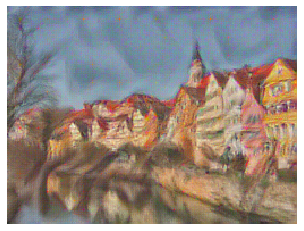

In [51]:
# Composition VII + Tubingen
params1 = {
    'content_image' : 'styles/tubingen.jpg',
    'style_image' : 'styles/composition_vii.jpg',
    'image_size' : 192,
    'style_size' : 512,
    'content_layer' : 3,
    'content_weight' : 5e-2, 
    'style_layers' : (1, 4, 6, 7),
    'style_weights' : (20000, 500, 12, 1),
    'tv_weight' : 5e-2
}

style_transfer(**params1)

[tensor([[[[1.4045e+00, 1.3991e+00, 1.4167e+00,  ..., 1.6555e+00,
           1.6585e+00, 1.6740e+00],
          [1.3914e+00, 1.4067e+00, 1.4585e+00,  ..., 1.6310e+00,
           1.6535e+00, 1.6837e+00],
          [1.4507e+00, 1.3805e+00, 1.2793e+00,  ..., 1.6648e+00,
           1.6551e+00, 1.7271e+00],
          ...,
          [8.6090e-01, 8.7313e-01, 9.2216e-01,  ..., 4.7700e-01,
           4.1022e-01, 4.2663e-01],
          [8.7173e-01, 8.8907e-01, 9.0449e-01,  ..., 5.4801e-01,
           5.0989e-01, 5.4026e-01],
          [8.6761e-01, 9.1816e-01, 9.0512e-01,  ..., 4.9316e-01,
           4.3647e-01, 5.8950e-01]],

         [[0.0000e+00, 0.0000e+00, 3.1706e-01,  ..., 8.0888e-02,
           7.1759e-02, 5.1046e-02],
          [8.3821e-02, 9.5538e-02, 2.4084e-01,  ..., 7.0147e-02,
           6.1948e-02, 7.1490e-02],
          [4.0346e-01, 6.6374e-02, 1.7668e-02,  ..., 8.7499e-02,
           4.5348e-02, 8.8522e-02],
          ...,
          [4.2776e-03, 0.0000e+00, 3.9169e-02,  ..., 5.996

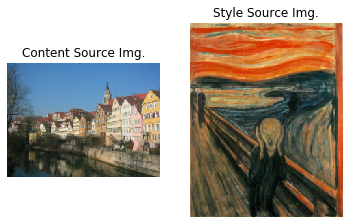

[tensor([[[[1.4045e+00, 1.3991e+00, 1.4167e+00,  ..., 1.6555e+00,
           1.6585e+00, 1.6740e+00],
          [1.3914e+00, 1.4067e+00, 1.4585e+00,  ..., 1.6310e+00,
           1.6535e+00, 1.6837e+00],
          [1.4507e+00, 1.3805e+00, 1.2793e+00,  ..., 1.6648e+00,
           1.6551e+00, 1.7271e+00],
          ...,
          [8.0056e-01, 7.8659e-01, 7.9820e-01,  ..., 4.7700e-01,
           4.1022e-01, 4.2663e-01],
          [7.8924e-01, 7.7921e-01, 8.2491e-01,  ..., 5.4801e-01,
           5.0989e-01, 5.4026e-01],
          [7.9524e-01, 7.7917e-01, 8.5735e-01,  ..., 4.9316e-01,
           4.3647e-01, 5.8950e-01]],

         [[0.0000e+00, 0.0000e+00, 3.1706e-01,  ..., 8.0888e-02,
           7.1759e-02, 5.1046e-02],
          [8.3821e-02, 9.5538e-02, 2.4084e-01,  ..., 7.0147e-02,
           6.1948e-02, 7.1490e-02],
          [4.0346e-01, 6.6374e-02, 1.7668e-02,  ..., 8.7499e-02,
           4.5348e-02, 8.8522e-02],
          ...,
          [1.7013e-02, 8.3940e-04, 8.9472e-03,  ..., 5.996

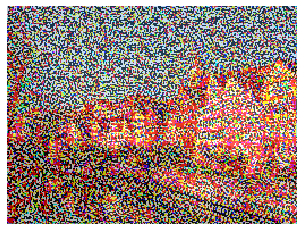

[tensor([[[[0.7669, 0.5146, 2.4173,  ..., 0.6311, 1.0899, 1.3281],
          [1.0432, 2.3718, 5.0838,  ..., 0.0000, 0.0581, 0.0000],
          [0.7753, 0.9010, 2.1713,  ..., 0.0000, 1.2285, 0.0000],
          ...,
          [3.4958, 0.9003, 0.9692,  ..., 1.4398, 0.6241, 1.4638],
          [6.7109, 4.1251, 4.8525,  ..., 2.0050, 0.1948, 4.3479],
          [5.8554, 4.4794, 4.5493,  ..., 1.4708, 0.7814, 6.0490]],

         [[1.6658, 0.0000, 2.2028,  ..., 0.0000, 0.4504, 1.1859],
          [0.0000, 0.0000, 1.0857,  ..., 0.0000, 0.0000, 5.1338],
          [2.2796, 0.0000, 0.0000,  ..., 0.0000, 0.1018, 0.0000],
          ...,
          [1.0234, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 3.0930],
          [0.0000, 0.0000, 0.0000,  ..., 0.9486, 0.9034, 0.0000],
          [0.4678, 0.1196, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.7998, 4.5737, 0.0000],
          [3.1006, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [2.5842, 6.8334, 0.2385,  ..., 

[tensor([[[[0.3484, 0.0000, 0.5098,  ..., 0.0000, 0.1929, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 2.7087],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.1926, 1.9568,  ..., 1.9413, 3.2203, 0.6277],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 2.7697, 0.0000],
          [0.0167, 0.0000, 0.0000,  ..., 0.2185, 0.6805, 0.0000]],

         [[0.0000, 0.8422, 0.0000,  ..., 1.8830, 0.0000, 0.0000],
          [0.1170, 1.0209, 0.0000,  ..., 0.0000, 1.0921, 0.0000],
          [0.0000, 2.1153, 2.4730,  ..., 2.7829, 0.0000, 6.2529],
          ...,
          [0.0000, 1.4162, 0.0000,  ..., 1.0425, 3.8776, 0.0000],
          [1.7832, 3.4234, 0.9262,  ..., 1.2256, 0.0000, 1.4207],
          [0.0000, 0.6894, 0.0000,  ..., 0.0000, 0.1846, 1.1457]],

         [[2.1110, 4.9984, 2.9023,  ..., 1.6237, 0.0000, 2.6505],
          [1.4891, 0.0000, 0.1014,  ..., 3.6958, 7.4276, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.0000e+00, 0.0000e+00, 3.9390e-01,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          ...,
          [0.0000e+00, 9.1165e-01, 4.2209e-02,  ..., 9.6617e-01,
           8.9907e-01, 2.8019e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           3.6818e+00, 5.7277e+00],
          [1.0229e+00, 0.0000e+00, 6.6710e-01,  ..., 0.0000e+00,
           5.4006e-01, 0.0000e+00]],

         [[0.0000e+00, 9.6719e-01, 0.0000e+00,  ..., 2.1657e+00,
           2.3595e-01, 0.0000e+00],
          [1.2267e+00, 1.5682e-01, 0.0000e+00,  ..., 0.0000e+00,
           7.9171e-01, 5.8859e-02],
          [2.3055e+00, 1.2712e-01, 6.5735e-01,  ..., 2.0554e+00,
           0.0000e+00, 3.4851e+00],
          ...,
          [0.0000e+00, 1.4459e+00, 1.1405e+00,  ..., 3.884

[tensor([[[[0.0000, 0.0000, 0.0000,  ..., 0.0342, 0.2056, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [1.9819, 0.9760, 0.0000,  ..., 1.5512, 0.3730, 3.2426],
          [0.0000, 0.0000, 0.0000,  ..., 0.5254, 3.7000, 6.8454],
          [0.9950, 0.0000, 0.8547,  ..., 2.3491, 1.6213, 0.7996]],

         [[0.0000, 1.1230, 0.0000,  ..., 0.5566, 0.5524, 0.0000],
          [1.9517, 0.0000, 0.0000,  ..., 0.0507, 0.0000, 2.2681],
          [3.1543, 0.0000, 0.0911,  ..., 0.7261, 0.1664, 0.0000],
          ...,
          [0.4032, 0.0000, 1.2368,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.8625,  ..., 1.9486, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.3792,  ..., 0.0000, 0.7940, 0.6193]],

         [[0.0000, 0.0000, 1.4660,  ..., 1.5067, 5.0310, 0.0000],
          [0.0000, 1.3695, 0.0000,  ..., 2.1968, 0.0644, 3.5953],
          [0.0000, 3.9837, 1.9012,  ..., 

[tensor([[[[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.1621,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [1.8990, 1.5415, 0.7180,  ..., 2.3601, 0.8376, 1.8078],
          [0.0000, 0.0000, 1.1582,  ..., 1.9540, 2.0777, 4.4519],
          [0.0000, 0.0000, 0.6792,  ..., 3.3171, 2.4467, 1.5068]],

         [[0.0000, 0.5858, 0.4865,  ..., 0.0000, 0.0000, 0.0000],
          [1.2646, 0.3012, 0.0000,  ..., 1.0140, 0.9708, 2.4393],
          [1.3946, 0.0000, 0.1692,  ..., 0.0000, 0.8822, 0.0000],
          ...,
          [0.9727, 0.0000, 0.7221,  ..., 0.3864, 0.0000, 1.2424],
          [0.0000, 0.0000, 0.0000,  ..., 1.0408, 0.0000, 0.0000],
          [0.0000, 0.3757, 0.5503,  ..., 0.0000, 0.6220, 0.3834]],

         [[0.0000, 0.0000, 0.0000,  ..., 1.5012, 5.6719, 0.0000],
          [0.0000, 0.5233, 0.0000,  ..., 0.5850, 0.0000, 3.6305],
          [0.0000, 3.7886, 1.1406,  ..., 

[tensor([[[[0.0000e+00, 9.0675e-01, 0.0000e+00,  ..., 0.0000e+00,
           2.1377e-01, 0.0000e+00],
          [8.4843e-01, 0.0000e+00, 0.0000e+00,  ..., 5.2444e-01,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 7.8540e-01],
          ...,
          [8.6575e-01, 1.4928e+00, 1.2819e+00,  ..., 3.2475e+00,
           1.1434e+00, 1.0405e+00],
          [2.1060e-01, 1.2872e+00, 1.9615e+00,  ..., 3.1175e+00,
           9.3544e-01, 2.2274e+00],
          [0.0000e+00, 0.0000e+00, 5.5198e-01,  ..., 3.0555e+00,
           2.5416e+00, 1.7903e+00]],

         [[3.3173e-03, 1.2062e-01, 1.9848e-01,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [1.4538e-01, 9.8172e-01, 6.3932e-01,  ..., 7.6972e-01,
           1.9472e+00, 2.2743e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           1.5292e+00, 0.0000e+00],
          ...,
          [1.9687e+00, 0.0000e+00, 2.6427e-01,  ..., 1.080

[tensor([[[[0.0000, 1.8097, 0.0000,  ..., 0.0000, 2.1561, 1.7756],
          [1.8298, 0.1361, 0.0000,  ..., 0.6286, 0.1684, 0.0000],
          [0.9038, 0.7108, 0.0000,  ..., 0.0000, 0.0000, 1.2823],
          ...,
          [0.0817, 1.5665, 0.9749,  ..., 3.4907, 1.3671, 1.3421],
          [0.5164, 1.7119, 1.1694,  ..., 3.3004, 0.8845, 1.3463],
          [0.0609, 0.2387, 0.8798,  ..., 1.9653, 2.2725, 1.4131]],

         [[0.9809, 0.0000, 0.0000,  ..., 0.0000, 0.6675, 0.0000],
          [0.0000, 0.5560, 0.6947,  ..., 0.0000, 1.3767, 1.4434],
          [0.0000, 1.3824, 0.0000,  ..., 0.0000, 2.0606, 0.0000],
          ...,
          [2.0277, 0.0000, 0.4890,  ..., 1.4479, 0.0000, 1.7587],
          [0.0000, 1.2008, 0.0000,  ..., 0.0000, 1.3525, 0.0000],
          [0.0000, 0.8308, 0.4344,  ..., 0.0000, 1.1824, 0.0000]],

         [[0.0000, 1.4584, 0.0000,  ..., 0.2717, 2.8370, 0.0000],
          [0.0000, 0.2267, 1.1390,  ..., 0.0000, 0.0000, 2.3365],
          [0.2368, 0.6232, 0.0000,  ..., 

[tensor([[[[0.7561, 2.2806, 0.0000,  ..., 0.0000, 2.9034, 3.2381],
          [1.9760, 0.6527, 0.1098,  ..., 0.5452, 1.5280, 1.6466],
          [0.6498, 1.2154, 0.0000,  ..., 0.0000, 0.0000, 1.6508],
          ...,
          [0.1237, 1.7086, 0.4604,  ..., 2.5410, 1.5724, 2.1055],
          [0.7441, 1.3758, 0.9445,  ..., 2.4340, 1.0951, 1.4204],
          [0.2950, 1.2719, 0.7740,  ..., 1.1442, 2.1583, 1.2764]],

         [[1.1172, 0.0000, 0.0000,  ..., 0.0000, 0.9429, 0.0000],
          [0.0000, 0.0000, 0.5386,  ..., 0.0000, 0.0000, 0.9067],
          [0.0000, 1.9078, 0.0000,  ..., 0.0000, 2.0744, 0.0000],
          ...,
          [1.0809, 0.0000, 0.7193,  ..., 1.2619, 0.0000, 1.4602],
          [0.1041, 0.6723, 0.0000,  ..., 0.0000, 0.8232, 0.0000],
          [0.0000, 0.4872, 0.5866,  ..., 0.0000, 1.4476, 0.0000]],

         [[0.2419, 1.1922, 0.4360,  ..., 0.6983, 1.8567, 0.0000],
          [0.0000, 0.6876, 1.1545,  ..., 0.4605, 0.0000, 0.1892],
          [0.8726, 0.0000, 0.0000,  ..., 

[tensor([[[[1.2160, 2.0382, 0.5327,  ..., 0.0000, 3.1634, 3.8107],
          [1.4483, 0.6953, 0.8213,  ..., 0.7402, 2.1519, 2.9393],
          [0.0000, 1.4438, 0.0000,  ..., 0.0000, 0.0000, 1.6313],
          ...,
          [0.4405, 1.7000, 0.0000,  ..., 2.0842, 2.1461, 2.9884],
          [0.4526, 0.6908, 1.1628,  ..., 2.0531, 2.0025, 1.9882],
          [0.5185, 1.8429, 0.6965,  ..., 0.8800, 2.0717, 1.2036]],

         [[1.0218, 0.0000, 0.0000,  ..., 0.0000, 1.0004, 0.1357],
          [0.0525, 0.0000, 0.5697,  ..., 0.0000, 0.0000, 0.2229],
          [0.0000, 1.8406, 0.0000,  ..., 0.0000, 1.3680, 0.9912],
          ...,
          [0.0433, 0.2049, 0.2999,  ..., 0.8207, 0.0000, 0.7689],
          [0.8291, 0.0000, 0.0841,  ..., 0.0000, 0.1492, 0.4927],
          [0.0000, 0.4734, 0.5790,  ..., 0.1673, 1.5790, 0.0000]],

         [[1.1232, 0.0000, 0.5693,  ..., 0.7307, 0.7868, 0.0000],
          [1.1050, 0.9544, 1.1278,  ..., 1.0018, 0.7557, 0.0000],
          [0.8776, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0808, 1.6037, 1.0165,  ..., 0.0000, 3.0214, 3.1658],
          [0.6120, 0.7299, 1.2136,  ..., 1.1890, 2.2293, 3.1373],
          [0.0000, 1.6701, 0.0000,  ..., 0.1275, 0.8652, 1.3658],
          ...,
          [0.7407, 1.4630, 0.0000,  ..., 2.1181, 2.6391, 2.9065],
          [0.1536, 0.0000, 1.4066,  ..., 1.7717, 2.6812, 2.1316],
          [0.7047, 1.7565, 0.2603,  ..., 0.5573, 2.0357, 1.4398]],

         [[0.7637, 0.0000, 0.4633,  ..., 0.0000, 0.8100, 0.2598],
          [0.3835, 0.0000, 0.5445,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 1.4357, 0.0000,  ..., 0.6407, 0.5025, 1.5536],
          ...,
          [0.0000, 1.0037, 0.0000,  ..., 0.1811, 0.0000, 0.0000],
          [1.2799, 0.0000, 0.1544,  ..., 0.0000, 0.0000, 0.8912],
          [0.0000, 0.4725, 0.2983,  ..., 0.3951, 0.9631, 0.0000]],

         [[0.7569, 0.0000, 0.6000,  ..., 0.0000, 0.0000, 0.0000],
          [2.2218, 1.3422, 0.8364,  ..., 0.2475, 1.6683, 0.0000],
          [0.4060, 0.0000, 0.0000,  ..., 

[tensor([[[[7.9658e-01, 1.1593e+00, 1.2007e+00,  ..., 8.4244e-01,
           3.0870e+00, 2.0837e+00],
          [5.3423e-02, 5.6705e-01, 9.7560e-01,  ..., 1.6362e+00,
           2.4188e+00, 2.6579e+00],
          [0.0000e+00, 1.4999e+00, 0.0000e+00,  ..., 5.5503e-01,
           1.4941e+00, 9.2082e-01],
          ...,
          [9.0449e-01, 1.3684e+00, 2.5525e-01,  ..., 2.0256e+00,
           2.6928e+00, 2.4260e+00],
          [2.4614e-02, 0.0000e+00, 9.2457e-01,  ..., 1.6190e+00,
           2.8471e+00, 1.9595e+00],
          [7.9281e-01, 1.3256e+00, 0.0000e+00,  ..., 2.6191e-01,
           2.0834e+00, 1.7892e+00]],

         [[1.5582e-01, 0.0000e+00, 7.7292e-01,  ..., 0.0000e+00,
           3.0822e-01, 2.7791e-01],
          [5.5418e-01, 0.0000e+00, 1.7571e-01,  ..., 1.0769e-02,
           6.3614e-01, 0.0000e+00],
          [0.0000e+00, 1.2283e+00, 3.6091e-01,  ..., 1.0550e+00,
           1.9200e-02, 1.3789e+00],
          ...,
          [0.0000e+00, 1.4659e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[0.4140, 0.6038, 1.2479,  ..., 1.5956, 3.0361, 1.3566],
          [0.0000, 0.2809, 0.6323,  ..., 1.8964, 2.6048, 1.9837],
          [0.0000, 0.9804, 0.0000,  ..., 0.8500, 1.9438, 0.5229],
          ...,
          [0.9845, 1.3456, 0.7711,  ..., 1.7893, 2.4850, 2.2134],
          [0.0045, 0.0000, 0.4569,  ..., 1.5506, 2.5000, 1.5347],
          [0.7290, 0.8785, 0.0000,  ..., 0.0000, 1.8609, 2.0686]],

         [[0.0000, 0.0000, 0.6990,  ..., 0.0000, 0.0000, 0.4836],
          [0.4876, 0.0000, 0.0000,  ..., 0.2541, 0.5804, 0.0000],
          [0.0000, 0.9775, 0.7532,  ..., 1.1591, 0.0000, 1.0066],
          ...,
          [0.0731, 1.3259, 0.0000,  ..., 0.0000, 0.9556, 0.0000],
          [0.9326, 0.0000, 0.2662,  ..., 0.7773, 0.0000, 0.3191],
          [0.1099, 0.6536, 0.0000,  ..., 0.5949, 0.0000, 0.0000]],

         [[0.1357, 0.0000, 0.6656,  ..., 0.0000, 0.0000, 1.3705],
          [0.6118, 1.0174, 0.0000,  ..., 0.0000, 0.1768, 0.4461],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.0000e+00, 4.4541e-01, 9.7677e-01,  ..., 1.6497e+00,
           2.7646e+00, 1.1209e+00],
          [0.0000e+00, 3.5756e-01, 1.9506e-01,  ..., 1.7632e+00,
           2.8986e+00, 1.8232e+00],
          [0.0000e+00, 5.7720e-01, 0.0000e+00,  ..., 9.1649e-01,
           2.1970e+00, 3.5067e-01],
          ...,
          [9.5410e-01, 1.0862e+00, 9.9892e-01,  ..., 1.3866e+00,
           2.1566e+00, 2.0865e+00],
          [0.0000e+00, 0.0000e+00, 1.8192e-01,  ..., 1.3580e+00,
           1.7718e+00, 1.0181e+00],
          [6.1878e-01, 5.8850e-01, 0.0000e+00,  ..., 0.0000e+00,
           1.4396e+00, 2.1491e+00]],

         [[0.0000e+00, 0.0000e+00, 2.5992e-01,  ..., 2.4468e-02,
           0.0000e+00, 6.3986e-01],
          [3.3296e-01, 4.0444e-02, 0.0000e+00,  ..., 3.2411e-01,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 4.8386e-01, 8.5464e-01,  ..., 1.0168e+00,
           0.0000e+00, 7.9407e-01],
          ...,
          [2.6002e-01, 8.7975e-01, 0.0000e+00,  ..., 0.000

[tensor([[[[0.0000, 0.3239, 0.4845,  ..., 1.3145, 2.4434, 1.1831],
          [0.0000, 0.3147, 0.0000,  ..., 1.5600, 2.9340, 1.7398],
          [0.0000, 0.2060, 0.0000,  ..., 0.8195, 2.2071, 0.1545],
          ...,
          [0.8997, 0.7763, 1.0146,  ..., 0.9540, 1.6569, 2.0852],
          [0.0000, 0.0000, 0.0000,  ..., 1.1350, 1.0083, 0.5435],
          [0.5605, 0.3755, 0.0000,  ..., 0.0000, 0.9242, 1.8684]],

         [[0.0000, 0.1709, 0.0000,  ..., 0.2050, 0.0000, 0.4694],
          [0.1805, 0.6105, 0.0000,  ..., 0.3010, 0.0000, 0.0000],
          [0.0000, 0.0383, 0.7268,  ..., 0.7530, 0.0000, 0.4653],
          ...,
          [0.3220, 0.4763, 0.0000,  ..., 0.0000, 0.6943, 0.0000],
          [0.2906, 0.0000, 0.1417,  ..., 1.0261, 0.0000, 0.0000],
          [0.2949, 0.9731, 0.0176,  ..., 0.3973, 0.0000, 0.0000]],

         [[0.2167, 1.1831, 0.7587,  ..., 1.6291, 0.0000, 0.6470],
          [0.0000, 0.0000, 0.0000,  ..., 0.3703, 0.0000, 0.1310],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.0000, 0.0532, 0.1061,  ..., 1.2733, 2.3814, 1.1975],
          [0.0000, 0.2011, 0.0000,  ..., 1.3682, 2.6704, 1.5140],
          [0.0000, 0.0000, 0.0000,  ..., 0.6792, 2.1327, 0.0239],
          ...,
          [0.8459, 0.7484, 0.9551,  ..., 0.8504, 1.2606, 2.0571],
          [0.0272, 0.0000, 0.0000,  ..., 1.0223, 0.4487, 0.1328],
          [0.5896, 0.1991, 0.0000,  ..., 0.0000, 0.4566, 1.4759]],

         [[0.0000, 0.2813, 0.0000,  ..., 0.2453, 0.0000, 0.0538],
          [0.1306, 0.8587, 0.0000,  ..., 0.3221, 0.0000, 0.0671],
          [0.0000, 0.0000, 0.4797,  ..., 0.3918, 0.2496, 0.1316],
          ...,
          [0.3577, 0.1545, 0.0000,  ..., 0.0209, 0.4080, 0.5045],
          [0.2337, 0.0000, 0.2800,  ..., 0.5829, 0.0163, 0.0000],
          [0.1605, 0.7760, 0.2410,  ..., 0.2645, 0.0000, 0.0410]],

         [[0.2839, 0.8989, 0.5013,  ..., 0.7304, 0.0000, 0.3419],
          [0.0000, 0.0000, 0.0000,  ..., 0.1221, 0.0000, 0.1035],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.0000, 0.0000, 0.0000,  ..., 1.4588, 2.5319, 1.1541],
          [0.0000, 0.0000, 0.0000,  ..., 1.1619, 2.3376, 1.1347],
          [0.0000, 0.0000, 0.0000,  ..., 0.5264, 2.0550, 0.1009],
          ...,
          [0.8506, 0.9882, 0.9907,  ..., 0.9141, 0.8947, 1.8684],
          [0.1877, 0.2737, 0.0000,  ..., 1.0104, 0.1251, 0.0000],
          [0.6527, 0.0584, 0.0000,  ..., 0.0000, 0.2975, 1.0890]],

         [[0.0000, 0.3755, 0.0000,  ..., 0.2948, 0.0000, 0.0000],
          [0.2734, 0.7566, 0.0000,  ..., 0.2133, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.2788,  ..., 0.0918, 0.6389, 0.0000],
          ...,
          [0.3988, 0.0000, 0.0517,  ..., 0.1964, 0.2207, 1.0843],
          [0.2702, 0.0000, 0.3696,  ..., 0.1038, 0.3256, 0.0000],
          [0.1037, 0.4737, 0.4756,  ..., 0.1072, 0.0000, 0.0800]],

         [[0.1829, 0.2065, 0.1583,  ..., 0.0000, 0.0000, 0.0935],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0599, 0.0982],
          [0.0000, 0.0400, 0.0000,  ..., 

[tensor([[[[0.0000, 0.0000, 0.0000,  ..., 1.5487, 2.7510, 1.1101],
          [0.0000, 0.0000, 0.0000,  ..., 1.0163, 2.1227, 0.8338],
          [0.0000, 0.0000, 0.0000,  ..., 0.3935, 2.0080, 0.3002],
          ...,
          [0.9151, 1.3379, 1.0939,  ..., 0.9994, 0.5762, 1.5770],
          [0.3304, 0.5333, 0.0000,  ..., 1.0624, 0.0000, 0.0000],
          [0.7835, 0.0000, 0.0000,  ..., 0.0000, 0.3847, 0.6156]],

         [[0.0000, 0.4341, 0.0000,  ..., 0.2767, 0.0000, 0.0000],
          [0.4643, 0.4859, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.1532,  ..., 0.0000, 0.7665, 0.0000],
          ...,
          [0.3361, 0.0000, 0.4906,  ..., 0.3762, 0.0523, 1.1247],
          [0.3189, 0.0000, 0.2486,  ..., 0.0000, 0.4091, 0.0000],
          [0.0369, 0.0703, 0.4869,  ..., 0.0000, 0.1504, 0.1010]],

         [[0.0721, 0.0000, 0.0000,  ..., 0.0000, 0.1742, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.3626, 0.0000],
          [0.2041, 0.1343, 0.0000,  ..., 

[tensor([[[[0.0000, 0.0000, 0.0000,  ..., 1.4783, 2.8668, 1.0621],
          [0.0000, 0.0000, 0.0000,  ..., 0.8883, 2.0489, 0.7366],
          [0.0000, 0.0000, 0.0000,  ..., 0.3070, 2.0362, 0.5866],
          ...,
          [0.9219, 1.5192, 1.1842,  ..., 0.9549, 0.2889, 1.1779],
          [0.3455, 0.6808, 0.0987,  ..., 1.0963, 0.0000, 0.0000],
          [0.8716, 0.0601, 0.0000,  ..., 0.1816, 0.3568, 0.0951]],

         [[0.0828, 0.2863, 0.0000,  ..., 0.2392, 0.0000, 0.0000],
          [0.7274, 0.2119, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.1103,  ..., 0.0000, 0.4795, 0.0000],
          ...,
          [0.2820, 0.0000, 0.8076,  ..., 0.5505, 0.0000, 0.7812],
          [0.1072, 0.0000, 0.1356,  ..., 0.0000, 0.2999, 0.0000],
          [0.0000, 0.0000, 0.3350,  ..., 0.0000, 0.3000, 0.1089]],

         [[0.0469, 0.0000, 0.0000,  ..., 0.0000, 0.5517, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0632, 0.1504, 0.0000,  ..., 

[tensor([[[[0.0000, 0.0000, 0.0000,  ..., 1.3469, 2.8607, 1.0594],
          [0.0000, 0.0128, 0.0000,  ..., 0.6979, 1.9607, 0.7085],
          [0.0000, 0.0000, 0.0000,  ..., 0.3305, 2.0570, 0.8375],
          ...,
          [0.8902, 1.2872, 1.2345,  ..., 0.8174, 0.0524, 0.8053],
          [0.2958, 0.7570, 0.3455,  ..., 1.0640, 0.0000, 0.0000],
          [0.8265, 0.1471, 0.0000,  ..., 0.5303, 0.3039, 0.0000]],

         [[0.2532, 0.0773, 0.0000,  ..., 0.1272, 0.0000, 0.0000],
          [0.8187, 0.0107, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.1594,  ..., 0.0000, 0.1323, 0.0000],
          ...,
          [0.1844, 0.0000, 0.7820,  ..., 0.6408, 0.0000, 0.4259],
          [0.0000, 0.0000, 0.1221,  ..., 0.0000, 0.1273, 0.0000],
          [0.0000, 0.1661, 0.2090,  ..., 0.0000, 0.3920, 0.1261]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.3158, 0.3562, 0.0000],
          [0.0769, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0678, 0.0000,  ..., 

[tensor([[[[0.0000, 0.2342, 0.1144,  ..., 1.2811, 2.8171, 1.0621],
          [0.0203, 0.3393, 0.0000,  ..., 0.5207, 1.8704, 0.6725],
          [0.0000, 0.0000, 0.0000,  ..., 0.3360, 2.0164, 0.9150],
          ...,
          [0.8543, 1.0288, 1.2468,  ..., 0.6446, 0.0000, 0.4606],
          [0.3698, 0.9165, 0.5856,  ..., 0.9632, 0.0000, 0.0000],
          [0.6762, 0.1845, 0.0000,  ..., 0.7600, 0.2635, 0.0000]],

         [[0.3583, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.3067],
          [0.8001, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0931, 0.2275,  ..., 0.0000, 0.0113, 0.0000],
          ...,
          [0.1061, 0.0000, 0.5854,  ..., 0.5907, 0.0000, 0.2613],
          [0.0000, 0.0473, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.3345, 0.1436,  ..., 0.0000, 0.3986, 0.1596]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.1891, 0.0000, 0.0000],
          [0.0811, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0122, 0.0000,  ..., 

[tensor([[[[0.0000, 0.5723, 0.1667,  ..., 1.2311, 2.7023, 1.0312],
          [0.3136, 0.7084, 0.1318,  ..., 0.3895, 1.8276, 0.5981],
          [0.0000, 0.0000, 0.0000,  ..., 0.3578, 1.9729, 0.9245],
          ...,
          [0.8362, 0.8898, 1.2716,  ..., 0.4974, 0.0000, 0.1736],
          [0.5734, 0.8990, 0.7081,  ..., 0.8713, 0.0000, 0.0000],
          [0.6391, 0.1428, 0.0000,  ..., 0.8798, 0.2486, 0.0000]],

         [[0.4269, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.4883],
          [0.6526, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.2231, 0.2411, 0.2633,  ..., 0.0000, 0.0729, 0.0000],
          ...,
          [0.1640, 0.1866, 0.3077,  ..., 0.4534, 0.0325, 0.1838],
          [0.0812, 0.0252, 0.0000,  ..., 0.0339, 0.0000, 0.0000],
          [0.0000, 0.3096, 0.2010,  ..., 0.0143, 0.3027, 0.1940]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1225],
          [0.0000, 0.2133, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.0000, 0.8049, 0.2581,  ..., 1.1383, 2.5597, 0.9704],
          [0.5378, 0.9912, 0.3730,  ..., 0.2975, 1.7877, 0.4863],
          [0.0000, 0.0723, 0.0000,  ..., 0.3710, 2.0004, 1.0014],
          ...,
          [0.8514, 0.8940, 1.2934,  ..., 0.3731, 0.0000, 0.0218],
          [0.8714, 0.8698, 0.7463,  ..., 0.8079, 0.0254, 0.0000],
          [0.5135, 0.0374, 0.0000,  ..., 0.9293, 0.2675, 0.0000]],

         [[0.4675, 0.0227, 0.0000,  ..., 0.0000, 0.1191, 0.4038],
          [0.4076, 0.0000, 0.0579,  ..., 0.0717, 0.0000, 0.0000],
          [0.4367, 0.3595, 0.2812,  ..., 0.0000, 0.0736, 0.0000],
          ...,
          [0.2676, 0.2000, 0.0820,  ..., 0.2981, 0.1519, 0.0760],
          [0.2281, 0.0000, 0.0000,  ..., 0.1911, 0.0000, 0.0000],
          [0.0000, 0.1854, 0.2489,  ..., 0.1024, 0.1509, 0.2133]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.4046],
          [0.0000, 0.1530, 0.0098,  ..., 0.2471, 0.0865, 0.1451],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.1174, 0.9096, 0.3158,  ..., 0.9563, 2.3661, 0.8540],
          [0.6851, 1.1138, 0.5311,  ..., 0.1915, 1.6624, 0.3032],
          [0.0000, 0.2619, 0.0000,  ..., 0.3241, 1.9824, 0.9323],
          ...,
          [0.8760, 0.9773, 1.2517,  ..., 0.2762, 0.0000, 0.0000],
          [1.1254, 0.9396, 0.7885,  ..., 0.7555, 0.0938, 0.0000],
          [0.3719, 0.0000, 0.0000,  ..., 0.9164, 0.3056, 0.0000]],

         [[0.3903, 0.1693, 0.0000,  ..., 0.0000, 0.1906, 0.1770],
          [0.1298, 0.0726, 0.1933,  ..., 0.1140, 0.0000, 0.0000],
          [0.5632, 0.4429, 0.2718,  ..., 0.0000, 0.1606, 0.0000],
          ...,
          [0.2442, 0.2202, 0.0000,  ..., 0.1631, 0.2307, 0.0533],
          [0.3339, 0.0000, 0.0000,  ..., 0.3296, 0.0000, 0.0000],
          [0.0000, 0.0789, 0.2457,  ..., 0.1474, 0.0133, 0.2193]],

         [[0.0000, 0.1053, 0.0000,  ..., 0.0000, 0.0000, 0.3796],
          [0.0000, 0.0000, 0.1863,  ..., 0.3518, 0.4682, 0.5040],
          [0.0000, 0.0000, 0.1330,  ..., 

[tensor([[[[0.2666, 0.9479, 0.3434,  ..., 0.7294, 2.1160, 0.6828],
          [0.7739, 1.1256, 0.6168,  ..., 0.1054, 1.4772, 0.0551],
          [0.0447, 0.4091, 0.0093,  ..., 0.2173, 1.9182, 0.7648],
          ...,
          [0.8254, 1.0560, 1.1983,  ..., 0.2150, 0.0000, 0.0000],
          [1.2288, 1.0278, 0.8936,  ..., 0.7108, 0.1437, 0.0000],
          [0.3163, 0.0000, 0.0000,  ..., 0.8525, 0.3627, 0.0000]],

         [[0.2540, 0.2956, 0.0000,  ..., 0.0000, 0.2126, 0.0000],
          [0.0000, 0.1201, 0.2636,  ..., 0.0883, 0.0000, 0.0000],
          [0.5945, 0.4888, 0.2464,  ..., 0.0000, 0.2671, 0.0000],
          ...,
          [0.1522, 0.2938, 0.0000,  ..., 0.0861, 0.2757, 0.0796],
          [0.3233, 0.0000, 0.0000,  ..., 0.4079, 0.0840, 0.0000],
          [0.0000, 0.0300, 0.2907,  ..., 0.1643, 0.0000, 0.2292]],

         [[0.0000, 0.2226, 0.0000,  ..., 0.1963, 0.1320, 0.2431],
          [0.0000, 0.0000, 0.3111,  ..., 0.0717, 0.5495, 0.5251],
          [0.0000, 0.0000, 0.2248,  ..., 

[tensor([[[[0.3919, 0.9407, 0.3479,  ..., 0.5547, 1.9693, 0.5199],
          [0.8096, 1.0649, 0.6403,  ..., 0.0365, 1.3356, 0.0000],
          [0.1499, 0.5210, 0.1632,  ..., 0.1129, 1.8314, 0.6084],
          ...,
          [0.7817, 1.0920, 1.1151,  ..., 0.1859, 0.0000, 0.0000],
          [1.2779, 0.9783, 0.9696,  ..., 0.6799, 0.1882, 0.0000],
          [0.2669, 0.0000, 0.0000,  ..., 0.7763, 0.4167, 0.0000]],

         [[0.1296, 0.3897, 0.0000,  ..., 0.0000, 0.2695, 0.0000],
          [0.0000, 0.1214, 0.2750,  ..., 0.0000, 0.0000, 0.0000],
          [0.5489, 0.4895, 0.2184,  ..., 0.0000, 0.3195, 0.0000],
          ...,
          [0.0501, 0.3819, 0.0000,  ..., 0.0854, 0.2795, 0.1209],
          [0.1909, 0.0000, 0.0000,  ..., 0.4144, 0.1722, 0.0000],
          [0.0000, 0.0000, 0.3928,  ..., 0.1476, 0.0000, 0.2392]],

         [[0.0000, 0.2121, 0.0000,  ..., 0.6669, 0.2798, 0.0751],
          [0.0000, 0.0000, 0.3698,  ..., 0.0000, 0.2515, 0.2510],
          [0.0000, 0.0000, 0.2709,  ..., 

[tensor([[[[5.0166e-01, 9.0260e-01, 3.3457e-01,  ..., 4.4616e-01,
           1.9640e+00, 3.9032e-01],
          [8.0665e-01, 9.5867e-01, 6.0712e-01,  ..., 0.0000e+00,
           1.3144e+00, 0.0000e+00],
          [2.2937e-01, 6.1903e-01, 2.8359e-01,  ..., 1.1723e-01,
           1.7919e+00, 4.9332e-01],
          ...,
          [7.7524e-01, 1.0941e+00, 1.0169e+00,  ..., 2.0359e-01,
           0.0000e+00, 0.0000e+00],
          [1.3777e+00, 8.2134e-01, 9.3420e-01,  ..., 6.6755e-01,
           2.3155e-01, 0.0000e+00],
          [1.7459e-01, 7.6505e-02, 0.0000e+00,  ..., 7.0857e-01,
           4.4177e-01, 0.0000e+00]],

         [[4.2997e-02, 4.4569e-01, 0.0000e+00,  ..., 0.0000e+00,
           4.4412e-01, 0.0000e+00],
          [0.0000e+00, 8.4164e-02, 2.2919e-01,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [4.2934e-01, 4.6160e-01, 1.8964e-01,  ..., 0.0000e+00,
           3.0059e-01, 0.0000e+00],
          ...,
          [0.0000e+00, 3.4578e-01, 0.0000e+00,  ..., 1.538

[tensor([[[[0.5783, 0.8764, 0.3314,  ..., 0.3612, 1.9831, 0.3291],
          [0.7602, 0.8716, 0.5764,  ..., 0.0175, 1.3625, 0.0000],
          [0.2850, 0.7143, 0.3947,  ..., 0.2226, 1.7623, 0.3989],
          ...,
          [0.6987, 1.0844, 0.9567,  ..., 0.2867, 0.0000, 0.0959],
          [1.4208, 0.6705, 0.8603,  ..., 0.6800, 0.2810, 0.0000],
          [0.1082, 0.1962, 0.0000,  ..., 0.6777, 0.4432, 0.0000]],

         [[0.0000, 0.4506, 0.0000,  ..., 0.0000, 0.4906, 0.0000],
          [0.0238, 0.0131, 0.1448,  ..., 0.0000, 0.0000, 0.0000],
          [0.2918, 0.4219, 0.1793,  ..., 0.0000, 0.3199, 0.0000],
          ...,
          [0.0000, 0.2513, 0.0000,  ..., 0.2415, 0.3014, 0.1688],
          [0.0025, 0.0000, 0.0000,  ..., 0.1755, 0.3395, 0.0000],
          [0.1217, 0.0776, 0.3748,  ..., 0.0445, 0.0000, 0.2554]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.2458,  ..., 0.0589, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.2623,  ..., 

[tensor([[[[0.6502, 0.9248, 0.3400,  ..., 0.3371, 2.0315, 0.3145],
          [0.7157, 0.8343, 0.5541,  ..., 0.1041, 1.4579, 0.0000],
          [0.3278, 0.8148, 0.5189,  ..., 0.3674, 1.7436, 0.3356],
          ...,
          [0.5347, 1.0486, 0.9716,  ..., 0.4021, 0.0000, 0.2187],
          [1.3412, 0.5685, 0.8407,  ..., 0.6764, 0.3181, 0.0000],
          [0.0652, 0.3143, 0.0000,  ..., 0.6516, 0.4131, 0.0000]],

         [[0.0000, 0.3653, 0.0000,  ..., 0.0000, 0.2538, 0.0024],
          [0.1527, 0.0000, 0.0409,  ..., 0.0000, 0.0237, 0.0000],
          [0.1602, 0.3747, 0.1823,  ..., 0.0000, 0.2008, 0.0000],
          ...,
          [0.0000, 0.0592, 0.0000,  ..., 0.2986, 0.2822, 0.1511],
          [0.0333, 0.0000, 0.0000,  ..., 0.0572, 0.3732, 0.0000],
          [0.1546, 0.1551, 0.3753,  ..., 0.0190, 0.0000, 0.2561]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.1152,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.1880,  ..., 

[tensor([[[[0.7328, 1.0814, 0.3555,  ..., 0.3452, 2.1402, 0.3516],
          [0.6930, 0.8545, 0.5383,  ..., 0.1652, 1.5514, 0.0000],
          [0.3582, 0.9176, 0.6524,  ..., 0.4830, 1.7051, 0.2981],
          ...,
          [0.3729, 1.0206, 1.0224,  ..., 0.5165, 0.0000, 0.3138],
          [1.2323, 0.4853, 0.8333,  ..., 0.6547, 0.3469, 0.0000],
          [0.0967, 0.3958, 0.0000,  ..., 0.6363, 0.3714, 0.0000]],

         [[0.0000, 0.2600, 0.0000,  ..., 0.0000, 0.0000, 0.1918],
          [0.2406, 0.0188, 0.0000,  ..., 0.0000, 0.1563, 0.0000],
          [0.0424, 0.2848, 0.1850,  ..., 0.0000, 0.1237, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0062,  ..., 0.3166, 0.2317, 0.1087],
          [0.0845, 0.0000, 0.0176,  ..., 0.0000, 0.3798, 0.0000],
          [0.1624, 0.2253, 0.4453,  ..., 0.0224, 0.0000, 0.2322]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0147, 0.0051],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0615,  ..., 

[tensor([[[[0.8066, 1.2656, 0.3613,  ..., 0.3781, 2.1964, 0.3983],
          [0.6805, 0.8965, 0.5290,  ..., 0.2205, 1.5658, 0.0000],
          [0.3888, 1.0007, 0.7632,  ..., 0.5835, 1.6517, 0.2500],
          ...,
          [0.2675, 1.0447, 1.0255,  ..., 0.6059, 0.1131, 0.3752],
          [1.1677, 0.4552, 0.7676,  ..., 0.6143, 0.3731, 0.0851],
          [0.1921, 0.4605, 0.0000,  ..., 0.6295, 0.3372, 0.0000]],

         [[0.0000, 0.1954, 0.0000,  ..., 0.0000, 0.1102, 0.2140],
          [0.2782, 0.0954, 0.0000,  ..., 0.0000, 0.0767, 0.0000],
          [0.0000, 0.1855, 0.1903,  ..., 0.0000, 0.1507, 0.0000],
          ...,
          [0.0371, 0.0000, 0.0000,  ..., 0.2861, 0.1921, 0.0774],
          [0.1485, 0.0000, 0.0054,  ..., 0.0000, 0.3325, 0.0000],
          [0.1697, 0.2829, 0.5476,  ..., 0.0527, 0.0000, 0.1979]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0544, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.8716, 1.4011, 0.3510,  ..., 0.4109, 2.2074, 0.4431],
          [0.6930, 0.9338, 0.5237,  ..., 0.2553, 1.5634, 0.0000],
          [0.4385, 1.0598, 0.8523,  ..., 0.6396, 1.6353, 0.2350],
          ...,
          [0.2241, 1.0985, 0.9596,  ..., 0.6456, 0.2294, 0.4265],
          [1.1646, 0.5232, 0.6346,  ..., 0.5245, 0.3575, 0.1919],
          [0.3389, 0.5106, 0.0000,  ..., 0.6134, 0.2985, 0.0000]],

         [[0.0000, 0.1979, 0.0000,  ..., 0.0000, 0.2589, 0.1473],
          [0.2486, 0.1224, 0.0000,  ..., 0.0000, 0.1899, 0.0000],
          [0.0000, 0.0953, 0.1889,  ..., 0.0000, 0.1304, 0.0000],
          ...,
          [0.0697, 0.0000, 0.0000,  ..., 0.2157, 0.2115, 0.0561],
          [0.1479, 0.0442, 0.0284,  ..., 0.0000, 0.1850, 0.0679],
          [0.1929, 0.2930, 0.6056,  ..., 0.0979, 0.0361, 0.1663]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0261],
          [0.0000, 0.0037, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[9.0676e-01, 1.4551e+00, 3.0786e-01,  ..., 5.1650e-01,
           2.2450e+00, 4.5944e-01],
          [7.0131e-01, 9.7180e-01, 5.1551e-01,  ..., 3.6799e-01,
           1.5834e+00, 0.0000e+00],
          [5.2978e-01, 1.1119e+00, 9.0735e-01,  ..., 6.6520e-01,
           1.6678e+00, 2.7727e-01],
          ...,
          [2.0994e-01, 1.0929e+00, 8.8595e-01,  ..., 6.1363e-01,
           3.4500e-01, 5.1408e-01],
          [1.1909e+00, 5.5198e-01, 5.3837e-01,  ..., 3.7715e-01,
           3.0240e-01, 3.1134e-01],
          [4.7928e-01, 5.8534e-01, 0.0000e+00,  ..., 6.1110e-01,
           2.2950e-01, 2.1071e-02]],

         [[0.0000e+00, 1.7697e-01, 0.0000e+00,  ..., 0.0000e+00,
           1.6287e-01, 0.0000e+00],
          [1.6060e-01, 8.2937e-02, 0.0000e+00,  ..., 4.4421e-04,
           3.1257e-01, 0.0000e+00],
          [0.0000e+00, 7.6257e-02, 1.6456e-01,  ..., 0.0000e+00,
           5.6891e-02, 0.0000e+00],
          ...,
          [1.0023e-01, 8.8373e-03, 0.0000e+00,  ..., 2.388

[tensor([[[[8.8753e-01, 1.4216e+00, 2.5984e-01,  ..., 6.4457e-01,
           2.3874e+00, 4.2257e-01],
          [6.9461e-01, 9.5951e-01, 4.9769e-01,  ..., 3.7433e-01,
           1.6700e+00, 0.0000e+00],
          [5.9953e-01, 1.1436e+00, 9.4084e-01,  ..., 6.9231e-01,
           1.6659e+00, 3.1962e-01],
          ...,
          [2.3898e-01, 1.0002e+00, 8.6606e-01,  ..., 5.5553e-01,
           4.5535e-01, 6.3662e-01],
          [1.1868e+00, 5.4915e-01, 5.6319e-01,  ..., 3.4653e-01,
           3.2565e-01, 4.2366e-01],
          [6.0957e-01, 6.4961e-01, 0.0000e+00,  ..., 6.5346e-01,
           1.9687e-01, 4.5428e-02]],

         [[0.0000e+00, 7.6823e-02, 0.0000e+00,  ..., 0.0000e+00,
           1.5802e-01, 0.0000e+00],
          [7.5400e-02, 4.2425e-02, 0.0000e+00,  ..., 1.2363e-01,
           0.0000e+00, 9.9981e-02],
          [0.0000e+00, 4.6611e-02, 1.4932e-01,  ..., 0.0000e+00,
           2.2759e-02, 5.1880e-03],
          ...,
          [6.8326e-02, 6.7716e-02, 1.8444e-01,  ..., 3.732

[tensor([[[[8.4180e-01, 1.3533e+00, 2.5848e-01,  ..., 7.4585e-01,
           2.5412e+00, 4.1420e-01],
          [6.7714e-01, 9.2622e-01, 4.8587e-01,  ..., 4.0951e-01,
           1.7538e+00, 0.0000e+00],
          [6.4636e-01, 1.1550e+00, 9.5903e-01,  ..., 7.0149e-01,
           1.6210e+00, 3.3807e-01],
          ...,
          [3.7562e-01, 9.2241e-01, 8.7790e-01,  ..., 5.0705e-01,
           5.5757e-01, 7.2175e-01],
          [1.2942e+00, 5.4760e-01, 5.7675e-01,  ..., 4.1868e-01,
           3.6810e-01, 4.4030e-01],
          [7.2497e-01, 7.2219e-01, 0.0000e+00,  ..., 6.8110e-01,
           2.4226e-01, 1.1180e-01]],

         [[0.0000e+00, 1.3528e-02, 0.0000e+00,  ..., 0.0000e+00,
           1.2652e-01, 0.0000e+00],
          [0.0000e+00, 2.1879e-02, 0.0000e+00,  ..., 1.6928e-01,
           0.0000e+00, 1.8305e-01],
          [7.6867e-02, 1.0256e-02, 1.3080e-01,  ..., 0.0000e+00,
           2.1126e-01, 1.9060e-02],
          ...,
          [0.0000e+00, 5.8693e-02, 2.6228e-01,  ..., 3.077

[tensor([[[[7.9496e-01, 1.3082e+00, 2.9686e-01,  ..., 8.0675e-01,
           2.5688e+00, 4.5003e-01],
          [6.3409e-01, 8.6706e-01, 4.9069e-01,  ..., 5.0422e-01,
           1.8404e+00, 0.0000e+00],
          [6.6040e-01, 1.1423e+00, 9.5895e-01,  ..., 7.7401e-01,
           1.6740e+00, 4.0459e-01],
          ...,
          [5.2870e-01, 9.1685e-01, 8.8666e-01,  ..., 4.9128e-01,
           6.6289e-01, 7.0308e-01],
          [1.3752e+00, 5.4455e-01, 5.3536e-01,  ..., 4.8737e-01,
           3.9088e-01, 4.0566e-01],
          [8.7211e-01, 7.6670e-01, 0.0000e+00,  ..., 6.6114e-01,
           2.9678e-01, 2.0503e-01]],

         [[4.0718e-02, 0.0000e+00, 0.0000e+00,  ..., 4.6672e-02,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 2.3950e-02, 7.5377e-02,  ..., 7.9029e-02,
           0.0000e+00, 2.8345e-02],
          [6.5952e-02, 0.0000e+00, 9.1031e-02,  ..., 0.0000e+00,
           2.1421e-01, 0.0000e+00],
          ...,
          [0.0000e+00, 1.5893e-02, 3.0587e-01,  ..., 1.074

[tensor([[[[0.7628, 1.3084, 0.3385,  ..., 0.8127, 2.5057, 0.4261],
          [0.5926, 0.8410, 0.4967,  ..., 0.5873, 1.9295, 0.0000],
          [0.6703, 1.1284, 0.9497,  ..., 0.8676, 1.7968, 0.5333],
          ...,
          [0.7006, 0.9445, 0.9116,  ..., 0.5143, 0.7563, 0.6110],
          [1.3404, 0.5513, 0.5934,  ..., 0.5764, 0.4540, 0.3748],
          [0.9255, 0.7891, 0.0000,  ..., 0.6200, 0.3845, 0.3196]],

         [[0.0994, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1530],
          [0.0000, 0.0167, 0.1245,  ..., 0.0000, 0.1302, 0.0000],
          [0.0387, 0.0155, 0.0387,  ..., 0.0000, 0.0392, 0.0000],
          ...,
          [0.0000, 0.0000, 0.3112,  ..., 0.0000, 0.1264, 0.3551],
          [0.2731, 0.0000, 0.0750,  ..., 0.0660, 0.3016, 0.2400],
          [0.0000, 0.2528, 0.2930,  ..., 0.0000, 0.0693, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.1299, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0089,  ..., 0.0000, 0.0000, 0.0311],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.7502, 1.3575, 0.3843,  ..., 0.7902, 2.4676, 0.3487],
          [0.5661, 0.8668, 0.5148,  ..., 0.6846, 2.0125, 0.0000],
          [0.6837, 1.1273, 0.9337,  ..., 0.9434, 1.8757, 0.6734],
          ...,
          [0.7244, 0.9497, 0.9270,  ..., 0.5512, 0.8124, 0.5288],
          [1.2396, 0.5827, 0.6640,  ..., 0.6407, 0.5093, 0.3629],
          [1.0496, 0.8514, 0.0000,  ..., 0.5737, 0.4875, 0.4207]],

         [[0.1420, 0.0000, 0.0000,  ..., 0.0000, 0.0850, 0.2025],
          [0.0000, 0.0031, 0.0981,  ..., 0.0000, 0.1729, 0.0000],
          [0.0132, 0.0737, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.1799,  ..., 0.0485, 0.1279, 0.2849],
          [0.3221, 0.0000, 0.0000,  ..., 0.0079, 0.3376, 0.1753],
          [0.0000, 0.1713, 0.2983,  ..., 0.0000, 0.0000, 0.0652]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.1055, 0.0000, 0.0000,  ..., 

[tensor([[[[7.5536e-01, 1.4362e+00, 4.3423e-01,  ..., 7.6510e-01,
           2.4692e+00, 3.6007e-01],
          [5.4599e-01, 9.0286e-01, 5.4572e-01,  ..., 7.5824e-01,
           2.0565e+00, 0.0000e+00],
          [7.0651e-01, 1.1481e+00, 9.3773e-01,  ..., 9.5175e-01,
           1.9462e+00, 7.9241e-01],
          ...,
          [7.4719e-01, 9.8776e-01, 9.1616e-01,  ..., 5.5873e-01,
           8.4902e-01, 4.9237e-01],
          [1.1682e+00, 6.5917e-01, 7.2619e-01,  ..., 6.2298e-01,
           5.6694e-01, 3.7048e-01],
          [1.0822e+00, 9.1568e-01, 0.0000e+00,  ..., 5.0193e-01,
           5.4350e-01, 4.5552e-01]],

         [[1.2352e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           3.5218e-01, 3.0520e-01],
          [2.0067e-02, 0.0000e+00, 3.4891e-02,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 1.4003e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 6.3103e-02],
          ...,
          [0.0000e+00, 0.0000e+00, 1.5199e-01,  ..., 1.535

[tensor([[[[0.7830, 1.4903, 0.4487,  ..., 0.7633, 2.4286, 0.3631],
          [0.5211, 0.9110, 0.5886,  ..., 0.7956, 2.1275, 0.0000],
          [0.7421, 1.1820, 0.9418,  ..., 0.9779, 2.0114, 0.8241],
          ...,
          [0.8058, 0.9879, 0.9547,  ..., 0.5536, 0.8297, 0.4983],
          [1.1281, 0.7360, 0.7804,  ..., 0.5526, 0.5884, 0.4187],
          [1.0371, 0.9670, 0.0000,  ..., 0.4207, 0.5439, 0.4362]],

         [[0.0805, 0.0000, 0.0000,  ..., 0.0000, 0.1887, 0.1220],
          [0.1011, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0056, 0.1697, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.1790,  ..., 0.2294, 0.0220, 0.0000],
          [0.0000, 0.0000, 0.0575,  ..., 0.0665, 0.1943, 0.1770],
          [0.0000, 0.1590, 0.4292,  ..., 0.0000, 0.0287, 0.0899]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1581, 0.0000],
          [0.0996, 0.0000, 0.0000,  ..., 0.2258, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[7.9615e-01, 1.5253e+00, 4.5272e-01,  ..., 8.1692e-01,
           2.3701e+00, 3.4667e-01],
          [4.9743e-01, 9.2208e-01, 6.4039e-01,  ..., 8.5662e-01,
           2.1734e+00, 0.0000e+00],
          [7.8172e-01, 1.2282e+00, 9.4244e-01,  ..., 9.8792e-01,
           1.9750e+00, 7.8225e-01],
          ...,
          [9.4631e-01, 1.0470e+00, 1.1078e+00,  ..., 5.8238e-01,
           7.4966e-01, 5.5247e-01],
          [1.1282e+00, 8.1795e-01, 8.6358e-01,  ..., 4.8779e-01,
           5.4400e-01, 5.0119e-01],
          [9.2379e-01, 1.0063e+00, 0.0000e+00,  ..., 3.4240e-01,
           5.8074e-01, 4.3397e-01]],

         [[3.7830e-02, 1.6185e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [1.9605e-01, 5.5251e-03, 0.0000e+00,  ..., 0.0000e+00,
           3.5360e-02, 0.0000e+00],
          [5.5986e-02, 1.4257e-01, 0.0000e+00,  ..., 1.0897e-01,
           1.4256e-01, 2.5585e-02],
          ...,
          [0.0000e+00, 0.0000e+00, 2.5940e-01,  ..., 1.929

[tensor([[[[0.7676, 1.5671, 0.4766,  ..., 0.8965, 2.2903, 0.4217],
          [0.4840, 0.9464, 0.6848,  ..., 0.9235, 2.2274, 0.1058],
          [0.8112, 1.2709, 0.9349,  ..., 0.9868, 2.0028, 0.7576],
          ...,
          [1.0455, 1.1806, 1.2591,  ..., 0.6078, 0.7145, 0.6176],
          [1.0728, 0.8999, 0.9420,  ..., 0.4800, 0.5135, 0.5141],
          [0.8442, 0.9985, 0.0000,  ..., 0.3738, 0.6260, 0.4058]],

         [[0.0000, 0.2418, 0.0000,  ..., 0.0000, 0.2363, 0.0000],
          [0.2382, 0.0550, 0.0000,  ..., 0.0000, 0.1676, 0.0000],
          [0.0654, 0.1337, 0.0000,  ..., 0.1422, 0.0470, 0.0000],
          ...,
          [0.0000, 0.0000, 0.1517,  ..., 0.0605, 0.1688, 0.0631],
          [0.0000, 0.1553, 0.0504,  ..., 0.2226, 0.0000, 0.2835],
          [0.0000, 0.4014, 0.4876,  ..., 0.0000, 0.0000, 0.0849]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0962, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1677, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.7441, 1.6395, 0.5205,  ..., 1.0028, 2.2233, 0.4718],
          [0.4838, 0.9728, 0.6952,  ..., 0.9612, 2.2068, 0.2646],
          [0.8497, 1.3141, 0.9266,  ..., 0.9604, 2.0032, 0.7602],
          ...,
          [1.0034, 1.2004, 1.3104,  ..., 0.6150, 0.7069, 0.6598],
          [1.0957, 0.9871, 1.0130,  ..., 0.5030, 0.4530, 0.5257],
          [0.7753, 0.9503, 0.0000,  ..., 0.4811, 0.6466, 0.3836]],

         [[0.0000, 0.1934, 0.0000,  ..., 0.0000, 0.6017, 0.0000],
          [0.1960, 0.0844, 0.0000,  ..., 0.0129, 0.0122, 0.1810],
          [0.0491, 0.1114, 0.0000,  ..., 0.0000, 0.0433, 0.0000],
          ...,
          [0.0000, 0.0033, 0.0000,  ..., 0.0000, 0.1615, 0.1690],
          [0.0000, 0.0139, 0.0794,  ..., 0.1779, 0.0000, 0.1635],
          [0.0000, 0.4377, 0.3786,  ..., 0.0000, 0.0000, 0.0995]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.4246],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.7381, 1.6941, 0.5646,  ..., 1.0797, 2.1752, 0.4687],
          [0.4683, 0.9815, 0.6846,  ..., 0.9577, 2.0257, 0.2205],
          [0.8831, 1.3670, 0.9242,  ..., 0.9360, 1.9212, 0.7916],
          ...,
          [0.9692, 1.2153, 1.4044,  ..., 0.6535, 0.6852, 0.6959],
          [1.1698, 1.0514, 1.1163,  ..., 0.5078, 0.3068, 0.6086],
          [0.7471, 0.9341, 0.0000,  ..., 0.5631, 0.6234, 0.4111]],

         [[0.0000, 0.1207, 0.0747,  ..., 0.0000, 0.3805, 0.0000],
          [0.0815, 0.0089, 0.0000,  ..., 0.0000, 0.0106, 0.1902],
          [0.0079, 0.1261, 0.0344,  ..., 0.0000, 0.2722, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0283,  ..., 0.0000, 0.0911, 0.1039],
          [0.0000, 0.0000, 0.0484,  ..., 0.1129, 0.1540, 0.1251],
          [0.0377, 0.3191, 0.2501,  ..., 0.1784, 0.0000, 0.0692]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.5171],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[7.6592e-01, 1.7347e+00, 5.9151e-01,  ..., 1.2051e+00,
           2.1820e+00, 5.0354e-01],
          [4.6049e-01, 9.9355e-01, 6.8669e-01,  ..., 9.7115e-01,
           1.8405e+00, 1.2987e-01],
          [9.0887e-01, 1.4286e+00, 9.5557e-01,  ..., 9.1846e-01,
           1.9531e+00, 8.9632e-01],
          ...,
          [1.0528e+00, 1.2603e+00, 1.4328e+00,  ..., 6.7667e-01,
           6.8035e-01, 7.2967e-01],
          [1.2179e+00, 1.1594e+00, 1.1040e+00,  ..., 5.2157e-01,
           2.1538e-01, 6.8436e-01],
          [7.0109e-01, 9.4792e-01, 0.0000e+00,  ..., 5.9889e-01,
           6.2187e-01, 4.4742e-01]],

         [[0.0000e+00, 0.0000e+00, 1.1127e-01,  ..., 0.0000e+00,
           1.1609e-01, 8.6771e-02],
          [0.0000e+00, 0.0000e+00, 4.2187e-02,  ..., 0.0000e+00,
           1.6771e-01, 3.9842e-03],
          [0.0000e+00, 1.2737e-01, 5.0345e-02,  ..., 0.0000e+00,
           2.9908e-01, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 5.3352e-02,  ..., 0.000

[tensor([[[[0.7886, 1.7541, 0.5947,  ..., 1.2576, 2.1779, 0.6202],
          [0.4605, 1.0203, 0.6968,  ..., 1.0016, 1.7176, 0.1650],
          [0.9279, 1.5059, 1.0043,  ..., 0.9335, 2.0116, 0.9413],
          ...,
          [1.0618, 1.3748, 1.3729,  ..., 0.7313, 0.7434, 0.8002],
          [1.2573, 1.2854, 1.1676,  ..., 0.5467, 0.2837, 0.7492],
          [0.6164, 1.0037, 0.1540,  ..., 0.5764, 0.6568, 0.4789]],

         [[0.0922, 0.0000, 0.0866,  ..., 0.2866, 0.0000, 0.0508],
          [0.0000, 0.0110, 0.1480,  ..., 0.1518, 0.2148, 0.0000],
          [0.0000, 0.0841, 0.0448,  ..., 0.0000, 0.0945, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0881, 0.0471],
          [0.0000, 0.0000, 0.2679,  ..., 0.1026, 0.2512, 0.1091],
          [0.0844, 0.2030, 0.1818,  ..., 0.0409, 0.0000, 0.0850]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.3229, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.2054, 0.1649],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[7.9121e-01, 1.7334e+00, 5.7409e-01,  ..., 1.2347e+00,
           2.1576e+00, 7.1055e-01],
          [4.5381e-01, 1.0583e+00, 7.3131e-01,  ..., 9.6551e-01,
           1.6621e+00, 3.7957e-01],
          [9.5180e-01, 1.5973e+00, 1.0484e+00,  ..., 9.3381e-01,
           2.0566e+00, 1.0082e+00],
          ...,
          [9.5855e-01, 1.4075e+00, 1.3950e+00,  ..., 8.6548e-01,
           8.5005e-01, 8.8246e-01],
          [1.3324e+00, 1.2881e+00, 1.3021e+00,  ..., 5.9484e-01,
           4.1377e-01, 7.9783e-01],
          [6.4655e-01, 1.0984e+00, 3.1045e-01,  ..., 5.2505e-01,
           6.8508e-01, 5.0422e-01]],

         [[2.5045e-02, 4.9401e-02, 0.0000e+00,  ..., 3.4065e-01,
           0.0000e+00, 1.4049e-03],
          [7.1318e-02, 9.6530e-03, 8.8933e-02,  ..., 2.5681e-01,
           4.2820e-02, 0.0000e+00],
          [1.9529e-02, 1.4203e-02, 3.7499e-02,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[7.7642e-01, 1.6793e+00, 5.5841e-01,  ..., 1.1565e+00,
           2.1388e+00, 7.2963e-01],
          [3.9944e-01, 9.9394e-01, 7.8847e-01,  ..., 9.2266e-01,
           1.6948e+00, 6.8860e-01],
          [9.6332e-01, 1.6314e+00, 1.0717e+00,  ..., 8.8743e-01,
           2.0195e+00, 1.1626e+00],
          ...,
          [8.8506e-01, 1.3302e+00, 1.2932e+00,  ..., 9.4760e-01,
           9.5379e-01, 9.9173e-01],
          [1.4087e+00, 1.2514e+00, 1.1458e+00,  ..., 6.5575e-01,
           5.7481e-01, 8.5250e-01],
          [8.6831e-01, 1.1917e+00, 4.3283e-01,  ..., 5.2984e-01,
           7.2631e-01, 4.8958e-01]],

         [[0.0000e+00, 2.9424e-01, 0.0000e+00,  ..., 2.0917e-01,
           1.1508e-01, 0.0000e+00],
          [2.6889e-01, 0.0000e+00, 2.5221e-02,  ..., 1.0685e-01,
           0.0000e+00, 1.7932e-01],
          [8.5204e-02, 0.0000e+00, 4.1660e-02,  ..., 0.0000e+00,
           2.1723e-02, 6.2558e-02],
          ...,
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[0.7709, 1.6622, 0.6077,  ..., 1.0369, 2.1384, 0.7517],
          [0.3869, 0.9548, 0.8444,  ..., 0.9446, 1.7366, 0.8488],
          [0.9432, 1.6308, 1.0901,  ..., 0.8168, 1.9996, 1.3172],
          ...,
          [0.7342, 1.2735, 1.1820,  ..., 0.9449, 1.0077, 1.0118],
          [1.3656, 1.1891, 0.9930,  ..., 0.6766, 0.6927, 0.8245],
          [1.1525, 1.2263, 0.5381,  ..., 0.5194, 0.8009, 0.4392]],

         [[0.0000, 0.1303, 0.0000,  ..., 0.0000, 0.2767, 0.0000],
          [0.2966, 0.0000, 0.0127,  ..., 0.0000, 0.0000, 0.2277],
          [0.1283, 0.0000, 0.0623,  ..., 0.0000, 0.0907, 0.0000],
          ...,
          [0.0731, 0.0000, 0.0400,  ..., 0.0000, 0.0000, 0.0529],
          [0.0000, 0.0000, 0.0000,  ..., 0.1090, 0.0000, 0.1792],
          [0.0730, 0.0941, 0.1436,  ..., 0.0000, 0.1392, 0.1862]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.2820],
          [0.0000, 0.0000, 0.0000,  ..., 0.0140, 0.0000, 0.0000],
          [0.0048, 0.0000, 0.0000,  ..., 

[tensor([[[[7.2238e-01, 1.6793e+00, 6.6949e-01,  ..., 9.0259e-01,
           2.1062e+00, 8.0053e-01],
          [3.6628e-01, 9.5779e-01, 8.6495e-01,  ..., 9.6383e-01,
           1.6187e+00, 8.4312e-01],
          [9.0512e-01, 1.6175e+00, 1.0889e+00,  ..., 8.4827e-01,
           1.9739e+00, 1.3921e+00],
          ...,
          [6.4313e-01, 1.3051e+00, 1.2243e+00,  ..., 8.9485e-01,
           1.0080e+00, 8.8267e-01],
          [1.4973e+00, 1.0610e+00, 9.4721e-01,  ..., 6.9037e-01,
           7.1266e-01, 7.2085e-01],
          [1.4803e+00, 1.2155e+00, 6.1508e-01,  ..., 4.8070e-01,
           8.5260e-01, 4.3433e-01]],

         [[0.0000e+00, 0.0000e+00, 5.7428e-02,  ..., 0.0000e+00,
           4.9003e-02, 3.7884e-02],
          [1.0415e-01, 0.0000e+00, 3.1521e-02,  ..., 0.0000e+00,
           0.0000e+00, 2.2384e-02],
          [1.0006e-01, 0.0000e+00, 6.7532e-02,  ..., 0.0000e+00,
           1.1361e-01, 0.0000e+00],
          ...,
          [1.3835e-01, 1.8176e-02, 8.4288e-02,  ..., 0.000

[tensor([[[[0.6412, 1.6968, 0.7154,  ..., 0.9382, 2.0705, 0.8513],
          [0.3489, 0.9991, 0.8605,  ..., 0.9054, 1.4073, 0.7523],
          [0.8943, 1.6100, 1.0649,  ..., 0.9259, 1.8909, 1.4199],
          ...,
          [0.8166, 1.2345, 1.2457,  ..., 0.8265, 1.0403, 0.8317],
          [1.8112, 0.9788, 0.8322,  ..., 0.6870, 0.7253, 0.6049],
          [1.6873, 1.2345, 0.5654,  ..., 0.4740, 0.8758, 0.4704]],

         [[0.1017, 0.0000, 0.0421,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0371,  ..., 0.0000, 0.0275, 0.0000],
          [0.0387, 0.0000, 0.1303,  ..., 0.0000, 0.0950, 0.0000],
          ...,
          [0.0000, 0.1225, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.1991, 0.0000, 0.2281,  ..., 0.0000, 0.0915, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.1721, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.3411, 0.0000, 0.0000],
          [0.1109, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1563],
          [0.0512, 0.0000, 0.0000,  ..., 

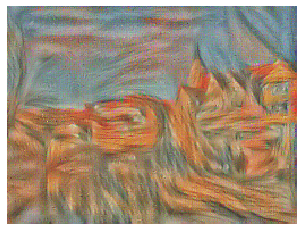

[tensor([[[[0.5739, 1.7085, 0.7482,  ..., 1.0978, 2.0899, 0.9424],
          [0.3478, 1.0253, 0.8351,  ..., 0.8650, 1.3647, 0.8171],
          [0.8918, 1.5855, 1.0373,  ..., 0.9855, 1.7823, 1.4032],
          ...,
          [0.9397, 1.1180, 1.1741,  ..., 0.8270, 1.0341, 0.8178],
          [2.2212, 1.2262, 0.7672,  ..., 0.6753, 0.6768, 0.6153],
          [1.8052, 1.4967, 0.4437,  ..., 0.4711, 0.9907, 0.5479]],

         [[0.2160, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0219, 0.1412,  ..., 0.0000, 0.0579, 0.0000],
          ...,
          [0.0000, 0.1944, 0.0270,  ..., 0.0000, 0.0000, 0.2294],
          [0.0000, 0.0878, 0.0000,  ..., 0.0452, 0.2196, 0.0000],
          [0.0000, 0.0000, 0.1263,  ..., 0.0635, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.1643, 0.0000, 0.0299,  ..., 0.0694, 0.1980, 0.1437],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.5184, 1.7528, 0.7766,  ..., 1.2993, 2.2485, 0.9839],
          [0.3710, 1.0426, 0.7774,  ..., 0.9521, 1.4525, 0.9285],
          [0.9329, 1.5751, 1.0038,  ..., 1.0101, 1.6253, 1.2870],
          ...,
          [0.8636, 1.0847, 1.1154,  ..., 0.8901, 0.9568, 0.7067],
          [2.2293, 1.5710, 0.8912,  ..., 0.6707, 0.6431, 0.6933],
          [1.6542, 1.8055, 0.4489,  ..., 0.5105, 1.0291, 0.5773]],

         [[0.0850, 0.0000, 0.0000,  ..., 0.0259, 0.2051, 0.0000],
          [0.0532, 0.1146, 0.0000,  ..., 0.2251, 0.0000, 0.0000],
          [0.0000, 0.0166, 0.0694,  ..., 0.0000, 0.0755, 0.0000],
          ...,
          [0.0694, 0.0000, 0.1947,  ..., 0.0000, 0.0000, 0.0610],
          [0.0000, 0.0963, 0.0000,  ..., 0.2646, 0.1132, 0.0025],
          [0.1695, 0.0000, 0.2109,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1882, 0.3527],
          [0.0000, 0.0000, 0.0000,  ..., 0.3088, 0.0656, 0.0000],
          [0.0077, 0.0000, 0.0000,  ..., 

[tensor([[[[0.4994, 1.8681, 0.7873,  ..., 1.3568, 2.3384, 0.9583],
          [0.4058, 1.1148, 0.7324,  ..., 1.1404, 1.4784, 0.8200],
          [0.9866, 1.6092, 0.9957,  ..., 1.0682, 1.4821, 1.1404],
          ...,
          [0.6763, 1.1550, 1.1185,  ..., 0.8844, 0.9855, 0.5700],
          [1.9365, 1.8415, 1.0565,  ..., 0.7112, 0.7032, 0.7302],
          [1.4198, 1.7327, 0.5535,  ..., 0.6147, 0.8790, 0.4938]],

         [[0.0000, 0.0000, 0.0189,  ..., 0.0229, 0.1547, 0.0000],
          [0.1753, 0.1719, 0.0000,  ..., 0.1962, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0095, 0.0660, 0.0000],
          ...,
          [0.4125, 0.0000, 0.1468,  ..., 0.0000, 0.0000, 0.0000],
          [0.3970, 0.0000, 0.0816,  ..., 0.3811, 0.0213, 0.2702],
          [0.3590, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0625, 0.7513, 0.7390],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.2427, 0.0000],
          [0.2023, 0.0000, 0.0000,  ..., 

[tensor([[[[0.5354, 1.8750, 0.8074,  ..., 1.3735, 2.2720, 0.9366],
          [0.4354, 1.1369, 0.7395,  ..., 1.2820, 1.3593, 0.6529],
          [1.0240, 1.6539, 1.0100,  ..., 1.0943, 1.4275, 1.1109],
          ...,
          [0.7434, 1.2561, 1.1965,  ..., 0.8170, 1.0663, 0.4417],
          [1.5134, 1.8412, 1.2261,  ..., 0.7892, 0.8301, 0.7142],
          [1.1687, 1.3269, 0.5920,  ..., 0.6774, 0.7429, 0.4518]],

         [[0.0000, 0.0000, 0.0157,  ..., 0.0000, 0.0698, 0.0000],
          [0.0932, 0.0000, 0.0490,  ..., 0.0579, 0.0439, 0.0000],
          [0.1201, 0.0414, 0.0000,  ..., 0.1124, 0.0393, 0.0000],
          ...,
          [0.4067, 0.0000, 0.0647,  ..., 0.0000, 0.0000, 0.0000],
          [0.6910, 0.0000, 0.4702,  ..., 0.3116, 0.1294, 0.1943],
          [0.5530, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.1656, 0.2952, 0.4669],
          [0.1073, 0.0000, 0.0000,  ..., 0.0000, 0.0814, 0.4493],
          [0.0000, 0.0351, 0.0000,  ..., 

[tensor([[[[0.5642, 1.8348, 0.7942,  ..., 1.4014, 2.1863, 0.8792],
          [0.4563, 1.0914, 0.7740,  ..., 1.2973, 1.2646, 0.4574],
          [1.0072, 1.5939, 1.0154,  ..., 1.1355, 1.4542, 1.1354],
          ...,
          [0.9094, 1.1978, 1.3354,  ..., 0.7949, 0.9852, 0.2966],
          [1.1236, 1.5986, 1.4592,  ..., 0.8899, 0.9290, 0.6550],
          [1.1360, 1.0234, 0.5836,  ..., 0.6649, 0.6273, 0.4472]],

         [[0.0000, 0.1112, 0.0000,  ..., 0.0000, 0.0000, 0.2471],
          [0.0000, 0.0000, 0.1890,  ..., 0.0000, 0.1246, 0.0000],
          [0.0336, 0.1209, 0.0000,  ..., 0.1283, 0.0000, 0.0699],
          ...,
          [0.0000, 0.0000, 0.0400,  ..., 0.0000, 0.0000, 0.0000],
          [0.3899, 0.0000, 0.3108,  ..., 0.1473, 0.2328, 0.0584],
          [0.5531, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.2300]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.2042, 0.0000, 0.0000],
          [0.1152, 0.0000, 0.0788,  ..., 0.0000, 0.0000, 0.5320],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[5.6519e-01, 1.7422e+00, 7.5423e-01,  ..., 1.3593e+00,
           2.0791e+00, 8.7642e-01],
          [4.6216e-01, 1.0008e+00, 8.2082e-01,  ..., 1.1971e+00,
           1.1545e+00, 4.0840e-01],
          [9.6063e-01, 1.5255e+00, 1.0039e+00,  ..., 1.2141e+00,
           1.5404e+00, 1.1185e+00],
          ...,
          [9.1134e-01, 9.6116e-01, 1.4122e+00,  ..., 8.2105e-01,
           7.7428e-01, 2.0524e-01],
          [8.1374e-01, 1.2978e+00, 1.5192e+00,  ..., 1.0029e+00,
           1.0447e+00, 6.1484e-01],
          [1.1352e+00, 9.5430e-01, 5.8571e-01,  ..., 5.8829e-01,
           5.8445e-01, 4.7717e-01]],

         [[0.0000e+00, 2.7046e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 1.8558e-01],
          [0.0000e+00, 0.0000e+00, 1.0964e-01,  ..., 0.0000e+00,
           1.2699e-01, 0.0000e+00],
          [0.0000e+00, 8.7438e-02, 1.1614e-01,  ..., 4.5752e-02,
           0.0000e+00, 2.6240e-01],
          ...,
          [0.0000e+00, 1.8776e-01, 5.5333e-02,  ..., 0.000

[tensor([[[[0.5149, 1.6622, 0.7246,  ..., 1.2034, 1.9851, 0.8497],
          [0.4392, 0.9938, 0.8309,  ..., 1.0310, 1.2240, 0.6449],
          [0.9336, 1.5863, 0.9658,  ..., 1.2466, 1.5985, 1.1129],
          ...,
          [0.7874, 0.8637, 1.2197,  ..., 0.8403, 0.6010, 0.2558],
          [0.5555, 0.9949, 1.3145,  ..., 1.0585, 1.0009, 0.5873],
          [1.0685, 0.8822, 0.6392,  ..., 0.4709, 0.5731, 0.5312]],

         [[0.0442, 0.0458, 0.0000,  ..., 0.0948, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0180,  ..., 0.0000, 0.0000, 0.0658],
          [0.0000, 0.0000, 0.1549,  ..., 0.0000, 0.0000, 0.2301],
          ...,
          [0.1088, 0.0852, 0.2778,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1851, 0.2512],
          [0.0000, 0.2330, 0.2218,  ..., 0.0520, 0.0000, 0.4188]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0023, 0.0000, 0.0000,  ..., 0.0598, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[4.1201e-01, 1.6622e+00, 7.7225e-01,  ..., 1.0856e+00,
           1.9213e+00, 9.1673e-01],
          [3.7328e-01, 1.0480e+00, 8.3067e-01,  ..., 1.0681e+00,
           1.3772e+00, 8.9262e-01],
          [9.0774e-01, 1.6328e+00, 9.2284e-01,  ..., 1.2049e+00,
           1.5589e+00, 1.0450e+00],
          ...,
          [9.7549e-01, 1.0510e+00, 8.3995e-01,  ..., 8.2940e-01,
           5.5534e-01, 3.4030e-01],
          [3.9159e-01, 1.0003e+00, 1.0055e+00,  ..., 9.0963e-01,
           7.8966e-01, 6.4591e-01],
          [9.8124e-01, 8.3335e-01, 7.2492e-01,  ..., 4.0355e-01,
           6.2370e-01, 6.3463e-01]],

         [[1.7013e-01, 0.0000e+00, 0.0000e+00,  ..., 1.8018e-01,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 1.8065e-01, 1.2964e-03,  ..., 9.0120e-02,
           0.0000e+00, 4.3809e-01],
          [5.1588e-02, 0.0000e+00, 5.1936e-02,  ..., 0.0000e+00,
           9.4796e-03, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 2.9228e-01,  ..., 0.000

[tensor([[[[0.3662, 1.5911, 0.8697,  ..., 1.0929, 1.9722, 1.0032],
          [0.3400, 0.9435, 0.8111,  ..., 1.2515, 1.3959, 0.8301],
          [0.8738, 1.5971, 0.9124,  ..., 1.0773, 1.4664, 0.9980],
          ...,
          [1.0863, 1.1362, 0.8820,  ..., 0.7562, 0.6003, 0.4339],
          [0.4822, 1.0450, 0.9908,  ..., 0.7360, 0.5963, 0.6974],
          [0.8855, 0.6800, 0.8004,  ..., 0.4621, 0.6137, 0.6214]],

         [[0.2549, 0.0000, 0.0874,  ..., 0.3190, 0.0000, 0.0000],
          [0.1560, 0.0680, 0.0823,  ..., 0.2865, 0.0571, 0.1849],
          [0.2709, 0.0000, 0.0000,  ..., 0.0000, 0.3001, 0.0000],
          ...,
          [0.0000, 0.0000, 0.2320,  ..., 0.0198, 0.0000, 0.0000],
          [0.4672, 0.0000, 0.0249,  ..., 0.0000, 0.1877, 0.2453],
          [0.0000, 0.3656, 0.3100,  ..., 0.1976, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.3815, 0.0279, 0.5973],
          [0.0000, 0.0000, 0.1888,  ..., 0.2792, 0.8757, 0.3451],
          [0.0000, 0.0377, 0.0000,  ..., 

[tensor([[[[0.3643, 1.3889, 0.9128,  ..., 1.1156, 1.9751, 1.0887],
          [0.3787, 0.7295, 0.7869,  ..., 1.3104, 1.3119, 0.8104],
          [0.8622, 1.5458, 0.8751,  ..., 1.0997, 1.4639, 1.0505],
          ...,
          [0.9614, 0.9800, 1.0011,  ..., 0.6274, 0.6588, 0.5312],
          [0.6283, 1.0210, 1.0806,  ..., 0.6559, 0.5422, 0.6994],
          [0.8779, 0.6066, 0.8081,  ..., 0.4850, 0.6432, 0.5336]],

         [[0.1845, 0.0000, 0.2392,  ..., 0.2383, 0.0000, 0.0000],
          [0.3438, 0.0000, 0.1474,  ..., 0.2505, 0.1130, 0.0146],
          [0.3073, 0.0000, 0.0000,  ..., 0.0000, 0.2952, 0.0000],
          ...,
          [0.0000, 0.0000, 0.3346,  ..., 0.0000, 0.0000, 0.0000],
          [0.4716, 0.0343, 0.2276,  ..., 0.0000, 0.0878, 0.2672],
          [0.0000, 0.2355, 0.1934,  ..., 0.2076, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0699,  ..., 0.9110, 0.0000, 0.5731],
          [0.0000, 0.0000, 0.2131,  ..., 0.0000, 0.8445, 0.9670],
          [0.0000, 0.3490, 0.0000,  ..., 

[tensor([[[[0.3667, 1.2649, 0.8959,  ..., 1.1316, 1.8760, 1.0686],
          [0.4455, 0.6365, 0.7921,  ..., 1.2704, 1.2049, 0.8316],
          [0.8641, 1.4445, 0.8118,  ..., 1.1961, 1.5359, 1.1907],
          ...,
          [0.9561, 0.7408, 1.1025,  ..., 0.5650, 0.6713, 0.5805],
          [0.7569, 0.9717, 1.0563,  ..., 0.6440, 0.6145, 0.6875],
          [0.7946, 0.6410, 0.8231,  ..., 0.4985, 0.7535, 0.4751]],

         [[0.1725, 0.1035, 0.1900,  ..., 0.0000, 0.1425, 0.0000],
          [0.1631, 0.0000, 0.1629,  ..., 0.1178, 0.0000, 0.0000],
          [0.0622, 0.0000, 0.0000,  ..., 0.0000, 0.0492, 0.1216],
          ...,
          [0.0000, 0.0452, 0.2216,  ..., 0.0000, 0.0000, 0.0000],
          [0.4170, 0.0773, 0.2668,  ..., 0.0000, 0.0000, 0.1527],
          [0.0000, 0.0792, 0.0103,  ..., 0.0670, 0.0843, 0.0000]],

         [[0.0000, 0.0000, 0.2872,  ..., 0.8381, 0.0000, 0.2802],
          [0.0000, 0.0000, 0.0471,  ..., 0.0000, 0.0000, 0.8223],
          [0.0342, 0.2316, 0.0000,  ..., 

[tensor([[[[4.0137e-01, 1.3303e+00, 8.7680e-01,  ..., 1.1716e+00,
           1.8721e+00, 1.0514e+00],
          [5.4943e-01, 7.8335e-01, 8.3914e-01,  ..., 1.2330e+00,
           1.2201e+00, 8.9350e-01],
          [9.0563e-01, 1.3938e+00, 7.7085e-01,  ..., 1.2480e+00,
           1.5985e+00, 1.2579e+00],
          ...,
          [9.1820e-01, 6.1936e-01, 1.2598e+00,  ..., 6.0499e-01,
           7.0541e-01, 6.5114e-01],
          [8.1802e-01, 8.6120e-01, 1.0907e+00,  ..., 6.7206e-01,
           7.7012e-01, 7.5823e-01],
          [6.7853e-01, 6.9554e-01, 8.1299e-01,  ..., 5.0425e-01,
           8.2347e-01, 5.0382e-01]],

         [[1.8297e-01, 2.0299e-02, 1.0373e-01,  ..., 0.0000e+00,
           5.0321e-01, 4.1186e-02],
          [0.0000e+00, 0.0000e+00, 9.8585e-02,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 5.2733e-01],
          ...,
          [0.0000e+00, 1.1241e-01, 0.0000e+00,  ..., 0.000

[tensor([[[[4.2424e-01, 1.4891e+00, 8.1630e-01,  ..., 1.2382e+00,
           2.0234e+00, 1.1096e+00],
          [7.0386e-01, 1.1088e+00, 8.8896e-01,  ..., 1.2455e+00,
           1.3069e+00, 9.7444e-01],
          [1.0596e+00, 1.4884e+00, 7.9847e-01,  ..., 1.1991e+00,
           1.4911e+00, 1.1606e+00],
          ...,
          [7.8603e-01, 6.5511e-01, 1.0148e+00,  ..., 7.3720e-01,
           7.0667e-01, 6.7317e-01],
          [8.1588e-01, 8.1314e-01, 1.0157e+00,  ..., 7.7464e-01,
           9.2897e-01, 9.0305e-01],
          [6.1231e-01, 8.3224e-01, 8.7083e-01,  ..., 5.5396e-01,
           8.3229e-01, 5.5526e-01]],

         [[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           4.8462e-01, 1.4854e-01],
          [2.1366e-02, 1.1179e-01, 6.7375e-02,  ..., 7.8441e-02,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 1.6378e-01,  ..., 0.0000e+00,
           0.0000e+00, 3.2698e-01],
          ...,
          [1.4208e-03, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[0.4280, 1.5994, 0.7458,  ..., 1.3647, 2.1649, 1.1880],
          [0.8139, 1.3670, 0.9077,  ..., 1.2831, 1.3340, 1.0480],
          [1.1381, 1.5543, 0.8171,  ..., 1.1197, 1.3547, 1.0518],
          ...,
          [0.6776, 0.7582, 0.6374,  ..., 0.8130, 0.7738, 0.6437],
          [0.7962, 0.9090, 0.8501,  ..., 0.7883, 0.9316, 0.9597],
          [0.7057, 0.9803, 0.9776,  ..., 0.6415, 0.7155, 0.5546]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1129, 0.2906],
          [0.0244, 0.1694, 0.0442,  ..., 0.1994, 0.2103, 0.0000],
          [0.0000, 0.0047, 0.2886,  ..., 0.0000, 0.0662, 0.0437],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.4534, 0.0600, 0.1451,  ..., 0.0000, 0.0000, 0.0773],
          [0.1861, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0630]],

         [[0.2110, 0.0000, 0.0000,  ..., 0.0000, 0.1164, 0.4170],
          [0.8288, 0.4559, 0.0000,  ..., 0.0000, 0.3528, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.5066, 1.3660, 0.6580,  ..., 1.4385, 2.2734, 1.2018],
          [0.8417, 1.3771, 0.9021,  ..., 1.2719, 1.3506, 1.1252],
          [1.1043, 1.4724, 0.7918,  ..., 1.0717, 1.2763, 1.0437],
          ...,
          [0.7323, 0.8354, 0.5456,  ..., 0.8176, 0.8240, 0.5711],
          [0.8042, 1.0491, 0.8443,  ..., 0.8092, 0.9565, 0.9498],
          [0.8739, 1.1538, 1.0883,  ..., 0.7388, 0.6047, 0.5847]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.3548],
          [0.0000, 0.0834, 0.0000,  ..., 0.0000, 0.5308, 0.0000],
          [0.0000, 0.1269, 0.1442,  ..., 0.0000, 0.1206, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0684, 0.0171, 0.4543,  ..., 0.0000, 0.0492, 0.0297],
          [0.3620, 0.0000, 0.0804,  ..., 0.0749, 0.0000, 0.1102]],

         [[0.0281, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.2259, 0.4443, 0.0000,  ..., 0.0000, 0.6286, 0.1208],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[5.4266e-01, 1.0083e+00, 6.4702e-01,  ..., 1.4912e+00,
           2.1914e+00, 1.1510e+00],
          [8.3332e-01, 1.2375e+00, 9.1828e-01,  ..., 1.1933e+00,
           1.2755e+00, 1.2046e+00],
          [1.0293e+00, 1.3571e+00, 7.9483e-01,  ..., 1.0844e+00,
           1.2315e+00, 1.0513e+00],
          ...,
          [7.3990e-01, 8.2227e-01, 8.2397e-01,  ..., 7.8481e-01,
           8.1767e-01, 5.5371e-01],
          [7.5607e-01, 1.0495e+00, 1.0888e+00,  ..., 8.4068e-01,
           9.0856e-01, 8.7388e-01],
          [5.4706e-01, 1.1035e+00, 1.1555e+00,  ..., 6.8459e-01,
           5.2388e-01, 6.6888e-01]],

         [[0.0000e+00, 2.4283e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 1.0470e-01],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           3.1494e-01, 4.2113e-01],
          [0.0000e+00, 1.9242e-01, 0.0000e+00,  ..., 0.0000e+00,
           2.3932e-01, 0.0000e+00],
          ...,
          [0.0000e+00, 7.6529e-02, 0.0000e+00,  ..., 0.000

[tensor([[[[0.5424, 0.7021, 0.6470,  ..., 1.4470, 2.1547, 1.1334],
          [0.8020, 1.0855, 0.9321,  ..., 1.2584, 1.3693, 1.3284],
          [0.9659, 1.2818, 0.8241,  ..., 1.1802, 1.3016, 1.1098],
          ...,
          [0.7610, 0.7898, 0.9480,  ..., 0.7528, 0.8174, 0.5705],
          [0.8324, 0.9860, 0.9913,  ..., 0.7443, 0.7247, 0.7651],
          [0.3185, 1.0526, 1.1274,  ..., 0.6664, 0.6561, 0.7860]],

         [[0.0000, 0.2583, 0.0000,  ..., 0.0000, 0.0600, 0.0401],
          [0.0000, 0.0000, 0.0698,  ..., 0.0000, 0.0000, 0.6696],
          [0.0000, 0.1962, 0.0000,  ..., 0.0000, 0.1581, 0.0000],
          ...,
          [0.0000, 0.1791, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.5326, 0.4070,  ..., 0.2890, 0.0000, 0.0000],
          [0.4852, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0487]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.2497, 0.0000, 0.1379],
          [0.0000, 0.0000, 0.0000,  ..., 0.4662, 0.0000, 0.1397],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.5515, 0.5841, 0.6986,  ..., 1.3925, 2.1455, 1.1459],
          [0.7729, 1.0241, 0.9309,  ..., 1.3688, 1.3930, 1.3489],
          [0.9167, 1.2932, 0.9037,  ..., 1.2615, 1.4273, 1.1820],
          ...,
          [0.9453, 0.8096, 1.0022,  ..., 0.7739, 0.8201, 0.5378],
          [0.8903, 0.9007, 0.8366,  ..., 0.7171, 0.5164, 0.5985],
          [0.5236, 1.0418, 1.0011,  ..., 0.7525, 0.7966, 0.8124]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1771, 0.1086],
          [0.0000, 0.0000, 0.2242,  ..., 0.0000, 0.0000, 0.5471],
          [0.1367, 0.1176, 0.0000,  ..., 0.0484, 0.0033, 0.0000],
          ...,
          [0.0000, 0.1347, 0.0178,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.2856, 0.2925,  ..., 0.3294, 0.1081, 0.0000],
          [0.2932, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.3852, 0.0000, 0.8470],
          [0.0000, 0.0000, 0.0000,  ..., 0.4634, 0.0000, 0.1752],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.5772, 0.5545, 0.7540,  ..., 1.3904, 2.1417, 1.0491],
          [0.8162, 1.0949, 0.8767,  ..., 1.4716, 1.3090, 1.1767],
          [0.9160, 1.4274, 1.0467,  ..., 1.3396, 1.4880, 1.2630],
          ...,
          [1.1518, 1.0071, 1.1450,  ..., 0.8939, 0.7964, 0.4989],
          [0.8377, 0.8820, 0.9766,  ..., 0.8581, 0.5206, 0.4639],
          [0.7764, 0.8528, 0.8224,  ..., 0.7618, 0.9695, 0.7406]],

         [[0.1880, 0.0000, 0.0000,  ..., 0.0000, 0.0947, 0.1864],
          [0.0000, 0.1001, 0.2704,  ..., 0.0000, 0.0000, 0.0000],
          [0.3639, 0.0861, 0.0000,  ..., 0.0778, 0.0000, 0.0000],
          ...,
          [0.0000, 0.1329, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0203, 0.1358, 0.0720,  ..., 0.2139, 0.2380, 0.0000],
          [0.0977, 0.0533, 0.0686,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.4213, 0.0000, 0.7137],
          [0.0000, 0.0000, 0.0000,  ..., 0.1765, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.6231, 0.4744, 0.7699,  ..., 1.4699, 2.2330, 0.9204],
          [0.9146, 1.2107, 0.8170,  ..., 1.4966, 1.3076, 0.9878],
          [1.0094, 1.6426, 1.1944,  ..., 1.3963, 1.4794, 1.3543],
          ...,
          [1.1179, 0.9576, 1.1386,  ..., 1.0816, 0.8232, 0.5513],
          [0.8580, 0.8974, 1.0561,  ..., 0.9294, 0.6076, 0.5082],
          [0.9837, 0.8437, 0.7809,  ..., 0.6259, 1.0710, 0.6980]],

         [[0.3547, 0.0000, 0.0000,  ..., 0.1754, 0.0000, 0.0742],
          [0.0000, 0.1627, 0.0653,  ..., 0.2091, 0.0000, 0.0000],
          [0.4069, 0.0605, 0.0000,  ..., 0.0000, 0.0000, 0.2484],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.1020, 0.0000, 0.0000],
          [0.0800, 0.0000, 0.0000,  ..., 0.2770, 0.0000, 0.0739],
          [0.0000, 0.3909, 0.1938,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.3006, 0.0318, 0.1163],
          [0.0000, 0.0000, 0.0000,  ..., 0.0331, 0.0093, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.6735, 0.2692, 0.7750,  ..., 1.4876, 2.4387, 0.9272],
          [0.9941, 1.1491, 0.8118,  ..., 1.3809, 1.4148, 1.0239],
          [1.0857, 1.8218, 1.2769,  ..., 1.3994, 1.4825, 1.4317],
          ...,
          [0.8803, 0.7033, 1.0611,  ..., 1.1578, 0.8307, 0.6896],
          [0.9564, 0.9051, 1.0723,  ..., 0.8623, 0.6386, 0.6612],
          [1.0517, 0.7263, 0.9121,  ..., 0.4497, 0.9909, 0.7022]],

         [[0.2730, 0.2304, 0.0000,  ..., 0.4028, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.1472, 0.1799, 0.0000],
          [0.1942, 0.0132, 0.0654,  ..., 0.0000, 0.0000, 0.2665],
          ...,
          [0.1678, 0.0000, 0.0167,  ..., 0.0824, 0.0000, 0.1437],
          [0.1422, 0.0000, 0.2858,  ..., 0.3745, 0.0000, 0.2021],
          [0.1543, 0.5859, 0.0000,  ..., 0.0000, 0.0698, 0.0000]],

         [[0.0000, 0.0000, 0.0173,  ..., 0.1460, 0.6123, 0.0000],
          [0.0103, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0419],
          [0.1566, 0.0000, 0.0000,  ..., 

[tensor([[[[0.7268, 0.1754, 0.8154,  ..., 1.4789, 2.7027, 0.9420],
          [1.0115, 1.0688, 0.8820,  ..., 1.2652, 1.5103, 1.1236],
          [1.1487, 1.9384, 1.3293,  ..., 1.3799, 1.4549, 1.4018],
          ...,
          [0.7554, 0.6599, 0.8527,  ..., 1.0135, 0.7721, 0.6789],
          [0.9840, 0.9013, 0.9759,  ..., 0.8118, 0.6277, 0.7380],
          [1.0257, 0.6773, 0.9920,  ..., 0.4882, 0.9087, 0.6894]],

         [[0.1666, 0.3013, 0.0110,  ..., 0.0000, 0.2761, 0.0000],
          [0.0650, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1407],
          [0.0000, 0.1234, 0.1067,  ..., 0.0000, 0.0000, 0.0028],
          ...,
          [0.3899, 0.0000, 0.0810,  ..., 0.0000, 0.0000, 0.0941],
          [0.0876, 0.0000, 0.5415,  ..., 0.3384, 0.0000, 0.3123],
          [0.2483, 0.4152, 0.0000,  ..., 0.0000, 0.2767, 0.0000]],

         [[0.1198, 0.0000, 0.1534,  ..., 0.0000, 0.0000, 0.0000],
          [0.3577, 0.0000, 0.0000,  ..., 0.1291, 0.0000, 0.3552],
          [0.3628, 0.0000, 0.0000,  ..., 

[tensor([[[[0.7852, 0.1891, 0.8682,  ..., 1.3313, 2.7851, 0.8516],
          [1.0076, 1.0377, 0.9487,  ..., 1.3405, 1.4803, 1.1009],
          [1.1816, 1.8977, 1.3311,  ..., 1.3878, 1.2925, 1.3072],
          ...,
          [0.9359, 0.8631, 0.6131,  ..., 0.7702, 0.6582, 0.6397],
          [0.9243, 0.9116, 0.7185,  ..., 0.8922, 0.6339, 0.7155],
          [1.0625, 0.7822, 0.9017,  ..., 0.7256, 1.0077, 0.6207]],

         [[0.0428, 0.0437, 0.0000,  ..., 0.0000, 0.2726, 0.0277],
          [0.0336, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.4456],
          [0.0000, 0.2647, 0.0261,  ..., 0.0000, 0.2119, 0.0000],
          ...,
          [0.1101, 0.0000, 0.2055,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0748, 0.1605,  ..., 0.1791, 0.1237, 0.3921],
          [0.2083, 0.0359, 0.0000,  ..., 0.0000, 0.0105, 0.0000]],

         [[0.4897, 0.3348, 0.1899,  ..., 0.0000, 0.0000, 0.0000],
          [0.6775, 0.0855, 0.0534,  ..., 0.0272, 0.0000, 0.0748],
          [0.0000, 0.0000, 0.0042,  ..., 

[tensor([[[[0.6973, 0.2365, 0.9269,  ..., 1.1475, 2.4461, 0.7223],
          [1.0096, 1.0439, 0.9263,  ..., 1.3762, 1.3806, 0.9583],
          [1.1179, 1.7800, 1.2906,  ..., 1.3194, 1.3464, 1.3568],
          ...,
          [1.0733, 0.9405, 0.5117,  ..., 0.5898, 0.6518, 0.6253],
          [0.9438, 0.7928, 0.7034,  ..., 0.9059, 0.6792, 0.6711],
          [1.1577, 0.9211, 0.9064,  ..., 0.7851, 0.8808, 0.5931]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1016, 0.0000],
          [0.0000, 0.3442, 0.0000,  ..., 0.0000, 0.0000, 0.3612],
          [0.1162, 0.0807, 0.0000,  ..., 0.0290, 0.4318, 0.0000],
          ...,
          [0.0000, 0.0000, 0.1569,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.5662, 0.0000,  ..., 0.0502, 0.4094, 0.1910],
          [0.0000, 0.0000, 0.2610,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.1964, 0.4588, 0.2544,  ..., 0.0000, 0.0000, 0.0000],
          [0.5545, 0.3137, 0.2833,  ..., 0.1037, 0.0630, 0.0000],
          [0.0000, 0.0000, 0.0068,  ..., 

[tensor([[[[5.5903e-01, 1.1343e-01, 9.7558e-01,  ..., 1.1295e+00,
           2.1005e+00, 6.7576e-01],
          [9.5785e-01, 9.0324e-01, 8.5001e-01,  ..., 1.4286e+00,
           1.3785e+00, 8.6985e-01],
          [8.8875e-01, 1.6043e+00, 1.2479e+00,  ..., 1.2719e+00,
           1.5701e+00, 1.4925e+00],
          ...,
          [1.0446e+00, 9.4963e-01, 5.8860e-01,  ..., 5.2733e-01,
           6.1341e-01, 4.8375e-01],
          [1.0213e+00, 6.4902e-01, 9.1797e-01,  ..., 7.4282e-01,
           5.8385e-01, 5.1004e-01],
          [9.9958e-01, 9.5569e-01, 1.0503e+00,  ..., 6.7770e-01,
           7.5817e-01, 5.8355e-01]],

         [[5.3910e-03, 3.5955e-02, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [9.5871e-02, 1.5169e-01, 1.7026e-03,  ..., 0.0000e+00,
           0.0000e+00, 1.5409e-01],
          [4.5662e-02, 0.0000e+00, 0.0000e+00,  ..., 9.3124e-02,
           4.0297e-01, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 7.1909e-02,  ..., 0.000

[tensor([[[[5.3881e-01, 0.0000e+00, 1.0062e+00,  ..., 1.2183e+00,
           1.8603e+00, 7.3185e-01],
          [8.9983e-01, 7.4921e-01, 8.6708e-01,  ..., 1.4149e+00,
           1.3678e+00, 9.8514e-01],
          [7.0635e-01, 1.4643e+00, 1.1923e+00,  ..., 1.2954e+00,
           1.7492e+00, 1.6769e+00],
          ...,
          [9.6389e-01, 9.1324e-01, 8.3290e-01,  ..., 5.8660e-01,
           5.8281e-01, 4.1164e-01],
          [1.1051e+00, 5.1282e-01, 9.9981e-01,  ..., 5.7858e-01,
           4.9287e-01, 4.7838e-01],
          [1.0464e+00, 8.8603e-01, 1.0575e+00,  ..., 5.9192e-01,
           4.9356e-01, 5.4378e-01]],

         [[1.7674e-01, 2.4517e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [1.4399e-01, 0.0000e+00, 8.3318e-02,  ..., 0.0000e+00,
           0.0000e+00, 1.1963e-01],
          [0.0000e+00, 4.4009e-02, 0.0000e+00,  ..., 1.2805e-01,
           1.3341e-01, 0.0000e+00],
          ...,
          [2.5673e-01, 8.2592e-02, 0.0000e+00,  ..., 0.000

[tensor([[[[5.5897e-01, 7.8562e-02, 1.0658e+00,  ..., 1.4305e+00,
           1.8693e+00, 8.5492e-01],
          [8.5492e-01, 7.9997e-01, 9.2268e-01,  ..., 1.4918e+00,
           1.4405e+00, 1.2004e+00],
          [5.9379e-01, 1.3755e+00, 1.0824e+00,  ..., 1.3118e+00,
           1.8661e+00, 1.8442e+00],
          ...,
          [1.1210e+00, 9.0741e-01, 9.0820e-01,  ..., 7.1801e-01,
           6.5924e-01, 3.5420e-01],
          [1.1477e+00, 6.0043e-01, 9.5931e-01,  ..., 7.2059e-01,
           7.4298e-01, 4.3266e-01],
          [1.1192e+00, 8.2371e-01, 9.6210e-01,  ..., 6.2282e-01,
           3.7486e-01, 6.3667e-01]],

         [[3.3920e-01, 3.4003e-01, 0.0000e+00,  ..., 6.0668e-02,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 7.0647e-02,  ..., 0.0000e+00,
           7.3251e-02, 7.2064e-02],
          [0.0000e+00, 1.9950e-02, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          ...,
          [1.6219e-01, 7.0114e-01, 0.0000e+00,  ..., 0.000

[tensor([[[[5.7936e-01, 4.1518e-01, 1.1226e+00,  ..., 1.6550e+00,
           1.7705e+00, 9.2250e-01],
          [7.9651e-01, 9.8566e-01, 1.0228e+00,  ..., 1.5907e+00,
           1.5544e+00, 1.3643e+00],
          [5.6289e-01, 1.3592e+00, 9.7840e-01,  ..., 1.3621e+00,
           2.0348e+00, 1.8760e+00],
          ...,
          [1.2877e+00, 8.9212e-01, 9.1097e-01,  ..., 8.1935e-01,
           7.7815e-01, 4.6035e-01],
          [1.1167e+00, 7.0659e-01, 1.0062e+00,  ..., 8.8967e-01,
           1.0181e+00, 5.4411e-01],
          [1.0155e+00, 8.3006e-01, 9.3817e-01,  ..., 6.3276e-01,
           4.6864e-01, 8.9759e-01]],

         [[3.4932e-01, 6.3580e-02, 0.0000e+00,  ..., 2.4559e-01,
           0.0000e+00, 2.3394e-02],
          [0.0000e+00, 3.6766e-02, 2.0295e-02,  ..., 0.0000e+00,
           1.4423e-01, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 2.7924e-01],
          ...,
          [1.0156e-01, 8.5533e-01, 3.9329e-02,  ..., 0.000

[tensor([[[[6.1640e-01, 6.9107e-01, 1.1463e+00,  ..., 1.8264e+00,
           1.6360e+00, 9.4714e-01],
          [7.4743e-01, 1.1198e+00, 1.0371e+00,  ..., 1.7105e+00,
           1.6612e+00, 1.4814e+00],
          [6.1263e-01, 1.4561e+00, 9.0227e-01,  ..., 1.4785e+00,
           2.1765e+00, 1.8337e+00],
          ...,
          [9.4822e-01, 8.0130e-01, 9.3131e-01,  ..., 8.6228e-01,
           8.8384e-01, 6.0958e-01],
          [1.0047e+00, 7.5402e-01, 9.8053e-01,  ..., 7.6151e-01,
           9.3665e-01, 7.3193e-01],
          [8.6735e-01, 9.8809e-01, 8.9927e-01,  ..., 5.3842e-01,
           7.3307e-01, 1.1644e+00]],

         [[7.3962e-02, 0.0000e+00, 0.0000e+00,  ..., 1.6874e-01,
           0.0000e+00, 9.8710e-03],
          [0.0000e+00, 2.9490e-01, 9.2392e-02,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 5.2497e-02,  ..., 0.0000e+00,
           0.0000e+00, 2.2531e-01],
          ...,
          [3.3988e-01, 7.3359e-01, 0.0000e+00,  ..., 0.000

[tensor([[[[0.7942, 0.8076, 1.1398,  ..., 1.9268, 1.6183, 0.9485],
          [0.7255, 1.1263, 0.8878,  ..., 1.7232, 1.6006, 1.5238],
          [0.7225, 1.6519, 0.8736,  ..., 1.6005, 2.1745, 1.8122],
          ...,
          [0.6189, 0.8758, 1.0362,  ..., 0.8280, 0.9278, 0.7618],
          [0.9432, 0.8025, 0.9081,  ..., 0.5782, 0.8028, 0.8585],
          [0.8276, 1.1015, 0.8237,  ..., 0.4600, 0.9954, 1.1600]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0351, 0.0000],
          [0.0000, 0.0526, 0.1133,  ..., 0.0000, 0.0000, 0.0105],
          [0.0000, 0.0040, 0.0920,  ..., 0.0186, 0.0000, 0.1973],
          ...,
          [0.3339, 0.3805, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.4870, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.8564, 0.1146, 0.1113,  ..., 0.0156, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0031],
          [0.1911, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.9402, 0.9121, 1.1036,  ..., 1.8869, 1.6481, 0.9724],
          [0.6786, 1.1651, 0.7615,  ..., 1.7456, 1.5868, 1.5195],
          [0.8139, 1.7544, 0.8373,  ..., 1.6942, 2.2958, 1.8674],
          ...,
          [0.7229, 1.0175, 1.1264,  ..., 0.7078, 0.9510, 0.8997],
          [0.9351, 0.8073, 0.8305,  ..., 0.5503, 0.6970, 0.8045],
          [0.7891, 1.1610, 0.8080,  ..., 0.5932, 1.2478, 0.9629]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.2047, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.3133],
          [0.0000, 0.0905, 0.1039,  ..., 0.0000, 0.0000, 0.0222],
          ...,
          [0.0000, 0.0191, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.5232, 0.0000, 0.7072,  ..., 0.0000, 0.0000, 0.0000],
          [0.7271, 0.0216, 0.0000,  ..., 0.0024, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.1977, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.9367, 1.0808, 1.0225,  ..., 1.7277, 1.6261, 1.0320],
          [0.6307, 1.2910, 0.6545,  ..., 1.7275, 1.4836, 1.4412],
          [0.8633, 1.7390, 0.7679,  ..., 1.7011, 2.2861, 1.8166],
          ...,
          [0.8005, 1.0546, 1.1882,  ..., 0.6567, 1.0167, 1.0010],
          [0.9524, 0.8154, 0.8212,  ..., 0.6290, 0.7184, 0.7585],
          [0.7944, 1.1208, 0.8939,  ..., 0.8411, 1.2290, 0.7390]],

         [[0.0625, 0.1327, 0.0000,  ..., 0.0000, 0.0000, 0.0075],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0520],
          [0.0000, 0.0000, 0.0959,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.2693,  ..., 0.0000, 0.0000, 0.0000],
          [0.2367, 0.0000, 1.2414,  ..., 0.0058, 0.0735, 0.0000],
          [0.2297, 0.0268, 0.0000,  ..., 0.0000, 0.0000, 0.1113]],

         [[0.0000, 0.1991, 0.0000,  ..., 0.0000, 0.5289, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0315, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.9309, 1.2529, 0.9138,  ..., 1.5159, 1.6133, 1.0657],
          [0.5791, 1.4155, 0.5383,  ..., 1.6582, 1.3806, 1.3980],
          [0.8843, 1.7308, 0.7489,  ..., 1.6450, 2.0950, 1.5561],
          ...,
          [0.9169, 1.1466, 1.0016,  ..., 0.6502, 1.1972, 1.0552],
          [0.9630, 0.9073, 0.7525,  ..., 0.5988, 0.8201, 0.8550],
          [0.8431, 1.0677, 0.9291,  ..., 0.8483, 0.8895, 0.5716]],

         [[0.1528, 0.0547, 0.0000,  ..., 0.0000, 0.0000, 0.4866],
          [0.0000, 0.0000, 0.0408,  ..., 0.0000, 0.3621, 0.0000],
          [0.0489, 0.0000, 0.0919,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.1201, 0.0000, 0.4326,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.1773, 0.7561,  ..., 0.1201, 0.1060, 0.2419],
          [0.0000, 0.1056, 0.0000,  ..., 0.0000, 0.0000, 0.1271]],

         [[0.0000, 0.0000, 0.1806,  ..., 0.1649, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.2225,  ..., 0.0000, 0.0000, 0.0000],
          [0.3076, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0034, 1.2769, 0.8517,  ..., 1.4392, 1.6170, 1.1049],
          [0.4076, 1.3206, 0.5094,  ..., 1.6681, 1.4207, 1.3886],
          [0.8691, 1.5971, 0.8106,  ..., 1.6338, 2.0117, 1.4413],
          ...,
          [1.1101, 1.1825, 0.7275,  ..., 0.6533, 1.1778, 0.9195],
          [0.9386, 0.9283, 0.7900,  ..., 0.4755, 0.7659, 0.7869],
          [0.8087, 1.0305, 0.9861,  ..., 0.5503, 0.6085, 0.5350]],

         [[0.0000, 0.0000, 0.0389,  ..., 0.0000, 0.0000, 0.7727],
          [0.1092, 0.0258, 0.0000,  ..., 0.0000, 0.4907, 0.0000],
          [0.0000, 0.2351, 0.0033,  ..., 0.0000, 0.1901, 0.0000],
          ...,
          [0.0000, 0.0750, 0.4393,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.3744, 0.0255,  ..., 0.1153, 0.0189, 0.1457],
          [0.0000, 0.2539, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.3665,  ..., 0.0000, 0.0000, 0.2134],
          [0.0000, 0.0000, 0.0408,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0804e+00, 1.2394e+00, 8.0862e-01,  ..., 1.5258e+00,
           1.4250e+00, 1.1169e+00],
          [3.6690e-01, 1.1905e+00, 5.1258e-01,  ..., 1.5589e+00,
           1.4105e+00, 1.4489e+00],
          [8.2675e-01, 1.4708e+00, 8.6833e-01,  ..., 1.6765e+00,
           2.0706e+00, 1.5027e+00],
          ...,
          [1.0221e+00, 1.0327e+00, 6.0210e-01,  ..., 6.9682e-01,
           9.0827e-01, 7.8402e-01],
          [9.8075e-01, 9.1204e-01, 9.2716e-01,  ..., 5.6757e-01,
           6.7266e-01, 7.2557e-01],
          [7.0211e-01, 9.0001e-01, 1.0416e+00,  ..., 5.3771e-01,
           6.9483e-01, 5.7961e-01]],

         [[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 4.0212e-01],
          [3.6149e-01, 1.2380e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 5.0520e-01, 0.0000e+00,  ..., 0.0000e+00,
           2.5392e-01, 0.0000e+00],
          ...,
          [0.0000e+00, 1.2584e-01, 3.2939e-01,  ..., 0.000

[tensor([[[[1.0773, 1.2315, 0.8185,  ..., 1.6624, 1.3255, 0.9590],
          [0.4631, 1.1122, 0.5448,  ..., 1.4568, 1.5441, 1.6871],
          [0.8249, 1.4360, 0.8868,  ..., 1.6633, 2.1273, 1.5043],
          ...,
          [0.9088, 0.9553, 0.7015,  ..., 0.7329, 0.6101, 0.5775],
          [0.9024, 0.8678, 0.9752,  ..., 0.7297, 0.6853, 0.7724],
          [0.7675, 0.7951, 1.0502,  ..., 0.7282, 0.8164, 0.5507]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0349, 0.2723, 0.0000],
          [0.3814, 0.1005, 0.0000,  ..., 0.2159, 0.0000, 0.5236],
          [0.0000, 0.1256, 0.0000,  ..., 0.0000, 0.0451, 0.0000],
          ...,
          [0.0683, 0.0380, 0.1155,  ..., 0.0000, 0.0964, 0.0000],
          [0.0000, 0.0000, 0.0108,  ..., 0.0000, 0.0569, 0.0000],
          [0.0000, 0.7197, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0898, 0.0000, 0.0000,  ..., 0.0316, 0.6123, 0.0000],
          [0.3385, 0.0000, 0.0000,  ..., 0.1348, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.1711,  ..., 

[tensor([[[[1.0278, 1.1853, 0.8757,  ..., 1.6430, 1.4465, 0.9414],
          [0.5870, 1.0599, 0.6752,  ..., 1.3617, 1.4576, 1.5348],
          [0.7993, 1.4215, 0.9216,  ..., 1.6840, 1.9413, 1.3750],
          ...,
          [0.7956, 0.8986, 1.0393,  ..., 0.7616, 0.5905, 0.3991],
          [0.7590, 0.7818, 1.1530,  ..., 0.7243, 0.7765, 0.8342],
          [0.8391, 0.7153, 1.0650,  ..., 0.8094, 0.8532, 0.5418]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.5661, 0.0000],
          [0.0000, 0.0759, 0.0897,  ..., 0.1830, 0.0000, 0.7232],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0564],
          ...,
          [0.1223, 0.1096, 0.0000,  ..., 0.0000, 0.0748, 0.0000],
          [0.0000, 0.0000, 0.2631,  ..., 0.0000, 0.0000, 0.0610],
          [0.0000, 0.4590, 0.1518,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.1259, 0.6809, 0.0000],
          [0.4043, 0.0000, 0.0000,  ..., 0.0712, 0.0230, 0.0000],
          [0.5586, 0.0543, 0.0186,  ..., 

[tensor([[[[0.9564, 1.1188, 0.9115,  ..., 1.5088, 1.6601, 1.1022],
          [0.5840, 1.1537, 0.7796,  ..., 1.2664, 1.2499, 1.2318],
          [0.7657, 1.3759, 0.8652,  ..., 1.5906, 1.5794, 1.3967],
          ...,
          [0.9701, 0.9239, 1.0684,  ..., 0.7144, 0.7709, 0.4221],
          [0.8504, 0.8190, 1.1689,  ..., 0.5426, 0.9027, 0.8954],
          [0.8587, 0.7736, 1.0571,  ..., 0.6556, 0.7254, 0.6164]],

         [[0.0822, 0.1464, 0.0182,  ..., 0.0000, 0.5854, 0.0000],
          [0.0000, 0.1011, 0.0190,  ..., 0.0000, 0.0000, 0.4718],
          [0.0119, 0.0000, 0.0000,  ..., 0.0052, 0.0000, 0.0531],
          ...,
          [0.0000, 0.2878, 0.0000,  ..., 0.0000, 0.0000, 0.0415],
          [0.0000, 0.0000, 0.5945,  ..., 0.1638, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.2451,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0466, 0.0000,  ..., 0.3633, 0.6479, 0.0000],
          [0.2303, 0.0000, 0.4405,  ..., 0.5241, 0.2598, 0.0000],
          [0.0000, 0.0415, 0.0000,  ..., 

[tensor([[[[8.4600e-01, 1.0766e+00, 9.2305e-01,  ..., 1.3550e+00,
           1.7852e+00, 1.3510e+00],
          [5.3153e-01, 1.3010e+00, 7.8847e-01,  ..., 1.3195e+00,
           1.1657e+00, 1.0001e+00],
          [7.0444e-01, 1.2640e+00, 6.6765e-01,  ..., 1.5456e+00,
           1.3551e+00, 1.4551e+00],
          ...,
          [1.0274e+00, 8.9542e-01, 8.6709e-01,  ..., 6.6210e-01,
           8.1389e-01, 3.9150e-01],
          [1.0189e+00, 9.3156e-01, 8.8394e-01,  ..., 3.8440e-01,
           9.6287e-01, 9.3005e-01],
          [9.0057e-01, 9.9722e-01, 1.0109e+00,  ..., 5.8665e-01,
           5.7773e-01, 7.5644e-01]],

         [[3.1807e-01, 0.0000e+00, 4.0024e-02,  ..., 1.2677e-01,
           8.9040e-02, 0.0000e+00],
          [0.0000e+00, 1.6843e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 6.5862e-01, 0.0000e+00,  ..., 1.8152e-01,
           0.0000e+00, 1.3210e-01],
          ...,
          [0.0000e+00, 3.8177e-02, 5.9349e-02,  ..., 0.000

[tensor([[[[0.7278, 0.9664, 0.8722,  ..., 1.1734, 1.9767, 1.5631],
          [0.5448, 1.2825, 0.7507,  ..., 1.3518, 1.2168, 0.8731],
          [0.5639, 1.1515, 0.4762,  ..., 1.5322, 1.1839, 1.4340],
          ...,
          [0.4783, 0.7957, 0.8480,  ..., 0.7145, 0.7660, 0.4188],
          [0.8483, 1.0646, 0.8395,  ..., 0.3574, 0.8996, 0.8202],
          [0.9877, 1.0134, 0.9807,  ..., 0.5964, 0.5286, 0.8158]],

         [[0.3258, 0.0000, 0.0845,  ..., 0.0870, 0.0000, 0.3262],
          [0.0000, 0.1211, 0.0000,  ..., 0.0000, 0.0232, 0.0000],
          [0.0000, 0.8297, 0.0000,  ..., 0.2305, 0.0000, 0.0604],
          ...,
          [0.0684, 0.0000, 0.1119,  ..., 0.0467, 0.0000, 0.0000],
          [0.0000, 0.5608, 0.0000,  ..., 0.0000, 0.0726, 0.0000],
          [0.0453, 0.0000, 0.2595,  ..., 0.0132, 0.0000, 0.0000]],

         [[0.0000, 0.9506, 0.0000,  ..., 1.4029, 0.0975, 0.4491],
          [0.0000, 0.2529, 0.0000,  ..., 0.8894, 0.6455, 0.2789],
          [0.0000, 0.0000, 0.1791,  ..., 

[tensor([[[[0.6569, 0.8518, 0.6945,  ..., 1.0486, 1.8729, 1.5121],
          [0.6924, 1.2560, 0.5742,  ..., 1.3738, 1.2005, 0.9274],
          [0.5706, 0.9999, 0.4302,  ..., 1.5098, 1.2074, 1.4409],
          ...,
          [0.1319, 0.6806, 1.0345,  ..., 0.7561, 0.7629, 0.4805],
          [0.7884, 1.0643, 0.9580,  ..., 0.4807, 0.8702, 0.7195],
          [1.1285, 0.9302, 0.9393,  ..., 0.6924, 0.6265, 0.7415]],

         [[0.1548, 0.0000, 0.1291,  ..., 0.0000, 0.0000, 0.3442],
          [0.0000, 0.0277, 0.0000,  ..., 0.0000, 0.0022, 0.0000],
          [0.0000, 0.5597, 0.0092,  ..., 0.1631, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.1636, 0.0000, 0.0000],
          [0.0000, 0.3884, 0.0000,  ..., 0.0807, 0.1021, 0.0000],
          [0.0120, 0.0000, 0.4041,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.5567, 0.0983,  ..., 0.8743, 0.0000, 0.6820],
          [0.0000, 0.0225, 0.0000,  ..., 0.7600, 0.5191, 0.7106],
          [0.0000, 0.0980, 0.3557,  ..., 

[tensor([[[[0.5755, 0.7128, 0.5237,  ..., 1.0642, 1.8133, 1.4705],
          [0.6171, 1.1529, 0.5209,  ..., 1.3496, 1.1944, 0.9459],
          [0.5972, 0.8945, 0.4231,  ..., 1.3700, 1.1723, 1.5414],
          ...,
          [0.3582, 0.7979, 1.0761,  ..., 0.5827, 0.6436, 0.5613],
          [0.9075, 1.1172, 0.9268,  ..., 0.5641, 0.7020, 0.5601],
          [1.0533, 0.9345, 0.9459,  ..., 0.5718, 0.6102, 0.7109]],

         [[0.0000, 0.2321, 0.0360,  ..., 0.0000, 0.0000, 0.2906],
          [0.0000, 0.2297, 0.1333,  ..., 0.0000, 0.0083, 0.0263],
          [0.0000, 0.0000, 0.2806,  ..., 0.1599, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.1063, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.3150, 0.1610, 0.2502],
          [0.0000, 0.0000, 0.4707,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.1079, 0.0229,  ..., 0.0000, 0.0000, 0.6535],
          [0.0684, 0.0000, 0.0000,  ..., 1.1004, 0.2856, 1.0046],
          [0.0000, 0.1420, 0.1405,  ..., 

[tensor([[[[0.5356, 0.6850, 0.4615,  ..., 1.1233, 1.7728, 1.3974],
          [0.6323, 1.1751, 0.5703,  ..., 1.4137, 1.2309, 0.9522],
          [0.6029, 0.8921, 0.5459,  ..., 1.3926, 1.1746, 1.5493],
          ...,
          [0.4824, 0.8960, 0.9522,  ..., 0.5782, 0.6666, 0.5488],
          [0.9921, 1.1986, 0.8851,  ..., 0.6158, 0.6120, 0.4504],
          [1.0672, 0.9442, 0.9708,  ..., 0.4545, 0.6006, 0.6745]],

         [[0.0000, 0.2247, 0.0000,  ..., 0.0000, 0.0000, 0.1610],
          [0.0810, 0.3569, 0.1776,  ..., 0.0000, 0.0520, 0.2636],
          [0.0000, 0.0000, 0.2519,  ..., 0.1325, 0.0000, 0.0000],
          ...,
          [0.0000, 0.1890, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0642, 0.0000, 0.0000,  ..., 0.3798, 0.1986, 0.2617],
          [0.0000, 0.2011, 0.3032,  ..., 0.0000, 0.0000, 0.0318]],

         [[0.0000, 0.2278, 0.0000,  ..., 0.0000, 0.2533, 0.5254],
          [0.2952, 0.0000, 0.0000,  ..., 1.0348, 0.0461, 1.0503],
          [0.2040, 0.0142, 0.0000,  ..., 

[tensor([[[[0.4998, 0.7328, 0.4264,  ..., 1.2169, 1.7834, 1.3417],
          [0.6600, 1.2120, 0.6346,  ..., 1.4936, 1.2930, 0.9841],
          [0.6351, 0.8729, 0.6080,  ..., 1.4140, 1.2241, 1.5522],
          ...,
          [0.5635, 0.9802, 0.9438,  ..., 0.5667, 0.6997, 0.5052],
          [1.0167, 1.2054, 0.8687,  ..., 0.6466, 0.5839, 0.3763],
          [1.0686, 0.9289, 0.9627,  ..., 0.3906, 0.6120, 0.7277]],

         [[0.0576, 0.1570, 0.0000,  ..., 0.0000, 0.0000, 0.0159],
          [0.0886, 0.2840, 0.2177,  ..., 0.0000, 0.0446, 0.3313],
          [0.0595, 0.0000, 0.0946,  ..., 0.0622, 0.0000, 0.0000],
          ...,
          [0.0000, 0.2163, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.1981, 0.0000, 0.0000,  ..., 0.2426, 0.2375, 0.2316],
          [0.0000, 0.4449, 0.1606,  ..., 0.0000, 0.0000, 0.2163]],

         [[0.0000, 0.1882, 0.0000,  ..., 0.0000, 0.4488, 0.3689],
          [0.1010, 0.0394, 0.1858,  ..., 0.8163, 0.0000, 0.8478],
          [0.2289, 0.0000, 0.0000,  ..., 

[tensor([[[[0.4671, 0.8259, 0.3893,  ..., 1.2982, 1.8431, 1.3003],
          [0.6712, 1.2670, 0.6801,  ..., 1.5592, 1.3638, 1.0220],
          [0.6614, 0.8463, 0.6253,  ..., 1.4182, 1.2750, 1.5553],
          ...,
          [0.6286, 1.0462, 0.9681,  ..., 0.5580, 0.7163, 0.4563],
          [1.0241, 1.1913, 0.8609,  ..., 0.6566, 0.5804, 0.3570],
          [1.0651, 0.9186, 0.9441,  ..., 0.3549, 0.6312, 0.8394]],

         [[0.0637, 0.1127, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0428, 0.1520, 0.1979,  ..., 0.0000, 0.0342, 0.2609],
          [0.0799, 0.0000, 0.0000,  ..., 0.0123, 0.0000, 0.0000],
          ...,
          [0.0993, 0.0941, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.1957, 0.0000, 0.0000,  ..., 0.1674, 0.3054, 0.2814],
          [0.0000, 0.4831, 0.0566,  ..., 0.0000, 0.0000, 0.3071]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.5216, 0.2417],
          [0.0000, 0.0635, 0.3663,  ..., 0.4929, 0.0000, 0.4346],
          [0.0408, 0.0000, 0.0000,  ..., 

[tensor([[[[0.4486, 0.9210, 0.3473,  ..., 1.3485, 1.9239, 1.2751],
          [0.6666, 1.3461, 0.7046,  ..., 1.6152, 1.4120, 1.0305],
          [0.6701, 0.8209, 0.6343,  ..., 1.4439, 1.3250, 1.5404],
          ...,
          [0.6445, 1.0650, 0.9869,  ..., 0.5429, 0.7274, 0.4076],
          [1.0198, 1.1833, 0.8670,  ..., 0.6303, 0.6002, 0.3582],
          [1.0350, 0.9077, 0.9447,  ..., 0.3142, 0.6550, 0.8949]],

         [[0.0250, 0.0465, 0.0363,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0375, 0.1262,  ..., 0.0000, 0.0176, 0.1139],
          [0.0677, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.3049, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.1266, 0.0271, 0.0000,  ..., 0.1099, 0.3469, 0.3495],
          [0.0000, 0.3825, 0.0000,  ..., 0.0000, 0.0000, 0.2510]],

         [[0.0984, 0.0000, 0.1028,  ..., 0.1950, 0.3827, 0.0737],
          [0.0000, 0.0302, 0.3701,  ..., 0.1509, 0.0000, 0.0127],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[4.3274e-01, 1.0100e+00, 3.3480e-01,  ..., 1.3448e+00,
           1.9914e+00, 1.2613e+00],
          [6.5387e-01, 1.4562e+00, 7.2007e-01,  ..., 1.6442e+00,
           1.4332e+00, 1.0338e+00],
          [6.8807e-01, 8.3863e-01, 6.5072e-01,  ..., 1.4988e+00,
           1.3624e+00, 1.5451e+00],
          ...,
          [6.4610e-01, 1.0712e+00, 1.0110e+00,  ..., 5.3040e-01,
           7.3963e-01, 3.7248e-01],
          [1.0188e+00, 1.1777e+00, 8.8245e-01,  ..., 5.7831e-01,
           6.3579e-01, 3.8830e-01],
          [9.9005e-01, 8.8741e-01, 9.4432e-01,  ..., 2.7657e-01,
           6.7747e-01, 9.1274e-01]],

         [[5.2940e-02, 0.0000e+00, 1.1913e-01,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 3.0655e-02,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [3.6628e-02, 1.9810e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          ...,
          [4.4711e-01, 0.0000e+00, 3.6067e-02,  ..., 0.000

[tensor([[[[4.1032e-01, 1.0837e+00, 3.3447e-01,  ..., 1.3023e+00,
           2.0486e+00, 1.2630e+00],
          [6.4386e-01, 1.5884e+00, 7.3236e-01,  ..., 1.6525e+00,
           1.4387e+00, 1.0306e+00],
          [7.1941e-01, 8.8489e-01, 6.6812e-01,  ..., 1.5733e+00,
           1.3733e+00, 1.5613e+00],
          ...,
          [6.3756e-01, 1.0682e+00, 1.0419e+00,  ..., 5.2133e-01,
           7.5222e-01, 3.4908e-01],
          [1.0134e+00, 1.1860e+00, 8.9861e-01,  ..., 5.0478e-01,
           6.9123e-01, 4.4221e-01],
          [9.3709e-01, 8.7632e-01, 9.4304e-01,  ..., 2.3576e-01,
           7.0233e-01, 8.6289e-01]],

         [[8.2470e-02, 0.0000e+00, 1.8032e-01,  ..., 0.0000e+00,
           0.0000e+00, 2.2366e-02],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 6.9834e-02,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 3.2430e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          ...,
          [4.7782e-01, 0.0000e+00, 7.4255e-02,  ..., 0.000

[tensor([[[[0.3836, 1.1238, 0.3321,  ..., 1.2306, 2.1113, 1.2809],
          [0.6290, 1.7015, 0.7419,  ..., 1.6254, 1.4455, 1.0255],
          [0.7497, 0.9328, 0.6935,  ..., 1.6612, 1.3974, 1.5850],
          ...,
          [0.6123, 1.0571, 1.0650,  ..., 0.5057, 0.7728, 0.3503],
          [1.0024, 1.1989, 0.9116,  ..., 0.4454, 0.7815, 0.5191],
          [0.8907, 0.8775, 0.9419,  ..., 0.1956, 0.7372, 0.7772]],

         [[0.0689, 0.0000, 0.2046,  ..., 0.0000, 0.0189, 0.1111],
          [0.0000, 0.0000, 0.0000,  ..., 0.0793, 0.0000, 0.0000],
          [0.0000, 0.3340, 0.0000,  ..., 0.0000, 0.0071, 0.0000],
          ...,
          [0.4238, 0.0000, 0.0685,  ..., 0.0000, 0.0000, 0.0000],
          [0.0274, 0.1811, 0.0000,  ..., 0.0000, 0.2421, 0.2157],
          [0.0000, 0.1003, 0.0000,  ..., 0.0000, 0.1591, 0.0635]],

         [[0.3327, 0.0000, 0.3220,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0279,  ..., 0.0000, 0.1799, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.3486, 1.1286, 0.3214,  ..., 1.1308, 2.1642, 1.2950],
          [0.6026, 1.7763, 0.7423,  ..., 1.5894, 1.4508, 1.0104],
          [0.7799, 0.9731, 0.7299,  ..., 1.7211, 1.4119, 1.6002],
          ...,
          [0.5816, 1.0426, 1.0786,  ..., 0.4819, 0.7898, 0.3854],
          [0.9891, 1.1990, 0.9134,  ..., 0.3983, 0.8388, 0.6346],
          [0.8441, 0.8714, 0.9342,  ..., 0.1579, 0.7634, 0.7308]],

         [[0.0338, 0.0000, 0.1899,  ..., 0.0000, 0.0992, 0.0981],
          [0.0000, 0.0000, 0.0000,  ..., 0.0039, 0.0046, 0.0000],
          [0.0000, 0.2882, 0.0000,  ..., 0.0000, 0.0000, 0.0355],
          ...,
          [0.3252, 0.0000, 0.0524,  ..., 0.0000, 0.0000, 0.0000],
          [0.0524, 0.0871, 0.0439,  ..., 0.0000, 0.1614, 0.1345],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1797, 0.0338]],

         [[0.1322, 0.0000, 0.1691,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0374, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

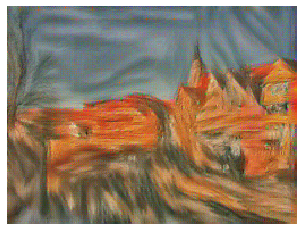

In [52]:
# Scream + Tubingen
params2 = {
    'content_image':'styles/tubingen.jpg',
    'style_image':'styles/the_scream.jpg',
    'image_size':192,
    'style_size':224,
    'content_layer':3,
    'content_weight':3e-2,
    'style_layers':[1, 4, 6, 7],
    'style_weights':[200000, 800, 12, 1],
    'tv_weight':2e-2
}

style_transfer(**params2)

[tensor([[[[1.4045e+00, 1.3991e+00, 1.4167e+00,  ..., 1.6555e+00,
           1.6585e+00, 1.6740e+00],
          [1.3914e+00, 1.4067e+00, 1.4585e+00,  ..., 1.6310e+00,
           1.6535e+00, 1.6837e+00],
          [1.4507e+00, 1.3805e+00, 1.2793e+00,  ..., 1.6648e+00,
           1.6551e+00, 1.7271e+00],
          ...,
          [8.6090e-01, 8.7313e-01, 9.2216e-01,  ..., 4.7700e-01,
           4.1022e-01, 4.2663e-01],
          [8.7173e-01, 8.8907e-01, 9.0449e-01,  ..., 5.4801e-01,
           5.0989e-01, 5.4026e-01],
          [8.6761e-01, 9.1816e-01, 9.0512e-01,  ..., 4.9316e-01,
           4.3647e-01, 5.8950e-01]],

         [[0.0000e+00, 0.0000e+00, 3.1706e-01,  ..., 8.0888e-02,
           7.1759e-02, 5.1046e-02],
          [8.3821e-02, 9.5538e-02, 2.4084e-01,  ..., 7.0147e-02,
           6.1948e-02, 7.1490e-02],
          [4.0346e-01, 6.6374e-02, 1.7668e-02,  ..., 8.7499e-02,
           4.5348e-02, 8.8522e-02],
          ...,
          [4.2776e-03, 0.0000e+00, 3.9169e-02,  ..., 5.996

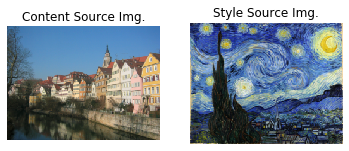

[tensor([[[[1.4045e+00, 1.3991e+00, 1.4167e+00,  ..., 1.6555e+00,
           1.6585e+00, 1.6740e+00],
          [1.3914e+00, 1.4067e+00, 1.4585e+00,  ..., 1.6310e+00,
           1.6535e+00, 1.6837e+00],
          [1.4507e+00, 1.3805e+00, 1.2793e+00,  ..., 1.6648e+00,
           1.6551e+00, 1.7271e+00],
          ...,
          [8.0056e-01, 7.8659e-01, 7.9820e-01,  ..., 4.7700e-01,
           4.1022e-01, 4.2663e-01],
          [7.8924e-01, 7.7921e-01, 8.2491e-01,  ..., 5.4801e-01,
           5.0989e-01, 5.4026e-01],
          [7.9524e-01, 7.7917e-01, 8.5735e-01,  ..., 4.9316e-01,
           4.3647e-01, 5.8950e-01]],

         [[0.0000e+00, 0.0000e+00, 3.1706e-01,  ..., 8.0888e-02,
           7.1759e-02, 5.1046e-02],
          [8.3821e-02, 9.5538e-02, 2.4084e-01,  ..., 7.0147e-02,
           6.1948e-02, 7.1490e-02],
          [4.0346e-01, 6.6374e-02, 1.7668e-02,  ..., 8.7499e-02,
           4.5348e-02, 8.8522e-02],
          ...,
          [1.7013e-02, 8.3940e-04, 8.9472e-03,  ..., 5.996

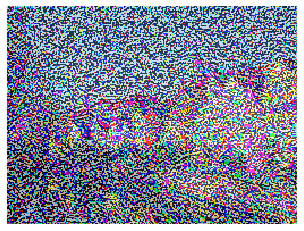

[tensor([[[[1.6155e+00, 2.0840e+00, 3.2432e+00,  ..., 1.2194e+00,
           8.0830e-01, 8.9233e-01],
          [2.3307e+00, 2.1334e+00, 4.4822e+00,  ..., 8.8456e-01,
           7.8126e-01, 1.7849e+00],
          [1.9904e+00, 1.5137e+00, 1.3490e+00,  ..., 0.0000e+00,
           4.7769e-01, 8.3164e-01],
          ...,
          [8.2746e-01, 5.3534e-01, 2.8655e+00,  ..., 6.3493e-01,
           0.0000e+00, 6.7018e-01],
          [3.2563e-01, 1.6342e+00, 2.0027e+00,  ..., 1.8534e+00,
           0.0000e+00, 3.3260e+00],
          [2.4122e+00, 2.6965e+00, 2.6493e+00,  ..., 4.9736e-02,
           0.0000e+00, 3.8695e+00]],

         [[9.3250e-01, 0.0000e+00, 2.9420e+00,  ..., 2.3747e+00,
           2.6629e+00, 0.0000e+00],
          [4.6756e-01, 0.0000e+00, 2.0995e+00,  ..., 0.0000e+00,
           0.0000e+00, 1.9039e+00],
          [7.3266e+00, 1.3494e-01, 0.0000e+00,  ..., 1.8813e+00,
           0.0000e+00, 0.0000e+00],
          ...,
          [6.6497e+00, 0.0000e+00, 1.4096e+00,  ..., 0.000

[tensor([[[[0.0000, 0.0000, 0.0000,  ..., 0.5630, 0.0000, 0.9374],
          [0.0000, 0.0000, 0.0000,  ..., 0.2634, 1.6863, 0.0000],
          [0.0000, 0.8451, 2.1014,  ..., 0.6224, 0.2567, 0.0000],
          ...,
          [1.1974, 0.0000, 0.0000,  ..., 0.8526, 4.1479, 1.8979],
          [1.0040, 0.6226, 0.0000,  ..., 0.0000, 2.1252, 1.2733],
          [0.0123, 3.4956, 1.6859,  ..., 1.0916, 1.6917, 0.0000]],

         [[0.0000, 1.4840, 0.0000,  ..., 0.0000, 0.0000, 0.8099],
          [0.0000, 1.0900, 0.0000,  ..., 5.6752, 0.4927, 0.0000],
          [0.0000, 0.0000, 2.1096,  ..., 0.0000, 3.9077, 0.0000],
          ...,
          [0.0000, 4.0665, 0.2946,  ..., 0.2132, 0.0000, 3.6379],
          [0.0000, 0.0000, 0.0000,  ..., 1.7556, 2.3614, 0.8893],
          [2.7976, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[4.4214, 2.2468, 3.9684,  ..., 2.2713, 0.0000, 0.0000],
          [2.2483, 0.0000, 0.0000,  ..., 0.9720, 4.8520, 3.3317],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.1833, 0.0000, 0.0000,  ..., 0.0000, 0.8059, 1.2888],
          [0.5553, 1.2173, 0.0000,  ..., 0.1626, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.5444,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [2.7138, 0.0000, 0.0000,  ..., 0.5209, 4.1497, 3.1539],
          [0.1839, 0.0000, 0.0000,  ..., 0.0000, 2.3574, 3.8070],
          [0.0000, 1.0609, 0.1018,  ..., 0.0000, 0.9615, 0.0000]],

         [[0.0000, 1.2879, 0.0000,  ..., 0.0000, 1.2071, 0.4125],
          [0.0000, 0.9910, 0.0000,  ..., 1.3428, 0.0000, 0.0000],
          [1.5350, 0.0849, 1.4558,  ..., 0.0000, 2.4314, 0.0000],
          ...,
          [0.0722, 1.2114, 0.0000,  ..., 0.0000, 1.0783, 1.6990],
          [0.0120, 0.0000, 1.6706,  ..., 0.8216, 1.3538, 0.0000],
          [1.2208, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 1.7900]],

         [[2.3363, 1.7564, 2.1899,  ..., 2.2115, 0.4762, 1.7755],
          [2.6935, 0.0000, 0.0000,  ..., 4.1877, 0.0000, 2.0691],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.3469e-01, 5.6139e-02, 6.2271e-01,  ..., 0.0000e+00,
           7.1070e-01, 2.2924e+00],
          [1.5387e+00, 1.9151e+00, 6.4649e-01,  ..., 3.5325e-01,
           0.0000e+00, 1.5228e+00],
          [3.3093e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          ...,
          [2.4703e+00, 0.0000e+00, 7.0699e-01,  ..., 4.4750e-01,
           3.0772e+00, 3.3245e+00],
          [0.0000e+00, 2.1748e-01, 7.9177e-01,  ..., 2.2766e-01,
           1.7644e+00, 4.0497e+00],
          [0.0000e+00, 3.1857e-01, 0.0000e+00,  ..., 0.0000e+00,
           1.9839e+00, 0.0000e+00]],

         [[0.0000e+00, 0.0000e+00, 3.8425e-02,  ..., 0.0000e+00,
           2.2336e+00, 0.0000e+00],
          [8.0393e-01, 2.7220e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [5.1551e+00, 3.6777e-01, 1.3935e+00,  ..., 1.4918e+00,
           0.0000e+00, 0.0000e+00],
          ...,
          [1.5923e+00, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[5.6852e-01, 1.5094e-01, 6.5956e-01,  ..., 0.0000e+00,
           1.6831e+00, 2.5807e+00],
          [2.4634e+00, 2.9886e+00, 8.2460e-01,  ..., 0.0000e+00,
           0.0000e+00, 3.4717e+00],
          [8.1386e-01, 0.0000e+00, 0.0000e+00,  ..., 2.5734e-01,
           0.0000e+00, 1.2169e+00],
          ...,
          [1.9455e+00, 0.0000e+00, 2.1461e+00,  ..., 1.3712e+00,
           2.2229e+00, 2.9680e+00],
          [3.9141e-01, 1.2340e+00, 2.8166e+00,  ..., 1.8672e+00,
           8.4877e-01, 3.0852e+00],
          [0.0000e+00, 3.6834e-01, 7.9467e-01,  ..., 0.0000e+00,
           2.2071e+00, 0.0000e+00]],

         [[0.0000e+00, 0.0000e+00, 8.6187e-01,  ..., 0.0000e+00,
           6.7057e-01, 0.0000e+00],
          [8.3408e-01, 9.2515e-02, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [6.0567e+00, 2.4312e-01, 1.7853e-01,  ..., 2.3406e+00,
           0.0000e+00, 6.7907e-01],
          ...,
          [7.2112e-01, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[1.4379e+00, 4.1881e-02, 3.7442e-01,  ..., 5.4068e-01,
           2.3764e+00, 1.6014e+00],
          [3.3968e+00, 3.5500e+00, 1.2320e+00,  ..., 0.0000e+00,
           0.0000e+00, 1.8325e+00],
          [1.8994e+00, 0.0000e+00, 0.0000e+00,  ..., 5.2436e-01,
           0.0000e+00, 1.2707e+00],
          ...,
          [2.9315e-02, 1.0348e+00, 3.3141e+00,  ..., 8.7687e-01,
           6.4816e-01, 1.9413e+00],
          [5.5437e-01, 1.4739e+00, 2.9541e+00,  ..., 2.3380e+00,
           6.3896e-01, 2.0114e+00],
          [0.0000e+00, 6.2364e-01, 1.0100e+00,  ..., 1.0128e+00,
           2.3834e+00, 0.0000e+00]],

         [[0.0000e+00, 0.0000e+00, 1.0374e+00,  ..., 3.2486e-01,
           0.0000e+00, 0.0000e+00],
          [1.3957e-01, 6.2034e-01, 0.0000e+00,  ..., 0.0000e+00,
           2.9051e-02, 0.0000e+00],
          [5.1763e+00, 0.0000e+00, 0.0000e+00,  ..., 1.5166e+00,
           0.0000e+00, 5.9318e-01],
          ...,
          [3.6185e-01, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[1.9952, 0.2281, 0.8655,  ..., 2.3117, 2.5877, 0.8312],
          [3.4811, 3.6407, 1.7507,  ..., 0.6517, 0.0308, 0.0000],
          [1.9569, 0.0000, 0.0000,  ..., 1.0594, 0.6554, 0.6284],
          ...,
          [0.0000, 1.3615, 2.9773,  ..., 0.6179, 0.0000, 1.3573],
          [0.7287, 1.2880, 1.2115,  ..., 2.4540, 0.8399, 1.4051],
          [0.0000, 0.9657, 0.7069,  ..., 1.5086, 2.6721, 0.0000]],

         [[0.0000, 0.0000, 1.0128,  ..., 0.5902, 0.0000, 0.0000],
          [0.0000, 1.3446, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [3.8974, 0.0000, 0.0000,  ..., 0.4750, 0.0000, 0.4892],
          ...,
          [0.0000, 0.3900, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.2284, 1.0330, 0.0000,  ..., 0.0000, 0.2411, 0.3819],
          [0.6395, 0.0000, 1.6098,  ..., 0.9168, 0.0061, 0.1568]],

         [[0.3839, 0.6434, 0.0000,  ..., 0.0847, 1.7605, 1.5758],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 1.3523, 0.8897],
          [2.3961, 2.0064, 0.0000,  ..., 

[tensor([[[[2.3959, 0.8379, 1.5436,  ..., 3.7138, 1.9610, 0.6477],
          [2.7674, 3.0346, 1.7559,  ..., 1.0178, 0.2420, 0.0000],
          [0.9748, 0.0000, 0.0000,  ..., 1.0207, 1.0056, 0.2075],
          ...,
          [0.0000, 1.2074, 1.6646,  ..., 0.6141, 0.0000, 1.1918],
          [0.8152, 1.0962, 0.0000,  ..., 2.5018, 1.5355, 1.2872],
          [0.2773, 1.4187, 0.6903,  ..., 1.2777, 2.8228, 0.0000]],

         [[0.0000, 0.0000, 0.7675,  ..., 0.6612, 0.0000, 0.0000],
          [0.0000, 1.8070, 0.0000,  ..., 0.0000, 0.0000, 0.3787],
          [2.7342, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.6937],
          ...,
          [0.0000, 0.5828, 0.0821,  ..., 0.0000, 0.0000, 0.0000],
          [0.1537, 0.1640, 0.0000,  ..., 0.0000, 0.0000, 1.2307],
          [0.0000, 0.0000, 0.4995,  ..., 0.9488, 0.8794, 0.0000]],

         [[2.9080, 1.2145, 0.0000,  ..., 0.4776, 0.8808, 1.0550],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 1.1968, 1.3453],
          [1.0402, 1.3053, 0.0000,  ..., 

[tensor([[[[2.7483e+00, 1.2938e+00, 1.9120e+00,  ..., 4.2434e+00,
           1.3288e+00, 9.8439e-01],
          [2.3187e+00, 2.4061e+00, 1.7310e+00,  ..., 1.3240e+00,
           4.0197e-01, 0.0000e+00],
          [1.5244e-01, 0.0000e+00, 0.0000e+00,  ..., 9.7376e-01,
           1.2459e+00, 3.3918e-01],
          ...,
          [0.0000e+00, 9.3260e-01, 6.8086e-01,  ..., 1.0301e+00,
           0.0000e+00, 1.2057e+00],
          [4.9841e-01, 1.0211e+00, 0.0000e+00,  ..., 2.7077e+00,
           2.3385e+00, 1.1477e+00],
          [1.0059e+00, 1.6525e+00, 5.7713e-01,  ..., 8.7927e-01,
           2.7162e+00, 0.0000e+00]],

         [[7.3313e-02, 0.0000e+00, 4.1982e-01,  ..., 6.3471e-01,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 1.9344e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 6.3266e-01],
          [1.4806e+00, 6.0999e-02, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 8.8248e-01],
          ...,
          [0.0000e+00, 7.6134e-01, 1.9692e-01,  ..., 0.000

[tensor([[[[2.4388, 1.1338, 1.9763,  ..., 4.1115, 0.9564, 1.3222],
          [1.7471, 1.9966, 1.8655,  ..., 1.7185, 0.8647, 0.8141],
          [0.0000, 0.0000, 0.0000,  ..., 1.2053, 1.6339, 1.0074],
          ...,
          [0.0000, 0.7739, 0.3627,  ..., 1.4943, 0.2663, 1.5483],
          [0.2968, 1.0208, 0.0000,  ..., 2.4809, 2.7379, 1.1243],
          [1.2547, 1.0754, 0.2433,  ..., 0.3479, 2.2632, 0.0000]],

         [[0.1384, 0.0000, 0.1968,  ..., 0.7068, 0.0000, 0.0000],
          [0.0000, 1.7557, 0.0270,  ..., 0.0000, 0.0000, 0.7131],
          [0.3840, 0.3681, 0.0000,  ..., 0.0000, 0.0761, 0.9130],
          ...,
          [0.0000, 0.9129, 0.1762,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 1.7055],
          [0.0000, 0.5069, 0.0000,  ..., 0.2405, 1.8365, 0.0000]],

         [[3.5374, 1.3256, 0.9949,  ..., 0.2230, 0.0000, 0.0000],
          [0.9240, 1.0117, 1.5426,  ..., 0.4512, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.6185, 0.7615, 2.0260,  ..., 3.2876, 0.6496, 1.8241],
          [1.0249, 1.8714, 1.9222,  ..., 1.8793, 1.2579, 1.7632],
          [0.0000, 0.0191, 0.0459,  ..., 0.9073, 1.9286, 1.7576],
          ...,
          [0.0000, 0.6123, 0.4664,  ..., 1.6816, 0.7822, 1.8874],
          [0.2796, 1.2312, 0.0000,  ..., 2.0574, 2.7218, 1.1625],
          [1.4338, 0.7751, 0.1898,  ..., 0.0956, 1.8653, 0.2325]],

         [[0.0540, 0.0000, 0.0225,  ..., 0.5375, 0.0000, 0.0000],
          [0.0000, 1.3180, 0.4263,  ..., 0.0000, 0.0000, 0.4674],
          [0.0000, 0.5354, 0.0000,  ..., 0.0000, 0.0210, 0.5836],
          ...,
          [0.0000, 0.9486, 0.0625,  ..., 0.0948, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 1.4226],
          [0.0123, 0.8368, 0.0000,  ..., 0.0000, 1.6986, 0.0000]],

         [[2.3061, 0.3805, 1.1654,  ..., 0.0000, 0.0000, 0.0000],
          [0.9319, 1.8301, 1.6509,  ..., 0.3110, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.4070,  ..., 

[tensor([[[[0.7960, 0.3071, 2.0074,  ..., 2.1692, 0.4342, 2.2886],
          [0.5268, 1.8373, 1.7527,  ..., 2.0238, 1.4856, 2.5616],
          [0.0000, 0.4599, 0.0269,  ..., 0.7264, 2.0838, 2.2983],
          ...,
          [0.0000, 0.5232, 0.6609,  ..., 1.5935, 1.1311, 2.1651],
          [0.1761, 1.4084, 0.0000,  ..., 1.6734, 2.4275, 1.1789],
          [1.3545, 0.8948, 0.4132,  ..., 0.1618, 1.5964, 0.9059]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.2543, 0.0000, 0.0000],
          [0.4814, 0.9071, 0.3793,  ..., 0.0595, 0.0000, 0.1938],
          [0.0000, 0.5419, 0.0000,  ..., 0.0000, 0.1310, 0.1513],
          ...,
          [0.0000, 0.9210, 0.0000,  ..., 0.3667, 0.0000, 0.0000],
          [0.0000, 0.1412, 0.0000,  ..., 0.0000, 0.0000, 1.0299],
          [0.3524, 1.0153, 0.0000,  ..., 0.0000, 1.3974, 0.0000]],

         [[0.9573, 0.0000, 1.2356,  ..., 0.0000, 0.0000, 0.0000],
          [0.4836, 2.5766, 1.5647,  ..., 0.0000, 0.0000, 0.3959],
          [0.0000, 0.0000, 0.5362,  ..., 

[tensor([[[[0.1853, 0.0747, 1.7648,  ..., 1.3191, 0.5022, 2.6775],
          [0.3877, 1.8855, 1.6754,  ..., 2.1626, 1.6568, 3.1289],
          [0.0000, 0.8135, 0.0096,  ..., 0.7247, 2.1450, 2.7689],
          ...,
          [0.0000, 0.6551, 0.5672,  ..., 1.4737, 1.4082, 2.3675],
          [0.0904, 1.6673, 0.0000,  ..., 1.4216, 2.0136, 1.2234],
          [1.1983, 1.2403, 0.6872,  ..., 0.5285, 1.5059, 1.6522]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [1.1315, 0.5838, 0.0000,  ..., 0.1979, 0.0000, 0.0986],
          [0.0000, 0.4420, 0.0000,  ..., 0.0000, 0.1531, 0.0000],
          ...,
          [0.0000, 0.8303, 0.0000,  ..., 0.5904, 0.0000, 0.0000],
          [0.0000, 0.4292, 0.0000,  ..., 0.0000, 0.0000, 0.6818],
          [0.5437, 1.0698, 0.0000,  ..., 0.0000, 1.0184, 0.0000]],

         [[0.0000, 0.0000, 1.2580,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 2.9587, 1.4578,  ..., 0.0000, 0.0000, 0.8393],
          [0.0000, 0.0000, 0.8337,  ..., 

[tensor([[[[0.0000, 0.1170, 1.6399,  ..., 0.8313, 0.7876, 3.1281],
          [0.4282, 1.9412, 1.6158,  ..., 2.2311, 1.7995, 3.2684],
          [0.0000, 1.1139, 0.0000,  ..., 0.7025, 2.0833, 2.9669],
          ...,
          [0.2441, 0.7061, 0.3886,  ..., 1.5155, 1.6987, 2.3507],
          [0.0096, 1.6999, 0.0000,  ..., 1.2919, 1.8429, 1.3601],
          [0.9734, 1.5331, 0.9213,  ..., 1.0312, 1.7289, 2.3226]],

         [[0.0000, 0.0000, 0.1160,  ..., 0.0000, 0.0000, 0.0000],
          [1.5205, 0.2355, 0.0000,  ..., 0.1970, 0.0000, 0.0588],
          [0.0000, 0.2909, 0.0873,  ..., 0.0000, 0.1358, 0.0000],
          ...,
          [0.0000, 0.6593, 0.0000,  ..., 0.6652, 0.0000, 0.0000],
          [0.0000, 0.5085, 0.0000,  ..., 0.0000, 0.0000, 0.3382],
          [0.6337, 0.9339, 0.0000,  ..., 0.0282, 0.7410, 0.0000]],

         [[0.0000, 0.0000, 1.1910,  ..., 0.0000, 0.1560, 0.2027],
          [0.0000, 2.9943, 1.5339,  ..., 0.0000, 0.0000, 0.4185],
          [0.2107, 0.0000, 0.9840,  ..., 

[tensor([[[[0.0000, 0.4473, 1.7064,  ..., 0.7097, 1.2138, 3.5297],
          [0.4611, 1.8106, 1.5675,  ..., 2.2987, 1.9712, 3.0964],
          [0.0000, 1.2211, 0.0000,  ..., 0.5836, 1.9842, 2.8359],
          ...,
          [0.5383, 0.7283, 0.2676,  ..., 1.7731, 1.9980, 2.2124],
          [0.0000, 1.4660, 0.0865,  ..., 1.2755, 1.8112, 1.5297],
          [0.7897, 1.7245, 1.0748,  ..., 1.4353, 2.0127, 2.7232]],

         [[0.0000, 0.0000, 0.1295,  ..., 0.0000, 0.1820, 0.0000],
          [1.5619, 0.0000, 0.0000,  ..., 0.2012, 0.0000, 0.0526],
          [0.0000, 0.1137, 0.4812,  ..., 0.0000, 0.0272, 0.0000],
          ...,
          [0.0000, 0.5273, 0.0000,  ..., 0.6736, 0.0000, 0.0639],
          [0.0000, 0.4354, 0.0514,  ..., 0.0000, 0.0000, 0.0000],
          [0.6764, 0.6587, 0.2878,  ..., 0.2658, 0.5261, 0.0000]],

         [[0.0000, 0.0000, 1.0832,  ..., 0.0000, 0.6936, 0.4313],
          [0.0000, 2.6603, 1.5722,  ..., 0.0000, 0.0000, 0.0000],
          [0.3514, 0.0000, 0.9251,  ..., 

[tensor([[[[0.0000e+00, 8.9385e-01, 1.8293e+00,  ..., 6.9728e-01,
           1.6270e+00, 3.7082e+00],
          [5.4224e-01, 1.6501e+00, 1.3706e+00,  ..., 2.3217e+00,
           2.1692e+00, 2.9017e+00],
          [0.0000e+00, 1.2510e+00, 0.0000e+00,  ..., 3.6094e-01,
           1.8864e+00, 2.6024e+00],
          ...,
          [7.5772e-01, 7.9021e-01, 2.0348e-01,  ..., 2.0520e+00,
           2.1833e+00, 2.0188e+00],
          [0.0000e+00, 1.1001e+00, 2.2908e-01,  ..., 1.2694e+00,
           1.8259e+00, 1.6021e+00],
          [6.5896e-01, 1.7039e+00, 1.0951e+00,  ..., 1.6978e+00,
           2.2299e+00, 2.7001e+00]],

         [[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           9.8093e-02, 0.0000e+00],
          [1.4287e+00, 0.0000e+00, 0.0000e+00,  ..., 2.4375e-01,
           0.0000e+00, 1.0149e-01],
          [0.0000e+00, 0.0000e+00, 7.7949e-01,  ..., 7.9214e-02,
           0.0000e+00, 1.3882e-01],
          ...,
          [0.0000e+00, 4.2853e-01, 0.0000e+00,  ..., 6.368

[tensor([[[[0.0000, 1.2982, 1.9172,  ..., 0.7382, 2.0150, 3.6667],
          [0.7460, 1.5947, 1.1229,  ..., 2.4324, 2.3800, 2.6653],
          [0.0000, 1.3249, 0.0000,  ..., 0.3236, 1.8606, 2.3376],
          ...,
          [0.9325, 0.8757, 0.2057,  ..., 2.2613, 2.2562, 1.8610],
          [0.0000, 0.7281, 0.3568,  ..., 1.2433, 1.8250, 1.6208],
          [0.5700, 1.4986, 1.0437,  ..., 1.8432, 2.3236, 2.5136]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [1.2098, 0.0000, 0.0000,  ..., 0.2332, 0.0000, 0.0411],
          [0.0000, 0.0000, 0.9241,  ..., 0.0849, 0.0000, 0.2890],
          ...,
          [0.0000, 0.3363, 0.0000,  ..., 0.5186, 0.0705, 0.2059],
          [0.0824, 0.3070, 0.3815,  ..., 0.0000, 0.0000, 0.0000],
          [0.4607, 0.3651, 0.6560,  ..., 0.5786, 0.4709, 0.0000]],

         [[0.0000, 0.2461, 0.8983,  ..., 0.0000, 0.0000, 0.0738],
          [0.0000, 1.5189, 1.6601,  ..., 0.0000, 0.0000, 0.0000],
          [0.4283, 0.0000, 0.4735,  ..., 

[tensor([[[[0.0000, 1.5754, 1.8339,  ..., 0.8342, 2.3920, 3.5027],
          [1.0269, 1.6366, 0.9466,  ..., 2.5078, 2.5747, 2.4537],
          [0.1591, 1.4447, 0.0989,  ..., 0.3825, 1.8678, 2.1299],
          ...,
          [1.0543, 0.9420, 0.3018,  ..., 2.2817, 2.2569, 1.7683],
          [0.0207, 0.3966, 0.4626,  ..., 1.1845, 1.8383, 1.7198],
          [0.4716, 1.1170, 0.9642,  ..., 1.9211, 2.3729, 2.3591]],

         [[0.0000, 0.0664, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.9154, 0.0000, 0.0089,  ..., 0.1427, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.9668,  ..., 0.0513, 0.0000, 0.4262],
          ...,
          [0.1630, 0.2486, 0.0000,  ..., 0.3826, 0.1701, 0.2220],
          [0.1027, 0.2924, 0.5108,  ..., 0.0000, 0.0000, 0.0000],
          [0.3019, 0.3089, 0.5265,  ..., 0.5895, 0.5031, 0.3175]],

         [[0.0000, 0.5331, 0.7653,  ..., 0.0377, 0.0000, 0.0000],
          [0.0093, 0.9722, 1.5165,  ..., 0.0000, 0.0902, 0.0000],
          [0.4496, 0.0000, 0.2625,  ..., 

[tensor([[[[0.1134, 1.7858, 1.6885,  ..., 0.9916, 2.6796, 3.2821],
          [1.3240, 1.7681, 0.8336,  ..., 2.5122, 2.7465, 2.3238],
          [0.3300, 1.5772, 0.2283,  ..., 0.4964, 1.8809, 1.9639],
          ...,
          [1.0225, 0.9698, 0.4760,  ..., 2.1146, 2.1919, 1.7371],
          [0.0685, 0.1222, 0.5476,  ..., 1.1087, 1.8501, 1.9174],
          [0.4019, 0.7177, 0.8718,  ..., 1.9418, 2.3563, 2.3023]],

         [[0.0000, 0.1796, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.6301, 0.0000, 0.1065,  ..., 0.0036, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.8753,  ..., 0.0000, 0.0000, 0.5742],
          ...,
          [0.4126, 0.1604, 0.0000,  ..., 0.2365, 0.2209, 0.2115],
          [0.0550, 0.2758, 0.6414,  ..., 0.0000, 0.0000, 0.0000],
          [0.1703, 0.2503, 0.3126,  ..., 0.5069, 0.5318, 0.6111]],

         [[0.0000, 0.7272, 0.5944,  ..., 0.2277, 0.0000, 0.0000],
          [0.5610, 0.6475, 1.1856,  ..., 0.0000, 0.1663, 0.0000],
          [0.4578, 0.0000, 0.0488,  ..., 

[tensor([[[[4.0723e-01, 1.9591e+00, 1.5616e+00,  ..., 1.1507e+00,
           2.8719e+00, 3.0177e+00],
          [1.5306e+00, 1.8622e+00, 7.5591e-01,  ..., 2.4138e+00,
           2.8720e+00, 2.2457e+00],
          [4.3223e-01, 1.6720e+00, 3.2864e-01,  ..., 6.2921e-01,
           1.8930e+00, 1.8708e+00],
          ...,
          [8.9050e-01, 1.0053e+00, 6.7588e-01,  ..., 1.9008e+00,
           2.1109e+00, 1.7581e+00],
          [1.0689e-01, 0.0000e+00, 6.4127e-01,  ..., 1.0826e+00,
           1.8707e+00, 2.1688e+00],
          [4.4559e-01, 4.4940e-01, 7.5479e-01,  ..., 1.9752e+00,
           2.3021e+00, 2.3306e+00]],

         [[0.0000e+00, 2.2707e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [4.0664e-01, 0.0000e+00, 8.7657e-02,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 6.8949e-01,  ..., 0.0000e+00,
           0.0000e+00, 6.1769e-01],
          ...,
          [6.2077e-01, 1.1028e-01, 0.0000e+00,  ..., 9.515

[tensor([[[[6.8249e-01, 2.0826e+00, 1.4724e+00,  ..., 1.2790e+00,
           2.9722e+00, 2.7705e+00],
          [1.6699e+00, 1.9437e+00, 7.2142e-01,  ..., 2.2978e+00,
           2.9712e+00, 2.2032e+00],
          [5.3209e-01, 1.7385e+00, 4.1174e-01,  ..., 7.8152e-01,
           1.9138e+00, 1.8188e+00],
          ...,
          [7.1833e-01, 1.0321e+00, 8.5645e-01,  ..., 1.7278e+00,
           2.0739e+00, 1.8342e+00],
          [1.3387e-01, 0.0000e+00, 7.7039e-01,  ..., 1.1237e+00,
           1.9563e+00, 2.4302e+00],
          [5.6053e-01, 2.9857e-01, 6.4947e-01,  ..., 1.9682e+00,
           2.2069e+00, 2.3980e+00]],

         [[0.0000e+00, 2.2673e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [1.7872e-01, 0.0000e+00, 2.3485e-03,  ..., 0.0000e+00,
           1.2422e-01, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 4.6889e-01,  ..., 0.0000e+00,
           0.0000e+00, 5.6576e-01],
          ...,
          [7.7417e-01, 1.0497e-01, 0.0000e+00,  ..., 0.000

[tensor([[[[9.1927e-01, 2.1527e+00, 1.4246e+00,  ..., 1.3950e+00,
           2.9929e+00, 2.5902e+00],
          [1.7389e+00, 1.9949e+00, 7.1848e-01,  ..., 2.1871e+00,
           3.0052e+00, 2.2356e+00],
          [6.1069e-01, 1.7717e+00, 4.8709e-01,  ..., 9.3201e-01,
           1.9154e+00, 1.8237e+00],
          ...,
          [5.7682e-01, 1.0638e+00, 1.0049e+00,  ..., 1.6297e+00,
           2.0440e+00, 1.9164e+00],
          [1.8071e-01, 0.0000e+00, 9.1148e-01,  ..., 1.2091e+00,
           2.0283e+00, 2.6160e+00],
          [6.9929e-01, 2.3701e-01, 5.5421e-01,  ..., 1.9078e+00,
           2.0654e+00, 2.4066e+00]],

         [[0.0000e+00, 1.8428e-01, 0.0000e+00,  ..., 0.0000e+00,
           1.6673e-01, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           3.5725e-01, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 2.6720e-01,  ..., 4.7087e-04,
           0.0000e+00, 4.8264e-01],
          ...,
          [8.2990e-01, 1.4411e-01, 0.0000e+00,  ..., 0.000

[tensor([[[[1.1233e+00, 2.1662e+00, 1.4148e+00,  ..., 1.4843e+00,
           2.9893e+00, 2.4496e+00],
          [1.7577e+00, 2.0182e+00, 7.5116e-01,  ..., 2.0733e+00,
           2.9569e+00, 2.2732e+00],
          [6.8680e-01, 1.7827e+00, 5.6393e-01,  ..., 1.0429e+00,
           1.8510e+00, 1.8624e+00],
          ...,
          [5.3314e-01, 1.0822e+00, 1.1155e+00,  ..., 1.5833e+00,
           1.9937e+00, 1.9433e+00],
          [2.3330e-01, 1.5561e-02, 1.0129e+00,  ..., 1.3054e+00,
           2.0582e+00, 2.6092e+00],
          [7.8340e-01, 2.4437e-01, 4.9656e-01,  ..., 1.8022e+00,
           1.8947e+00, 2.2239e+00]],

         [[2.3189e-03, 1.1130e-01, 0.0000e+00,  ..., 0.0000e+00,
           1.3577e-01, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           5.4021e-01, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 1.1550e-01,  ..., 7.3975e-02,
           0.0000e+00, 3.9366e-01],
          ...,
          [8.3390e-01, 1.9342e-01, 0.0000e+00,  ..., 0.000

[tensor([[[[1.3065, 2.1273, 1.4398,  ..., 1.5833, 2.9660, 2.3369],
          [1.7575, 2.0375, 0.8242,  ..., 1.9969, 2.8952, 2.2823],
          [0.7696, 1.7811, 0.6634,  ..., 1.0465, 1.7895, 1.9032],
          ...,
          [0.5925, 1.1063, 1.1629,  ..., 1.5368, 1.9105, 1.9512],
          [0.3253, 0.1063, 1.1010,  ..., 1.3765, 2.0818, 2.4775],
          [0.8387, 0.3468, 0.5064,  ..., 1.6601, 1.7477, 1.9903]],

         [[0.0582, 0.0106, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.6044, 0.0000],
          [0.0000, 0.0000, 0.0164,  ..., 0.1045, 0.0000, 0.3193],
          ...,
          [0.7921, 0.2544, 0.0000,  ..., 0.0525, 0.0000, 0.5321],
          [0.0000, 0.0000, 0.6859,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.6386, 0.0187,  ..., 0.2694, 0.2669, 0.4507]],

         [[0.0000, 0.6226, 0.0000,  ..., 0.0000, 0.1292, 0.0071],
          [0.2097, 0.0000, 0.0000,  ..., 0.0000, 0.0405, 0.6839],
          [0.0032, 0.0000, 0.0000,  ..., 

[tensor([[[[1.4619, 2.0594, 1.4780,  ..., 1.6950, 2.8729, 2.2334],
          [1.7516, 2.0620, 0.9077,  ..., 1.9696, 2.8548, 2.2658],
          [0.8479, 1.7710, 0.7767,  ..., 1.0139, 1.7848, 1.9206],
          ...,
          [0.7087, 1.1383, 1.1510,  ..., 1.4799, 1.8131, 1.8883],
          [0.4676, 0.2369, 1.1922,  ..., 1.4054, 2.1141, 2.3069],
          [0.8986, 0.5162, 0.5774,  ..., 1.4965, 1.6373, 1.8009]],

         [[0.0950, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0181, 0.0000,  ..., 0.0000, 0.5355, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.1055, 0.0000, 0.2921],
          ...,
          [0.7305, 0.3140, 0.0000,  ..., 0.1292, 0.0000, 0.6580],
          [0.0000, 0.0000, 0.6253,  ..., 0.0000, 0.0000, 0.1255],
          [0.0000, 0.7311, 0.0000,  ..., 0.2273, 0.2152, 0.3050]],

         [[0.0000, 0.3713, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0274, 0.0000, 0.4992],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.5775, 2.0063, 1.5261,  ..., 1.8124, 2.7422, 2.1649],
          [1.7521, 2.0895, 1.0072,  ..., 1.9726, 2.8345, 2.2613],
          [0.9179, 1.7524, 0.8893,  ..., 1.0476, 1.8096, 1.9483],
          ...,
          [0.8157, 1.1733, 1.1240,  ..., 1.4250, 1.7201, 1.7739],
          [0.6241, 0.4036, 1.2463,  ..., 1.4222, 2.1728, 2.1231],
          [0.9618, 0.7230, 0.6807,  ..., 1.3787, 1.5715, 1.6576]],

         [[0.0908, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0616],
          [0.0000, 0.1350, 0.0000,  ..., 0.0000, 0.3922, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.1594, 0.0000, 0.2804],
          ...,
          [0.6915, 0.3881, 0.0000,  ..., 0.1858, 0.0000, 0.7245],
          [0.0000, 0.0000, 0.5443,  ..., 0.0000, 0.0000, 0.2817],
          [0.0000, 0.6682, 0.0000,  ..., 0.1968, 0.1911, 0.1917]],

         [[0.0000, 0.1558, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0233, 0.0000, 0.1935],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.6891, 2.0027, 1.5717,  ..., 1.9255, 2.6087, 2.1271],
          [1.7615, 2.1107, 1.0908,  ..., 1.9599, 2.7836, 2.2887],
          [0.9824, 1.7366, 0.9929,  ..., 1.1300, 1.8238, 2.0000],
          ...,
          [0.9069, 1.2185, 1.1205,  ..., 1.3934, 1.6627, 1.7271],
          [0.7519, 0.5693, 1.2850,  ..., 1.4473, 2.2552, 2.0035],
          [0.9770, 0.9276, 0.8096,  ..., 1.3030, 1.5478, 1.5611]],

         [[0.1064, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1059],
          [0.0000, 0.2308, 0.0000,  ..., 0.0000, 0.2642, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.2371, 0.0000, 0.3031],
          ...,
          [0.6194, 0.4691, 0.0000,  ..., 0.2044, 0.0000, 0.7464],
          [0.0000, 0.0000, 0.4877,  ..., 0.0000, 0.0000, 0.4002],
          [0.0000, 0.5829, 0.0000,  ..., 0.1832, 0.1933, 0.0982]],

         [[0.0000, 0.0755, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.8022e+00, 2.0750e+00, 1.6034e+00,  ..., 2.0201e+00,
           2.4797e+00, 2.1050e+00],
          [1.7758e+00, 2.1262e+00, 1.1417e+00,  ..., 1.9244e+00,
           2.6825e+00, 2.3398e+00],
          [1.0386e+00, 1.7343e+00, 1.0791e+00,  ..., 1.1631e+00,
           1.8280e+00, 2.0745e+00],
          ...,
          [9.7067e-01, 1.2609e+00, 1.1174e+00,  ..., 1.3784e+00,
           1.6303e+00, 1.7266e+00],
          [8.4032e-01, 7.2370e-01, 1.3256e+00,  ..., 1.4662e+00,
           2.2986e+00, 1.9017e+00],
          [9.5452e-01, 1.1206e+00, 9.5656e-01,  ..., 1.2271e+00,
           1.5284e+00, 1.4593e+00]],

         [[1.1404e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 9.5802e-02],
          [0.0000e+00, 2.5943e-01, 0.0000e+00,  ..., 0.0000e+00,
           2.0003e-01, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 3.3383e-01,
           0.0000e+00, 2.9252e-01],
          ...,
          [5.4493e-01, 5.3492e-01, 0.0000e+00,  ..., 2.058

[tensor([[[[1.9079, 2.1353, 1.5930,  ..., 2.1116, 2.3700, 2.1390],
          [1.7916, 2.1292, 1.1731,  ..., 1.8679, 2.5323, 2.3975],
          [1.0887, 1.7170, 1.1450,  ..., 1.2368, 1.8634, 2.1493],
          ...,
          [0.9981, 1.2312, 1.1117,  ..., 1.3942, 1.6322, 1.7447],
          [0.9110, 0.8586, 1.3375,  ..., 1.4856, 2.3298, 1.8518],
          [0.9711, 1.2940, 1.0873,  ..., 1.1531, 1.5126, 1.3853]],

         [[0.0969, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1271],
          [0.0000, 0.2413, 0.0000,  ..., 0.0000, 0.1505, 0.0000],
          [0.0595, 0.0000, 0.0000,  ..., 0.2283, 0.0000, 0.3070],
          ...,
          [0.4750, 0.5227, 0.0000,  ..., 0.2037, 0.0000, 0.7417],
          [0.0000, 0.0000, 0.4529,  ..., 0.0000, 0.0000, 0.4539],
          [0.0000, 0.4796, 0.0000,  ..., 0.2080, 0.1876, 0.0000]],

         [[0.0000, 0.2841, 0.0768,  ..., 0.0474, 0.0999, 0.0677],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.0026e+00, 2.1034e+00, 1.5563e+00,  ..., 2.1708e+00,
           2.2781e+00, 2.2783e+00],
          [1.8103e+00, 2.1321e+00, 1.1853e+00,  ..., 1.8421e+00,
           2.4049e+00, 2.5296e+00],
          [1.1390e+00, 1.7027e+00, 1.1871e+00,  ..., 1.4044e+00,
           1.9504e+00, 2.2086e+00],
          ...,
          [1.0120e+00, 1.1650e+00, 1.1103e+00,  ..., 1.4149e+00,
           1.6359e+00, 1.7606e+00],
          [9.6883e-01, 9.5248e-01, 1.3196e+00,  ..., 1.4576e+00,
           2.2868e+00, 1.8043e+00],
          [9.9627e-01, 1.3715e+00, 1.1759e+00,  ..., 1.0838e+00,
           1.4676e+00, 1.3381e+00]],

         [[6.4094e-02, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 1.0904e-01],
          [0.0000e+00, 2.5133e-01, 0.0000e+00,  ..., 0.0000e+00,
           1.0105e-01, 0.0000e+00],
          [1.1411e-01, 0.0000e+00, 0.0000e+00,  ..., 1.6112e-01,
           0.0000e+00, 1.8317e-01],
          ...,
          [4.0742e-01, 4.6994e-01, 0.0000e+00,  ..., 1.914

[tensor([[[[2.0898e+00, 2.0453e+00, 1.5321e+00,  ..., 2.1823e+00,
           2.2149e+00, 2.4057e+00],
          [1.8375e+00, 2.1218e+00, 1.1580e+00,  ..., 1.8239e+00,
           2.3563e+00, 2.6269e+00],
          [1.1983e+00, 1.6962e+00, 1.1761e+00,  ..., 1.5963e+00,
           2.0780e+00, 2.2819e+00],
          ...,
          [1.0380e+00, 1.0922e+00, 1.1004e+00,  ..., 1.4384e+00,
           1.6384e+00, 1.7674e+00],
          [1.0027e+00, 9.7569e-01, 1.3162e+00,  ..., 1.3907e+00,
           2.1770e+00, 1.7425e+00],
          [9.8863e-01, 1.2844e+00, 1.2227e+00,  ..., 1.0212e+00,
           1.4282e+00, 1.3199e+00]],

         [[2.8449e-02, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 1.1038e-01],
          [0.0000e+00, 3.0403e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [1.4275e-01, 0.0000e+00, 0.0000e+00,  ..., 1.1702e-01,
           7.2088e-02, 6.1997e-02],
          ...,
          [3.2487e-01, 4.1732e-01, 0.0000e+00,  ..., 1.413

[tensor([[[[2.1769, 2.0029, 1.4965,  ..., 2.1847, 2.1678, 2.5106],
          [1.8670, 2.1021, 1.1050,  ..., 1.7863, 2.3201, 2.6571],
          [1.2737, 1.7085, 1.1558,  ..., 1.7728, 2.1795, 2.3569],
          ...,
          [1.0725, 1.0093, 1.0445,  ..., 1.4033, 1.6091, 1.7629],
          [1.0227, 0.9578, 1.2462,  ..., 1.3001, 2.0186, 1.6837],
          [0.9878, 1.1954, 1.2426,  ..., 0.9687, 1.3833, 1.3029]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0826],
          [0.0000, 0.3431, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.1371, 0.0000, 0.0000,  ..., 0.0797, 0.1748, 0.0000],
          ...,
          [0.2480, 0.3690, 0.0000,  ..., 0.0682, 0.0000, 0.5631],
          [0.0000, 0.0000, 0.3837,  ..., 0.0238, 0.2334, 0.3488],
          [0.0000, 0.4734, 0.0239,  ..., 0.2457, 0.0393, 0.0000]],

         [[0.0000, 0.0000, 0.0413,  ..., 0.0000, 0.0000, 0.0116],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.3196],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.2381, 1.9664, 1.4603,  ..., 2.1956, 2.1545, 2.5737],
          [1.8870, 2.0840, 1.0702,  ..., 1.7508, 2.2917, 2.6166],
          [1.3626, 1.7327, 1.1432,  ..., 1.8441, 2.2319, 2.4242],
          ...,
          [1.0723, 0.9289, 0.9794,  ..., 1.3154, 1.5395, 1.7358],
          [1.0123, 0.9207, 1.1602,  ..., 1.2006, 1.8114, 1.6088],
          [0.9751, 1.1253, 1.2567,  ..., 0.9210, 1.3329, 1.2896]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0866, 0.0000, 0.0960],
          [0.0000, 0.2754, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0970, 0.0000, 0.0000,  ..., 0.0398, 0.2483, 0.0000],
          ...,
          [0.1679, 0.3237, 0.0000,  ..., 0.0000, 0.0000, 0.5675],
          [0.0000, 0.0000, 0.3499,  ..., 0.0868, 0.3458, 0.2953],
          [0.0140, 0.4545, 0.0396,  ..., 0.2126, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.2866, 1.9402, 1.4327,  ..., 2.2104, 2.1425, 2.6001],
          [1.9074, 2.0867, 1.0397,  ..., 1.7017, 2.2476, 2.5561],
          [1.4344, 1.7736, 1.1749,  ..., 1.8326, 2.2638, 2.4760],
          ...,
          [1.0778, 0.8419, 0.9079,  ..., 1.2836, 1.4538, 1.7133],
          [0.9911, 0.8699, 1.0645,  ..., 1.1314, 1.6081, 1.5408],
          [0.9519, 1.0659, 1.2115,  ..., 0.8902, 1.3050, 1.2921]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.1910, 0.0118, 0.1121],
          [0.0000, 0.1720, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0669, 0.0000, 0.0000,  ..., 0.0192, 0.2263, 0.0000],
          ...,
          [0.1116, 0.2766, 0.0000,  ..., 0.0000, 0.0000, 0.5874],
          [0.0000, 0.0000, 0.3103,  ..., 0.1446, 0.4029, 0.2274],
          [0.0478, 0.4452, 0.0747,  ..., 0.1991, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.3298, 1.9248, 1.3896,  ..., 2.2257, 2.1590, 2.5773],
          [1.9449, 2.0858, 0.9907,  ..., 1.6582, 2.2332, 2.5219],
          [1.4968, 1.8060, 1.1926,  ..., 1.7422, 2.2986, 2.5379],
          ...,
          [1.0599, 0.7829, 0.8619,  ..., 1.3082, 1.4142, 1.6921],
          [0.9491, 0.8328, 0.9998,  ..., 1.0889, 1.4694, 1.4798],
          [0.9271, 1.0215, 1.1178,  ..., 0.8731, 1.2940, 1.3084]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.2500, 0.0622, 0.1794],
          [0.0000, 0.0587, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0099, 0.0000, 0.0556,  ..., 0.0000, 0.2074, 0.0000],
          ...,
          [0.0790, 0.2125, 0.0000,  ..., 0.0000, 0.0000, 0.5973],
          [0.0000, 0.0000, 0.2713,  ..., 0.1594, 0.4064, 0.1712],
          [0.0576, 0.4457, 0.1001,  ..., 0.2018, 0.0000, 0.0239]],

         [[0.0000, 0.0000, 0.0898,  ..., 0.0000, 0.0781, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.3169e+00, 1.9410e+00, 1.3703e+00,  ..., 2.2000e+00,
           2.2273e+00, 2.4377e+00],
          [1.9414e+00, 2.0938e+00, 8.7680e-01,  ..., 1.5533e+00,
           2.2684e+00, 2.4707e+00],
          [1.5268e+00, 1.8243e+00, 1.1865e+00,  ..., 1.7197e+00,
           2.3114e+00, 2.6129e+00],
          ...,
          [9.5819e-01, 7.6387e-01, 8.5244e-01,  ..., 1.3297e+00,
           1.4203e+00, 1.6449e+00],
          [8.8949e-01, 8.3770e-01, 9.9256e-01,  ..., 1.0554e+00,
           1.4047e+00, 1.4273e+00],
          [9.8114e-01, 1.0417e+00, 1.0302e+00,  ..., 8.5902e-01,
           1.2831e+00, 1.3252e+00]],

         [[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 3.7705e-01,
           1.3888e-02, 1.5576e-01],
          [0.0000e+00, 2.7320e-02, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 9.4793e-02],
          [0.0000e+00, 0.0000e+00, 2.7697e-02,  ..., 1.8760e-02,
           3.0937e-01, 0.0000e+00],
          ...,
          [3.7754e-02, 1.3864e-01, 0.0000e+00,  ..., 0.000

[tensor([[[[2.2985, 1.8843, 1.3671,  ..., 2.2123, 2.3468, 2.3641],
          [1.9443, 2.0968, 0.8623,  ..., 1.3640, 2.1760, 2.5034],
          [1.5426, 1.8463, 1.1360,  ..., 1.6484, 2.2162, 2.7109],
          ...,
          [0.9111, 0.7981, 0.9560,  ..., 1.2112, 1.4478, 1.5954],
          [0.8639, 0.9112, 1.0381,  ..., 1.0171, 1.4457, 1.3841],
          [1.1064, 1.0811, 0.9975,  ..., 0.8761, 1.3304, 1.3806]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.2641, 0.0000, 0.0587],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1597],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.2538, 0.0991],
          ...,
          [0.0000, 0.1431, 0.0000,  ..., 0.0000, 0.0000, 0.7227],
          [0.0000, 0.0000, 0.2103,  ..., 0.1562, 0.3644, 0.0268],
          [0.0698, 0.3776, 0.0378,  ..., 0.2902, 0.0522, 0.0962]],

         [[0.0000, 0.0000, 0.1577,  ..., 0.0000, 0.0000, 0.1612],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.2847, 1.8381, 1.3325,  ..., 2.2617, 2.4300, 2.3406],
          [1.9147, 2.0856, 0.8678,  ..., 1.2746, 2.1272, 2.5631],
          [1.5308, 1.8214, 1.0992,  ..., 1.6188, 2.2024, 2.7529],
          ...,
          [0.9609, 0.9014, 1.0338,  ..., 1.0939, 1.4726, 1.5309],
          [0.8712, 0.9993, 1.1223,  ..., 0.9971, 1.4996, 1.3458],
          [1.1893, 1.1338, 1.0307,  ..., 0.8867, 1.3787, 1.4261]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.1272, 0.0222, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1516],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1665, 0.2233],
          ...,
          [0.0000, 0.2269, 0.0000,  ..., 0.0000, 0.0000, 0.7085],
          [0.0000, 0.0000, 0.2379,  ..., 0.1183, 0.3470, 0.0000],
          [0.0746, 0.4190, 0.0000,  ..., 0.3518, 0.1217, 0.1237]],

         [[0.0000, 0.0000, 0.2541,  ..., 0.0491, 0.0000, 0.5331],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0339],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.2855, 1.8174, 1.2767,  ..., 2.3066, 2.5170, 2.3397],
          [1.8989, 2.0958, 0.8883,  ..., 1.3979, 2.2115, 2.6570],
          [1.5249, 1.7965, 1.0990,  ..., 1.7404, 2.3030, 2.7225],
          ...,
          [1.0967, 1.0266, 1.0247,  ..., 1.0486, 1.4913, 1.4534],
          [0.8793, 1.0688, 1.2159,  ..., 0.9849, 1.5481, 1.2970],
          [1.2024, 1.1732, 1.0849,  ..., 0.8846, 1.4074, 1.4300]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0168, 0.0219, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0442, 0.0918],
          [0.0000, 0.1044, 0.0000,  ..., 0.0000, 0.0069, 0.3606],
          ...,
          [0.0000, 0.3130, 0.0656,  ..., 0.0000, 0.0000, 0.6241],
          [0.0000, 0.0000, 0.2645,  ..., 0.0959, 0.3644, 0.0000],
          [0.0884, 0.4977, 0.0000,  ..., 0.3629, 0.1561, 0.1556]],

         [[0.0000, 0.0000, 0.1899,  ..., 0.2079, 0.0000, 0.7960],
          [0.0000, 0.0000, 0.0000,  ..., 0.1335, 0.0000, 0.1469],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.3118e+00, 1.8437e+00, 1.1910e+00,  ..., 2.3659e+00,
           2.5868e+00, 2.3981e+00],
          [1.9320e+00, 2.1478e+00, 8.6974e-01,  ..., 1.5832e+00,
           2.3456e+00, 2.7865e+00],
          [1.5444e+00, 1.7845e+00, 1.1360e+00,  ..., 1.8242e+00,
           2.4700e+00, 2.6526e+00],
          ...,
          [1.2475e+00, 1.1211e+00, 1.0390e+00,  ..., 1.0387e+00,
           1.4917e+00, 1.3907e+00],
          [8.6748e-01, 1.1049e+00, 1.2523e+00,  ..., 9.8485e-01,
           1.5658e+00, 1.2408e+00],
          [1.2186e+00, 1.2282e+00, 1.1556e+00,  ..., 8.8052e-01,
           1.4105e+00, 1.4107e+00]],

         [[0.0000e+00, 2.1430e-02, 0.0000e+00,  ..., 1.7139e-02,
           2.5816e-03, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           1.7587e-01, 1.3053e-01],
          [0.0000e+00, 2.0213e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 3.7822e-01],
          ...,
          [0.0000e+00, 3.5031e-01, 1.2924e-01,  ..., 2.950

[tensor([[[[2.3406e+00, 1.8981e+00, 1.1147e+00,  ..., 2.4292e+00,
           2.6728e+00, 2.4812e+00],
          [2.0158e+00, 2.2380e+00, 7.9281e-01,  ..., 1.6964e+00,
           2.4241e+00, 2.8920e+00],
          [1.5917e+00, 1.7902e+00, 1.1766e+00,  ..., 1.7816e+00,
           2.5443e+00, 2.6092e+00],
          ...,
          [1.3881e+00, 1.1800e+00, 1.0830e+00,  ..., 1.0113e+00,
           1.4637e+00, 1.3298e+00],
          [8.5994e-01, 1.1169e+00, 1.2563e+00,  ..., 9.8042e-01,
           1.5621e+00, 1.1805e+00],
          [1.2304e+00, 1.3072e+00, 1.2677e+00,  ..., 8.7179e-01,
           1.4200e+00, 1.4001e+00]],

         [[0.0000e+00, 7.9880e-02, 0.0000e+00,  ..., 4.2333e-04,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           2.3307e-01, 1.7527e-01],
          [0.0000e+00, 2.7910e-01, 0.0000e+00,  ..., 1.8161e-01,
           0.0000e+00, 3.5953e-01],
          ...,
          [0.0000e+00, 3.3729e-01, 1.5794e-01,  ..., 1.071

[tensor([[[[2.3575, 1.9636, 1.0367,  ..., 2.4742, 2.7682, 2.6128],
          [2.1761, 2.3622, 0.6936,  ..., 1.6423, 2.3859, 3.0662],
          [1.6740, 1.8143, 1.2125,  ..., 1.7980, 2.4248, 2.6527],
          ...,
          [1.4676, 1.2324, 1.1339,  ..., 0.9595, 1.4851, 1.2859],
          [0.8786, 1.0924, 1.2646,  ..., 0.9664, 1.5582, 1.1212],
          [1.2630, 1.3863, 1.4341,  ..., 0.8577, 1.3750, 1.3538]],

         [[0.0000, 0.1317, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.4732, 0.2618],
          [0.0000, 0.3143, 0.1871,  ..., 0.2872, 0.0000, 0.3087],
          ...,
          [0.0000, 0.3472, 0.1927,  ..., 0.1485, 0.0000, 0.5015],
          [0.0000, 0.0000, 0.1950,  ..., 0.0304, 0.6096, 0.0000],
          [0.1661, 0.4899, 0.0000,  ..., 0.3232, 0.1016, 0.2985]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.1958, 0.6680, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.3373, 0.8585],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.3884, 2.0118, 0.9896,  ..., 2.4837, 2.8781, 2.7407],
          [2.2785, 2.4099, 0.5381,  ..., 1.6164, 2.4860, 3.0820],
          [1.7396, 1.8349, 1.1921,  ..., 1.8238, 2.4964, 2.6999],
          ...,
          [1.4139, 1.2891, 1.1647,  ..., 0.9654, 1.4881, 1.2705],
          [0.8349, 1.0542, 1.2517,  ..., 0.9791, 1.4883, 1.0860],
          [1.3212, 1.4375, 1.4727,  ..., 0.8597, 1.3110, 1.3229]],

         [[0.0000, 0.1394, 0.0000,  ..., 0.0412, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.2007,  ..., 0.0000, 0.5004, 0.3254],
          [0.0000, 0.2904, 0.2173,  ..., 0.1731, 0.0000, 0.3330],
          ...,
          [0.0000, 0.3722, 0.2714,  ..., 0.2133, 0.0000, 0.3970],
          [0.0000, 0.0000, 0.2501,  ..., 0.0143, 0.6256, 0.0000],
          [0.1665, 0.3421, 0.0000,  ..., 0.3260, 0.0575, 0.3400]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.7790, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.6714, 0.9501],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.4177, 2.0995, 0.9693,  ..., 2.4859, 2.9858, 2.8226],
          [2.3557, 2.3951, 0.5583,  ..., 1.5496, 2.6283, 2.9767],
          [1.7765, 1.8436, 1.1803,  ..., 1.8890, 2.6325, 2.7452],
          ...,
          [1.3598, 1.3093, 1.1748,  ..., 1.0817, 1.4319, 1.2612],
          [0.7715, 1.0091, 1.1740,  ..., 1.0290, 1.3453, 1.0543],
          [1.3385, 1.3534, 1.2486,  ..., 0.8918, 1.2373, 1.3027]],

         [[0.0000, 0.1001, 0.0000,  ..., 0.0260, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0094,  ..., 0.2199, 0.3415, 0.2290],
          [0.0000, 0.1894, 0.2943,  ..., 0.0000, 0.0000, 0.3925],
          ...,
          [0.0000, 0.3328, 0.2927,  ..., 0.3608, 0.0000, 0.2674],
          [0.0000, 0.0000, 0.3174,  ..., 0.0000, 0.4651, 0.0000],
          [0.1436, 0.2272, 0.0000,  ..., 0.3118, 0.0000, 0.3792]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.9237, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.8407, 0.5698],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.4043, 2.1880, 0.9830,  ..., 2.5162, 3.0573, 2.8641],
          [2.3936, 2.3873, 0.6323,  ..., 1.3951, 2.6485, 2.8743],
          [1.7918, 1.8591, 1.2089,  ..., 1.8990, 2.6514, 2.7906],
          ...,
          [1.2709, 1.2576, 1.2002,  ..., 1.1284, 1.3426, 1.2464],
          [0.7214, 0.9813, 1.1324,  ..., 1.0682, 1.2120, 1.0546],
          [1.3501, 1.2643, 1.0665,  ..., 0.9177, 1.1885, 1.3125]],

         [[0.0000, 0.1135, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.3020, 0.1206, 0.0579],
          [0.0000, 0.1066, 0.4242,  ..., 0.0000, 0.0000, 0.4002],
          ...,
          [0.0294, 0.2587, 0.2226,  ..., 0.4147, 0.0000, 0.0943],
          [0.0000, 0.0000, 0.3296,  ..., 0.0000, 0.3250, 0.0000],
          [0.1177, 0.1180, 0.0531,  ..., 0.2523, 0.0000, 0.4140]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.6602, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.6345, 0.3541],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.3952, 2.2607, 0.9910,  ..., 2.5958, 3.1604, 2.9229],
          [2.4002, 2.3812, 0.6882,  ..., 1.2082, 2.5674, 2.8325],
          [1.8265, 1.8758, 1.2605,  ..., 1.8034, 2.5753, 2.8386],
          ...,
          [1.2199, 1.2089, 1.2633,  ..., 1.0921, 1.2660, 1.2211],
          [0.6957, 0.9649, 1.1557,  ..., 1.1031, 1.1540, 1.0734],
          [1.3142, 1.1999, 0.9722,  ..., 0.9513, 1.1854, 1.3557]],

         [[0.0000, 0.1582, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0250, 0.0000,  ..., 0.1872, 0.0000, 0.0000],
          [0.0000, 0.0210, 0.6129,  ..., 0.0000, 0.0000, 0.4020],
          ...,
          [0.0577, 0.1882, 0.1383,  ..., 0.3734, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.3069,  ..., 0.0000, 0.2872, 0.0000],
          [0.0880, 0.0522, 0.2019,  ..., 0.1663, 0.0000, 0.4148]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1840, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.2341, 0.1322],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.4066, 2.2824, 0.9575,  ..., 2.6585, 3.2842, 3.0333],
          [2.4569, 2.4196, 0.6211,  ..., 1.1510, 2.5991, 2.8914],
          [1.8973, 1.9265, 1.2591,  ..., 1.7973, 2.5731, 2.9100],
          ...,
          [1.1908, 1.2189, 1.3512,  ..., 1.0191, 1.2600, 1.2478],
          [0.7073, 0.9555, 1.2288,  ..., 1.1157, 1.1628, 1.1172],
          [1.2596, 1.1623, 0.9459,  ..., 0.9585, 1.1936, 1.4137]],

         [[0.0000, 0.1503, 0.0000,  ..., 0.0000, 0.0000, 0.2229],
          [0.0000, 0.1463, 0.0000,  ..., 0.1122, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.5853,  ..., 0.0000, 0.0000, 0.1732],
          ...,
          [0.0714, 0.1413, 0.0992,  ..., 0.2575, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.2342,  ..., 0.0000, 0.3236, 0.0000],
          [0.1613, 0.0250, 0.3800,  ..., 0.0795, 0.0000, 0.4448]],

         [[0.2339, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.3794, 2.3317, 0.9495,  ..., 2.7375, 3.4005, 3.2186],
          [2.4198, 2.3743, 0.5669,  ..., 1.2002, 2.8257, 2.9669],
          [1.9534, 1.9480, 1.2715,  ..., 1.8982, 2.8438, 2.8802],
          ...,
          [1.2752, 1.2503, 1.4274,  ..., 1.0208, 1.2636, 1.2749],
          [0.7629, 0.8765, 1.3119,  ..., 1.1427, 1.1784, 1.1295],
          [1.1834, 1.1154, 0.9903,  ..., 0.9607, 1.2089, 1.4283]],

         [[0.0000, 0.3295, 0.0000,  ..., 0.0000, 0.0000, 0.2037],
          [0.0000, 0.2599, 0.0000,  ..., 0.2844, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.5261,  ..., 0.0000, 0.1733, 0.1193],
          ...,
          [0.1198, 0.0998, 0.0350,  ..., 0.2137, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.1112,  ..., 0.0040, 0.3673, 0.0000],
          [0.2173, 0.0051, 0.3224,  ..., 0.0000, 0.0000, 0.4444]],

         [[0.1111, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0345, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.3597, 2.3406, 0.9743,  ..., 2.7782, 3.3479, 3.2886],
          [2.3601, 2.3324, 0.5549,  ..., 1.4105, 3.0553, 3.0842],
          [2.0002, 1.9588, 1.2476,  ..., 2.0695, 3.0785, 2.8389],
          ...,
          [1.4051, 1.2618, 1.4115,  ..., 1.0306, 1.2520, 1.2720],
          [0.8539, 0.7943, 1.3614,  ..., 1.1654, 1.1677, 1.0938],
          [1.0806, 1.0934, 1.0763,  ..., 0.9503, 1.2105, 1.3527]],

         [[0.0000, 0.3981, 0.0000,  ..., 0.0000, 0.0000, 0.1387],
          [0.0000, 0.3312, 0.1866,  ..., 0.3146, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.3452,  ..., 0.0000, 0.2928, 0.0532],
          ...,
          [0.1834, 0.0903, 0.0000,  ..., 0.2222, 0.0000, 0.0596],
          [0.0000, 0.0000, 0.0704,  ..., 0.0448, 0.4074, 0.0000],
          [0.2226, 0.0000, 0.2013,  ..., 0.0000, 0.0000, 0.4514]],

         [[0.1071, 0.0000, 0.0000,  ..., 0.0905, 0.0000, 0.0049],
          [0.0000, 0.0000, 0.0000,  ..., 0.0851, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.3539e+00, 2.3660e+00, 1.1076e+00,  ..., 2.7175e+00,
           3.2589e+00, 3.2747e+00],
          [2.3012e+00, 2.3222e+00, 6.6338e-01,  ..., 1.5390e+00,
           3.1512e+00, 3.1968e+00],
          [2.0501e+00, 1.9856e+00, 1.2150e+00,  ..., 2.1708e+00,
           3.1023e+00, 2.8464e+00],
          ...,
          [1.4970e+00, 1.2843e+00, 1.3046e+00,  ..., 1.0653e+00,
           1.2288e+00, 1.1982e+00],
          [9.7612e-01, 7.4366e-01, 1.3523e+00,  ..., 1.1952e+00,
           1.1480e+00, 1.0221e+00],
          [1.0026e+00, 1.1078e+00, 1.1437e+00,  ..., 9.1546e-01,
           1.1993e+00, 1.1917e+00]],

         [[0.0000e+00, 1.8555e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 1.6952e-01],
          [0.0000e+00, 2.8080e-01, 3.1707e-01,  ..., 1.6289e-01,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 1.6334e-01,  ..., 0.0000e+00,
           2.6048e-01, 4.4993e-02],
          ...,
          [2.1326e-01, 1.5806e-01, 0.0000e+00,  ..., 2.448

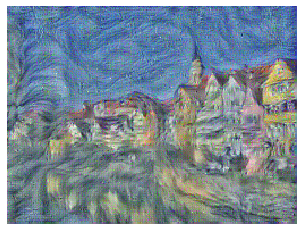

[tensor([[[[2.3555, 2.4192, 1.2545,  ..., 2.6241, 3.1615, 3.2629],
          [2.3068, 2.3454, 0.8134,  ..., 1.4488, 2.9345, 3.2721],
          [2.1316, 2.0402, 1.1620,  ..., 2.1209, 2.7892, 2.8875],
          ...,
          [1.4330, 1.2503, 1.1965,  ..., 1.1218, 1.2017, 1.0766],
          [1.0320, 0.7340, 1.2795,  ..., 1.1926, 1.1331, 0.9634],
          [0.9727, 1.1510, 1.1351,  ..., 0.8891, 1.1982, 1.0626]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.2995],
          [0.0000, 0.2022, 0.3074,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0563,  ..., 0.1741, 0.0763, 0.1528],
          ...,
          [0.3109, 0.1857, 0.0000,  ..., 0.2212, 0.0000, 0.3411],
          [0.0000, 0.0000, 0.2306,  ..., 0.1080, 0.5766, 0.0000],
          [0.1139, 0.0000, 0.0485,  ..., 0.0000, 0.0000, 0.4395]],

         [[0.5600, 0.0409, 0.3391,  ..., 0.0087, 0.0000, 0.3792],
          [0.0000, 0.0000, 0.0000,  ..., 0.8525, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.3990e+00, 2.4895e+00, 1.3357e+00,  ..., 2.5725e+00,
           3.0463e+00, 3.2306e+00],
          [2.3468e+00, 2.3970e+00, 9.7849e-01,  ..., 1.4009e+00,
           2.7329e+00, 3.2488e+00],
          [2.2301e+00, 2.0997e+00, 1.1232e+00,  ..., 2.0737e+00,
           2.5665e+00, 2.9243e+00],
          ...,
          [1.3020e+00, 1.1831e+00, 1.1372e+00,  ..., 1.1489e+00,
           1.1349e+00, 9.9158e-01],
          [1.0838e+00, 7.7462e-01, 1.2457e+00,  ..., 1.1532e+00,
           1.0863e+00, 9.2923e-01],
          [1.0475e+00, 1.2465e+00, 1.1734e+00,  ..., 8.4834e-01,
           1.1959e+00, 9.6273e-01]],

         [[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 1.6241e-01],
          [0.0000e+00, 1.1166e-01, 4.7711e-02,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 2.8159e-02,  ..., 2.5337e-01,
           0.0000e+00, 2.3897e-01],
          ...,
          [3.6175e-01, 1.7439e-01, 0.0000e+00,  ..., 1.930

[tensor([[[[2.5023e+00, 2.6190e+00, 1.3744e+00,  ..., 2.5687e+00,
           2.9959e+00, 3.3620e+00],
          [2.4236e+00, 2.5183e+00, 1.0620e+00,  ..., 1.3941e+00,
           2.7190e+00, 3.3759e+00],
          [2.3065e+00, 2.1583e+00, 1.0641e+00,  ..., 2.2004e+00,
           2.5618e+00, 2.8820e+00],
          ...,
          [1.1586e+00, 1.0569e+00, 1.1289e+00,  ..., 1.1666e+00,
           1.0935e+00, 9.1977e-01],
          [1.1357e+00, 8.6709e-01, 1.2522e+00,  ..., 1.1158e+00,
           1.0710e+00, 9.1218e-01],
          [1.1963e+00, 1.3843e+00, 1.1209e+00,  ..., 8.2122e-01,
           1.1648e+00, 8.9209e-01]],

         [[1.7504e-02, 0.0000e+00, 7.0702e-02,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 8.1790e-02, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 1.2045e-01, 0.0000e+00,  ..., 4.9264e-01,
           0.0000e+00, 4.0342e-01],
          ...,
          [3.9918e-01, 9.2746e-02, 0.0000e+00,  ..., 1.593

[tensor([[[[2.5808, 2.2514, 1.3152,  ..., 2.5473, 2.9740, 3.4686],
          [2.4812, 2.6169, 1.1263,  ..., 1.4647, 2.8122, 3.3970],
          [2.3643, 2.2008, 1.0799,  ..., 2.2919, 2.7243, 2.7343],
          ...,
          [1.1104, 1.0156, 1.0753,  ..., 1.1559, 1.0949, 0.9017],
          [1.2128, 0.9356, 1.2888,  ..., 1.1169, 1.0760, 0.9094],
          [1.2992, 1.4778, 1.3099,  ..., 0.8658, 1.0968, 0.8483]],

         [[0.0263, 0.0000, 0.2615,  ..., 0.1149, 0.0000, 0.0000],
          [0.0000, 0.0460, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.3609, 0.0000,  ..., 0.3139, 0.0000, 0.5212],
          ...,
          [0.3491, 0.0000, 0.0000,  ..., 0.1526, 0.0000, 0.0680],
          [0.0000, 0.0000, 0.2342,  ..., 0.0707, 0.5049, 0.0000],
          [0.0000, 0.0251, 0.0000,  ..., 0.0909, 0.0000, 0.3132]],

         [[0.8774, 0.2169, 0.5767,  ..., 0.0000, 0.0243, 1.3173],
          [0.0000, 0.0000, 0.0000,  ..., 0.7107, 0.3783, 0.2334],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.6319e+00, 2.0648e+00, 1.2501e+00,  ..., 2.5613e+00,
           2.9830e+00, 3.3781e+00],
          [2.4865e+00, 2.6534e+00, 1.0994e+00,  ..., 1.5926e+00,
           2.8986e+00, 3.3101e+00],
          [2.3316e+00, 2.1916e+00, 1.1234e+00,  ..., 2.2996e+00,
           2.8679e+00, 2.5857e+00],
          ...,
          [1.1119e+00, 9.7439e-01, 1.1444e+00,  ..., 1.1191e+00,
           1.1270e+00, 9.0968e-01],
          [1.2567e+00, 1.0028e+00, 1.3126e+00,  ..., 1.1276e+00,
           1.1212e+00, 9.1176e-01],
          [1.3552e+00, 1.4447e+00, 1.4418e+00,  ..., 9.3389e-01,
           1.0559e+00, 8.1823e-01]],

         [[2.6737e-02, 0.0000e+00, 2.9599e-01,  ..., 3.3320e-01,
           6.5677e-02, 0.0000e+00],
          [0.0000e+00, 1.5271e-03, 6.2832e-02,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 3.4698e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 4.9712e-01],
          ...,
          [2.8930e-01, 0.0000e+00, 0.0000e+00,  ..., 1.344

[tensor([[[[2.6809, 1.9795, 1.1399,  ..., 2.6259, 3.0260, 3.2149],
          [2.4526, 2.6400, 1.0353,  ..., 1.6322, 2.8944, 3.2373],
          [2.2546, 2.1898, 1.1852,  ..., 2.1605, 2.8678, 2.5594],
          ...,
          [1.1986, 0.9939, 1.2268,  ..., 1.0343, 1.1590, 0.9186],
          [1.3183, 1.1151, 1.3250,  ..., 1.0973, 1.1587, 0.9144],
          [1.3690, 1.3645, 1.5080,  ..., 0.9878, 1.0170, 0.8115]],

         [[0.0094, 0.0000, 0.1722,  ..., 0.5083, 0.0000, 0.0873],
          [0.0000, 0.0000, 0.3916,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.2521, 0.0000,  ..., 0.0000, 0.0000, 0.3421],
          ...,
          [0.2441, 0.0371, 0.0000,  ..., 0.1171, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.3435,  ..., 0.0202, 0.3813, 0.0000],
          [0.1138, 0.0000, 0.0000,  ..., 0.2134, 0.0000, 0.2688]],

         [[0.5714, 0.0000, 0.6921,  ..., 0.0000, 0.7155, 1.1427],
          [0.0000, 0.0000, 0.0000,  ..., 0.2822, 0.1762, 0.6233],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.6971e+00, 1.9195e+00, 9.4914e-01,  ..., 2.6230e+00,
           3.1065e+00, 3.2221e+00],
          [2.4960e+00, 2.7109e+00, 1.0445e+00,  ..., 1.5694e+00,
           2.9183e+00, 3.2548e+00],
          [2.2702e+00, 2.2520e+00, 1.2979e+00,  ..., 2.0843e+00,
           2.9566e+00, 2.4941e+00],
          ...,
          [1.3418e+00, 1.0567e+00, 1.2586e+00,  ..., 9.7504e-01,
           1.1786e+00, 9.2724e-01],
          [1.4200e+00, 1.2200e+00, 1.3041e+00,  ..., 1.0590e+00,
           1.2090e+00, 9.2125e-01],
          [1.3970e+00, 1.3028e+00, 1.5316e+00,  ..., 1.0051e+00,
           1.0129e+00, 8.2232e-01]],

         [[0.0000e+00, 0.0000e+00, 2.5509e-02,  ..., 3.8862e-01,
           1.2626e-03, 1.2915e-01],
          [0.0000e+00, 1.0095e-01, 2.3414e-01,  ..., 1.3567e-01,
           1.2399e-01, 0.0000e+00],
          [0.0000e+00, 1.6149e-01, 2.7367e-01,  ..., 0.0000e+00,
           0.0000e+00, 2.3107e-01],
          ...,
          [2.0070e-01, 8.0936e-02, 0.0000e+00,  ..., 5.611

[tensor([[[[2.6325e+00, 1.8807e+00, 8.7328e-01,  ..., 2.5546e+00,
           3.0928e+00, 3.1751e+00],
          [2.4156e+00, 2.5414e+00, 1.1069e+00,  ..., 1.6887e+00,
           2.9610e+00, 3.1257e+00],
          [2.2684e+00, 2.2539e+00, 1.3463e+00,  ..., 2.0446e+00,
           2.8506e+00, 2.4696e+00],
          ...,
          [1.4841e+00, 1.1389e+00, 1.2914e+00,  ..., 8.8936e-01,
           1.2283e+00, 9.8272e-01],
          [1.4519e+00, 1.1787e+00, 1.1663e+00,  ..., 1.0217e+00,
           1.3456e+00, 1.0001e+00],
          [1.4558e+00, 1.2683e+00, 1.3246e+00,  ..., 9.5081e-01,
           1.0614e+00, 8.5000e-01]],

         [[0.0000e+00, 0.0000e+00, 2.1063e-02,  ..., 0.0000e+00,
           8.9138e-02, 2.5626e-01],
          [0.0000e+00, 1.0854e-01, 0.0000e+00,  ..., 1.6344e-01,
           7.4748e-03, 0.0000e+00],
          [0.0000e+00, 1.0295e-01, 4.3007e-01,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          ...,
          [1.7607e-01, 1.1324e-01, 0.0000e+00,  ..., 4.161

[tensor([[[[2.4703, 1.9526, 0.7993,  ..., 2.4824, 3.1623, 3.1889],
          [2.2826, 2.3342, 1.1984,  ..., 1.6916, 3.0138, 3.1394],
          [2.2677, 2.2399, 1.3262,  ..., 1.9287, 2.8057, 2.6152],
          ...,
          [1.4593, 1.2945, 1.3104,  ..., 0.9830, 1.2662, 1.0573],
          [1.4124, 1.1141, 1.0778,  ..., 1.0985, 1.4668, 1.0792],
          [1.5295, 1.2298, 1.1601,  ..., 0.9201, 1.0592, 0.9343]],

         [[0.0000, 0.0000, 0.1281,  ..., 0.0000, 0.0230, 0.4135],
          [0.0102, 0.0000, 0.0000,  ..., 0.3914, 0.0000, 0.0648],
          [0.0000, 0.0168, 0.4982,  ..., 0.0000, 0.0976, 0.0000],
          ...,
          [0.2475, 0.2397, 0.0000,  ..., 0.0000, 0.0000, 0.1232],
          [0.0000, 0.4944, 0.0000,  ..., 0.0225, 0.0000, 0.0000],
          [0.6906, 0.0000, 0.0738,  ..., 0.3065, 0.0000, 0.2005]],

         [[0.8056, 0.0000, 0.0000,  ..., 0.5462, 0.0204, 0.2611],
          [0.0000, 0.0000, 0.0331,  ..., 0.1462, 0.4108, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.2495, 1.9290, 0.8046,  ..., 2.4607, 3.2199, 3.2557],
          [2.1445, 2.1076, 1.1917,  ..., 1.7449, 2.9929, 3.1745],
          [2.1854, 2.2050, 1.2490,  ..., 1.9602, 2.6370, 2.7544],
          ...,
          [1.4679, 1.4864, 1.2779,  ..., 1.1075, 1.2760, 1.1302],
          [1.3224, 0.9974, 1.0823,  ..., 1.1780, 1.3956, 1.1054],
          [1.4866, 1.2004, 1.1131,  ..., 0.9240, 1.0520, 1.0294]],

         [[0.0000, 0.0000, 0.1340,  ..., 0.0000, 0.0000, 0.2295],
          [0.2095, 0.0000, 0.0000,  ..., 0.4589, 0.0000, 0.3590],
          [0.0890, 0.0000, 0.4219,  ..., 0.0000, 0.3375, 0.0000],
          ...,
          [0.1667, 0.3388, 0.0000,  ..., 0.0000, 0.0000, 0.1797],
          [0.0000, 0.5651, 0.0000,  ..., 0.0574, 0.0000, 0.0000],
          [0.6670, 0.0000, 0.2872,  ..., 0.3518, 0.0223, 0.2141]],

         [[1.0770, 0.0000, 0.0000,  ..., 0.7535, 0.0000, 0.0000],
          [0.0000, 0.1284, 0.0574,  ..., 0.2720, 0.0983, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.0697, 1.9168, 0.8684,  ..., 2.4009, 3.3449, 3.3362],
          [2.0353, 1.8859, 1.1584,  ..., 1.9011, 3.0144, 3.1885],
          [2.1077, 2.1156, 1.1829,  ..., 1.9652, 2.6584, 2.8014],
          ...,
          [1.4784, 1.5646, 1.2467,  ..., 1.1248, 1.2342, 1.1950],
          [1.2018, 0.9106, 1.1439,  ..., 1.1726, 1.1884, 1.0834],
          [1.4010, 1.1599, 1.1652,  ..., 0.9238, 1.0357, 1.0933]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0559],
          [0.4252, 0.0000, 0.0000,  ..., 0.5475, 0.0000, 0.6021],
          [0.1635, 0.0000, 0.3700,  ..., 0.0000, 0.5306, 0.0000],
          ...,
          [0.0922, 0.3649, 0.0000,  ..., 0.0000, 0.0000, 0.1899],
          [0.0000, 0.5181, 0.0000,  ..., 0.0266, 0.0000, 0.0000],
          [0.6356, 0.0000, 0.3382,  ..., 0.3414, 0.0528, 0.2517]],

         [[1.1623, 0.0000, 0.0000,  ..., 0.6332, 0.0000, 0.0000],
          [0.0000, 0.2520, 0.0000,  ..., 0.0000, 0.0316, 0.5840],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.9512e+00, 1.9133e+00, 9.0770e-01,  ..., 2.3828e+00,
           3.4550e+00, 3.4488e+00],
          [1.9677e+00, 1.7374e+00, 1.1200e+00,  ..., 2.1098e+00,
           3.0390e+00, 3.2991e+00],
          [2.0430e+00, 2.0284e+00, 1.1200e+00,  ..., 1.9594e+00,
           2.6883e+00, 2.8461e+00],
          ...,
          [1.4798e+00, 1.4591e+00, 1.2093e+00,  ..., 1.0427e+00,
           1.1761e+00, 1.2253e+00],
          [1.1251e+00, 8.7312e-01, 1.2347e+00,  ..., 1.1131e+00,
           9.7557e-01, 1.0543e+00],
          [1.3527e+00, 1.1623e+00, 1.2747e+00,  ..., 9.2362e-01,
           1.0291e+00, 1.1346e+00]],

         [[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [5.7249e-01, 0.0000e+00, 0.0000e+00,  ..., 6.5045e-01,
           0.0000e+00, 6.4420e-01],
          [1.5145e-01, 0.0000e+00, 3.0949e-01,  ..., 0.0000e+00,
           5.5110e-01, 0.0000e+00],
          ...,
          [1.4306e-02, 2.8436e-01, 0.0000e+00,  ..., 0.000

[tensor([[[[1.8916e+00, 1.9617e+00, 9.5445e-01,  ..., 2.3565e+00,
           3.2640e+00, 3.4284e+00],
          [1.9349e+00, 1.6757e+00, 1.0790e+00,  ..., 2.2413e+00,
           3.0043e+00, 3.3901e+00],
          [1.9618e+00, 1.9617e+00, 1.0559e+00,  ..., 2.0691e+00,
           2.5872e+00, 2.8813e+00],
          ...,
          [1.4665e+00, 1.2091e+00, 1.2194e+00,  ..., 9.0429e-01,
           1.1509e+00, 1.1702e+00],
          [1.1406e+00, 8.8368e-01, 1.3247e+00,  ..., 1.0445e+00,
           8.2677e-01, 1.0245e+00],
          [1.3565e+00, 1.1906e+00, 1.4359e+00,  ..., 9.3332e-01,
           1.0290e+00, 1.1544e+00]],

         [[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           1.9547e-01, 0.0000e+00],
          [6.9110e-01, 0.0000e+00, 6.7289e-02,  ..., 5.6799e-01,
           0.0000e+00, 4.2949e-01],
          [4.4821e-02, 0.0000e+00, 9.6923e-02,  ..., 5.8688e-02,
           3.9432e-01, 0.0000e+00],
          ...,
          [2.9412e-03, 1.6221e-01, 0.0000e+00,  ..., 0.000

[tensor([[[[1.8918e+00, 2.1568e+00, 1.1410e+00,  ..., 2.3611e+00,
           3.1397e+00, 3.3740e+00],
          [1.9247e+00, 1.7070e+00, 1.1064e+00,  ..., 2.2896e+00,
           2.9466e+00, 3.4509e+00],
          [1.8040e+00, 1.8878e+00, 1.1145e+00,  ..., 2.1750e+00,
           2.4708e+00, 2.7924e+00],
          ...,
          [1.4464e+00, 9.6568e-01, 1.2513e+00,  ..., 7.5925e-01,
           1.1755e+00, 1.1532e+00],
          [1.2288e+00, 9.8454e-01, 1.4014e+00,  ..., 1.0740e+00,
           6.9581e-01, 9.8251e-01],
          [1.3973e+00, 1.2242e+00, 1.5166e+00,  ..., 1.0053e+00,
           9.3448e-01, 1.0660e+00]],

         [[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           5.3382e-01, 0.0000e+00],
          [4.6729e-01, 4.0499e-02, 2.3300e-01,  ..., 5.6486e-01,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.4564e-01,
           4.9889e-02, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[1.9896e+00, 2.1533e+00, 1.2936e+00,  ..., 2.4086e+00,
           3.2403e+00, 3.3110e+00],
          [1.9570e+00, 1.7870e+00, 1.1424e+00,  ..., 2.3074e+00,
           3.0180e+00, 3.3005e+00],
          [1.5995e+00, 1.8136e+00, 1.1512e+00,  ..., 1.9824e+00,
           2.5387e+00, 2.7801e+00],
          ...,
          [1.4446e+00, 8.7036e-01, 1.2800e+00,  ..., 6.8767e-01,
           1.1402e+00, 1.1140e+00],
          [1.3931e+00, 1.1167e+00, 1.3920e+00,  ..., 1.0555e+00,
           5.1423e-01, 9.5996e-01],
          [1.4451e+00, 1.1520e+00, 1.3553e+00,  ..., 1.0099e+00,
           8.2416e-01, 9.9007e-01]],

         [[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           3.5066e-01, 0.0000e+00],
          [2.8198e-01, 8.5342e-02, 3.7620e-01,  ..., 3.5503e-01,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          ...,
          [0.0000e+00, 3.6064e-02, 0.0000e+00,  ..., 1.608

[tensor([[[[2.1137, 2.0447, 1.3063,  ..., 2.4644, 3.1800, 3.2365],
          [2.0712, 1.8716, 1.1334,  ..., 2.3771, 3.0416, 3.1611],
          [1.4662, 1.7297, 1.1900,  ..., 1.7233, 2.5782, 2.7168],
          ...,
          [1.3606, 0.9374, 1.3423,  ..., 0.7348, 1.1060, 1.0425],
          [1.4104, 1.1091, 1.4144,  ..., 0.9925, 0.5170, 0.9886],
          [1.2865, 1.0809, 1.1690,  ..., 0.9542, 0.7915, 0.9637]],

         [[0.2130, 0.0000, 0.0000,  ..., 0.0430, 0.1383, 0.1836],
          [0.1571, 0.1625, 0.1856,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.1339, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.2741, 0.0000,  ..., 0.1998, 0.0000, 0.5947],
          [0.0000, 0.0000, 0.3822,  ..., 0.2423, 0.0000, 0.2891],
          [1.0393, 0.0000, 0.5127,  ..., 0.0276, 0.0000, 0.2689]],

         [[0.8593, 0.1537, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.2863, 0.0000, 0.0000,  ..., 0.5618, 0.0000, 0.0000],
          [0.0000, 0.1501, 0.0000,  ..., 

[tensor([[[[2.1029, 1.8992, 1.3358,  ..., 2.5425, 3.1703, 3.1955],
          [2.1892, 1.9980, 1.1947,  ..., 2.4725, 3.1144, 3.0656],
          [1.4163, 1.6997, 1.2769,  ..., 1.5430, 2.4999, 2.6625],
          ...,
          [1.3072, 1.0693, 1.3296,  ..., 0.8121, 1.0953, 1.0108],
          [1.3693, 1.1472, 1.4038,  ..., 0.9455, 0.6613, 1.0641],
          [1.1564, 1.1447, 1.1042,  ..., 0.9403, 0.8454, 0.9785]],

         [[0.4019, 0.0000, 0.0000,  ..., 0.0091, 0.0000, 0.5795],
          [0.0971, 0.2392, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.2610, 0.0000,  ..., 0.0000, 0.0000, 0.1663],
          ...,
          [0.0000, 0.4278, 0.0000,  ..., 0.1303, 0.0000, 0.4640],
          [0.0000, 0.0000, 0.4993,  ..., 0.4342, 0.0000, 0.3615],
          [0.9344, 0.0000, 0.3156,  ..., 0.0000, 0.0000, 0.2253]],

         [[0.5740, 0.1561, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.1505, 0.0000, 0.1065],
          [0.0000, 0.1508, 0.0000,  ..., 

[tensor([[[[2.0432e+00, 1.7831e+00, 1.4167e+00,  ..., 2.6659e+00,
           3.2925e+00, 3.1030e+00],
          [2.2653e+00, 2.1016e+00, 1.3191e+00,  ..., 2.5215e+00,
           3.1416e+00, 2.9354e+00],
          [1.4190e+00, 1.7001e+00, 1.3680e+00,  ..., 1.5136e+00,
           2.3158e+00, 2.6133e+00],
          ...,
          [1.2488e+00, 1.1405e+00, 1.2744e+00,  ..., 8.7197e-01,
           1.0816e+00, 1.0033e+00],
          [1.2635e+00, 1.1327e+00, 1.4003e+00,  ..., 9.3567e-01,
           8.2258e-01, 1.1445e+00],
          [1.0094e+00, 1.2181e+00, 1.2052e+00,  ..., 9.4804e-01,
           9.3409e-01, 1.0167e+00]],

         [[4.1011e-01, 0.0000e+00, 0.0000e+00,  ..., 3.5901e-02,
           0.0000e+00, 8.0060e-01],
          [1.9399e-02, 2.7596e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 3.7300e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 3.0921e-01],
          ...,
          [0.0000e+00, 4.4980e-01, 0.0000e+00,  ..., 1.040

[tensor([[[[1.9708, 1.7044, 1.5122,  ..., 2.6708, 3.3323, 3.0660],
          [2.2977, 2.1324, 1.4930,  ..., 2.5612, 3.1365, 2.7934],
          [1.4547, 1.7189, 1.4706,  ..., 1.6645, 2.1977, 2.5678],
          ...,
          [1.2418, 1.1592, 1.2570,  ..., 0.9422, 1.0681, 1.0265],
          [1.1887, 1.2003, 1.4813,  ..., 0.9358, 0.9340, 1.2298],
          [0.9271, 1.2422, 1.3270,  ..., 0.9582, 1.0222, 1.0615]],

         [[0.2216, 0.0000, 0.0000,  ..., 0.1203, 0.0000, 1.0075],
          [0.0000, 0.1332, 0.0000,  ..., 0.0000, 0.0166, 0.0000],
          [0.0000, 0.4682, 0.0000,  ..., 0.0799, 0.0000, 0.3623],
          ...,
          [0.0000, 0.3423, 0.0000,  ..., 0.1862, 0.0000, 0.0000],
          [0.4605, 0.0000, 0.2200,  ..., 0.4880, 0.0000, 0.4114],
          [0.5877, 0.0763, 0.0000,  ..., 0.0000, 0.0000, 0.1648]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0252, 0.0000, 0.2239],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.4194, 0.1003, 0.5834,  ..., 

[tensor([[[[1.8524, 1.7045, 1.5561,  ..., 2.4972, 3.1048, 2.9335],
          [2.2675, 2.0781, 1.5420,  ..., 2.5711, 3.2232, 2.8287],
          [1.5234, 1.7434, 1.5116,  ..., 1.7878, 2.3686, 2.4816],
          ...,
          [1.2623, 1.1867, 1.2671,  ..., 1.1514, 1.1182, 1.0478],
          [1.2296, 1.2902, 1.5044,  ..., 1.0095, 1.0197, 1.2829],
          [1.0036, 1.4809, 1.4348,  ..., 0.9847, 1.0915, 1.0462]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0852, 0.0000, 0.5423],
          [0.0111, 0.0000, 0.0000,  ..., 0.1567, 0.0000, 0.0000],
          [0.0000, 0.4014, 0.0000,  ..., 0.0000, 0.0000, 0.2992],
          ...,
          [0.0000, 0.2071, 0.0000,  ..., 0.2285, 0.0000, 0.0000],
          [0.7220, 0.0000, 0.0000,  ..., 0.1921, 0.0000, 0.3977],
          [0.2106, 0.5224, 0.0000,  ..., 0.0267, 0.0000, 0.1292]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.2609, 0.0000, 0.0789],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.4093, 0.0000],
          [0.7027, 0.0000, 0.7276,  ..., 

[tensor([[[[1.7981, 1.8836, 1.6334,  ..., 2.1086, 2.8475, 3.1581],
          [2.1757, 1.9773, 1.5850,  ..., 2.3484, 3.0193, 2.9436],
          [1.6380, 1.7881, 1.4818,  ..., 1.8765, 2.4684, 2.3682],
          ...,
          [1.4269, 1.2199, 1.2586,  ..., 1.4858, 1.2763, 1.0722],
          [1.3591, 1.2693, 1.2349,  ..., 1.0952, 1.1324, 1.2635],
          [1.1921, 1.4730, 1.4780,  ..., 1.0648, 1.1653, 1.0179]],

         [[0.0000, 0.0000, 0.1716,  ..., 0.0498, 0.0000, 0.3202],
          [0.0352, 0.0000, 0.0000,  ..., 0.4097, 0.0000, 0.0000],
          [0.0000, 0.3555, 0.0000,  ..., 0.0000, 0.0000, 0.3063],
          ...,
          [0.0000, 0.1980, 0.0000,  ..., 0.1861, 0.0000, 0.0000],
          [0.7681, 0.0000, 0.0000,  ..., 0.0000, 0.0038, 0.3089],
          [0.0000, 0.7754, 0.0000,  ..., 0.1186, 0.0000, 0.1061]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.5370, 0.4202, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.2163, 0.2657, 0.0000],
          [0.3543, 0.0000, 0.7434,  ..., 

[tensor([[[[1.7959e+00, 2.0063e+00, 1.6387e+00,  ..., 1.8958e+00,
           2.5662e+00, 3.4412e+00],
          [2.1098e+00, 1.9419e+00, 1.4944e+00,  ..., 2.2023e+00,
           2.7329e+00, 3.1923e+00],
          [1.7212e+00, 1.8596e+00, 1.4213e+00,  ..., 1.9654e+00,
           2.4333e+00, 2.3083e+00],
          ...,
          [1.5029e+00, 1.2829e+00, 1.2783e+00,  ..., 1.4905e+00,
           1.3157e+00, 1.0877e+00],
          [1.5488e+00, 1.2857e+00, 9.9576e-01,  ..., 1.0972e+00,
           1.2924e+00, 1.2419e+00],
          [1.4058e+00, 1.5213e+00, 1.2805e+00,  ..., 1.1252e+00,
           1.2705e+00, 1.0203e+00]],

         [[0.0000e+00, 0.0000e+00, 1.6593e-01,  ..., 0.0000e+00,
           6.2390e-02, 0.0000e+00],
          [6.8154e-02, 0.0000e+00, 0.0000e+00,  ..., 7.1807e-02,
           0.0000e+00, 4.9197e-02],
          [0.0000e+00, 3.3420e-01, 1.4649e-01,  ..., 0.0000e+00,
           1.2595e-01, 2.0374e-01],
          ...,
          [0.0000e+00, 1.6738e-01, 0.0000e+00,  ..., 1.873

[tensor([[[[1.8309e+00, 2.0269e+00, 1.5170e+00,  ..., 1.8342e+00,
           2.4713e+00, 3.5070e+00],
          [2.1052e+00, 1.9259e+00, 1.3538e+00,  ..., 2.2069e+00,
           2.5990e+00, 3.2906e+00],
          [1.7454e+00, 1.9304e+00, 1.3642e+00,  ..., 2.1064e+00,
           2.3572e+00, 2.2183e+00],
          ...,
          [1.4038e+00, 1.4055e+00, 1.2933e+00,  ..., 1.1630e+00,
           1.2426e+00, 1.0852e+00],
          [1.6298e+00, 1.4371e+00, 9.7400e-01,  ..., 9.9466e-01,
           1.4244e+00, 1.1873e+00],
          [1.6103e+00, 1.7552e+00, 1.1616e+00,  ..., 1.1836e+00,
           1.3521e+00, 1.0576e+00]],

         [[0.0000e+00, 0.0000e+00, 6.0356e-02,  ..., 0.0000e+00,
           3.0677e-01, 0.0000e+00],
          [6.0231e-02, 0.0000e+00, 2.8512e-03,  ..., 0.0000e+00,
           0.0000e+00, 6.2839e-01],
          [0.0000e+00, 3.6471e-01, 3.2554e-01,  ..., 0.0000e+00,
           3.6943e-01, 5.6195e-02],
          ...,
          [0.0000e+00, 1.5922e-01, 0.0000e+00,  ..., 1.945

[tensor([[[[1.9044e+00, 2.0462e+00, 1.4503e+00,  ..., 1.8492e+00,
           2.4268e+00, 3.2567e+00],
          [2.0934e+00, 1.9766e+00, 1.3161e+00,  ..., 2.3086e+00,
           2.5856e+00, 3.1928e+00],
          [1.7357e+00, 2.0114e+00, 1.3310e+00,  ..., 2.2371e+00,
           2.2497e+00, 2.0654e+00],
          ...,
          [1.2219e+00, 1.5388e+00, 1.3022e+00,  ..., 8.1662e-01,
           1.1304e+00, 1.0541e+00],
          [1.5756e+00, 1.6103e+00, 9.8877e-01,  ..., 8.7541e-01,
           1.5115e+00, 1.1219e+00],
          [1.8031e+00, 1.8497e+00, 1.0354e+00,  ..., 1.2450e+00,
           1.4141e+00, 1.1314e+00]],

         [[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           2.8147e-01, 0.0000e+00],
          [2.5035e-02, 0.0000e+00, 7.0151e-02,  ..., 0.0000e+00,
           0.0000e+00, 6.3642e-01],
          [0.0000e+00, 4.8010e-01, 4.1137e-01,  ..., 1.9407e-01,
           3.8248e-01, 0.0000e+00],
          ...,
          [0.0000e+00, 1.8076e-01, 0.0000e+00,  ..., 1.756

[tensor([[[[1.9423, 2.0173, 1.3592,  ..., 1.8980, 2.5000, 2.8474],
          [2.0671, 2.0414, 1.2982,  ..., 2.4127, 2.7202, 2.8954],
          [1.7664, 2.0411, 1.3678,  ..., 2.1783, 2.3460, 1.8657],
          ...,
          [1.0175, 1.5711, 1.2432,  ..., 0.5502, 1.0589, 1.0386],
          [1.3891, 1.5106, 0.9470,  ..., 0.7877, 1.4949, 1.0052],
          [1.8167, 1.6972, 1.0567,  ..., 1.1772, 1.4333, 1.2007]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1284, 0.0000],
          [0.0138, 0.1111, 0.0000,  ..., 0.0000, 0.0000, 0.0083],
          [0.0761, 0.5786, 0.4246,  ..., 0.2307, 0.2413, 0.0000],
          ...,
          [0.0000, 0.1899, 0.0000,  ..., 0.1625, 0.0000, 0.0000],
          [0.0000, 0.0823, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0685, 0.0000, 0.0000,  ..., 0.3254, 0.1008, 0.1580]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.6033, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.8372, 0.3859, 0.2251],
          [0.0000, 0.5467, 1.0344,  ..., 

[tensor([[[[1.9787, 2.3097, 1.4906,  ..., 1.9289, 2.5439, 2.5762],
          [2.0359, 2.1537, 1.4215,  ..., 2.4304, 2.7864, 2.6784],
          [1.8365, 2.0062, 1.3639,  ..., 2.0062, 2.4896, 1.7586],
          ...,
          [0.8930, 1.4222, 1.2876,  ..., 0.3805, 0.9834, 1.0409],
          [1.0504, 1.4048, 1.0682,  ..., 0.7439, 1.2343, 0.8680],
          [1.5043, 1.5300, 1.2607,  ..., 1.1098, 1.3537, 1.2174]],

         [[0.0000, 0.3744, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.1100, 0.2040, 0.0000,  ..., 0.0867, 0.0000, 0.0000],
          [0.1020, 0.6985, 0.0579,  ..., 0.0338, 0.1686, 0.0226],
          ...,
          [0.0086, 0.2368, 0.0000,  ..., 0.2246, 0.0000, 0.0000],
          [0.0000, 0.0150, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.2038, 0.0000, 0.0000,  ..., 0.3524, 0.1051, 0.2144]],

         [[0.0000, 0.4774, 0.1046,  ..., 0.5058, 0.0000, 0.0000],
          [0.0000, 0.1172, 0.0000,  ..., 0.7349, 0.5895, 0.0000],
          [0.0000, 0.4933, 1.0888,  ..., 

[tensor([[[[1.9100e+00, 2.5568e+00, 1.6949e+00,  ..., 1.9150e+00,
           2.5003e+00, 2.4675e+00],
          [1.9062e+00, 2.2570e+00, 1.4482e+00,  ..., 2.1172e+00,
           2.4047e+00, 2.6891e+00],
          [1.9259e+00, 1.9668e+00, 1.3206e+00,  ..., 1.7205e+00,
           2.2473e+00, 1.6837e+00],
          ...,
          [8.7954e-01, 1.2764e+00, 1.3682e+00,  ..., 3.3690e-01,
           1.0149e+00, 1.0037e+00],
          [8.4333e-01, 1.3320e+00, 1.3211e+00,  ..., 6.6777e-01,
           1.0328e+00, 7.7768e-01],
          [1.2538e+00, 1.3997e+00, 1.6250e+00,  ..., 9.3303e-01,
           1.1430e+00, 1.2358e+00]],

         [[0.0000e+00, 7.6994e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [1.8979e-01, 1.9001e-01, 0.0000e+00,  ..., 1.1066e-01,
           1.4801e-01, 0.0000e+00],
          [0.0000e+00, 7.7939e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 2.3749e-01],
          ...,
          [1.6384e-01, 2.6661e-01, 0.0000e+00,  ..., 3.088

[tensor([[[[1.8591, 2.6068, 1.8510,  ..., 1.9702, 2.4155, 2.4004],
          [1.7253, 2.2303, 1.3968,  ..., 1.8122, 2.0512, 2.7848],
          [1.9224, 1.9277, 1.2713,  ..., 1.6652, 1.9828, 1.7605],
          ...,
          [0.8970, 1.1935, 1.3674,  ..., 0.5107, 1.0352, 0.9813],
          [0.8614, 1.3091, 1.4996,  ..., 0.6664, 0.8744, 0.7104],
          [1.0927, 1.3550, 1.7352,  ..., 0.8281, 0.9523, 1.2040]],

         [[0.0000, 0.9203, 0.0000,  ..., 0.0087, 0.0000, 0.0000],
          [0.3153, 0.2062, 0.0000,  ..., 0.0000, 0.5173, 0.0000],
          [0.0000, 0.5618, 0.0000,  ..., 0.0000, 0.0000, 0.2273],
          ...,
          [0.1414, 0.3019, 0.0000,  ..., 0.3021, 0.0000, 0.0000],
          [0.0000, 0.0276, 0.0193,  ..., 0.0382, 0.0444, 0.1400],
          [0.0390, 0.1263, 0.4832,  ..., 0.1813, 0.1043, 0.2890]],

         [[0.0000, 1.3116, 0.4331,  ..., 0.4732, 1.4370, 0.0090],
          [1.0495, 0.5117, 0.4786,  ..., 0.0000, 0.4026, 1.5474],
          [0.0000, 0.0858, 0.3273,  ..., 

[tensor([[[[1.8437, 2.5316, 1.8785,  ..., 2.0951, 2.4668, 2.3944],
          [1.5623, 2.1271, 1.2570,  ..., 1.6609, 1.9032, 3.0103],
          [1.8862, 1.8859, 1.2352,  ..., 1.6038, 1.9505, 1.9940],
          ...,
          [1.0587, 1.2088, 1.3508,  ..., 0.6409, 1.0259, 1.0293],
          [1.0239, 1.2261, 1.5862,  ..., 0.6666, 0.7775, 0.7117],
          [0.9587, 1.2984, 1.5972,  ..., 0.7691, 0.8015, 1.1603]],

         [[0.0000, 0.7154, 0.0000,  ..., 0.1220, 0.0141, 0.0000],
          [0.4787, 0.2727, 0.0836,  ..., 0.0000, 0.9230, 0.2191],
          [0.0000, 0.1443, 0.0000,  ..., 0.0000, 0.0000, 0.2928],
          ...,
          [0.2109, 0.3629, 0.0084,  ..., 0.2655, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0892,  ..., 0.1237, 0.0739, 0.2967],
          [0.0000, 0.1683, 0.6435,  ..., 0.0911, 0.1123, 0.2931]],

         [[0.0000, 1.0745, 0.3643,  ..., 0.5113, 0.8402, 0.4868],
          [1.6436, 0.5896, 0.4480,  ..., 0.0000, 0.7596, 2.1445],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.9150, 2.3527, 1.7421,  ..., 2.2279, 2.6522, 2.3554],
          [1.5133, 2.0613, 1.1213,  ..., 1.6747, 1.8907, 3.0294],
          [1.8867, 1.8884, 1.2412,  ..., 1.4282, 1.9733, 2.1257],
          ...,
          [1.2714, 1.2825, 1.3631,  ..., 0.7150, 1.0410, 1.0623],
          [1.2549, 1.2573, 1.4985,  ..., 0.7118, 0.8234, 0.7799],
          [1.0381, 1.2489, 1.5088,  ..., 0.7266, 0.7181, 1.0598]],

         [[0.0000, 0.2289, 0.0000,  ..., 0.2568, 0.0000, 0.0000],
          [0.5685, 0.2659, 0.1180,  ..., 0.0000, 0.7207, 0.3597],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.3758],
          ...,
          [0.2743, 0.2746, 0.0751,  ..., 0.1685, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.3988,  ..., 0.2102, 0.1086, 0.2927],
          [0.0000, 0.0554, 0.0000,  ..., 0.0000, 0.1221, 0.3029]],

         [[0.0305, 0.7314, 0.0206,  ..., 0.6128, 0.7630, 0.4399],
          [1.3178, 0.4938, 0.0538,  ..., 0.0000, 0.8734, 0.9765],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.0038e+00, 2.0577e+00, 1.5544e+00,  ..., 2.2001e+00,
           2.6504e+00, 2.3113e+00],
          [1.5036e+00, 2.0183e+00, 1.0117e+00,  ..., 1.7252e+00,
           1.9534e+00, 3.0404e+00],
          [1.8694e+00, 1.9239e+00, 1.2863e+00,  ..., 1.3009e+00,
           2.0362e+00, 2.4024e+00],
          ...,
          [1.4634e+00, 1.2718e+00, 1.3425e+00,  ..., 7.1802e-01,
           1.0443e+00, 1.0854e+00],
          [1.3470e+00, 1.2522e+00, 1.2629e+00,  ..., 7.7265e-01,
           9.2602e-01, 8.4186e-01],
          [1.2330e+00, 1.2044e+00, 1.2320e+00,  ..., 7.0043e-01,
           7.0660e-01, 9.0892e-01]],

         [[0.0000e+00, 0.0000e+00, 1.9053e-01,  ..., 4.3544e-01,
           0.0000e+00, 6.3649e-02],
          [4.9420e-01, 1.1447e-01, 0.0000e+00,  ..., 0.0000e+00,
           2.4180e-02, 4.5332e-01],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 5.8779e-01],
          ...,
          [3.4918e-01, 0.0000e+00, 2.1622e-02,  ..., 0.000

[tensor([[[[2.0961, 1.8458, 1.4197,  ..., 2.1855, 2.6928, 2.3550],
          [1.5807, 1.9943, 1.0083,  ..., 1.8279, 2.1677, 3.0372],
          [1.7736, 1.9534, 1.3065,  ..., 1.4117, 2.1483, 2.6635],
          ...,
          [1.4261, 1.2436, 1.3837,  ..., 0.6660, 1.0369, 1.0940],
          [1.4042, 1.4793, 1.3240,  ..., 0.7772, 1.0115, 0.9473],
          [1.4149, 1.2655, 1.1371,  ..., 0.6879, 0.7211, 0.8464]],

         [[0.0000, 0.0000, 0.5055,  ..., 0.5378, 0.0000, 0.1884],
          [0.3846, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.5752],
          [0.0000, 0.0000, 0.0171,  ..., 0.1157, 0.0000, 0.7718],
          ...,
          [0.1922, 0.0000, 0.0306,  ..., 0.0000, 0.0000, 0.0000],
          [0.6336, 0.0000, 0.5196,  ..., 0.4104, 0.0971, 0.0000],
          [0.0000, 0.6689, 0.0000,  ..., 0.0000, 0.1478, 0.3046]],

         [[0.6309, 0.0000, 0.0000,  ..., 0.6973, 1.9308, 0.0000],
          [0.2279, 0.1101, 0.0000,  ..., 0.9132, 0.0000, 0.0000],
          [0.2670, 0.0000, 0.0000,  ..., 

[tensor([[[[2.1593, 1.6177, 1.2943,  ..., 2.2606, 2.7711, 2.4111],
          [1.6300, 1.9849, 0.9646,  ..., 1.8417, 2.2386, 3.0181],
          [1.6466, 2.0128, 1.3283,  ..., 1.7042, 2.1651, 2.4738],
          ...,
          [1.3229, 1.1913, 1.4511,  ..., 0.6059, 1.0357, 1.1068],
          [1.4651, 1.4965, 1.4720,  ..., 0.7488, 1.0980, 1.0292],
          [1.6203, 1.2674, 1.0786,  ..., 0.6722, 0.7640, 0.8208]],

         [[0.0000, 0.0000, 0.6573,  ..., 0.3206, 0.0000, 0.2116],
          [0.4110, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.2111],
          [0.0000, 0.0000, 0.2547,  ..., 0.7463, 0.0000, 0.8726],
          ...,
          [0.0000, 0.0000, 0.0981,  ..., 0.0000, 0.0000, 0.0000],
          [0.8353, 0.0000, 0.4020,  ..., 0.4191, 0.0711, 0.0000],
          [0.0000, 0.5682, 0.0000,  ..., 0.0000, 0.1474, 0.2823]],

         [[0.2546, 0.0000, 0.0000,  ..., 0.8004, 1.3391, 0.0000],
          [0.0000, 0.0186, 0.0000,  ..., 0.6555, 0.0000, 0.0000],
          [0.0806, 0.0000, 0.0000,  ..., 

[tensor([[[[2.1247, 1.4149, 1.2626,  ..., 2.3448, 2.8434, 2.7545],
          [1.6264, 2.0189, 0.9624,  ..., 1.9609, 2.2343, 3.1138],
          [1.6028, 2.0582, 1.4010,  ..., 1.8834, 2.2552, 2.1034],
          ...,
          [1.2111, 1.1692, 1.5070,  ..., 0.6125, 0.9905, 1.0503],
          [1.5771, 1.4494, 1.6599,  ..., 0.7683, 1.1221, 1.1138],
          [1.7610, 1.3041, 1.1432,  ..., 0.7530, 0.7989, 0.7213]],

         [[0.0000, 0.0000, 0.7095,  ..., 0.0000, 0.0000, 0.0000],
          [0.4250, 0.0000, 0.0000,  ..., 0.0000, 0.0646, 0.0000],
          [0.0000, 0.0000, 0.3119,  ..., 0.8330, 0.0000, 0.9581],
          ...,
          [0.1311, 0.0000, 0.2314,  ..., 0.0000, 0.0000, 0.0000],
          [0.8845, 0.0000, 0.3440,  ..., 0.4587, 0.1190, 0.0000],
          [0.0000, 0.3536, 0.0000,  ..., 0.0000, 0.1710, 0.1969]],

         [[0.0348, 0.0000, 0.0000,  ..., 0.7707, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.3006],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.0316, 1.2157, 1.3353,  ..., 2.4466, 2.8822, 3.1028],
          [1.6284, 2.0488, 1.0471,  ..., 2.0439, 2.2537, 2.9026],
          [1.6137, 2.0651, 1.4196,  ..., 1.8534, 2.4402, 1.9309],
          ...,
          [0.9198, 1.2099, 1.4827,  ..., 0.6737, 0.9172, 1.0624],
          [1.5170, 1.3761, 1.6210,  ..., 0.7758, 1.1602, 1.2072],
          [1.7460, 1.2869, 1.1667,  ..., 0.7958, 0.8695, 0.6827]],

         [[0.0000, 0.0000, 0.6373,  ..., 0.0000, 0.0000, 0.0000],
          [0.3237, 0.0000, 0.0000,  ..., 0.0000, 0.3393, 0.0000],
          [0.0000, 0.0000, 0.2654,  ..., 0.5377, 0.0000, 1.0017],
          ...,
          [0.0786, 0.0456, 0.2587,  ..., 0.0000, 0.0000, 0.0000],
          [0.5896, 0.0000, 0.1901,  ..., 0.4682, 0.0652, 0.0000],
          [0.0000, 0.1333, 0.0000,  ..., 0.0398, 0.2203, 0.1378]],

         [[0.1363, 0.0000, 0.0000,  ..., 0.8609, 0.0000, 0.0000],
          [0.0000, 0.0092, 0.0000,  ..., 0.0000, 0.2059, 1.3172],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.0058, 1.2000, 1.3107,  ..., 2.5092, 2.7430, 2.7792],
          [1.7677, 2.0829, 1.1791,  ..., 2.1351, 2.3332, 2.4147],
          [1.6652, 2.0593, 1.5208,  ..., 1.8235, 2.5352, 2.0095],
          ...,
          [0.8055, 1.1407, 1.3280,  ..., 0.6426, 0.8342, 1.0501],
          [1.4019, 1.3160, 1.4392,  ..., 0.7745, 1.2505, 1.1033],
          [1.5858, 1.3009, 1.1570,  ..., 0.8280, 0.9885, 0.6635]],

         [[0.0000, 0.0000, 0.6692,  ..., 0.1539, 0.0000, 0.0000],
          [0.3743, 0.0000, 0.0000,  ..., 0.0000, 0.4428, 0.0000],
          [0.0000, 0.0000, 0.2644,  ..., 0.0876, 0.0000, 1.0922],
          ...,
          [0.0000, 0.1599, 0.1495,  ..., 0.0000, 0.0000, 0.0000],
          [0.0886, 0.0000, 0.4146,  ..., 0.3719, 0.0000, 0.0000],
          [0.3385, 0.0000, 0.0000,  ..., 0.0606, 0.3559, 0.0050]],

         [[0.4021, 0.0000, 0.0000,  ..., 0.5744, 0.0000, 0.0000],
          [0.1422, 0.2696, 0.0000,  ..., 0.0000, 0.8192, 1.7716],
          [0.0000, 0.2337, 0.0000,  ..., 

[tensor([[[[2.0677, 1.4294, 1.4170,  ..., 2.5474, 2.5944, 1.9913],
          [1.8387, 1.9380, 1.3959,  ..., 2.1014, 2.3081, 1.8359],
          [1.7041, 1.9910, 1.6398,  ..., 2.0756, 2.5037, 2.1324],
          ...,
          [0.9210, 1.2270, 1.2368,  ..., 0.5383, 0.7611, 1.0146],
          [1.2448, 1.3928, 1.4051,  ..., 0.7850, 1.0371, 0.7491],
          [1.2115, 1.2305, 1.4098,  ..., 0.8634, 0.9978, 0.5963]],

         [[0.0000, 0.0000, 0.8111,  ..., 0.9161, 0.0000, 0.0000],
          [0.4881, 0.0000, 0.0000,  ..., 0.0000, 0.4107, 0.0000],
          [0.0501, 0.0000, 0.2150,  ..., 0.0000, 0.0000, 1.0193],
          ...,
          [0.0000, 0.1949, 0.0984,  ..., 0.1144, 0.0000, 0.0200],
          [0.0000, 0.0000, 0.4724,  ..., 0.2129, 0.0000, 0.0000],
          [0.5704, 0.0000, 0.0000,  ..., 0.0000, 0.4160, 0.0000]],

         [[0.3555, 0.0000, 0.0000,  ..., 0.2456, 0.1257, 0.0000],
          [0.4177, 0.4102, 0.0000,  ..., 0.5934, 0.7969, 1.3900],
          [0.0000, 0.1518, 0.0000,  ..., 

[tensor([[[[2.0572e+00, 1.5270e+00, 1.4402e+00,  ..., 2.4954e+00,
           2.3443e+00, 1.4139e+00],
          [1.9392e+00, 1.9320e+00, 1.4404e+00,  ..., 2.0012e+00,
           2.2616e+00, 1.3711e+00],
          [1.7504e+00, 1.9619e+00, 1.6253e+00,  ..., 2.7052e+00,
           2.3485e+00, 2.1336e+00],
          ...,
          [1.1431e+00, 1.4064e+00, 1.2513e+00,  ..., 4.0285e-01,
           6.7781e-01, 9.4192e-01],
          [1.0207e+00, 1.4255e+00, 1.4287e+00,  ..., 7.9014e-01,
           7.7053e-01, 4.8632e-01],
          [8.6387e-01, 1.2601e+00, 1.5763e+00,  ..., 8.7730e-01,
           9.6296e-01, 6.0300e-01]],

         [[2.8395e-02, 0.0000e+00, 7.9483e-01,  ..., 1.1925e+00,
           9.9235e-02, 0.0000e+00],
          [4.4533e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           1.7224e-01, 0.0000e+00],
          [1.3249e-01, 0.0000e+00, 2.6497e-01,  ..., 6.2842e-02,
           0.0000e+00, 5.8938e-01],
          ...,
          [0.0000e+00, 1.9928e-01, 1.2570e-01,  ..., 3.958

[tensor([[[[2.0230e+00, 1.5551e+00, 1.4380e+00,  ..., 2.5180e+00,
           2.2903e+00, 1.2432e+00],
          [2.0735e+00, 2.0698e+00, 1.3992e+00,  ..., 1.7738e+00,
           2.1761e+00, 1.2713e+00],
          [1.7865e+00, 1.9844e+00, 1.6120e+00,  ..., 2.9016e+00,
           2.0023e+00, 2.1877e+00],
          ...,
          [1.3569e+00, 1.6127e+00, 1.3971e+00,  ..., 4.8960e-01,
           7.0582e-01, 8.6242e-01],
          [9.1458e-01, 1.4953e+00, 1.3798e+00,  ..., 7.9681e-01,
           6.7893e-01, 3.8171e-01],
          [6.0891e-01, 1.3763e+00, 1.6367e+00,  ..., 8.9318e-01,
           8.8736e-01, 6.7204e-01]],

         [[2.5836e-02, 0.0000e+00, 6.8859e-01,  ..., 7.7675e-01,
           1.0180e-01, 0.0000e+00],
          [3.5207e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [1.6347e-01, 0.0000e+00, 3.1848e-01,  ..., 3.2168e-01,
           9.9425e-02, 1.5634e-01],
          ...,
          [0.0000e+00, 1.3151e-01, 4.1585e-02,  ..., 3.851

[tensor([[[[1.9953, 1.6080, 1.5235,  ..., 2.5405, 2.3502, 1.4834],
          [2.1155, 2.1956, 1.4411,  ..., 1.5804, 2.1655, 1.4091],
          [1.7735, 2.0131, 1.5757,  ..., 2.2688, 1.8177, 2.2144],
          ...,
          [1.4211, 1.7168, 1.4408,  ..., 0.7251, 0.7545, 0.7621],
          [0.9374, 1.6027, 1.1856,  ..., 0.8033, 0.6577, 0.4019],
          [0.5087, 1.4790, 1.5242,  ..., 0.7637, 0.8081, 0.7847]],

         [[0.0000, 0.0000, 0.4799,  ..., 0.1633, 0.0000, 0.0000],
          [0.3395, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.1032, 0.0000, 0.2748,  ..., 0.0834, 0.3112, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.2120, 0.0000, 0.1977],
          [0.0000, 0.1195, 0.0000,  ..., 0.0615, 0.0000, 0.5326],
          [0.0000, 0.0992, 0.0000,  ..., 0.0000, 0.3788, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0907, 0.9725, 0.0000],
          [0.7337, 0.0000, 0.0000,  ..., 0.0466, 0.1892, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.0592, 1.5666, 1.6168,  ..., 2.4773, 2.3036, 1.7400],
          [2.1062, 1.8718, 1.4506,  ..., 1.6688, 2.2775, 1.5817],
          [1.7647, 1.9075, 1.5282,  ..., 1.8603, 1.6942, 2.1303],
          ...,
          [1.5116, 1.9076, 1.5084,  ..., 0.6744, 0.8476, 0.7621],
          [0.9909, 1.6380, 1.2607,  ..., 0.7808, 0.7308, 0.4423],
          [0.5780, 1.5443, 1.4537,  ..., 0.6169, 0.8246, 0.8858]],

         [[0.0000, 0.0000, 0.7360,  ..., 0.1566, 0.0000, 0.0740],
          [0.3638, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0823, 0.0000, 0.3156,  ..., 0.0000, 0.4045, 0.0000],
          ...,
          [0.0835, 0.0000, 0.0000,  ..., 0.0318, 0.0000, 0.2556],
          [0.0415, 0.2501, 0.0000,  ..., 0.0576, 0.0000, 0.6716],
          [0.0000, 0.1744, 0.0310,  ..., 0.0000, 0.2916, 0.3010]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.4226, 0.0000, 0.0000],
          [0.5677, 0.0000, 0.0000,  ..., 0.0000, 0.2241, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.1511e+00, 1.5489e+00, 1.6388e+00,  ..., 2.1808e+00,
           2.2334e+00, 1.7727e+00],
          [2.1349e+00, 1.7271e+00, 1.4867e+00,  ..., 1.6635e+00,
           2.3285e+00, 1.5764e+00],
          [1.8657e+00, 1.8943e+00, 1.4611e+00,  ..., 1.8208e+00,
           1.6791e+00, 2.1188e+00],
          ...,
          [1.5796e+00, 1.9425e+00, 1.6229e+00,  ..., 6.5488e-01,
           8.3556e-01, 8.0846e-01],
          [1.1687e+00, 1.6536e+00, 1.3662e+00,  ..., 8.1372e-01,
           7.2525e-01, 5.9464e-01],
          [7.1871e-01, 1.3852e+00, 1.4042e+00,  ..., 8.0956e-01,
           8.2715e-01, 7.8265e-01]],

         [[0.0000e+00, 0.0000e+00, 6.8229e-01,  ..., 8.6154e-02,
           0.0000e+00, 0.0000e+00],
          [2.1474e-01, 0.0000e+00, 0.0000e+00,  ..., 8.4232e-02,
           0.0000e+00, 1.4250e-03],
          [2.6022e-01, 0.0000e+00, 2.0381e-01,  ..., 0.0000e+00,
           2.7100e-01, 2.3739e-02],
          ...,
          [7.2569e-02, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[2.1870, 1.6892, 1.6347,  ..., 2.0577, 2.3068, 1.8768],
          [2.1676, 1.7315, 1.4961,  ..., 1.6601, 2.4388, 1.6606],
          [1.9985, 1.8975, 1.4151,  ..., 1.7698, 1.6590, 2.1078],
          ...,
          [1.5366, 1.7653, 1.5610,  ..., 0.5743, 0.8783, 0.8455],
          [1.2327, 1.6044, 1.3387,  ..., 0.4976, 0.7224, 0.7087],
          [0.8720, 1.3563, 1.3701,  ..., 0.5802, 0.8576, 0.7824]],

         [[0.0000, 0.0000, 0.6796,  ..., 0.0000, 0.1369, 0.0000],
          [0.1190, 0.0000, 0.0000,  ..., 0.1567, 0.0000, 0.1238],
          [0.3757, 0.0000, 0.0745,  ..., 0.0000, 0.1112, 0.2042],
          ...,
          [0.1000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.7087],
          [0.0000, 0.2892, 0.1929,  ..., 0.3971, 0.0000, 0.6704],
          [0.0000, 0.2103, 0.0000,  ..., 0.0000, 0.4953, 0.2820]],

         [[0.0000, 0.2666, 0.0000,  ..., 0.3938, 0.0431, 0.3621],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 1.0471, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.2102, 1.8088, 1.6225,  ..., 2.0009, 2.4490, 2.0094],
          [2.1950, 1.7696, 1.5413,  ..., 1.6517, 2.5266, 1.7963],
          [2.0812, 1.9039, 1.4303,  ..., 1.7136, 1.6837, 2.1084],
          ...,
          [1.4554, 1.5022, 1.4528,  ..., 0.5797, 0.8843, 0.8823],
          [1.2429, 1.5115, 1.3237,  ..., 0.3825, 0.7626, 0.8060],
          [1.0230, 1.4052, 1.3944,  ..., 0.4876, 0.9292, 0.8291]],

         [[0.0000, 0.0000, 0.5390,  ..., 0.0000, 0.3308, 0.0000],
          [0.0305, 0.0000, 0.0000,  ..., 0.1885, 0.0000, 0.1703],
          [0.3993, 0.0000, 0.0000,  ..., 0.0000, 0.0140, 0.2884],
          ...,
          [0.1183, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.6866],
          [0.0100, 0.1320, 0.1779,  ..., 0.2472, 0.0851, 0.6291],
          [0.0000, 0.1585, 0.0000,  ..., 0.0000, 0.5689, 0.1871]],

         [[0.0000, 0.0438, 0.0000,  ..., 0.4704, 0.0136, 0.6710],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 1.2730, 0.0470],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.2260, 1.9155, 1.6011,  ..., 1.9674, 2.5841, 2.1577],
          [2.2313, 1.8114, 1.5879,  ..., 1.6263, 2.5605, 1.9249],
          [2.1473, 1.9029, 1.4750,  ..., 1.6592, 1.7082, 2.1110],
          ...,
          [1.3477, 1.3147, 1.4115,  ..., 0.6359, 0.8986, 0.9188],
          [1.2148, 1.4693, 1.3565,  ..., 0.3618, 0.8138, 0.8851],
          [1.1705, 1.4960, 1.4514,  ..., 0.4868, 0.9773, 0.8686]],

         [[0.0000, 0.0000, 0.4105,  ..., 0.0000, 0.4219, 0.0000],
          [0.0000, 0.0000, 0.0220,  ..., 0.2294, 0.0000, 0.2170],
          [0.4060, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.3138],
          ...,
          [0.1384, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.6478],
          [0.0000, 0.0194, 0.1236,  ..., 0.0000, 0.2216, 0.5809],
          [0.0691, 0.1033, 0.0000,  ..., 0.0000, 0.6501, 0.1193]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.5811, 0.0456, 0.8691],
          [0.0000, 0.0000, 0.0000,  ..., 0.0559, 1.2133, 0.1170],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.2106e+00, 1.9920e+00, 1.5834e+00,  ..., 1.9520e+00,
           2.6277e+00, 2.2616e+00],
          [2.2088e+00, 1.8403e+00, 1.6283e+00,  ..., 1.6019e+00,
           2.5624e+00, 2.0138e+00],
          [2.1480e+00, 1.8853e+00, 1.5293e+00,  ..., 1.6486e+00,
           1.7421e+00, 2.0886e+00],
          ...,
          [1.2566e+00, 1.1659e+00, 1.3385e+00,  ..., 6.6605e-01,
           9.1161e-01, 9.5871e-01],
          [1.1916e+00, 1.4513e+00, 1.3930e+00,  ..., 4.0476e-01,
           8.4603e-01, 9.3648e-01],
          [1.2903e+00, 1.5926e+00, 1.4939e+00,  ..., 5.5803e-01,
           9.9762e-01, 8.7871e-01]],

         [[0.0000e+00, 0.0000e+00, 2.5748e-01,  ..., 0.0000e+00,
           4.4438e-01, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 9.1816e-02,  ..., 2.2896e-01,
           0.0000e+00, 2.8011e-01],
          [3.9151e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           2.2486e-04, 3.1596e-01],
          ...,
          [1.0199e-01, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[2.1837, 2.0407, 1.5477,  ..., 1.9294, 2.6120, 2.3345],
          [2.1832, 1.8581, 1.6358,  ..., 1.5814, 2.5485, 2.0985],
          [2.1332, 1.8579, 1.5800,  ..., 1.6523, 1.7624, 2.0859],
          ...,
          [1.1821, 1.0718, 1.2949,  ..., 0.6658, 0.9321, 0.9932],
          [1.1776, 1.4477, 1.4355,  ..., 0.4746, 0.8747, 0.9542],
          [1.3771, 1.6521, 1.5208,  ..., 0.6730, 0.9944, 0.9085]],

         [[0.0000, 0.0000, 0.1185,  ..., 0.0000, 0.3590, 0.0000],
          [0.0000, 0.0000, 0.1668,  ..., 0.2170, 0.0000, 0.2975],
          [0.3616, 0.0000, 0.0000,  ..., 0.0000, 0.0336, 0.2970],
          ...,
          [0.0435, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.5577],
          [0.0000, 0.0000, 0.0409,  ..., 0.0000, 0.4424, 0.4221],
          [0.3012, 0.0000, 0.0000,  ..., 0.1118, 0.6648, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.6537, 0.1709, 0.7759],
          [0.0000, 0.0000, 0.0000,  ..., 0.1574, 0.4820, 0.3491],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.1571, 2.0792, 1.5110,  ..., 1.9045, 2.5739, 2.3949],
          [2.1603, 1.8836, 1.6418,  ..., 1.5610, 2.5349, 2.1927],
          [2.1131, 1.8255, 1.6234,  ..., 1.6571, 1.7656, 2.1005],
          ...,
          [1.1075, 0.9968, 1.2692,  ..., 0.6353, 0.9547, 1.0344],
          [1.1704, 1.4285, 1.4705,  ..., 0.5467, 0.8892, 0.9715],
          [1.4232, 1.6426, 1.5239,  ..., 0.8252, 0.9694, 0.9426]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.2089, 0.0000],
          [0.0000, 0.0000, 0.2338,  ..., 0.1865, 0.0000, 0.2666],
          [0.3255, 0.0000, 0.0000,  ..., 0.0000, 0.0441, 0.2616],
          ...,
          [0.0000, 0.0000, 0.0426,  ..., 0.0000, 0.0000, 0.5509],
          [0.0000, 0.0000, 0.0506,  ..., 0.0000, 0.5489, 0.3247],
          [0.3806, 0.0000, 0.0000,  ..., 0.1923, 0.5768, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.5510, 0.2344, 0.3725],
          [0.0000, 0.0000, 0.0000,  ..., 0.2280, 0.2242, 0.4385],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.1289, 2.0998, 1.4796,  ..., 1.8812, 2.5131, 2.4593],
          [2.1313, 1.9116, 1.6522,  ..., 1.5407, 2.5159, 2.2806],
          [2.0959, 1.7931, 1.6557,  ..., 1.6591, 1.7676, 2.1231],
          ...,
          [1.0403, 0.9405, 1.2548,  ..., 0.5919, 0.9587, 1.0578],
          [1.1680, 1.4061, 1.4922,  ..., 0.6022, 0.8924, 0.9872],
          [1.4453, 1.5836, 1.5017,  ..., 0.9829, 0.9581, 1.0017]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0560, 0.0000],
          [0.0000, 0.0000, 0.2865,  ..., 0.1317, 0.0000, 0.1855],
          [0.2801, 0.0000, 0.0000,  ..., 0.0000, 0.0633, 0.2112],
          ...,
          [0.0000, 0.0000, 0.0983,  ..., 0.0000, 0.0000, 0.5889],
          [0.0000, 0.0000, 0.0782,  ..., 0.0000, 0.5722, 0.2167],
          [0.4498, 0.0000, 0.0000,  ..., 0.2611, 0.4996, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.3944, 0.3193, 0.0496],
          [0.0000, 0.0000, 0.0000,  ..., 0.3007, 0.0602, 0.4641],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[2.0941, 2.1031, 1.4578,  ..., 1.8553, 2.4658, 2.5222],
          [2.0961, 1.9458, 1.6570,  ..., 1.5135, 2.4875, 2.3644],
          [2.0877, 1.7661, 1.6828,  ..., 1.6573, 1.7649, 2.1484],
          ...,
          [0.9928, 0.9366, 1.2469,  ..., 0.5502, 0.9406, 1.0484],
          [1.1665, 1.4053, 1.5176,  ..., 0.6441, 0.8828, 0.9904],
          [1.4597, 1.5304, 1.4858,  ..., 1.0862, 0.9398, 1.0682]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.3238,  ..., 0.0646, 0.0000, 0.0970],
          [0.2402, 0.0000, 0.0000,  ..., 0.0000, 0.0973, 0.1495],
          ...,
          [0.0000, 0.0000, 0.1185,  ..., 0.0000, 0.0000, 0.6451],
          [0.0000, 0.0000, 0.1062,  ..., 0.0000, 0.5570, 0.0961],
          [0.5009, 0.0000, 0.0000,  ..., 0.3073, 0.4260, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.3095, 0.4475, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.3640, 0.0087, 0.4926],
          [0.0000, 0.0000, 0.0000,  ..., 

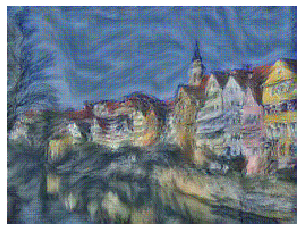

In [53]:
# Starry Night + Tubingen
params3 = {
    'content_image' : 'styles/tubingen.jpg',
    'style_image' : 'styles/starry_night.jpg',
    'image_size' : 192,
    'style_size' : 192,
    'content_layer' : 3,
    'content_weight' : 6e-2,
    'style_layers' : [1, 4, 6, 7],
    'style_weights' : [300000, 1000, 15, 3],
    'tv_weight' : 2e-2
}

style_transfer(**params3)

## Feature Inversion

The code you've written can do another cool thing. In an attempt to understand the types of features that convolutional networks learn to recognize, a recent paper [1] attempts to reconstruct an image from its feature representation. We can easily implement this idea using image gradients from the pretrained network, which is exactly what we did above (but with two different feature representations).

Now, if you set the style weights to all be 0 and initialize the starting image to random noise instead of the content source image, you'll reconstruct an image from the feature representation of the content source image. You're starting with total noise, but you should end up with something that looks quite a bit like your original image.

(Similarly, you could do "texture synthesis" from scratch if you set the content weight to 0 and initialize the starting image to random noise, but we won't ask you to do that here.) 

[1] Aravindh Mahendran, Andrea Vedaldi, "Understanding Deep Image Representations by Inverting them", CVPR 2015


[tensor([[[[1.4045e+00, 1.3991e+00, 1.4167e+00,  ..., 1.6555e+00,
           1.6585e+00, 1.6740e+00],
          [1.3914e+00, 1.4067e+00, 1.4585e+00,  ..., 1.6310e+00,
           1.6535e+00, 1.6837e+00],
          [1.4507e+00, 1.3805e+00, 1.2793e+00,  ..., 1.6648e+00,
           1.6551e+00, 1.7271e+00],
          ...,
          [8.6090e-01, 8.7313e-01, 9.2216e-01,  ..., 4.7700e-01,
           4.1022e-01, 4.2663e-01],
          [8.7173e-01, 8.8907e-01, 9.0449e-01,  ..., 5.4801e-01,
           5.0989e-01, 5.4026e-01],
          [8.6761e-01, 9.1816e-01, 9.0512e-01,  ..., 4.9316e-01,
           4.3647e-01, 5.8950e-01]],

         [[0.0000e+00, 0.0000e+00, 3.1706e-01,  ..., 8.0888e-02,
           7.1759e-02, 5.1046e-02],
          [8.3821e-02, 9.5538e-02, 2.4084e-01,  ..., 7.0147e-02,
           6.1948e-02, 7.1490e-02],
          [4.0346e-01, 6.6374e-02, 1.7668e-02,  ..., 8.7499e-02,
           4.5348e-02, 8.8522e-02],
          ...,
          [4.2776e-03, 0.0000e+00, 3.9169e-02,  ..., 5.996

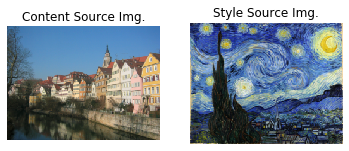

[tensor([[[[0.0000, 1.0390, 0.8151,  ..., 0.8722, 0.2952, 0.8027],
          [0.3505, 0.4915, 0.7772,  ..., 0.7049, 0.1782, 1.2166],
          [0.6196, 0.1647, 0.3324,  ..., 0.9218, 0.6047, 1.1815],
          ...,
          [0.6025, 0.2933, 0.3083,  ..., 0.8214, 1.0446, 1.1188],
          [0.3267, 0.1755, 0.8633,  ..., 0.4452, 0.5096, 1.1715],
          [0.2742, 0.2037, 0.4730,  ..., 0.9957, 1.2706, 1.1099]],

         [[0.3924, 0.0000, 0.3529,  ..., 0.0000, 0.0000, 0.1979],
          [0.2723, 0.0000, 0.5884,  ..., 0.2831, 0.0000, 0.3354],
          [0.0000, 0.2004, 0.0000,  ..., 0.0000, 0.0849, 0.5901],
          ...,
          [0.4599, 0.3715, 0.2904,  ..., 0.0860, 0.0360, 0.0360],
          [0.0000, 0.0000, 0.2209,  ..., 0.7048, 0.0000, 0.5365],
          [0.0000, 0.0000, 0.3341,  ..., 0.0789, 0.1646, 0.0000]],

         [[0.2497, 0.0000, 0.0000,  ..., 0.0000, 0.1544, 0.0000],
          [0.4179, 0.4067, 0.5552,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.4023, 0.0000,  ..., 

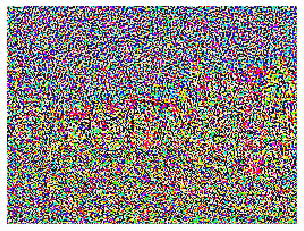

[tensor([[[[ 0.6389,  0.0000,  0.1044,  ...,  0.0218,  3.0505,  3.2722],
          [ 0.9606,  0.0000,  2.7573,  ...,  1.0124,  0.3412,  4.7100],
          [ 0.9284,  4.1556,  7.3684,  ...,  0.3513,  1.9925,  4.0283],
          ...,
          [ 0.0000,  1.7378,  4.1513,  ...,  0.0000,  0.0000,  1.1384],
          [ 0.3142,  0.1727,  1.7560,  ...,  0.0000,  0.0000,  1.1897],
          [ 2.6516,  1.7080,  0.8991,  ...,  0.0000,  0.0000,  0.0000]],

         [[ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.0000,  0.0000],
          [ 0.9722,  1.7461,  0.0000,  ...,  0.5885,  2.5709,  0.0000],
          [ 3.4842,  0.0000,  1.2728,  ...,  2.7238,  0.4565,  0.0000],
          ...,
          [ 0.0000,  0.0000,  0.0000,  ...,  0.0000,  0.7712,  0.3142],
          [ 2.6993,  6.0519,  0.0000,  ...,  0.0000,  5.2115,  0.0000],
          [ 2.0586,  0.0000,  0.0000,  ...,  1.0849,  0.0000,  0.1761]],

         [[ 0.0000,  2.2217,  0.0000,  ...,  1.7135,  0.0000,  0.0000],
          [ 0.0000,  3.2163, 

[tensor([[[[0.3513, 1.2228, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.7718, 2.4796, 0.0000,  ..., 0.7740, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 1.2713, 0.8119, 0.0000],
          ...,
          [2.8961, 0.0000, 0.0000,  ..., 0.9007, 0.0000, 0.4552],
          [1.9348, 0.9248, 0.8212,  ..., 1.5958, 0.0000, 0.2288],
          [1.9046, 0.2490, 0.8293,  ..., 1.6780, 4.3041, 4.0154]],

         [[4.0298, 0.2659, 1.9598,  ..., 0.8439, 1.5607, 0.7797],
          [0.0000, 1.1389, 1.3123,  ..., 0.8296, 0.0000, 0.0000],
          [0.0000, 1.0646, 0.0000,  ..., 0.0000, 0.0000, 5.3142],
          ...,
          [4.4325, 1.4659, 0.7195,  ..., 2.6394, 0.0000, 0.2759],
          [0.0761, 0.0000, 0.7877,  ..., 1.4203, 0.0000, 3.7494],
          [0.2063, 1.8907, 0.0000,  ..., 0.0000, 0.0000, 0.0270]],

         [[1.3825, 0.3196, 2.2668,  ..., 0.0000, 3.6978, 0.0000],
          [0.8158, 0.0000, 6.5300,  ..., 0.0000, 4.5407, 1.8114],
          [0.0000, 4.3195, 0.0000,  ..., 

[tensor([[[[0.0000, 0.0000, 0.0000,  ..., 0.9011, 0.0000, 0.0000],
          [0.0000, 0.8913, 0.0000,  ..., 0.9334, 0.7462, 0.2638],
          [0.2988, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1220],
          ...,
          [2.0064, 0.0000, 0.0000,  ..., 0.5282, 0.0000, 0.0000],
          [0.0000, 0.7223, 2.5335,  ..., 0.6036, 0.0000, 0.0000],
          [0.0000, 1.2990, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.3615, 0.6448, 0.0000,  ..., 0.0000, 0.0000, 0.4541],
          [0.0000, 0.0000, 0.6250,  ..., 1.4811, 0.4821, 0.0000],
          [0.0000, 1.1161, 0.0000,  ..., 2.9069, 0.0000, 0.0091],
          ...,
          [0.0000, 0.5099, 0.0000,  ..., 1.0471, 0.4590, 0.0000],
          [0.0000, 0.9677, 0.0000,  ..., 0.3788, 1.2705, 0.4423],
          [0.0000, 2.5829, 0.0000,  ..., 1.1647, 0.0000, 1.0040]],

         [[0.6512, 0.8259, 0.5698,  ..., 1.4391, 1.0054, 0.0000],
          [2.4922, 2.1595, 0.0000,  ..., 0.0000, 0.0572, 3.2225],
          [1.7032, 0.8413, 0.1354,  ..., 

[tensor([[[[0.0000, 0.0000, 0.9393,  ..., 1.0340, 0.0000, 0.3073],
          [0.4832, 0.0000, 0.0000,  ..., 1.7307, 1.2228, 2.0178],
          [1.4640, 0.6229, 1.2346,  ..., 0.0000, 1.1652, 1.2326],
          ...,
          [0.0000, 0.0000, 0.1898,  ..., 0.0000, 1.1993, 1.1201],
          [0.1697, 0.3568, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [1.0014, 2.8164, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0343, 0.0000,  ..., 0.1738, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.5749,  ..., 0.0000, 0.4961, 0.0000],
          [1.1238, 0.0000, 0.0000,  ..., 0.7029, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 1.1569,  ..., 0.0000, 1.5748, 0.0000],
          [0.3133, 2.2887, 0.0000,  ..., 0.0000, 1.3967, 0.0000],
          [2.2012, 0.4299, 0.0000,  ..., 0.9412, 0.0000, 0.9275]],

         [[0.0000, 0.0000, 1.5653,  ..., 2.4860, 0.0000, 0.0000],
          [0.8006, 2.4759, 0.0000,  ..., 0.4677, 0.0000, 0.6172],
          [3.4490, 0.0000, 2.1018,  ..., 

[tensor([[[[0.0000, 0.0000, 0.3039,  ..., 0.2828, 0.9905, 0.5082],
          [0.0000, 0.8056, 0.1589,  ..., 1.0388, 0.6923, 1.3342],
          [0.1181, 1.1160, 1.7223,  ..., 0.0000, 2.1834, 1.4520],
          ...,
          [0.0000, 0.3721, 1.7549,  ..., 0.0000, 0.6835, 0.1482],
          [3.5387, 0.3595, 0.0000,  ..., 0.0000, 0.4194, 0.0000],
          [2.2862, 0.9468, 0.0000,  ..., 0.0000, 0.0000, 0.0212]],

         [[0.5656, 0.0000, 0.0000,  ..., 0.9256, 1.6363, 0.0000],
          [0.0000, 0.2213, 0.9054,  ..., 0.0000, 0.0000, 0.0000],
          [0.5760, 0.0145, 0.0000,  ..., 0.0000, 0.0000, 0.6972],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0463, 1.0737],
          [0.3163, 1.5084, 0.0000,  ..., 0.0000, 1.0660, 0.0000],
          [2.8010, 0.0000, 1.4448,  ..., 0.0000, 0.2225, 0.0000]],

         [[0.0000, 0.0000, 0.7099,  ..., 2.2239, 0.2451, 0.4837],
          [0.0000, 0.0000, 0.7898,  ..., 1.2595, 0.0128, 0.0000],
          [0.7447, 0.0000, 1.8678,  ..., 

[tensor([[[[1.2041, 0.0698, 0.0000,  ..., 2.3272, 1.9935, 1.0080],
          [1.1389, 0.9118, 0.8316,  ..., 0.4905, 0.0255, 0.0000],
          [0.4311, 0.6828, 1.0270,  ..., 0.9151, 1.4861, 0.2458],
          ...,
          [1.2815, 1.4501, 1.3734,  ..., 0.0000, 0.3016, 0.0000],
          [0.1600, 0.0000, 1.6312,  ..., 0.0000, 1.7285, 0.0000],
          [0.2687, 0.0000, 1.1862,  ..., 1.6264, 0.0000, 0.4031]],

         [[2.2702, 0.0000, 1.3244,  ..., 1.1352, 2.4475, 0.0000],
          [0.0000, 0.1386, 0.0428,  ..., 0.9572, 0.0000, 0.0000],
          [0.0000, 0.6928, 0.1563,  ..., 0.4923, 0.0000, 0.4648],
          ...,
          [0.0000, 1.4095, 0.0000,  ..., 1.0488, 0.0000, 1.5905],
          [0.1117, 0.0000, 0.0000,  ..., 1.4860, 1.0992, 0.0000],
          [0.1580, 0.0000, 1.1799,  ..., 0.1687, 0.4015, 0.0000]],

         [[1.6104, 1.4906, 0.0000,  ..., 1.2563, 2.7743, 1.7792],
          [0.0000, 0.0000, 1.4090,  ..., 1.2057, 3.5735, 0.9437],
          [0.0000, 1.3558, 1.1520,  ..., 

[tensor([[[[0.3331, 2.0066, 1.2472,  ..., 1.5967, 1.7972, 1.3809],
          [1.6784, 1.3759, 1.5892,  ..., 0.0000, 0.6395, 0.6620],
          [1.4799, 0.0000, 0.4773,  ..., 1.7610, 1.7423, 2.0594],
          ...,
          [0.8417, 0.4971, 0.0000,  ..., 0.3164, 0.7604, 0.1182],
          [0.0000, 0.0000, 1.4998,  ..., 0.0000, 0.1923, 0.0000],
          [0.0000, 0.0000, 2.0764,  ..., 1.1005, 0.0000, 1.0771]],

         [[0.0000, 1.1072, 1.5785,  ..., 0.4253, 0.3629, 1.2923],
          [0.2043, 0.0000, 0.0000,  ..., 0.5263, 0.0000, 0.0000],
          [0.2460, 0.2333, 0.6045,  ..., 0.5299, 0.2785, 0.3851],
          ...,
          [0.9981, 0.0000, 0.6903,  ..., 1.5688, 0.0000, 0.8072],
          [0.2486, 0.0000, 0.5574,  ..., 1.3716, 0.0000, 0.0000],
          [0.0000, 1.2795, 0.4076,  ..., 1.1069, 0.9105, 0.0000]],

         [[0.0000, 1.4391, 1.9326,  ..., 1.2903, 2.6027, 3.5282],
          [1.7231, 0.0964, 0.2237,  ..., 1.6195, 3.7377, 3.2800],
          [0.0000, 1.0895, 0.4797,  ..., 

[tensor([[[[0.0000, 1.2500, 1.7552,  ..., 0.4054, 1.7823, 1.6909],
          [1.3324, 1.4983, 1.7207,  ..., 0.2529, 1.4184, 2.2411],
          [2.0635, 1.2541, 0.6760,  ..., 2.1296, 1.7824, 2.7315],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.5568, 0.7156, 0.7769],
          [0.0000, 1.2622, 0.6208,  ..., 0.2862, 0.0000, 0.1947],
          [0.3209, 0.0000, 0.0000,  ..., 0.1368, 0.0369, 0.4404]],

         [[0.0000, 0.6386, 0.7565,  ..., 0.0000, 0.0000, 0.7629],
          [1.0343, 0.0000, 0.0000,  ..., 0.0422, 1.0885, 0.0000],
          [1.4537, 0.0000, 0.5449,  ..., 0.0000, 0.3168, 0.8784],
          ...,
          [1.5061, 0.0000, 1.3009,  ..., 0.0268, 1.5438, 0.0390],
          [0.2371, 0.0000, 0.8676,  ..., 0.2789, 0.0000, 0.1640],
          [0.0000, 1.5734, 0.2346,  ..., 0.6164, 0.6572, 0.3305]],

         [[0.0000, 0.1408, 3.2941,  ..., 1.7717, 2.6845, 1.3361],
          [2.8268, 1.4085, 0.0000,  ..., 2.0023, 2.3533, 3.4137],
          [0.2246, 0.6941, 0.2170,  ..., 

[tensor([[[[0.0000e+00, 2.6658e-01, 9.9119e-01,  ..., 4.2410e-01,
           1.9927e+00, 1.5122e+00],
          [7.7946e-01, 9.4903e-01, 1.3204e+00,  ..., 1.6526e+00,
           2.1787e+00, 2.2185e+00],
          [9.5468e-01, 9.2463e-01, 8.7612e-01,  ..., 2.0087e+00,
           1.2964e+00, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.0490e+00,
           2.1611e-01, 7.4977e-01],
          [1.1517e+00, 1.2016e+00, 0.0000e+00,  ..., 9.7341e-01,
           0.0000e+00, 4.2279e-01],
          [1.2552e+00, 3.5914e-01, 0.0000e+00,  ..., 6.3577e-01,
           1.0957e+00, 0.0000e+00]],

         [[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 4.3537e-01],
          [1.3377e+00, 2.3463e-01, 3.7695e-01,  ..., 0.0000e+00,
           1.1072e+00, 0.0000e+00],
          [6.3010e-01, 0.0000e+00, 3.9395e-01,  ..., 0.0000e+00,
           2.7065e-01, 8.1210e-01],
          ...,
          [1.1068e+00, 0.0000e+00, 0.0000e+00,  ..., 0.000

[tensor([[[[0.7343, 0.3304, 0.6919,  ..., 0.8599, 2.1583, 1.2551],
          [0.7296, 0.6779, 0.9968,  ..., 2.6164, 2.6878, 2.3628],
          [0.4460, 0.0777, 0.3554,  ..., 2.1425, 1.7395, 0.0000],
          ...,
          [0.0000, 0.0000, 0.1567,  ..., 0.9901, 0.0000, 0.3734],
          [0.4586, 0.3472, 0.0000,  ..., 0.0000, 0.0000, 0.4122],
          [0.0243, 0.7667, 0.8766,  ..., 0.7253, 1.4466, 0.0000]],

         [[1.1368, 0.0000, 0.0000,  ..., 0.0000, 0.9104, 0.6137],
          [0.4554, 0.0000, 1.2331,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.6180, 0.1205,  ..., 0.7678, 0.2770, 0.4173],
          ...,
          [0.2321, 0.2325, 0.0000,  ..., 0.0835, 0.0000, 0.0000],
          [0.1033, 0.7850, 0.2438,  ..., 0.3165, 0.9785, 1.2108],
          [0.2905, 0.0000, 0.5701,  ..., 0.0000, 0.0000, 0.4691]],

         [[2.2818, 0.7540, 0.1001,  ..., 1.0747, 1.9317, 2.4303],
          [0.0000, 0.5559, 1.8950,  ..., 0.0520, 0.0000, 0.0000],
          [1.1753, 0.5933, 1.4537,  ..., 

[tensor([[[[1.8526, 0.7323, 1.0608,  ..., 1.2283, 2.1818, 1.2920],
          [1.1680, 0.6661, 1.0741,  ..., 1.9200, 2.2326, 2.5715],
          [0.8695, 0.2718, 0.7651,  ..., 1.9670, 1.7247, 0.1756],
          ...,
          [0.9688, 0.0000, 0.2772,  ..., 0.4765, 0.0000, 0.0000],
          [0.0675, 0.0000, 0.7179,  ..., 0.0000, 0.0000, 0.3323],
          [0.0000, 0.4332, 1.1569,  ..., 0.0000, 0.0914, 0.0000]],

         [[1.1228, 0.3362, 0.0000,  ..., 0.0000, 0.7315, 0.0000],
          [0.0000, 0.0000, 0.6302,  ..., 0.2175, 0.0000, 0.5019],
          [0.0000, 1.8509, 0.0000,  ..., 0.3726, 0.2058, 0.0972],
          ...,
          [0.0000, 0.6216, 0.0000,  ..., 0.4327, 0.0000, 0.0000],
          [0.0000, 0.2394, 0.2702,  ..., 0.2100, 1.0112, 0.0000],
          [0.3750, 0.0000, 0.6311,  ..., 0.0000, 0.0000, 0.2810]],

         [[0.9267, 1.2301, 2.0415,  ..., 1.1846, 0.1558, 0.9582],
          [0.0000, 0.5823, 0.7427,  ..., 0.0589, 0.0000, 0.0000],
          [1.1970, 1.5565, 1.2504,  ..., 

[tensor([[[[1.9152, 1.3941, 1.2885,  ..., 1.5534, 2.2008, 1.8182],
          [1.4870, 1.4436, 1.3960,  ..., 1.1588, 1.4335, 2.2626],
          [1.2041, 1.0240, 1.4649,  ..., 1.1890, 1.5436, 0.7853],
          ...,
          [0.7774, 0.7657, 0.2642,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0850, 0.6800,  ..., 0.6729, 1.0899, 0.0215],
          [1.0803, 0.8500, 0.2471,  ..., 0.0000, 0.0000, 0.5827]],

         [[0.2667, 0.5504, 0.1798,  ..., 0.3611, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1633, 0.2217],
          [0.2671, 0.8528, 0.0000,  ..., 0.0975, 0.0000, 0.0000],
          ...,
          [0.0000, 0.5738, 0.5740,  ..., 0.4161, 0.4808, 0.0000],
          [0.0000, 0.0000, 0.2353,  ..., 0.1277, 0.0939, 0.0000],
          [0.4992, 0.8290, 0.0000,  ..., 0.1763, 0.4206, 0.1374]],

         [[1.1328, 1.0641, 1.4877,  ..., 0.5632, 0.0000, 0.0000],
          [1.1900, 0.2240, 0.0000,  ..., 1.4414, 0.0000, 0.5976],
          [0.5141, 1.1926, 0.4690,  ..., 

[tensor([[[[1.4448, 1.9695, 1.0695,  ..., 1.8783, 1.7846, 1.8763],
          [1.3337, 1.8663, 1.3768,  ..., 1.3098, 0.7242, 1.7016],
          [1.1518, 1.5539, 1.9550,  ..., 0.4896, 1.3323, 1.2342],
          ...,
          [0.6431, 1.2809, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.1713, 0.3341,  ..., 1.6796, 1.6219, 0.1292],
          [1.1470, 0.5181, 0.0000,  ..., 0.0000, 0.0000, 0.7991]],

         [[0.0000, 0.5191, 0.2282,  ..., 0.1801, 0.0000, 0.5641],
          [0.4882, 0.0000, 0.0000,  ..., 0.0248, 0.4647, 0.0000],
          [0.3863, 0.0000, 0.4159,  ..., 0.0000, 0.2287, 0.0000],
          ...,
          [0.0000, 0.3117, 0.4770,  ..., 0.3169, 0.5776, 0.0000],
          [0.0000, 0.3209, 0.0000,  ..., 0.0871, 0.0000, 0.0065],
          [0.9665, 0.8815, 0.0000,  ..., 0.3313, 0.6982, 0.0529]],

         [[1.5253, 0.7338, 0.4164,  ..., 0.0000, 0.0000, 0.0000],
          [1.9753, 0.0000, 0.0000,  ..., 0.0367, 0.4915, 1.6577],
          [0.0000, 0.0202, 0.4026,  ..., 

[tensor([[[[0.7367, 1.8155, 1.0038,  ..., 2.2006, 1.6297, 1.5354],
          [1.1880, 1.7715, 1.2356,  ..., 1.4553, 1.0305, 1.3788],
          [1.0971, 1.6574, 2.2116,  ..., 1.2948, 1.8229, 2.2136],
          ...,
          [0.0000, 0.5949, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.3620, 0.4579, 0.0737,  ..., 1.0861, 1.1388, 0.7160],
          [0.8100, 0.0122, 0.0000,  ..., 0.0000, 0.0000, 0.9545]],

         [[0.0000, 0.1088, 0.0901,  ..., 0.7704, 0.0000, 0.5769],
          [0.6284, 0.0318, 0.0000,  ..., 0.3928, 0.0000, 0.0000],
          [0.7290, 0.0000, 0.5289,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.2427, 0.1467, 0.3029,  ..., 0.0000, 0.0822, 0.2308],
          [0.2643, 0.6913, 0.1202,  ..., 0.0000, 0.0000, 0.6743],
          [0.1373, 0.0000, 0.0000,  ..., 0.2926, 0.1943, 0.0000]],

         [[0.0000, 0.1722, 0.0000,  ..., 0.0000, 0.4962, 0.1972],
          [0.3550, 0.0000, 0.6176,  ..., 0.0000, 0.7540, 0.0000],
          [0.0000, 0.0000, 0.8488,  ..., 

[tensor([[[[5.1413e-01, 1.3896e+00, 9.7552e-01,  ..., 2.5441e+00,
           1.7586e+00, 9.8728e-01],
          [1.4631e+00, 1.5911e+00, 1.1299e+00,  ..., 2.0793e+00,
           1.5540e+00, 1.0308e+00],
          [1.1020e+00, 1.5572e+00, 1.9640e+00,  ..., 2.8247e+00,
           2.1077e+00, 2.0987e+00],
          ...,
          [1.1374e-01, 4.2388e-01, 4.8154e-01,  ..., 3.6657e-01,
           0.0000e+00, 3.9292e-01],
          [8.0085e-01, 1.1841e+00, 3.7969e-01,  ..., 4.5239e-01,
           0.0000e+00, 8.2119e-01],
          [0.0000e+00, 1.2250e-01, 6.1212e-01,  ..., 1.8638e-01,
           1.2972e-01, 8.1497e-01]],

         [[6.3229e-02, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           3.0049e-02, 2.1802e-01],
          [1.7908e-02, 1.0417e-01, 3.4308e-01,  ..., 2.8101e-02,
           5.3039e-02, 5.4467e-04],
          [4.7280e-01, 0.0000e+00, 7.4319e-02,  ..., 2.8392e-01,
           0.0000e+00, 0.0000e+00],
          ...,
          [4.4693e-01, 8.5166e-02, 2.0792e-01,  ..., 0.000

[tensor([[[[1.0316e+00, 1.2080e+00, 9.7140e-01,  ..., 2.6699e+00,
           1.7379e+00, 9.9285e-01],
          [2.1090e+00, 1.4923e+00, 1.2184e+00,  ..., 2.2768e+00,
           1.7622e+00, 6.2397e-01],
          [1.4499e+00, 1.4022e+00, 1.6168e+00,  ..., 2.2046e+00,
           1.6243e+00, 1.2051e+00],
          ...,
          [8.7935e-01, 6.8454e-01, 1.0127e+00,  ..., 6.1320e-01,
           0.0000e+00, 5.6494e-01],
          [1.1522e+00, 1.4150e+00, 9.3943e-01,  ..., 0.0000e+00,
           0.0000e+00, 4.3962e-01],
          [0.0000e+00, 5.5423e-01, 8.0739e-01,  ..., 7.1753e-01,
           2.8396e-01, 4.4455e-01]],

         [[3.5960e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 3.2027e-02],
          [0.0000e+00, 0.0000e+00, 5.5904e-01,  ..., 0.0000e+00,
           1.4185e-01, 5.6247e-01],
          [0.0000e+00, 3.8166e-01, 0.0000e+00,  ..., 2.6690e-01,
           4.9426e-01, 0.0000e+00],
          ...,
          [5.2514e-01, 0.0000e+00, 1.2330e-01,  ..., 7.623

[tensor([[[[1.8488, 1.2555, 1.0806,  ..., 1.7919, 1.6146, 1.2978],
          [2.3339, 1.3082, 1.0113,  ..., 1.9080, 2.0125, 0.8573],
          [1.4566, 1.0682, 1.1635,  ..., 2.3487, 1.7016, 1.2446],
          ...,
          [0.8623, 0.4200, 0.6767,  ..., 0.8634, 0.6865, 0.4811],
          [1.2657, 0.8030, 0.9945,  ..., 0.1120, 0.0000, 0.2773],
          [0.6050, 0.8986, 0.7937,  ..., 0.8287, 0.2486, 0.0000]],

         [[0.5496, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.1008,  ..., 0.0000, 0.0000, 0.4310],
          [0.0000, 0.8317, 0.0000,  ..., 0.0937, 1.0162, 0.0000],
          ...,
          [0.0043, 0.0916, 0.0000,  ..., 0.4295, 0.3938, 0.0000],
          [0.0000, 0.0647, 0.0854,  ..., 0.5625, 0.4784, 0.0000],
          [0.0000, 0.4406, 0.4514,  ..., 0.0662, 0.0000, 0.5718]],

         [[1.2709, 0.0000, 0.0698,  ..., 0.4088, 0.3835, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.6361, 0.0101, 0.2352],
          [0.0000, 0.4380, 0.0000,  ..., 

[tensor([[[[2.2700, 1.3271, 1.5281,  ..., 0.8263, 1.3906, 1.5244],
          [1.4098, 0.9416, 0.7544,  ..., 1.4225, 2.0889, 1.3100],
          [0.8747, 0.7296, 0.6971,  ..., 2.0729, 1.6604, 1.3773],
          ...,
          [0.6904, 0.4226, 0.6673,  ..., 0.4980, 0.9159, 0.3953],
          [0.3932, 0.1364, 0.9141,  ..., 0.5373, 0.4841, 0.3948],
          [0.7567, 0.8087, 0.7866,  ..., 1.0049, 0.2837, 0.0000]],

         [[0.5705, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.4388, 0.0000, 0.1599,  ..., 0.0000, 0.0000, 0.5735],
          [0.0000, 0.4115, 0.0000,  ..., 0.0000, 0.3152, 0.2947],
          ...,
          [0.0000, 0.5000, 0.0000,  ..., 0.0000, 0.9103, 0.0438],
          [0.0000, 0.1679, 0.0433,  ..., 0.3842, 0.2715, 0.0000],
          [0.1886, 0.0000, 0.3273,  ..., 0.1251, 0.2213, 0.3864]],

         [[0.0000, 0.3850, 0.0000,  ..., 0.0000, 0.3073, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0159],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.4978e+00, 1.5161e+00, 1.7873e+00,  ..., 5.6323e-01,
           1.3065e+00, 1.4801e+00],
          [4.2818e-01, 8.0986e-01, 7.9540e-01,  ..., 1.5325e+00,
           2.0883e+00, 1.7792e+00],
          [6.3216e-01, 9.2549e-01, 8.1830e-01,  ..., 2.1254e+00,
           1.5180e+00, 1.4197e+00],
          ...,
          [8.7188e-01, 7.8009e-01, 9.1948e-01,  ..., 0.0000e+00,
           8.2124e-01, 4.8239e-01],
          [3.4937e-01, 4.2352e-01, 9.2661e-01,  ..., 1.4883e-01,
           1.0371e+00, 7.6867e-01],
          [1.1804e+00, 1.1415e+00, 7.0788e-01,  ..., 1.5397e-01,
           3.0665e-01, 1.1316e-02]],

         [[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           2.8072e-01, 0.0000e+00],
          [3.5451e-01, 0.0000e+00, 1.2649e-01,  ..., 0.0000e+00,
           2.0313e-01, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 4.2173e-01,  ..., 0.0000e+00,
           0.0000e+00, 7.3557e-01],
          ...,
          [0.0000e+00, 0.0000e+00, 2.5503e-01,  ..., 0.000

[tensor([[[[0.8876, 1.5008, 2.0962,  ..., 0.8150, 1.2997, 1.6024],
          [0.3223, 1.0426, 0.8470,  ..., 1.7766, 1.9863, 2.2165],
          [0.8288, 1.3885, 1.0981,  ..., 1.9261, 1.2925, 1.1268],
          ...,
          [1.3114, 0.9973, 1.0580,  ..., 0.0000, 0.7684, 0.3805],
          [1.1205, 0.9059, 0.5007,  ..., 0.0000, 1.1822, 0.6594],
          [1.1528, 1.2134, 0.3320,  ..., 0.3429, 0.5963, 0.5191]],

         [[0.0000, 0.0992, 0.1423,  ..., 0.0464, 0.1058, 0.4167],
          [0.0000, 0.2447, 0.0000,  ..., 0.0000, 0.4286, 0.0000],
          [0.0150, 0.0000, 0.1519,  ..., 0.0774, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.3173,  ..., 0.6842, 0.0000, 1.0449],
          [0.3862, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.1959, 0.0000,  ..., 0.0688, 0.3097, 0.0000]],

         [[0.3623, 0.0000, 0.0000,  ..., 0.7693, 0.0000, 0.1339],
          [0.0000, 0.0000, 0.0000,  ..., 0.2363, 0.0000, 0.6805],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.9472, 1.1802, 1.9451,  ..., 1.5924, 1.6891, 1.8529],
          [1.2601, 1.5224, 0.8309,  ..., 2.2674, 2.2550, 2.2826],
          [1.5469, 1.9431, 1.0186,  ..., 1.8827, 1.3416, 0.7480],
          ...,
          [1.0079, 0.8655, 1.1678,  ..., 0.0052, 0.6008, 0.4033],
          [1.0399, 0.9909, 0.7192,  ..., 0.3230, 0.4493, 0.1593],
          [0.9510, 1.0165, 0.3861,  ..., 0.6079, 0.6030, 0.8936]],

         [[0.2298, 0.0000, 0.0000,  ..., 0.2879, 0.1965, 0.0000],
          [0.0000, 0.2168, 0.0000,  ..., 0.3471, 0.0000, 0.5259],
          [0.0000, 0.0946, 0.0000,  ..., 0.1049, 0.0000, 0.0994],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.6496, 0.0000, 0.5511],
          [0.0000, 0.0137, 0.1181,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.2827, 0.0000,  ..., 0.3649, 0.3775, 0.0000]],

         [[0.8533, 0.0000, 0.0000,  ..., 0.5696, 1.2469, 0.2982],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.1066, 0.1073],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.1433, 0.9071, 1.5096,  ..., 2.2691, 2.0512, 1.8303],
          [1.8179, 1.8006, 1.1306,  ..., 2.4968, 2.6771, 2.1752],
          [1.9130, 2.1291, 1.2786,  ..., 1.7906, 1.2875, 0.3684],
          ...,
          [0.5902, 0.8036, 1.1004,  ..., 0.7180, 0.5391, 0.7973],
          [0.7959, 1.0181, 1.1924,  ..., 1.0788, 0.0000, 0.0000],
          [0.9412, 1.0347, 1.0647,  ..., 0.7762, 0.5776, 0.8812]],

         [[0.1509, 0.0000, 0.0000,  ..., 0.1036, 0.0000, 0.0985],
          [0.0000, 0.4092, 0.5194,  ..., 0.0000, 0.1055, 0.4412],
          [0.0000, 0.5255, 0.0000,  ..., 0.2460, 0.0000, 0.5021],
          ...,
          [0.0000, 0.4542, 0.0000,  ..., 0.0000, 0.1070, 0.0000],
          [0.0746, 0.0000, 0.3572,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.2859, 0.3338, 0.1850]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0986, 0.5732, 0.6678],
          [0.0000, 0.0000, 0.5647,  ..., 1.4967, 0.6674, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.1840, 0.8058, 0.9779,  ..., 2.1324, 1.6680, 1.8477],
          [2.3112, 1.7734, 1.0723,  ..., 0.9361, 1.7995, 2.4619],
          [1.6607, 1.3145, 1.3447,  ..., 1.6315, 1.0445, 0.6216],
          ...,
          [0.5995, 0.8202, 0.9067,  ..., 0.9452, 0.3000, 1.1500],
          [0.8854, 1.0108, 0.8489,  ..., 0.6399, 0.0000, 0.0000],
          [0.6563, 1.0836, 1.2533,  ..., 0.7245, 0.4653, 0.3908]],

         [[0.3404, 0.0000, 0.0000,  ..., 0.2049, 0.0000, 0.4725],
          [0.0000, 0.0998, 0.5150,  ..., 0.0000, 0.8497, 0.0000],
          [0.0459, 0.3905, 0.0000,  ..., 0.0000, 0.0000, 0.2352],
          ...,
          [0.0000, 0.0000, 0.0823,  ..., 0.0000, 0.5245, 0.0000],
          [0.0000, 0.0000, 0.0897,  ..., 0.1145, 0.0456, 0.0000],
          [0.0000, 0.0000, 0.5606,  ..., 0.0000, 0.0550, 0.5240]],

         [[0.0000, 0.3221, 0.0000,  ..., 0.1826, 0.0565, 1.2660],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0433, 1.5589],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0165, 0.5652, 0.7227,  ..., 2.4289, 1.5013, 1.5149],
          [2.1567, 1.6361, 0.9128,  ..., 0.3531, 1.2067, 2.4125],
          [1.3026, 0.6982, 1.1395,  ..., 1.6443, 1.0061, 1.0032],
          ...,
          [0.9474, 0.7267, 0.6916,  ..., 0.5619, 0.2524, 0.9707],
          [1.1228, 1.0233, 0.4019,  ..., 0.0000, 0.0000, 0.2959],
          [0.7068, 1.0767, 0.9870,  ..., 0.5538, 0.5272, 0.1501]],

         [[0.4099, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0040],
          [0.3240, 0.0750, 0.0000,  ..., 0.3117, 0.0000, 0.0000],
          [0.0000, 0.1763, 0.3282,  ..., 0.1369, 0.0649, 0.0000],
          ...,
          [0.0000, 0.0433, 0.1434,  ..., 0.6768, 0.0138, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0611, 0.0000, 0.0000],
          [0.0000, 0.0883, 0.1853,  ..., 0.0000, 0.0000, 0.6973]],

         [[0.5246, 0.0000, 0.0000,  ..., 1.0386, 0.0000, 0.7408],
          [0.0000, 0.3735, 0.0000,  ..., 1.2507, 0.2877, 0.5032],
          [0.0000, 0.0000, 0.2626,  ..., 

[tensor([[[[9.5787e-01, 4.3566e-01, 9.2953e-01,  ..., 2.5590e+00,
           1.4503e+00, 1.2270e+00],
          [2.2070e+00, 1.5530e+00, 1.0016e+00,  ..., 2.3672e-01,
           1.1118e+00, 2.2283e+00],
          [1.2601e+00, 8.8424e-01, 1.1908e+00,  ..., 1.5934e+00,
           1.1624e+00, 1.5308e+00],
          ...,
          [8.7710e-01, 7.9008e-01, 7.0834e-01,  ..., 8.5206e-01,
           4.8176e-01, 2.8695e-01],
          [1.0207e+00, 1.1264e+00, 9.0338e-01,  ..., 8.2615e-02,
           2.6596e-01, 5.2173e-01],
          [8.6199e-01, 1.0810e+00, 1.3829e+00,  ..., 4.1040e-01,
           6.1199e-01, 3.0596e-01]],

         [[1.3266e-01, 1.8137e-01, 7.2058e-01,  ..., 0.0000e+00,
           8.4791e-02, 0.0000e+00],
          [2.8331e-01, 0.0000e+00, 0.0000e+00,  ..., 5.7345e-05,
           0.0000e+00, 1.8756e-01],
          [0.0000e+00, 1.7145e-02, 8.0588e-01,  ..., 3.3119e-01,
           1.0524e-01, 5.9439e-02],
          ...,
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 3.599

[tensor([[[[0.9263, 0.6220, 1.3339,  ..., 2.7659, 1.2073, 1.2378],
          [1.7775, 1.4788, 1.1556,  ..., 1.1258, 1.0739, 2.1326],
          [1.0039, 1.0493, 1.2417,  ..., 1.8612, 1.3918, 1.9821],
          ...,
          [0.5073, 0.9320, 0.7840,  ..., 0.9141, 0.5787, 0.1190],
          [0.4901, 0.9512, 1.0596,  ..., 0.6260, 0.6155, 0.8511],
          [0.8710, 0.7586, 0.6356,  ..., 0.2489, 0.6369, 0.4719]],

         [[0.3469, 0.0000, 0.3231,  ..., 0.0041, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.2509],
          [0.0121, 0.0000, 0.2713,  ..., 0.0096, 0.0000, 0.2694],
          ...,
          [0.0913, 0.0345, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0221, 0.0453,  ..., 0.0968, 0.0753, 0.6740],
          [0.1945, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.3267]],

         [[0.0000, 0.7480, 0.0000,  ..., 0.0000, 0.0302, 0.0000],
          [0.2525, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1579],
          [0.4404, 0.6656, 0.0000,  ..., 

[tensor([[[[0.8112, 1.1960, 1.7794,  ..., 2.1300, 0.8848, 1.1280],
          [1.0017, 1.2426, 1.3481,  ..., 1.6271, 0.8495, 1.8594],
          [1.0995, 0.7968, 0.9738,  ..., 2.2142, 1.5425, 2.3995],
          ...,
          [0.5873, 1.0570, 0.7799,  ..., 0.0000, 0.3804, 0.4649],
          [0.7350, 1.0335, 1.1646,  ..., 0.7519, 0.5506, 0.9674],
          [0.9122, 0.7641, 0.8196,  ..., 0.2206, 0.5430, 0.5386]],

         [[0.3493, 0.0000, 0.0894,  ..., 0.0000, 0.0000, 0.1622],
          [0.0000, 0.7017, 0.1180,  ..., 0.0574, 0.2167, 0.2513],
          [0.2197, 0.0000, 0.0964,  ..., 0.0000, 0.0188, 0.0000],
          ...,
          [0.0253, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0091, 0.0742,  ..., 0.0000, 0.0000, 0.6161],
          [0.1280, 0.0000, 0.0443,  ..., 0.0000, 0.0000, 0.3253]],

         [[0.2949, 0.1530, 0.1320,  ..., 0.2300, 0.0000, 0.0525],
          [0.3581, 0.1380, 0.2008,  ..., 0.7791, 0.0126, 0.1691],
          [0.6791, 0.5869, 0.0000,  ..., 

[tensor([[[[0.6882, 1.6119, 2.1946,  ..., 1.0162, 0.5220, 1.1929],
          [0.6870, 0.9360, 1.4494,  ..., 1.8135, 0.5008, 1.8560],
          [1.7977, 0.8386, 0.6801,  ..., 2.3388, 1.5259, 2.3804],
          ...,
          [0.8685, 0.9298, 0.7432,  ..., 0.0000, 0.2530, 0.6290],
          [1.2050, 0.9417, 0.7005,  ..., 0.5843, 0.3047, 0.5917],
          [1.0331, 0.9647, 1.0748,  ..., 0.3276, 0.4865, 0.4884]],

         [[0.2360, 0.0000, 0.1463,  ..., 0.0000, 0.1128, 0.5757],
          [0.0000, 0.7328, 0.2216,  ..., 0.4861, 0.2237, 0.0000],
          [0.3139, 0.1736, 0.0000,  ..., 0.3374, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.2180,  ..., 0.4859, 0.0412, 0.1387],
          [0.0000, 0.0037, 0.1910,  ..., 0.0000, 0.0000, 0.1531],
          [0.0000, 0.0000, 0.0000,  ..., 0.4254, 0.0000, 0.3501]],

         [[0.4604, 0.0000, 0.1346,  ..., 0.9554, 0.6024, 1.7890],
          [0.0000, 0.4829, 0.5332,  ..., 0.0000, 1.0604, 0.6846],
          [0.0000, 0.3233, 0.0000,  ..., 

[tensor([[[[0.6375, 1.6404, 2.0747,  ..., 0.7809, 0.3270, 1.4320],
          [0.6782, 0.8583, 1.5130,  ..., 1.9938, 0.4868, 1.9644],
          [2.6101, 1.0922, 0.6329,  ..., 2.0249, 1.2675, 2.5158],
          ...,
          [0.6798, 0.8222, 0.7459,  ..., 0.0112, 0.3900, 0.4616],
          [0.8334, 0.7025, 0.5770,  ..., 0.7117, 0.2254, 0.1793],
          [1.0077, 1.0579, 0.9442,  ..., 0.4670, 0.4331, 0.5798]],

         [[0.0000, 0.2942, 0.3136,  ..., 0.0870, 0.2672, 0.0000],
          [0.2904, 0.0000, 0.4951,  ..., 0.2206, 0.0598, 0.1834],
          [0.2022, 0.5970, 0.0000,  ..., 0.0000, 0.0723, 0.5394],
          ...,
          [0.0000, 0.3131, 0.0000,  ..., 0.3131, 0.1697, 0.3269],
          [0.0000, 0.0000, 0.0124,  ..., 0.1880, 0.2691, 0.0000],
          [0.0000, 0.0135, 0.0000,  ..., 0.3590, 0.0000, 0.0150]],

         [[0.0000, 0.0000, 0.3442,  ..., 0.7703, 0.8758, 0.4725],
          [0.0000, 0.0000, 0.0000,  ..., 0.5998, 1.1230, 0.6510],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.5677, 1.5740, 1.6290,  ..., 0.8760, 0.6396, 1.4673],
          [0.0572, 0.7774, 1.2360,  ..., 2.3455, 0.5655, 1.5698],
          [1.8435, 1.0494, 0.6885,  ..., 2.0166, 1.0109, 2.1183],
          ...,
          [0.4458, 1.0706, 0.8574,  ..., 0.5253, 0.5480, 0.4194],
          [0.4942, 0.8618, 1.0378,  ..., 0.4990, 0.2024, 0.0000],
          [0.9975, 1.1986, 1.0082,  ..., 0.4305, 0.4588, 0.5748]],

         [[0.0000, 0.7777, 0.0000,  ..., 0.0535, 0.1744, 0.0000],
          [0.4694, 0.0000, 0.2540,  ..., 0.0000, 0.0000, 0.3657],
          [0.0000, 0.2767, 0.0000,  ..., 0.2936, 0.0000, 0.1697],
          ...,
          [0.0511, 0.1053, 0.0000,  ..., 0.3235, 0.2153, 0.3937],
          [0.1014, 0.0000, 0.0000,  ..., 0.5095, 0.5566, 0.0000],
          [0.0131, 0.4934, 0.1068,  ..., 0.0000, 0.1250, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0350, 0.5597, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.7758, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0811,  ..., 

[tensor([[[[0.5768, 1.6678, 1.2723,  ..., 0.8441, 1.0581, 1.1444],
          [0.5770, 0.9289, 0.9850,  ..., 2.1517, 0.9786, 1.2251],
          [1.9490, 1.2307, 0.9135,  ..., 1.7782, 1.2344, 1.2817],
          ...,
          [0.7042, 1.0107, 0.8750,  ..., 0.8080, 0.5874, 0.4046],
          [0.3004, 0.8612, 1.0507,  ..., 0.3203, 0.2847, 0.1014],
          [0.7729, 0.9409, 0.9334,  ..., 0.3718, 0.5694, 0.6074]],

         [[0.0000, 0.5569, 0.0000,  ..., 0.0540, 0.0000, 0.2116],
          [0.1175, 0.2055, 0.0000,  ..., 0.0253, 0.0309, 0.0000],
          [0.0000, 0.2353, 0.0804,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.3040, 0.0000, 0.0000,  ..., 0.2112, 0.0573, 0.5894],
          [0.0000, 0.2049, 0.0310,  ..., 0.5790, 0.4817, 0.0000],
          [0.0000, 0.2332, 0.1109,  ..., 0.0000, 0.4332, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.2997, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.1712, 0.0000, 0.3392,  ..., 

[tensor([[[[0.5825, 1.8877, 1.1282,  ..., 1.2771, 1.0722, 0.8415],
          [1.1002, 0.8247, 0.8219,  ..., 2.3940, 1.2959, 1.1378],
          [1.9921, 1.2376, 0.9988,  ..., 2.0927, 1.7198, 1.4224],
          ...,
          [0.9003, 0.8029, 1.0568,  ..., 0.5621, 0.5652, 0.5977],
          [0.5156, 0.8054, 0.9556,  ..., 0.1822, 0.3813, 0.3927],
          [0.6151, 0.6633, 0.9233,  ..., 0.2995, 0.6385, 0.6111]],

         [[0.0000, 0.1977, 0.8148,  ..., 0.0954, 0.0000, 0.0919],
          [0.0000, 0.3191, 0.0000,  ..., 0.4858, 0.0000, 0.0000],
          [0.2524, 0.0000, 0.0457,  ..., 0.0000, 0.0054, 0.0000],
          ...,
          [0.6008, 0.0000, 0.0889,  ..., 0.0334, 0.0000, 0.5573],
          [0.0000, 0.2523, 0.0727,  ..., 0.4663, 0.2480, 0.0435],
          [0.0000, 0.0000, 0.0783,  ..., 0.0000, 0.4590, 0.0000]],

         [[0.0000, 1.1536, 0.5350,  ..., 0.1141, 0.0000, 0.7756],
          [0.0000, 0.0000, 0.2377,  ..., 0.1783, 0.2142, 0.0000],
          [0.3207, 0.0000, 0.0000,  ..., 

[tensor([[[[0.6619, 1.9519, 1.6013,  ..., 1.2077, 0.9156, 0.6975],
          [1.1060, 0.7056, 1.0315,  ..., 2.3268, 1.4624, 1.2053],
          [1.7066, 1.2364, 0.9584,  ..., 2.5364, 2.0950, 2.4422],
          ...,
          [0.8168, 0.6423, 0.9303,  ..., 0.1371, 0.5917, 0.9828],
          [0.8084, 0.8149, 0.6295,  ..., 0.1941, 0.4767, 0.4458],
          [0.8660, 0.7365, 0.7495,  ..., 0.0000, 0.4548, 0.2057]],

         [[0.3712, 0.0000, 0.4478,  ..., 0.0905, 0.0000, 0.0000],
          [0.1919, 0.6406, 0.0000,  ..., 0.0000, 0.0320, 0.4385],
          [0.4076, 0.0000, 0.0000,  ..., 0.1444, 0.0523, 0.0000],
          ...,
          [0.0000, 0.4296, 0.1590,  ..., 0.2447, 0.0000, 0.3716],
          [0.0000, 0.0000, 0.0000,  ..., 0.1848, 0.1285, 0.6014],
          [0.0455, 0.0000, 0.0000,  ..., 0.0161, 0.0768, 0.0102]],

         [[0.2842, 0.6337, 0.5459,  ..., 0.0141, 0.5306, 0.4530],
          [0.0295, 1.5103, 0.2216,  ..., 0.7845, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[9.8676e-01, 1.7023e+00, 1.8424e+00,  ..., 1.0123e+00,
           1.0831e+00, 1.0155e+00],
          [1.3948e+00, 8.8868e-01, 1.0810e+00,  ..., 1.9053e+00,
           1.6547e+00, 1.1826e+00],
          [1.5326e+00, 1.1655e+00, 7.1701e-01,  ..., 1.9452e+00,
           1.9081e+00, 2.2491e+00],
          ...,
          [8.7451e-01, 4.2017e-01, 4.3197e-01,  ..., 1.3762e-01,
           5.7340e-01, 6.7039e-01],
          [1.0255e+00, 5.5308e-01, 4.0845e-01,  ..., 4.0491e-01,
           5.5889e-01, 2.7358e-01],
          [9.4898e-01, 8.7839e-01, 8.7298e-01,  ..., 0.0000e+00,
           3.4671e-01, 0.0000e+00]],

         [[6.9466e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           3.8249e-01, 0.0000e+00],
          [0.0000e+00, 3.3748e-01, 1.4257e-03,  ..., 0.0000e+00,
           7.8107e-02, 0.0000e+00],
          [6.4114e-01, 3.2525e-01, 0.0000e+00,  ..., 4.4359e-01,
           0.0000e+00, 0.0000e+00],
          ...,
          [0.0000e+00, 1.0401e-01, 0.0000e+00,  ..., 0.000

[tensor([[[[1.3342, 1.5436, 1.6372,  ..., 1.3816, 1.3387, 1.2175],
          [1.7865, 1.2160, 1.0102,  ..., 1.6383, 1.4282, 0.7663],
          [1.5507, 0.8661, 0.6488,  ..., 1.4633, 1.5266, 1.0544],
          ...,
          [0.7856, 0.9502, 0.4838,  ..., 0.0259, 0.7969, 0.3716],
          [0.7249, 0.7429, 0.6564,  ..., 0.5479, 0.7086, 0.2307],
          [0.7189, 0.8147, 0.9266,  ..., 0.0863, 0.4682, 0.1059]],

         [[0.4735, 0.0000, 0.0000,  ..., 0.0000, 0.2706, 0.2870],
          [0.0856, 0.0000, 0.0693,  ..., 0.0000, 0.4558, 0.0000],
          [0.2334, 0.2474, 0.0000,  ..., 0.0000, 0.0000, 0.2383],
          ...,
          [0.0990, 0.0000, 0.0000,  ..., 0.0000, 0.2581, 0.1758],
          [0.0790, 0.1508, 0.3724,  ..., 0.0000, 0.3643, 0.7731],
          [0.0000, 0.0000, 0.0000,  ..., 0.3707, 0.0000, 0.0000]],

         [[0.6921, 0.8444, 0.4729,  ..., 0.0685, 0.0437, 0.0000],
          [0.8659, 0.0000, 0.9036,  ..., 0.0000, 0.3480, 1.0352],
          [0.6408, 0.0811, 0.4818,  ..., 

[tensor([[[[1.4939e+00, 1.4168e+00, 1.2427e+00,  ..., 2.1819e+00,
           1.5812e+00, 1.0874e+00],
          [1.5718e+00, 1.2266e+00, 9.7668e-01,  ..., 1.7258e+00,
           1.5117e+00, 9.3720e-01],
          [1.6400e+00, 7.5730e-01, 7.9809e-01,  ..., 1.0084e+00,
           1.4148e+00, 1.7514e+00],
          ...,
          [4.5807e-01, 1.2631e+00, 9.1911e-01,  ..., 0.0000e+00,
           4.5551e-01, 4.4924e-01],
          [7.4744e-01, 9.9005e-01, 8.9186e-01,  ..., 3.0206e-01,
           6.0400e-01, 4.2450e-01],
          [1.0003e+00, 9.2182e-01, 1.0611e+00,  ..., 3.2917e-01,
           4.3488e-01, 3.2983e-01]],

         [[0.0000e+00, 9.6630e-02, 1.1958e-02,  ..., 5.2049e-01,
           0.0000e+00, 1.9322e-01],
          [4.2913e-01, 0.0000e+00, 5.2759e-02,  ..., 3.3839e-01,
           0.0000e+00, 3.0649e-01],
          [0.0000e+00, 2.4106e-03, 0.0000e+00,  ..., 2.2711e-01,
           3.4861e-01, 4.6204e-01],
          ...,
          [0.0000e+00, 3.3663e-02, 4.6943e-01,  ..., 0.000

[tensor([[[[1.9350, 1.0884, 0.6016,  ..., 2.3053, 1.6201, 1.0028],
          [1.9610, 1.0145, 0.6939,  ..., 1.9981, 1.5986, 1.4397],
          [1.9883, 1.0087, 0.8924,  ..., 0.9283, 1.3230, 2.8547],
          ...,
          [0.5376, 1.0427, 0.9591,  ..., 0.0000, 0.0408, 0.5431],
          [0.7531, 0.9233, 0.8801,  ..., 0.5110, 0.7838, 0.6664],
          [1.2507, 1.0063, 0.9333,  ..., 1.2215, 0.6996, 0.5483]],

         [[0.0000, 0.0000, 0.0218,  ..., 0.2176, 0.0000, 0.0000],
          [0.0000, 0.2145, 0.0000,  ..., 0.3141, 0.0000, 0.1488],
          [0.0000, 0.3334, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0064, 0.0000, 0.0000,  ..., 0.0000, 0.2136, 0.0000],
          [0.0000, 0.2292, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.2035, 0.0000, 0.2199,  ..., 0.0754, 0.0000, 0.0000]],

         [[0.2948, 0.0000, 0.0000,  ..., 0.0915, 0.4408, 0.4148],
          [0.6550, 0.0000, 0.0000,  ..., 0.9620, 0.4215, 0.0000],
          [0.7228, 0.0000, 0.5671,  ..., 

[tensor([[[[2.0186, 1.2895, 0.5838,  ..., 1.7951, 1.7335, 1.8597],
          [1.8991, 1.2587, 0.7180,  ..., 2.0367, 1.4640, 1.6006],
          [1.5405, 0.9664, 0.9098,  ..., 1.1047, 1.0618, 1.7263],
          ...,
          [0.8597, 0.9269, 0.8510,  ..., 0.3171, 0.0000, 0.2726],
          [0.8113, 0.9357, 0.7868,  ..., 0.3776, 0.6296, 0.7595],
          [0.9498, 0.9343, 0.7554,  ..., 0.2285, 0.5358, 0.9517]],

         [[0.0000, 0.2802, 0.0000,  ..., 0.0000, 0.0039, 0.3962],
          [0.0000, 0.0774, 0.0000,  ..., 0.1053, 0.2525, 0.2354],
          [0.5974, 0.0000, 0.2783,  ..., 0.2207, 0.3240, 0.0000],
          ...,
          [0.0000, 0.0000, 0.1819,  ..., 0.0000, 0.2738, 0.0000],
          [0.0288, 0.0000, 0.1793,  ..., 0.2814, 0.0000, 0.0000],
          [0.0773, 0.1428, 0.1359,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 1.3836, 0.7106, 0.3097],
          [0.0998, 0.0593, 0.0000,  ..., 1.0309, 0.0000, 0.6835],
          [0.1882, 0.5034, 0.0000,  ..., 

[tensor([[[[1.8205, 1.3592, 0.6301,  ..., 1.4707, 1.6067, 2.2530],
          [1.6234, 1.4593, 0.7804,  ..., 2.0979, 2.2233, 1.5877],
          [0.8180, 0.6755, 1.0384,  ..., 1.4799, 1.4236, 0.9602],
          ...,
          [0.7043, 0.6446, 0.9659,  ..., 0.9056, 0.3100, 0.2069],
          [0.8794, 0.9144, 0.8034,  ..., 0.2220, 0.6973, 0.6208],
          [0.7159, 0.8784, 0.9242,  ..., 0.4055, 0.6133, 0.3683]],

         [[0.0788, 0.4081, 0.0000,  ..., 0.0000, 0.0000, 0.1833],
          [0.0000, 0.0000, 0.5155,  ..., 0.0000, 0.0000, 0.0000],
          [0.6426, 0.0000, 0.0846,  ..., 0.4353, 0.0000, 0.5288],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.3004, 0.1118, 0.0000],
          [0.0000, 0.0882, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0590, 0.2484, 0.0000,  ..., 0.0531, 0.0000, 0.0000]],

         [[0.0000, 0.5558, 0.0000,  ..., 0.2358, 0.0000, 0.2483],
          [0.0000, 1.1497, 0.1091,  ..., 1.2602, 1.0714, 0.9957],
          [0.0000, 0.6204, 0.0000,  ..., 

[tensor([[[[1.5651, 0.9535, 0.7887,  ..., 1.7137, 1.3080, 1.7159],
          [1.4684, 1.4368, 0.9905,  ..., 2.5192, 2.3859, 1.3330],
          [0.8213, 0.9439, 1.1648,  ..., 1.9462, 1.0287, 0.1917],
          ...,
          [0.5456, 0.8886, 1.1555,  ..., 0.9157, 0.9481, 0.4039],
          [0.9099, 1.1262, 0.8234,  ..., 0.3910, 1.0236, 0.6270],
          [0.7419, 0.9702, 0.9642,  ..., 1.4856, 1.0654, 0.1056]],

         [[0.4571, 0.0240, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.1908, 0.0000,  ..., 0.0000, 0.1656, 0.0000],
          [0.0000, 0.6943, 0.1832,  ..., 0.0000, 0.2290, 0.0000],
          ...,
          [0.4295, 0.0000, 0.0000,  ..., 0.3969, 0.0834, 0.2445],
          [0.0642, 0.0504, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0387, 0.0373, 0.0000,  ..., 0.6364, 0.0202, 0.0000]],

         [[0.0000, 0.7481, 0.2819,  ..., 0.0000, 0.1273, 0.5256],
          [0.0000, 0.4934, 0.0000,  ..., 0.0000, 0.4086, 0.0380],
          [0.0000, 0.0000, 0.8187,  ..., 

[tensor([[[[1.0468, 1.2237, 1.1405,  ..., 1.7881, 1.2629, 1.2152],
          [1.2517, 1.9299, 1.2555,  ..., 1.8961, 2.1078, 1.4717],
          [0.9260, 1.2758, 1.3873,  ..., 1.6320, 1.0496, 1.0767],
          ...,
          [0.5765, 1.1322, 1.0260,  ..., 0.1153, 1.0099, 0.9534],
          [0.8290, 1.2666, 0.8874,  ..., 0.0000, 0.4687, 0.3953],
          [0.9113, 1.0777, 0.8772,  ..., 0.0000, 0.2234, 0.0000]],

         [[0.4698, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.1406, 0.4209, 0.0000,  ..., 0.0277, 0.0000, 0.5484],
          [0.0000, 0.0000, 0.1340,  ..., 0.2725, 0.0000, 0.0671],
          ...,
          [0.0668, 0.0000, 0.3483,  ..., 0.3756, 0.0776, 0.3167],
          [0.0000, 0.1634, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0839, 0.0000, 0.4098,  ..., 0.1828, 0.3635, 0.0891]],

         [[0.0566, 1.3808, 0.0958,  ..., 0.5761, 0.1077, 0.5372],
          [0.0000, 0.0000, 0.0000,  ..., 0.6535, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.6707, 1.3660, 1.4234,  ..., 1.2096, 1.2586, 1.0201],
          [1.0994, 1.9200, 1.6464,  ..., 1.2692, 1.6716, 1.6128],
          [0.8509, 1.2686, 1.4226,  ..., 1.5238, 1.5196, 1.9323],
          ...,
          [1.1609, 0.9774, 1.0252,  ..., 0.2442, 0.4403, 0.5695],
          [0.6661, 0.7047, 1.0317,  ..., 0.3342, 0.0000, 0.1791],
          [0.6028, 0.8673, 1.2010,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0124, 0.0000, 0.0000,  ..., 0.2264, 0.2131, 0.0000],
          [0.3205, 0.4032, 0.0000,  ..., 0.3222, 0.0000, 0.3647],
          [0.6908, 0.0000, 0.0222,  ..., 0.0446, 0.0000, 0.7912],
          ...,
          [0.0000, 0.0907, 0.0000,  ..., 0.0900, 0.1035, 0.4567],
          [0.0517, 0.0000, 0.0000,  ..., 0.2653, 0.0000, 0.1665],
          [0.0000, 0.3804, 0.0000,  ..., 0.0000, 0.7487, 0.0000]],

         [[0.0000, 0.6570, 0.4287,  ..., 0.5609, 1.1069, 0.5890],
          [0.0000, 0.0000, 0.0000,  ..., 0.1306, 0.2270, 0.1738],
          [0.1989, 0.0000, 0.0000,  ..., 

[tensor([[[[9.3691e-01, 1.4462e+00, 1.3648e+00,  ..., 1.2871e+00,
           1.4050e+00, 1.1055e+00],
          [1.3848e+00, 1.8967e+00, 1.3051e+00,  ..., 1.0551e+00,
           1.6719e+00, 1.4641e+00],
          [9.3267e-01, 1.4324e+00, 1.1322e+00,  ..., 1.8016e+00,
           2.0846e+00, 1.9483e+00],
          ...,
          [5.4297e-01, 9.9371e-01, 8.7720e-01,  ..., 9.0880e-01,
           1.3311e-01, 4.7780e-02],
          [2.9420e-01, 6.5501e-01, 9.5859e-01,  ..., 7.7521e-01,
           0.0000e+00, 1.1798e-01],
          [5.4522e-01, 7.0930e-01, 8.3882e-01,  ..., 3.5414e-01,
           1.8347e-01, 1.2814e-01]],

         [[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.7883e-03,
           6.9160e-02, 0.0000e+00],
          [2.6435e-01, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           6.9416e-01, 0.0000e+00],
          [2.2269e-01, 3.1588e-01, 0.0000e+00,  ..., 1.4254e-01,
           0.0000e+00, 0.0000e+00],
          ...,
          [2.8720e-01, 2.9148e-01, 0.0000e+00,  ..., 1.704

[tensor([[[[1.2275, 1.3856, 1.1588,  ..., 2.2199, 1.7152, 1.4294],
          [1.2611, 1.5482, 1.1386,  ..., 1.7926, 1.5604, 1.4156],
          [0.7244, 1.3910, 0.8426,  ..., 2.0594, 2.0433, 2.0189],
          ...,
          [0.8002, 0.6453, 0.7284,  ..., 0.8784, 0.9644, 1.0778],
          [1.2669, 1.1944, 0.9927,  ..., 0.2087, 0.5801, 0.9687],
          [1.0387, 0.9247, 0.7956,  ..., 0.7622, 0.3857, 1.1415]],

         [[0.0000, 0.5309, 0.0000,  ..., 0.0000, 0.0000, 0.2979],
          [0.1947, 0.0000, 0.0000,  ..., 0.0000, 0.6509, 0.0000],
          [0.0000, 0.5369, 0.0000,  ..., 0.2344, 0.2423, 0.0000],
          ...,
          [0.3568, 0.1301, 0.0000,  ..., 0.0649, 0.0000, 0.5352],
          [0.0000, 0.0000, 0.2932,  ..., 0.3013, 0.1916, 0.2665],
          [0.0000, 0.0000, 0.0000,  ..., 0.4842, 0.0694, 0.0000]],

         [[0.1810, 0.0000, 0.0000,  ..., 0.5938, 0.0000, 0.3543],
          [0.5844, 0.0000, 0.7604,  ..., 0.0000, 0.2335, 0.9458],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.3760, 1.5960, 0.4582,  ..., 1.5561, 1.5900, 1.4188],
          [0.0900, 0.9981, 1.0188,  ..., 1.9152, 1.3741, 1.4928],
          [0.2105, 1.1799, 0.8120,  ..., 1.8002, 2.0257, 2.1124],
          ...,
          [1.0836, 0.8753, 0.7336,  ..., 0.7026, 1.3102, 1.1979],
          [1.0768, 1.3339, 1.2382,  ..., 0.0000, 0.8782, 0.7236],
          [1.1759, 1.0954, 0.6913,  ..., 0.7004, 0.1276, 0.0000]],

         [[0.0000, 0.7821, 0.0000,  ..., 0.8412, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.1649,  ..., 0.3289, 0.0000, 0.3986],
          [0.0000, 0.0000, 0.0687,  ..., 0.6929, 0.0000, 0.3045],
          ...,
          [0.0000, 0.0269, 0.0000,  ..., 0.0838, 0.1904, 0.3047],
          [0.0000, 0.2205, 0.1407,  ..., 0.0311, 0.5012, 0.2255],
          [0.0000, 0.0000, 0.3121,  ..., 0.5874, 0.0000, 0.0556]],

         [[1.7702, 0.0606, 0.0000,  ..., 0.0000, 0.8898, 0.4688],
          [0.0000, 0.5122, 0.0290,  ..., 0.1423, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.2112,  ..., 

[tensor([[[[1.4631, 2.1664, 0.8817,  ..., 0.2318, 1.2335, 0.9796],
          [0.0000, 0.9086, 1.2101,  ..., 1.4866, 1.1157, 1.3235],
          [0.7047, 1.4859, 1.2403,  ..., 1.3051, 2.0833, 1.5653],
          ...,
          [0.6196, 0.6225, 0.5771,  ..., 0.3661, 0.6581, 0.4525],
          [0.3243, 0.8693, 0.8712,  ..., 0.0000, 0.7978, 0.4472],
          [1.0979, 0.7624, 0.7372,  ..., 0.5501, 0.0878, 0.0000]],

         [[0.5535, 0.3862, 0.0000,  ..., 0.0428, 0.2958, 0.0000],
          [0.0000, 0.0384, 0.0000,  ..., 0.0000, 0.0000, 0.6474],
          [0.0000, 0.2239, 0.5288,  ..., 0.0000, 0.0000, 0.3441],
          ...,
          [0.0000, 0.0000, 0.9947,  ..., 0.2361, 0.3586, 0.1053],
          [0.1839, 0.0000, 0.0111,  ..., 0.2723, 0.3843, 0.2111],
          [0.0000, 0.0474, 0.1229,  ..., 0.0000, 0.0442, 0.2739]],

         [[1.3719, 0.9534, 0.5403,  ..., 0.0000, 1.2553, 0.5906],
          [0.0165, 0.6212, 0.0000,  ..., 0.6532, 0.0000, 0.0000],
          [0.3957, 0.8805, 0.6779,  ..., 

[tensor([[[[1.5448e+00, 2.3110e+00, 1.4058e+00,  ..., 1.9339e+00,
           1.1923e+00, 8.4406e-01],
          [1.8845e-01, 8.2773e-01, 1.2416e+00,  ..., 1.9782e+00,
           8.6674e-01, 1.2226e+00],
          [9.2551e-01, 1.8683e+00, 1.5077e+00,  ..., 1.6516e+00,
           2.1455e+00, 1.2848e+00],
          ...,
          [6.7046e-01, 6.6809e-01, 7.3146e-01,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [6.7093e-01, 6.6299e-01, 5.9366e-01,  ..., 2.0169e-01,
           2.3685e-01, 4.0349e-01],
          [6.7787e-01, 6.1395e-01, 8.2243e-01,  ..., 1.9737e-01,
           2.4148e-01, 1.4839e-01]],

         [[1.3978e+00, 0.0000e+00, 4.2227e-02,  ..., 1.4375e-01,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.1315e-01,
           1.1760e-01, 0.0000e+00],
          [0.0000e+00, 4.3452e-01, 0.0000e+00,  ..., 0.0000e+00,
           1.1451e-01, 5.3681e-02],
          ...,
          [0.0000e+00, 2.6746e-02, 0.0000e+00,  ..., 3.322

[tensor([[[[1.5393, 1.4831, 1.8156,  ..., 2.2543, 1.8873, 1.1686],
          [0.4059, 0.4169, 0.9521,  ..., 1.9419, 1.5455, 1.5258],
          [0.7873, 1.2558, 1.3912,  ..., 0.9164, 1.9254, 1.2964],
          ...,
          [0.9081, 1.2641, 0.9776,  ..., 0.2201, 0.0613, 0.0000],
          [0.9282, 0.8405, 1.1047,  ..., 0.6429, 0.3379, 0.1037],
          [0.6624, 0.8184, 1.0496,  ..., 0.8138, 0.6696, 0.6509]],

         [[0.7993, 0.0000, 0.4621,  ..., 0.0000, 0.1578, 0.6070],
          [0.0000, 0.6573, 0.0000,  ..., 0.0962, 0.5153, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.7354, 0.5428, 0.0000],
          ...,
          [0.4100, 0.1163, 0.0000,  ..., 0.1064, 0.0000, 0.0000],
          [0.0000, 0.2493, 0.2718,  ..., 0.0673, 0.2450, 0.0000],
          [0.3365, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0294]],

         [[0.4238, 0.4188, 0.0000,  ..., 0.1377, 0.0000, 1.0600],
          [0.0000, 0.0000, 0.7537,  ..., 0.2061, 0.9588, 0.4292],
          [1.3666, 1.2837, 0.0000,  ..., 

[tensor([[[[1.4829e+00, 5.5837e-01, 1.2477e+00,  ..., 1.4896e+00,
           2.3364e+00, 1.5743e+00],
          [1.0958e+00, 5.1569e-01, 6.7067e-01,  ..., 2.2085e+00,
           2.2487e+00, 1.9212e+00],
          [2.0859e+00, 1.0007e+00, 1.1270e+00,  ..., 1.1281e+00,
           2.0868e+00, 1.5842e+00],
          ...,
          [2.7236e-01, 5.0931e-01, 9.0925e-01,  ..., 4.5246e-01,
           8.2352e-01, 2.9156e-01],
          [7.1684e-01, 6.3233e-01, 1.1902e+00,  ..., 6.0826e-01,
           5.9362e-01, 2.5483e-01],
          [1.0644e+00, 1.1452e+00, 1.0530e+00,  ..., 9.5364e-01,
           9.1690e-01, 5.6142e-01]],

         [[0.0000e+00, 0.0000e+00, 1.1769e-01,  ..., 2.4458e-03,
           7.1887e-01, 7.7260e-01],
          [0.0000e+00, 1.5176e+00, 5.2452e-01,  ..., 4.7394e-01,
           5.3390e-01, 0.0000e+00],
          [6.9418e-01, 0.0000e+00, 3.9758e-01,  ..., 0.0000e+00,
           4.8199e-01, 5.0653e-01],
          ...,
          [0.0000e+00, 0.0000e+00, 4.8690e-01,  ..., 0.000

[tensor([[[[1.5677, 0.2162, 0.5462,  ..., 1.1217, 1.4829, 1.5138],
          [1.2787, 0.8275, 0.5684,  ..., 2.2008, 1.9596, 1.8692],
          [1.8060, 0.7265, 0.9148,  ..., 1.5186, 2.0693, 1.6805],
          ...,
          [0.9868, 0.3803, 0.7630,  ..., 0.6229, 1.0365, 0.9490],
          [1.0141, 0.7970, 1.0230,  ..., 0.3452, 0.3838, 0.4678],
          [1.1406, 1.2890, 0.9460,  ..., 0.2609, 0.7167, 0.3590]],

         [[0.0000, 0.0000, 0.1240,  ..., 1.1902, 0.0000, 0.0000],
          [0.1546, 0.2193, 0.0000,  ..., 0.0000, 0.0000, 0.2353],
          [0.1422, 0.0000, 0.6001,  ..., 0.3031, 0.0000, 0.0850],
          ...,
          [0.0000, 0.5590, 0.0000,  ..., 0.0000, 0.0000, 0.9476],
          [0.2921, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0226, 0.3975, 0.0000,  ..., 0.5086, 0.0000, 0.0000]],

         [[0.1443, 0.0000, 0.0000,  ..., 0.2351, 1.6282, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0387, 0.0000],
          [0.2839, 0.0000, 0.1350,  ..., 

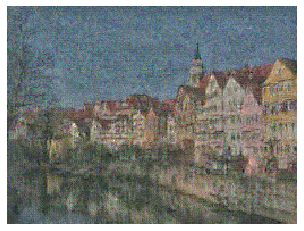

[tensor([[[[1.2626, 0.0000, 0.7836,  ..., 0.8473, 0.7717, 0.9401],
          [1.1754, 1.0444, 0.7036,  ..., 2.2688, 1.2928, 1.2775],
          [1.0901, 0.8688, 0.9512,  ..., 1.8614, 1.6446, 1.3823],
          ...,
          [0.9583, 0.8463, 0.7678,  ..., 0.4710, 0.3388, 0.5261],
          [0.7879, 0.5165, 0.9362,  ..., 0.3081, 0.0000, 0.5623],
          [0.4237, 0.3503, 0.6658,  ..., 0.0000, 0.2781, 0.4533]],

         [[0.0000, 0.4307, 0.0000,  ..., 0.0320, 0.0000, 0.3474],
          [0.7057, 0.0000, 0.0616,  ..., 0.0000, 0.0000, 0.2907],
          [0.0000, 0.1864, 0.4163,  ..., 0.0522, 0.0000, 0.0000],
          ...,
          [0.0615, 0.0000, 0.0000,  ..., 0.3420, 0.0000, 0.0591],
          [0.4282, 0.0000, 0.5345,  ..., 0.0284, 0.0000, 0.2914],
          [0.0572, 0.0000, 0.0290,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.4806, 0.1557, 0.0000,  ..., 0.8945, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.5885, 0.0000, 0.3080],
          [0.2170, 0.2192, 0.4307,  ..., 

[tensor([[[[1.0836e+00, 2.1668e-01, 1.6193e+00,  ..., 1.5560e+00,
           1.4612e+00, 1.0884e+00],
          [1.1520e+00, 1.4340e+00, 1.1745e+00,  ..., 1.7074e+00,
           1.0171e+00, 7.1888e-01],
          [1.1055e+00, 1.8381e+00, 1.0410e+00,  ..., 1.8354e+00,
           1.5996e+00, 1.3368e+00],
          ...,
          [3.6155e-01, 1.0760e+00, 1.1370e+00,  ..., 7.2552e-01,
           1.1376e-01, 1.9938e-01],
          [4.8499e-01, 3.8298e-01, 6.3205e-01,  ..., 5.7752e-01,
           0.0000e+00, 6.5753e-01],
          [8.3922e-01, 2.2739e-01, 5.3085e-01,  ..., 0.0000e+00,
           2.0516e-02, 6.0654e-01]],

         [[9.0017e-02, 1.7955e-01, 0.0000e+00,  ..., 0.0000e+00,
           4.8686e-01, 0.0000e+00],
          [1.2350e-02, 0.0000e+00, 0.0000e+00,  ..., 7.0073e-01,
           0.0000e+00, 2.1723e-01],
          [0.0000e+00, 2.2694e-01, 0.0000e+00,  ..., 0.0000e+00,
           8.0980e-01, 1.9897e-02],
          ...,
          [7.3594e-01, 0.0000e+00, 3.7629e-01,  ..., 1.818

[tensor([[[[1.0352, 0.0000, 1.8779,  ..., 1.9093, 1.9681, 1.8049],
          [1.4286, 1.1432, 0.7722,  ..., 1.2684, 1.1343, 0.6916],
          [0.8480, 1.2987, 0.2596,  ..., 1.8974, 1.8046, 1.3261],
          ...,
          [0.8401, 0.8475, 0.9551,  ..., 0.5112, 0.1673, 0.3883],
          [0.5075, 0.6741, 0.7646,  ..., 0.7711, 0.4197, 0.6276],
          [1.1057, 1.0075, 0.8628,  ..., 0.2549, 0.0000, 0.4475]],

         [[0.6072, 0.0000, 0.0469,  ..., 0.6478, 0.3824, 0.0000],
          [0.0000, 0.2550, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.2312, 0.3819, 0.0855,  ..., 0.2757, 0.0054, 0.0000],
          ...,
          [0.0000, 0.2837, 0.0000,  ..., 0.0606, 0.0000, 0.0000],
          [0.0226, 0.2505, 0.0322,  ..., 0.0000, 0.3187, 0.6669],
          [0.0000, 0.0000, 0.1742,  ..., 0.0000, 0.0000, 0.4955]],

         [[0.2306, 0.0732, 1.0466,  ..., 0.4090, 2.4692, 0.4410],
          [0.2938, 0.8323, 0.4454,  ..., 0.5889, 1.0607, 0.1157],
          [0.0693, 0.0000, 0.2649,  ..., 

[tensor([[[[1.4362, 0.7151, 1.4532,  ..., 1.9122, 1.6082, 2.0647],
          [1.2389, 0.9218, 0.9953,  ..., 1.6719, 1.3529, 1.3616],
          [0.4769, 0.0000, 0.6924,  ..., 2.2839, 1.9674, 1.7799],
          ...,
          [0.6769, 0.8238, 0.7115,  ..., 0.1265, 0.8838, 0.9371],
          [0.9073, 0.9556, 0.9877,  ..., 0.6055, 1.3602, 1.0356],
          [0.1947, 1.0458, 0.4460,  ..., 0.5962, 0.3081, 0.7926]],

         [[0.4378, 0.0000, 0.2250,  ..., 0.0000, 0.0000, 0.3792],
          [0.1480, 0.0991, 0.2302,  ..., 0.0000, 0.5121, 0.0000],
          [0.4056, 0.0000, 0.0000,  ..., 0.0000, 0.0694, 0.2377],
          ...,
          [0.1198, 0.2839, 0.0000,  ..., 0.2353, 0.2664, 0.0000],
          [0.0000, 0.0000, 0.4050,  ..., 0.0000, 0.0000, 0.7058],
          [0.0000, 0.1679, 0.1384,  ..., 0.2781, 0.0000, 0.6982]],

         [[1.1023, 1.8112, 0.8322,  ..., 0.3855, 0.4189, 0.0000],
          [0.9168, 1.2339, 0.0000,  ..., 0.8227, 1.8371, 0.4774],
          [0.0000, 1.0592, 0.3098,  ..., 

[tensor([[[[0.9669, 2.0150, 1.1115,  ..., 2.1026, 1.1103, 1.5604],
          [0.6727, 1.6751, 0.9121,  ..., 1.6070, 1.6244, 1.6426],
          [0.4937, 1.7722, 1.3314,  ..., 1.5261, 2.1099, 1.6846],
          ...,
          [0.3724, 0.8541, 1.0602,  ..., 0.7820, 0.7185, 0.7897],
          [1.0360, 0.9174, 0.8003,  ..., 0.0764, 0.7013, 0.8523],
          [0.3262, 0.6243, 0.5400,  ..., 0.9246, 0.8363, 0.8242]],

         [[0.0465, 0.1253, 0.1993,  ..., 0.0000, 0.0000, 0.3034],
          [0.0000, 0.4078, 0.1602,  ..., 0.2237, 0.0000, 0.0000],
          [0.3197, 0.1228, 0.7200,  ..., 0.0000, 0.8163, 0.1306],
          ...,
          [0.3928, 0.0236, 0.0000,  ..., 0.0000, 0.7376, 0.0000],
          [0.0294, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.3100],
          [0.1072, 0.0000, 0.0000,  ..., 0.2560, 0.0000, 0.4537]],

         [[1.0342, 0.7459, 0.0706,  ..., 0.0000, 0.0826, 1.2860],
          [1.0938, 0.2449, 0.9382,  ..., 0.6286, 1.4220, 0.6863],
          [0.6947, 0.7832, 1.2098,  ..., 

[tensor([[[[0.2898, 2.4177, 0.8377,  ..., 2.0931, 1.1811, 1.1558],
          [0.5312, 1.9406, 1.0168,  ..., 1.2503, 1.6766, 1.6517],
          [0.5940, 1.1971, 1.9316,  ..., 1.1603, 1.8566, 1.5409],
          ...,
          [0.7512, 0.8517, 0.4416,  ..., 0.9998, 0.0000, 0.8728],
          [0.9018, 0.8136, 0.4411,  ..., 0.0000, 0.0000, 0.5389],
          [0.7174, 0.4929, 0.5993,  ..., 0.2689, 0.8008, 0.7627]],

         [[0.0000, 0.2250, 0.0000,  ..., 1.3421, 0.0000, 0.0000],
          [0.0000, 0.2443, 0.2312,  ..., 0.0879, 0.1959, 0.0000],
          [0.7294, 0.1626, 0.0000,  ..., 0.0000, 0.0000, 0.1051],
          ...,
          [0.0000, 0.0315, 0.0536,  ..., 0.1429, 0.2315, 0.2986],
          [0.3831, 0.0696, 0.0000,  ..., 0.0976, 0.0000, 0.0000],
          [0.2041, 0.0000, 0.0753,  ..., 0.1194, 0.0000, 0.0985]],

         [[0.3379, 0.0000, 0.9872,  ..., 0.8797, 1.9413, 0.8996],
          [1.1647, 0.0000, 1.9572,  ..., 0.0000, 0.4504, 0.6129],
          [0.7270, 0.0000, 0.0000,  ..., 

[tensor([[[[0.0000e+00, 9.8378e-01, 0.0000e+00,  ..., 1.5603e+00,
           1.8570e+00, 1.6337e+00],
          [5.7514e-01, 1.5022e+00, 4.0715e-01,  ..., 1.7471e+00,
           1.8905e+00, 1.6732e+00],
          [4.4134e-01, 1.0659e+00, 8.9743e-01,  ..., 1.4233e+00,
           1.5872e+00, 1.5363e+00],
          ...,
          [4.3120e-01, 8.6903e-01, 3.3481e-01,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [1.8913e-01, 7.4444e-01, 7.5425e-01,  ..., 0.0000e+00,
           1.0785e-01, 2.4012e-01],
          [7.5040e-01, 8.6050e-01, 1.0925e+00,  ..., 0.0000e+00,
           4.7526e-01, 1.7375e-01]],

         [[0.0000e+00, 4.3797e-02, 0.0000e+00,  ..., 2.0497e-01,
           0.0000e+00, 7.0475e-02],
          [0.0000e+00, 1.5554e-01, 3.6143e-03,  ..., 0.0000e+00,
           5.6448e-01, 1.1109e-01],
          [4.7308e-01, 5.4359e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 4.7283e-01],
          ...,
          [1.6051e-01, 0.0000e+00, 2.4185e-01,  ..., 0.000

[tensor([[[[0.3418, 0.7503, 0.7236,  ..., 1.1350, 2.2200, 1.6354],
          [0.8343, 0.0000, 0.6873,  ..., 2.1956, 1.5409, 1.3969],
          [1.8416, 0.0000, 0.1421,  ..., 1.8938, 1.2101, 1.3321],
          ...,
          [0.6828, 0.6813, 0.8413,  ..., 0.1471, 1.0661, 0.4666],
          [0.6908, 0.8948, 0.9116,  ..., 0.5511, 0.9027, 0.1873],
          [1.2985, 1.2484, 0.9599,  ..., 0.9146, 0.5669, 0.0000]],

         [[0.5814, 0.0000, 1.5264,  ..., 0.0000, 0.4679, 0.0000],
          [0.3554, 0.0000, 0.2963,  ..., 0.5495, 0.0000, 0.3718],
          [0.4104, 0.0000, 1.3917,  ..., 0.2187, 0.0000, 0.0000],
          ...,
          [0.0356, 0.2022, 0.0000,  ..., 0.4467, 0.0365, 0.7492],
          [0.0000, 0.0419, 0.2108,  ..., 0.0000, 0.3447, 0.0000],
          [0.0000, 0.0000, 0.2359,  ..., 0.0000, 0.0000, 0.6202]],

         [[0.0000, 0.2342, 0.0768,  ..., 0.1164, 0.0000, 0.0000],
          [0.0000, 0.0290, 0.4885,  ..., 1.3786, 0.0000, 0.1405],
          [0.0000, 0.5586, 0.0000,  ..., 

[tensor([[[[1.0596, 1.8951, 2.4674,  ..., 1.1506, 1.4618, 0.9045],
          [0.2253, 0.3284, 0.9576,  ..., 1.7846, 0.9844, 0.9771],
          [0.9540, 1.7272, 0.9054,  ..., 1.4040, 0.9242, 1.1424],
          ...,
          [1.0058, 0.8251, 1.0806,  ..., 0.7427, 0.5111, 1.3027],
          [0.6204, 0.9065, 0.9901,  ..., 1.1834, 0.0000, 0.0451],
          [1.0952, 1.1870, 0.5886,  ..., 0.6222, 0.0000, 0.0000]],

         [[0.1931, 0.0000, 0.1005,  ..., 0.0000, 0.4680, 0.0000],
          [0.6194, 0.0000, 0.0000,  ..., 0.1133, 0.1022, 0.1537],
          [0.0108, 0.4175, 1.1922,  ..., 0.8219, 0.3516, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0643,  ..., 0.1295, 0.5808, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.1237, 0.3890, 0.5498],
          [0.0000, 0.3808, 0.0000,  ..., 0.0000, 0.0000, 0.6188]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.7765, 1.1635, 0.5534],
          [0.0000, 1.3289, 0.7345,  ..., 0.8652, 0.2249, 0.2814],
          [0.0000, 0.0000, 0.2956,  ..., 

[tensor([[[[0.2727, 1.5208, 1.6296,  ..., 1.3785, 1.2037, 0.5725],
          [0.4894, 1.2396, 1.3176,  ..., 2.5642, 1.5707, 0.9578],
          [0.0998, 1.3696, 0.9370,  ..., 1.7290, 1.6323, 1.4593],
          ...,
          [0.5934, 0.6853, 0.7960,  ..., 0.3351, 0.2481, 0.0000],
          [0.4436, 0.8578, 0.9037,  ..., 0.0530, 0.0000, 0.0000],
          [0.8920, 1.2174, 1.2347,  ..., 0.0741, 0.0000, 0.7719]],

         [[0.0000, 0.2389, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 1.3399, 0.0000],
          [0.7062, 0.0828, 0.0000,  ..., 0.0000, 0.2772, 0.0000],
          ...,
          [0.1762, 0.0000, 0.0633,  ..., 0.0000, 0.0000, 0.0000],
          [0.1677, 0.0000, 0.1429,  ..., 0.8602, 0.5204, 0.1023],
          [0.0000, 0.4729, 0.0000,  ..., 0.0000, 0.0156, 0.0000]],

         [[2.2890, 0.6631, 0.0000,  ..., 0.8314, 1.4194, 1.3631],
          [1.9920, 0.0000, 0.0000,  ..., 0.0000, 0.4622, 0.3157],
          [0.7387, 1.0931, 0.0986,  ..., 

[tensor([[[[1.7238, 1.7046, 0.9294,  ..., 0.9720, 1.0544, 0.7104],
          [2.0856, 1.2047, 1.1958,  ..., 1.5161, 1.9782, 1.1883],
          [1.2594, 1.2318, 0.4470,  ..., 1.8050, 2.4266, 1.5302],
          ...,
          [0.2918, 0.9536, 0.7625,  ..., 0.5542, 0.9286, 1.4831],
          [1.0549, 1.1675, 0.7191,  ..., 0.4978, 0.5855, 0.5023],
          [0.8763, 0.7776, 0.8037,  ..., 0.0000, 0.4012, 1.0261]],

         [[0.0000, 1.0609, 0.3929,  ..., 0.1227, 0.0000, 0.6156],
          [0.0000, 1.0294, 0.0000,  ..., 0.6658, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.4770],
          ...,
          [0.0050, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.6122],
          [0.0765, 0.3319, 0.0000,  ..., 0.0887, 0.9822, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 1.0006, 0.0000]],

         [[1.3294, 0.0000, 0.7727,  ..., 0.5223, 0.0000, 0.7530],
          [1.3799, 0.8319, 1.0986,  ..., 1.2753, 1.5285, 0.0082],
          [0.9103, 0.5411, 0.0000,  ..., 

[tensor([[[[1.7305, 1.5298, 0.9150,  ..., 0.8517, 0.8424, 1.1347],
          [0.9655, 0.8038, 0.3998,  ..., 0.6881, 1.2439, 0.8630],
          [0.2597, 1.1603, 0.5593,  ..., 1.7318, 1.6926, 0.3712],
          ...,
          [0.7575, 1.0971, 0.7980,  ..., 0.6589, 0.0000, 0.0000],
          [1.1499, 1.1723, 0.8232,  ..., 0.8572, 0.7367, 0.0393],
          [0.9334, 0.6685, 0.6542,  ..., 0.4346, 0.9758, 0.5585]],

         [[1.3003, 0.0375, 1.0013,  ..., 0.0000, 0.0000, 0.4859],
          [0.8297, 0.2167, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.3526, 0.1467,  ..., 0.0000, 0.4190, 0.3830],
          ...,
          [0.0000, 0.3561, 0.0000,  ..., 0.0704, 0.2847, 0.0000],
          [0.0000, 0.3727, 0.0000,  ..., 0.0000, 0.4228, 0.0000],
          [0.1272, 0.0000, 0.2660,  ..., 0.4464, 1.1159, 0.0000]],

         [[0.7214, 0.1548, 1.4226,  ..., 0.3944, 0.1058, 0.7968],
          [0.0000, 0.6533, 1.4032,  ..., 0.7658, 0.7103, 0.7488],
          [0.1706, 0.0000, 0.0000,  ..., 

[tensor([[[[3.7757e-02, 1.1536e+00, 1.3094e+00,  ..., 1.4584e+00,
           1.3096e+00, 1.8399e+00],
          [4.1109e-01, 6.9451e-01, 1.1228e+00,  ..., 9.7344e-01,
           7.8116e-01, 8.0507e-01],
          [6.7270e-01, 1.1583e+00, 2.3425e-01,  ..., 2.1470e+00,
           9.7193e-01, 7.4299e-01],
          ...,
          [1.2962e+00, 8.3926e-01, 7.1684e-01,  ..., 5.1583e-01,
           9.4378e-02, 4.0138e-02],
          [8.3775e-01, 6.5271e-01, 6.2152e-01,  ..., 0.0000e+00,
           5.4330e-01, 7.2587e-01],
          [7.9180e-01, 6.8836e-01, 8.0686e-01,  ..., 7.6986e-01,
           7.5566e-01, 1.5541e-01]],

         [[3.0224e-01, 0.0000e+00, 3.2342e-01,  ..., 2.4499e-04,
           5.0939e-01, 0.0000e+00],
          [8.5412e-01, 0.0000e+00, 2.8667e-01,  ..., 0.0000e+00,
           9.3511e-01, 0.0000e+00],
          [2.4990e-01, 2.9485e-01, 0.0000e+00,  ..., 9.2848e-04,
           0.0000e+00, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 2.1364e-01,  ..., 4.870

[tensor([[[[0.0540, 1.2158, 1.4478,  ..., 1.7376, 1.6522, 2.2885],
          [0.7920, 0.5129, 1.8948,  ..., 1.3103, 1.0271, 1.0490],
          [1.7155, 0.8416, 0.3161,  ..., 1.5176, 0.7356, 1.3025],
          ...,
          [0.3633, 0.7267, 0.6984,  ..., 0.2737, 0.0000, 0.1972],
          [0.1054, 0.5204, 0.9811,  ..., 0.0000, 0.0000, 0.5047],
          [0.5451, 0.8396, 0.9468,  ..., 0.1563, 0.1529, 0.7386]],

         [[0.0000, 0.1604, 0.0000,  ..., 0.2941, 0.1368, 0.0000],
          [0.0000, 0.0000, 0.2394,  ..., 0.5005, 0.4708, 0.0000],
          [0.9023, 0.0000, 0.1798,  ..., 0.5472, 0.0000, 0.0000],
          ...,
          [0.0000, 0.3666, 0.0000,  ..., 0.2968, 0.0000, 1.0193],
          [0.8319, 0.0000, 0.0000,  ..., 0.7135, 0.0241, 0.0729],
          [0.1192, 0.0588, 0.0000,  ..., 0.0000, 0.0000, 0.5844]],

         [[0.0000, 1.0999, 0.0000,  ..., 0.2485, 0.0000, 0.2419],
          [1.3789, 0.6213, 0.0000,  ..., 0.0922, 1.1935, 0.5399],
          [0.2432, 1.2409, 0.0000,  ..., 

[tensor([[[[0.9019, 0.8347, 0.4008,  ..., 1.9738, 1.3678, 2.2253],
          [1.1522, 1.4534, 1.6961,  ..., 1.7195, 1.4022, 1.2004],
          [1.6220, 0.8423, 0.2860,  ..., 1.1113, 0.7518, 1.3822],
          ...,
          [0.6265, 1.0324, 1.0587,  ..., 0.1154, 0.1499, 0.2255],
          [0.6740, 0.6405, 0.7325,  ..., 1.1255, 0.4418, 0.5526],
          [0.5581, 0.7657, 0.8169,  ..., 0.2044, 0.2712, 0.3859]],

         [[0.0000, 0.2571, 0.0000,  ..., 0.3226, 0.0000, 0.9900],
          [0.0000, 1.1113, 0.0000,  ..., 0.0969, 0.0000, 0.0000],
          [0.0000, 0.5382, 0.0000,  ..., 0.0000, 1.0094, 0.4814],
          ...,
          [0.0000, 0.0000, 0.2273,  ..., 0.0000, 0.0000, 0.0000],
          [0.6278, 0.0000, 0.4356,  ..., 0.0000, 1.3760, 0.2649],
          [0.0000, 0.0000, 0.0000,  ..., 0.4147, 0.0000, 0.3562]],

         [[1.3268, 0.7650, 0.3153,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.6434, 1.0127,  ..., 0.6479, 0.3245, 0.4791],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.5327, 1.0905, 0.1776,  ..., 1.2501, 0.9455, 0.7601],
          [1.0365, 2.3858, 1.7559,  ..., 1.3809, 1.6306, 1.0221],
          [1.5028, 1.4384, 0.6991,  ..., 1.9201, 1.3751, 1.4868],
          ...,
          [0.6831, 0.6619, 0.1802,  ..., 0.2837, 0.0000, 0.3887],
          [0.8141, 0.4961, 0.5199,  ..., 0.0000, 0.4783, 1.2214],
          [0.4924, 0.7348, 0.4315,  ..., 0.1322, 1.4072, 0.6684]],

         [[0.3553, 0.5581, 0.0000,  ..., 0.1147, 0.0000, 0.6607],
          [0.7452, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0903],
          [0.3977, 0.9982, 0.0000,  ..., 0.0000, 0.0466, 0.2739],
          ...,
          [0.0000, 0.3140, 0.0000,  ..., 0.0000, 1.5393, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.4305, 0.0000, 0.3923],
          [0.0000, 0.0000, 0.3640,  ..., 0.7017, 0.3197, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.2712, 0.0000, 0.4829],
          [0.0000, 0.9745, 0.5530,  ..., 1.0137, 0.0493, 0.0000],
          [0.0000, 0.3600, 0.0000,  ..., 

[tensor([[[[1.4184, 0.8553, 1.0212,  ..., 0.9786, 1.4984, 0.5668],
          [0.5865, 1.1126, 0.9929,  ..., 1.5934, 1.4905, 1.0825],
          [0.8977, 0.7874, 0.9351,  ..., 1.8325, 1.8419, 1.6536],
          ...,
          [0.6271, 0.3418, 1.5214,  ..., 1.7684, 0.9585, 0.9133],
          [0.1536, 0.7098, 1.0024,  ..., 1.6138, 1.0700, 1.2348],
          [0.0000, 0.7403, 1.1609,  ..., 0.6410, 0.3917, 0.1311]],

         [[0.0000, 0.0000, 0.5421,  ..., 0.0000, 0.4680, 0.0000],
          [0.5589, 0.0000, 0.0000,  ..., 0.0000, 0.2766, 0.6644],
          [0.7490, 0.0372, 0.0000,  ..., 0.8264, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.1021,  ..., 0.0000, 0.3390, 0.6092],
          [0.0000, 0.1267, 0.1714,  ..., 1.3653, 0.0000, 0.4106],
          [0.0000, 0.7751, 0.0963,  ..., 0.0000, 0.3742, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 1.5002, 0.2835, 1.2243],
          [0.8132, 0.0000, 0.0000,  ..., 0.0000, 0.7944, 0.6318],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.9025, 0.8367, 2.1762,  ..., 2.0494, 2.0407, 1.0788],
          [1.3124, 0.2839, 0.5902,  ..., 1.5474, 1.0763, 1.6759],
          [1.2360, 0.2272, 0.2549,  ..., 0.8519, 1.2711, 2.2626],
          ...,
          [0.6256, 0.2132, 0.0000,  ..., 0.0000, 0.9153, 1.5526],
          [0.6719, 0.9767, 0.0000,  ..., 0.8000, 0.9663, 0.5069],
          [1.5371, 0.6194, 0.7474,  ..., 1.0644, 0.0695, 0.0785]],

         [[0.0000, 0.1013, 0.2319,  ..., 0.0000, 0.3066, 0.0000],
          [0.0000, 1.0862, 0.0000,  ..., 0.2628, 0.1610, 0.0000],
          [0.0000, 0.0000, 0.0071,  ..., 0.1355, 0.0000, 0.0000],
          ...,
          [0.0000, 0.2254, 0.3220,  ..., 0.4832, 0.0000, 1.0114],
          [0.5334, 0.0654, 0.0000,  ..., 0.0000, 0.0518, 0.0000],
          [0.0000, 0.5689, 0.0000,  ..., 0.0000, 0.4861, 0.1797]],

         [[0.1910, 0.1885, 0.0000,  ..., 0.0614, 1.1690, 0.6561],
          [0.0000, 0.0000, 0.0000,  ..., 0.6463, 1.0650, 1.2547],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.9861, 1.0018, 1.9081,  ..., 2.0376, 1.9058, 1.1577],
          [2.0003, 0.7229, 0.6614,  ..., 1.4158, 1.4034, 1.4199],
          [1.2510, 0.3554, 0.8823,  ..., 1.0255, 1.3908, 0.8084],
          ...,
          [0.6880, 0.2304, 0.4339,  ..., 0.0000, 0.0000, 0.0000],
          [0.4235, 0.5027, 0.4096,  ..., 0.0000, 0.2424, 0.1865],
          [0.0000, 0.0000, 0.6956,  ..., 0.0000, 0.0000, 1.0598]],

         [[0.0000, 0.6320, 0.0000,  ..., 0.3057, 0.0000, 0.8209],
          [0.0000, 0.8850, 0.2942,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.2092, 0.2710,  ..., 0.0000, 0.5764, 0.0000],
          ...,
          [0.2060, 0.0000, 0.0335,  ..., 0.0414, 0.0000, 0.0000],
          [1.2999, 0.0435, 0.7046,  ..., 0.0000, 0.1911, 0.0000],
          [0.1299, 0.0000, 0.0000,  ..., 0.0000, 0.4610, 0.0000]],

         [[0.0000, 0.1296, 0.3675,  ..., 0.5078, 1.1630, 0.7626],
          [0.0000, 0.0000, 0.9141,  ..., 0.3472, 0.7757, 0.5635],
          [0.0000, 0.0780, 0.0000,  ..., 

[tensor([[[[0.9680, 1.0588, 1.2009,  ..., 1.0637, 1.4929, 1.2872],
          [1.1348, 1.5452, 1.0230,  ..., 1.0084, 1.3406, 0.8485],
          [0.3212, 0.6485, 1.3125,  ..., 1.7662, 1.8780, 0.3812],
          ...,
          [0.8917, 0.3708, 0.2951,  ..., 0.2136, 0.3787, 0.7596],
          [1.3243, 0.6183, 0.8898,  ..., 0.5082, 1.0392, 1.4691],
          [0.1625, 1.0599, 0.6021,  ..., 0.0000, 0.1431, 0.2961]],

         [[0.4915, 0.0000, 0.0000,  ..., 0.4651, 0.0152, 0.6452],
          [0.0000, 0.0000, 0.4006,  ..., 0.0000, 0.0000, 0.6646],
          [0.1734, 0.0000, 0.3252,  ..., 0.0000, 1.0619, 0.0000],
          ...,
          [0.5113, 0.1571, 0.0572,  ..., 0.0000, 0.6308, 0.0000],
          [0.0000, 0.0000, 0.5579,  ..., 0.7373, 0.0000, 0.0000],
          [0.0000, 0.0662, 0.2682,  ..., 0.0000, 0.7518, 0.0000]],

         [[0.0000, 0.2261, 0.5596,  ..., 1.5275, 0.0000, 0.4262],
          [0.9250, 0.0000, 0.0000,  ..., 0.2930, 0.1603, 0.4492],
          [0.5829, 0.3065, 0.0000,  ..., 

[tensor([[[[1.0840e+00, 1.9784e+00, 1.5273e+00,  ..., 1.3075e+00,
           1.5848e+00, 1.3532e+00],
          [2.8187e-01, 1.8980e+00, 1.1578e+00,  ..., 6.5391e-02,
           5.6862e-01, 7.3337e-01],
          [1.0717e+00, 1.1519e+00, 1.1180e+00,  ..., 1.4782e+00,
           1.5773e+00, 1.0620e+00],
          ...,
          [6.9278e-01, 1.0197e+00, 4.9179e-01,  ..., 3.3524e-01,
           8.7018e-01, 1.5178e+00],
          [8.3082e-01, 3.2014e-01, 5.0697e-01,  ..., 4.3570e-01,
           5.3091e-01, 1.1862e+00],
          [2.5827e-01, 8.6483e-01, 0.0000e+00,  ..., 0.0000e+00,
           8.0507e-01, 0.0000e+00]],

         [[1.2789e+00, 0.0000e+00, 5.5455e-01,  ..., 0.0000e+00,
           5.9167e-01, 0.0000e+00],
          [0.0000e+00, 7.0145e-03, 0.0000e+00,  ..., 6.9887e-02,
           0.0000e+00, 4.9722e-01],
          [4.4504e-01, 0.0000e+00, 1.5736e-01,  ..., 3.5521e-01,
           0.0000e+00, 4.5460e-01],
          ...,
          [0.0000e+00, 9.9465e-02, 0.0000e+00,  ..., 0.000

[tensor([[[[1.9879e+00, 1.9443e+00, 2.7241e+00,  ..., 1.7907e+00,
           2.1397e+00, 1.1247e+00],
          [6.6979e-01, 2.2733e+00, 1.4793e+00,  ..., 1.9779e+00,
           1.1269e+00, 1.4355e+00],
          [3.1372e+00, 1.8569e+00, 1.0816e+00,  ..., 2.3829e+00,
           1.0807e+00, 2.1758e+00],
          ...,
          [8.9258e-02, 7.9630e-01, 5.9839e-01,  ..., 1.1197e+00,
           3.6986e-01, 0.0000e+00],
          [0.0000e+00, 5.1324e-01, 0.0000e+00,  ..., 1.3299e-01,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 8.5800e-01, 7.6959e-01,  ..., 1.0552e+00,
           8.5956e-01, 5.0896e-01]],

         [[4.8459e-01, 0.0000e+00, 7.8161e-01,  ..., 0.0000e+00,
           0.0000e+00, 2.2384e-01],
          [0.0000e+00, 7.0535e-01, 0.0000e+00,  ..., 1.0718e+00,
           0.0000e+00, 0.0000e+00],
          [1.9742e-01, 0.0000e+00, 4.0720e-01,  ..., 1.5955e+00,
           0.0000e+00, 4.5503e-01],
          ...,
          [3.2982e-01, 0.0000e+00, 1.9382e-01,  ..., 8.290

[tensor([[[[2.8402, 0.2185, 1.5936,  ..., 1.8476, 1.5359, 2.0914],
          [0.5183, 1.6104, 1.2399,  ..., 2.1832, 1.7790, 2.4284],
          [1.7341, 1.2261, 1.1535,  ..., 1.5110, 1.2136, 2.0020],
          ...,
          [0.4741, 0.6754, 1.0025,  ..., 0.9731, 0.5278, 0.0000],
          [0.4382, 0.6037, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.9322, 0.2740, 0.0000,  ..., 0.9721, 0.2614, 1.2706]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.3048],
          [0.9427, 0.0000, 0.5473,  ..., 0.2628, 0.3451, 0.2576],
          [0.0129, 0.1343, 0.3834,  ..., 0.0738, 0.0691, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.2154, 0.2569],
          [0.0000, 0.1889, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.1638, 0.0000, 0.0000,  ..., 0.2514, 0.1754, 0.1880]],

         [[0.0000, 0.4241, 0.7515,  ..., 0.6853, 0.1660, 0.3414],
          [0.0421, 0.0171, 1.2331,  ..., 0.0000, 0.0000, 1.4521],
          [0.0000, 0.0000, 0.7399,  ..., 

[tensor([[[[1.0913, 0.0000, 0.3402,  ..., 1.5653, 1.1411, 2.1210],
          [0.6106, 0.0000, 1.2367,  ..., 1.6633, 1.8373, 1.4585],
          [0.4128, 0.4008, 0.6695,  ..., 1.5399, 1.5622, 0.7501],
          ...,
          [0.6453, 0.4044, 0.3871,  ..., 0.0000, 1.0721, 1.3368],
          [0.3721, 0.5842, 0.6840,  ..., 0.0000, 1.0738, 1.2792],
          [1.1266, 0.7244, 0.5114,  ..., 0.0321, 0.0000, 0.0301]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.1524, 0.8993, 0.0878],
          [0.3944, 0.0000, 0.3138,  ..., 0.0000, 0.0000, 0.0000],
          [0.1453, 0.3924, 0.0000,  ..., 0.0000, 0.1910, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.3874, 0.0000, 0.2001,  ..., 0.6248, 0.0000, 0.3346],
          [0.0000, 0.0000, 0.5081,  ..., 0.0973, 0.3220, 0.5528]],

         [[0.0000, 0.7031, 0.0000,  ..., 0.6629, 0.8192, 2.6911],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.5188, 0.7446],
          [0.7726, 0.2599, 0.7466,  ..., 

[tensor([[[[0.3466, 1.2758, 0.7269,  ..., 1.5827, 1.2688, 0.8031],
          [1.3005, 0.0000, 2.0927,  ..., 1.6988, 1.9154, 0.2323],
          [0.8159, 1.2018, 0.5435,  ..., 1.7920, 1.9606, 0.2562],
          ...,
          [0.6291, 0.2834, 1.0569,  ..., 0.0000, 0.5727, 1.1623],
          [0.0000, 0.3953, 0.7279,  ..., 0.2256, 2.0046, 0.0000],
          [0.0000, 0.6431, 0.6882,  ..., 1.0201, 0.0000, 0.0000]],

         [[0.5688, 0.5572, 0.0000,  ..., 0.0000, 0.0000, 0.3940],
          [0.0000, 0.3031, 0.0000,  ..., 0.3727, 0.0250, 0.0000],
          [0.3246, 0.0000, 0.1992,  ..., 0.4951, 0.2731, 1.0284],
          ...,
          [0.0000, 0.0000, 0.5742,  ..., 0.3500, 0.0261, 0.0430],
          [0.4148, 0.1436, 0.2022,  ..., 0.2003, 0.8401, 0.6207],
          [0.3566, 0.0000, 0.0000,  ..., 0.0000, 0.1016, 0.0000]],

         [[0.5621, 0.6468, 0.3389,  ..., 1.1211, 0.2970, 0.0000],
          [0.0000, 0.0939, 0.3599,  ..., 3.2620, 1.5100, 0.2861],
          [0.0000, 0.4555, 0.0000,  ..., 

[tensor([[[[0.8938, 2.3320, 0.9709,  ..., 1.0675, 0.7040, 0.6486],
          [1.9528, 0.4699, 1.8625,  ..., 1.5129, 1.4320, 0.3825],
          [1.5715, 2.0863, 0.8198,  ..., 1.7897, 1.5468, 1.5445],
          ...,
          [0.6333, 0.2754, 0.0000,  ..., 0.0000, 0.0786, 0.0000],
          [1.9477, 0.7702, 0.0000,  ..., 0.5178, 0.8080, 0.0000],
          [1.0841, 1.1563, 0.7712,  ..., 0.3391, 0.1234, 0.0000]],

         [[0.4999, 0.7053, 0.0000,  ..., 0.0056, 0.0000, 0.6195],
          [0.0000, 0.0145, 0.0000,  ..., 0.0000, 0.4915, 0.6031],
          [0.0974, 0.0000, 1.2812,  ..., 0.0000, 0.1342, 0.0000],
          ...,
          [0.8188, 0.7926, 0.0000,  ..., 0.0599, 0.8006, 0.6147],
          [0.3029, 0.0000, 0.0000,  ..., 0.2984, 0.0809, 0.0000],
          [0.8547, 0.0000, 0.0188,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.5680, 0.7327,  ..., 0.5961, 0.0000, 0.3218],
          [0.4049, 1.2381, 0.1155,  ..., 0.3096, 1.2714, 0.4688],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.0584, 2.0892, 1.1067,  ..., 1.7084, 2.1721, 1.6982],
          [2.1733, 0.8622, 1.7740,  ..., 1.8894, 1.9837, 0.7500],
          [1.3077, 2.1179, 1.7609,  ..., 1.2458, 0.3963, 1.1723],
          ...,
          [0.0000, 0.0201, 0.4618,  ..., 0.6323, 0.3179, 0.8532],
          [0.0000, 0.0987, 0.6171,  ..., 0.3558, 0.0627, 0.0000],
          [0.8068, 0.5588, 0.7788,  ..., 0.2646, 0.3346, 0.0000]],

         [[0.0000, 0.1506, 0.2497,  ..., 0.2966, 1.1398, 0.0000],
          [0.4946, 0.0000, 0.3583,  ..., 0.0000, 0.0000, 1.1436],
          [0.0000, 0.1631, 0.4545,  ..., 0.0000, 1.2745, 0.0000],
          ...,
          [0.2823, 0.0000, 0.4455,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 1.1333,  ..., 0.1861, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.5527,  ..., 0.7620, 0.0734, 0.0394]],

         [[0.0000, 0.0000, 0.1181,  ..., 0.1806, 2.1027, 0.0000],
          [0.4077, 0.1523, 0.2820,  ..., 0.5307, 0.8731, 0.7466],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.8970, 1.8362, 0.4262,  ..., 1.5230, 1.3578, 1.7080],
          [1.8233, 0.7852, 0.9757,  ..., 1.2674, 2.0030, 1.1418],
          [0.5251, 1.1452, 1.6834,  ..., 1.9106, 0.8987, 0.7658],
          ...,
          [0.7373, 0.7353, 0.3025,  ..., 0.6804, 0.2674, 0.8417],
          [0.0000, 1.0980, 0.2210,  ..., 1.1306, 0.0715, 0.5741],
          [0.0000, 0.0452, 0.2142,  ..., 0.9563, 0.1973, 0.0000]],

         [[0.0000, 0.0000, 0.4187,  ..., 0.0000, 1.0126, 0.0000],
          [0.0000, 0.4792, 0.0000,  ..., 0.1231, 0.0000, 0.3376],
          [0.0000, 0.0000, 0.0000,  ..., 1.4846, 0.0000, 0.9894],
          ...,
          [0.0000, 0.0203, 0.4795,  ..., 0.3242, 0.0000, 0.0000],
          [0.0000, 0.9563, 0.5728,  ..., 0.1149, 0.0000, 0.5677],
          [0.0000, 0.5351, 0.1074,  ..., 0.6547, 0.0972, 0.0361]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.1414, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0880,  ..., 0.4109, 0.2389, 0.1114],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.1193, 1.5277, 0.7508,  ..., 1.4725, 1.1490, 1.6806],
          [1.6757, 0.3551, 0.2024,  ..., 0.5117, 1.5621, 1.9231],
          [0.1655, 0.2510, 1.0312,  ..., 0.8955, 1.5055, 0.4408],
          ...,
          [1.3372, 0.5158, 0.4544,  ..., 0.6826, 0.4658, 0.1668],
          [1.0190, 0.7967, 0.0925,  ..., 0.3775, 0.0000, 0.9671],
          [1.1691, 0.9300, 0.3713,  ..., 0.0000, 0.0000, 0.6418]],

         [[0.0000, 0.0753, 0.0000,  ..., 0.0000, 0.0000, 0.0598],
          [0.4498, 0.3436, 0.1248,  ..., 0.1875, 0.0228, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 1.2843, 0.0000, 1.1497],
          ...,
          [0.3149, 0.0000, 0.0000,  ..., 0.1882, 0.6897, 0.0000],
          [0.0000, 0.2417, 0.0000,  ..., 0.0000, 0.0000, 0.9369],
          [0.6738, 0.3019, 0.2563,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 1.6917, 0.0000, 1.4982],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1186],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.3062, 1.4954, 1.7406,  ..., 1.5485, 0.7982, 1.1460],
          [1.3921, 0.7247, 1.1328,  ..., 1.2503, 0.9691, 1.6349],
          [0.5926, 0.4431, 0.9235,  ..., 2.5892, 2.6621, 0.6018],
          ...,
          [0.0000, 0.2216, 0.8899,  ..., 0.2927, 0.5736, 0.0498],
          [0.0000, 0.1486, 0.6351,  ..., 0.0000, 0.0000, 0.0000],
          [0.7754, 0.6715, 0.5948,  ..., 0.5359, 0.0000, 0.6214]],

         [[0.1678, 0.0000, 0.2989,  ..., 0.9711, 0.0000, 0.1159],
          [1.0424, 0.0000, 0.5787,  ..., 0.6705, 0.0000, 0.3750],
          [0.2656, 0.0000, 0.1064,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.5426, 0.0360, 0.0128,  ..., 0.0000, 0.9736, 0.0000],
          [0.9645, 0.0000, 0.3278,  ..., 0.0000, 0.3890, 0.0000],
          [0.1401, 0.5365, 0.4355,  ..., 0.0000, 0.0000, 0.2536]],

         [[0.0000, 0.1935, 0.0000,  ..., 0.0000, 0.0000, 0.5861],
          [0.0000, 0.0000, 0.3227,  ..., 1.2569, 1.0599, 0.6864],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.4211, 1.4930, 1.0782,  ..., 0.6374, 0.3098, 0.7328],
          [1.3279, 1.0743, 1.0931,  ..., 0.6646, 0.2236, 0.8812],
          [1.4342, 1.2164, 0.8099,  ..., 0.1775, 2.4270, 1.3684],
          ...,
          [0.0000, 0.7700, 0.2269,  ..., 0.5683, 0.9240, 0.6404],
          [0.0736, 1.0627, 1.0492,  ..., 0.1595, 0.2813, 0.0000],
          [0.0000, 0.0000, 0.2173,  ..., 0.5919, 0.4576, 0.8678]],

         [[0.0000, 0.0000, 0.8521,  ..., 0.0000, 0.5559, 0.0000],
          [0.1509, 0.0000, 0.0000,  ..., 0.1095, 0.0000, 0.3296],
          [0.0478, 0.0000, 0.9151,  ..., 0.9380, 0.0533, 0.0000],
          ...,
          [0.0000, 0.8025, 0.0000,  ..., 0.9944, 0.0000, 0.3687],
          [0.0000, 0.6174, 0.0000,  ..., 0.0000, 0.4544, 0.0000],
          [0.0000, 0.0000, 0.2942,  ..., 0.0000, 0.0581, 0.1642]],

         [[1.1875, 0.0000, 0.3452,  ..., 0.7497, 0.7059, 0.4026],
          [0.1665, 0.0000, 0.2368,  ..., 0.0000, 0.9417, 1.1151],
          [0.5355, 0.0000, 0.0000,  ..., 

[tensor([[[[1.9358, 0.2855, 0.8743,  ..., 1.0666, 0.8888, 0.0000],
          [1.5718, 1.0748, 1.3425,  ..., 1.7062, 0.5511, 0.1091],
          [1.9417, 1.9109, 0.9543,  ..., 0.0000, 0.5935, 1.7116],
          ...,
          [0.5429, 0.2430, 0.0000,  ..., 0.9272, 0.7718, 0.5191],
          [0.4222, 1.1364, 1.3205,  ..., 0.7877, 1.5675, 0.3537],
          [0.0895, 0.6463, 0.7550,  ..., 0.0000, 1.2095, 1.0058]],

         [[0.0977, 0.2560, 0.5082,  ..., 0.0000, 1.0686, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.1451, 0.3316, 0.0000],
          [0.0138, 0.0000, 0.3316,  ..., 0.4116, 0.8598, 0.0000],
          ...,
          [0.4233, 0.1536, 0.3040,  ..., 0.0966, 0.0000, 0.2701],
          [0.0000, 0.2928, 0.0000,  ..., 0.1622, 0.0157, 0.0000],
          [0.3164, 0.4982, 0.2853,  ..., 0.1109, 0.9703, 0.0459]],

         [[0.0107, 0.0000, 1.3241,  ..., 1.3322, 1.9661, 0.1665],
          [1.6508, 0.7824, 0.0000,  ..., 0.6713, 0.0000, 0.9567],
          [0.6308, 0.0092, 0.0000,  ..., 

[tensor([[[[1.6302, 0.4815, 1.7859,  ..., 2.3305, 0.8812, 0.0000],
          [1.0485, 1.0676, 1.8315,  ..., 2.8490, 0.6340, 1.6821],
          [1.3736, 1.6389, 1.0750,  ..., 2.3065, 0.6364, 2.0116],
          ...,
          [1.2504, 0.4176, 0.1990,  ..., 0.0287, 0.0999, 0.4563],
          [0.8517, 0.8622, 0.1774,  ..., 0.1892, 0.2265, 0.0407],
          [1.3022, 0.4810, 0.5155,  ..., 0.4879, 0.3702, 0.6200]],

         [[0.1935, 0.0867, 0.0000,  ..., 0.0000, 0.4880, 0.3535],
          [0.4012, 0.0000, 0.1726,  ..., 0.0000, 0.9041, 0.0000],
          [0.0000, 0.0000, 0.2605,  ..., 0.0000, 0.7496, 0.5061],
          ...,
          [0.0602, 0.0000, 0.7136,  ..., 0.0000, 0.3810, 0.0000],
          [0.0724, 0.0000, 0.5451,  ..., 0.0000, 0.3222, 0.6284],
          [0.3636, 0.0000, 0.0000,  ..., 0.0857, 0.4235, 0.0000]],

         [[0.1064, 0.9388, 0.2662,  ..., 0.3378, 0.6625, 0.3882],
          [0.4060, 0.9320, 0.0000,  ..., 0.6352, 0.4465, 0.5870],
          [0.3490, 1.2950, 0.0000,  ..., 

[tensor([[[[1.3912, 0.5423, 2.0885,  ..., 1.7667, 1.4554, 0.8225],
          [1.1124, 0.9279, 1.2341,  ..., 0.2969, 0.7257, 2.2991],
          [0.9023, 0.8635, 0.8022,  ..., 2.1520, 1.5603, 1.0529],
          ...,
          [0.4985, 0.1988, 0.4464,  ..., 0.6866, 0.4423, 0.8097],
          [0.0000, 0.5241, 0.1668,  ..., 0.2491, 0.0000, 0.0522],
          [0.8599, 0.6553, 0.4343,  ..., 0.7325, 0.0057, 0.0875]],

         [[0.3247, 0.0000, 0.2782,  ..., 0.2181, 0.0000, 0.6963],
          [0.5389, 0.0038, 0.4434,  ..., 0.0000, 0.0000, 0.9160],
          [0.1623, 0.1302, 0.0553,  ..., 0.0000, 0.0000, 1.1991],
          ...,
          [0.0733, 0.0000, 0.4608,  ..., 0.1084, 0.5700, 0.0000],
          [0.1187, 0.2594, 0.6744,  ..., 0.0000, 0.0000, 0.9194],
          [0.2218, 0.0000, 0.0000,  ..., 0.0000, 0.0036, 0.1594]],

         [[1.4090, 1.2763, 0.2963,  ..., 0.0000, 0.0000, 0.2071],
          [0.0000, 0.0000, 0.0000,  ..., 1.4622, 2.4353, 0.0000],
          [0.0973, 0.7242, 0.0129,  ..., 

[tensor([[[[1.1654, 1.0553, 1.2466,  ..., 1.9589, 1.6040, 0.7061],
          [1.5775, 1.4109, 0.4474,  ..., 0.0000, 1.3296, 1.0648],
          [1.5228, 1.0709, 0.7589,  ..., 0.0000, 2.3365, 0.4137],
          ...,
          [0.0166, 0.2416, 0.7939,  ..., 0.7027, 0.9668, 0.9811],
          [0.2543, 0.5358, 0.7357,  ..., 0.6008, 0.9663, 0.6640],
          [0.5573, 1.3926, 0.7683,  ..., 0.7485, 0.7602, 0.1392]],

         [[0.1181, 0.0000, 0.1731,  ..., 0.0000, 0.0000, 1.2751],
          [0.0000, 0.6576, 0.3308,  ..., 0.6134, 0.0000, 0.9304],
          [0.1075, 0.5676, 0.0000,  ..., 0.0590, 0.0000, 0.1252],
          ...,
          [0.2056, 0.1828, 0.0000,  ..., 0.5579, 0.0000, 0.0000],
          [0.4657, 0.7849, 0.1310,  ..., 0.4313, 0.1145, 0.0000],
          [0.0413, 0.1639, 0.0000,  ..., 0.0000, 0.0000, 0.5100]],

         [[0.5465, 0.1288, 1.1062,  ..., 0.0050, 0.0000, 0.4769],
          [0.0000, 0.0000, 0.3238,  ..., 0.0319, 0.2202, 0.4816],
          [0.9730, 0.0000, 0.9130,  ..., 

[tensor([[[[1.5123, 2.0410, 0.6419,  ..., 1.3653, 1.1426, 1.2521],
          [2.2323, 2.6975, 0.4187,  ..., 1.1170, 1.7917, 0.0271],
          [2.0114, 1.7752, 1.2186,  ..., 0.2049, 2.2962, 0.0000],
          ...,
          [0.7407, 0.2505, 0.5123,  ..., 0.0000, 0.4849, 0.8973],
          [1.4838, 0.2257, 0.7757,  ..., 0.0343, 0.9872, 1.0017],
          [0.9846, 0.6633, 1.0347,  ..., 0.2128, 0.9462, 0.7030]],

         [[0.0000, 0.8339, 0.0000,  ..., 0.0000, 0.3585, 0.0000],
          [0.0000, 0.8723, 0.0000,  ..., 0.0000, 0.3965, 0.1559],
          [0.3199, 0.0000, 0.0000,  ..., 0.0000, 0.7017, 0.0000],
          ...,
          [0.0000, 0.3250, 0.1818,  ..., 0.0000, 0.0000, 0.7254],
          [0.5225, 0.0000, 0.0000,  ..., 0.1695, 0.4765, 0.0000],
          [0.3986, 0.5489, 0.2843,  ..., 0.0866, 0.0000, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 2.0281, 1.6677, 1.5739],
          [0.5211, 0.0000, 0.3300,  ..., 0.8661, 0.0000, 0.9042],
          [0.9564, 0.0703, 1.6517,  ..., 

[tensor([[[[9.5870e-01, 1.4401e+00, 1.9780e-01,  ..., 5.4580e-01,
           1.7398e-01, 1.4713e+00],
          [1.0726e+00, 1.8576e+00, 1.2778e-01,  ..., 1.2196e+00,
           1.5669e+00, 7.3903e-01],
          [8.6279e-01, 1.4093e+00, 1.2879e+00,  ..., 3.0519e+00,
           1.9963e+00, 5.9042e-01],
          ...,
          [7.3658e-01, 2.3954e-01, 8.2094e-01,  ..., 0.0000e+00,
           0.0000e+00, 2.4885e-01],
          [5.5965e-01, 5.1270e-01, 6.0554e-01,  ..., 3.9968e-01,
           0.0000e+00, 4.9391e-02],
          [9.3769e-01, 7.8943e-01, 2.1628e-01,  ..., 0.0000e+00,
           0.0000e+00, 2.6572e-01]],

         [[5.6666e-01, 2.1392e-01, 3.3899e-01,  ..., 0.0000e+00,
           7.8619e-01, 0.0000e+00],
          [8.0740e-01, 1.0940e-01, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 2.5914e-01,  ..., 1.4532e-01,
           9.8347e-01, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 5.8175e-01,  ..., 0.000

[tensor([[[[0.4226, 1.2403, 2.3305,  ..., 0.3067, 0.8766, 1.6608],
          [0.1403, 0.9402, 0.5170,  ..., 0.4352, 1.5356, 1.7572],
          [0.0363, 0.7045, 1.0611,  ..., 0.5087, 0.8191, 2.7936],
          ...,
          [0.4478, 0.3481, 0.4188,  ..., 0.4047, 0.0000, 0.4036],
          [0.2552, 1.1278, 0.2498,  ..., 0.9771, 0.0000, 0.0133],
          [0.2407, 0.7340, 0.7635,  ..., 1.5679, 0.0000, 0.0495]],

         [[0.6198, 0.0000, 0.2518,  ..., 0.2461, 0.1877, 0.0202],
          [0.3668, 0.0000, 0.3537,  ..., 0.0000, 0.6119, 0.0000],
          [0.0000, 0.2050, 0.5858,  ..., 0.4256, 0.0000, 0.7960],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.4903, 0.2540, 0.0439],
          [0.0000, 0.6945, 0.2818,  ..., 0.3048, 0.0000, 0.4255],
          [0.0000, 0.0000, 0.5911,  ..., 0.0195, 0.0124, 0.0000]],

         [[0.0000, 0.4347, 0.0000,  ..., 0.4336, 0.0000, 1.0791],
          [0.0000, 0.0909, 0.0396,  ..., 0.0000, 2.1095, 0.8487],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[0.3950, 0.8763, 1.5272,  ..., 1.3499, 1.7486, 2.2620],
          [0.4238, 0.2739, 0.8085,  ..., 1.1149, 1.3147, 1.4262],
          [0.5890, 0.8977, 1.3434,  ..., 0.0000, 0.0000, 2.0091],
          ...,
          [0.7206, 1.3591, 0.2819,  ..., 0.7328, 0.7329, 0.7621],
          [1.3288, 0.9015, 0.0000,  ..., 0.4287, 0.4113, 0.7803],
          [0.7350, 0.7128, 0.6791,  ..., 0.0000, 0.0031, 0.7630]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.3987, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.5313,  ..., 0.0000, 0.9710, 0.0000],
          [0.0000, 0.6637, 0.0000,  ..., 0.0000, 0.3836, 0.4655],
          ...,
          [0.0000, 0.2977, 0.0000,  ..., 0.0000, 0.1776, 0.0000],
          [0.9374, 0.0000, 0.1054,  ..., 0.5768, 0.0000, 0.0000],
          [0.1679, 0.0000, 0.1848,  ..., 0.0000, 0.7464, 0.0000]],

         [[1.1552, 0.0000, 1.5791,  ..., 1.7905, 0.5723, 0.0357],
          [0.0000, 0.6909, 0.4198,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.3267, 0.0000,  ..., 

[tensor([[[[1.0343e+00, 5.3395e-01, 5.9213e-01,  ..., 1.7812e+00,
           1.1620e+00, 9.4718e-01],
          [1.6762e+00, 3.7500e-01, 1.5477e+00,  ..., 6.7219e-01,
           1.1791e+00, 0.0000e+00],
          [2.1805e+00, 1.7675e+00, 1.4715e+00,  ..., 1.4153e+00,
           1.4145e+00, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 1.1218e+00,  ..., 6.9515e-01,
           1.4591e+00, 1.1770e+00],
          [0.0000e+00, 0.0000e+00, 4.6145e-01,  ..., 8.0061e-03,
           1.0668e+00, 1.2447e+00],
          [4.8423e-01, 2.7804e-01, 5.8746e-01,  ..., 0.0000e+00,
           1.3533e+00, 1.5693e+00]],

         [[4.6983e-01, 0.0000e+00, 5.5519e-01,  ..., 0.0000e+00,
           9.2447e-01, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 2.5314e-01,  ..., 3.2569e-01,
           0.0000e+00, 1.0910e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           5.8282e-01, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 7.3502e-01,  ..., 0.000

[tensor([[[[1.5620, 0.5810, 0.0000,  ..., 0.6573, 0.6589, 1.3353],
          [1.9480, 0.9507, 1.6293,  ..., 0.5685, 1.2548, 0.2373],
          [2.0586, 2.1845, 1.2374,  ..., 1.9123, 1.5615, 0.0213],
          ...,
          [0.2367, 0.0000, 0.7595,  ..., 0.4831, 0.9751, 0.9574],
          [0.0000, 0.0000, 0.6393,  ..., 0.1302, 0.6154, 0.6220],
          [0.3741, 0.5901, 0.5873,  ..., 0.4091, 0.9644, 0.8718]],

         [[0.9412, 0.0000, 0.0247,  ..., 0.0000, 1.0948, 0.0000],
          [0.0000, 0.0000, 0.0250,  ..., 0.4242, 0.0000, 0.8713],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.3585, 0.0000],
          ...,
          [0.0000, 0.0000, 0.6117,  ..., 0.1427, 0.0000, 0.5066],
          [0.3404, 0.4063, 0.0000,  ..., 0.3123, 0.1365, 0.0000],
          [0.1094, 0.0000, 0.1128,  ..., 0.3033, 0.0000, 0.4804]],

         [[0.1100, 0.1882, 0.0000,  ..., 0.0000, 0.0000, 0.7072],
          [1.6597, 0.6012, 0.0000,  ..., 1.3779, 0.4222, 0.8977],
          [1.4319, 0.5771, 0.0000,  ..., 

[tensor([[[[1.6469, 0.7259, 0.0270,  ..., 1.2844, 1.0146, 1.3522],
          [2.0214, 0.9894, 1.6436,  ..., 1.0378, 1.4261, 0.3303],
          [1.6604, 1.8644, 1.1689,  ..., 1.8751, 1.5773, 0.0000],
          ...,
          [0.5321, 0.4276, 0.8628,  ..., 0.7990, 1.0734, 0.9074],
          [0.2140, 0.3430, 0.7743,  ..., 0.2263, 0.4476, 0.3523],
          [0.3579, 0.5901, 0.6532,  ..., 0.2387, 0.4439, 0.5226]],

         [[0.5945, 0.0000, 0.0000,  ..., 0.0000, 0.9009, 0.0000],
          [0.0000, 0.0000, 0.0908,  ..., 0.2659, 0.0000, 0.7150],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.6191, 0.0000],
          ...,
          [0.0000, 0.0796, 0.1484,  ..., 0.0713, 0.0000, 0.3039],
          [0.2786, 0.1790, 0.1272,  ..., 0.4372, 0.0952, 0.0000],
          [0.0765, 0.0433, 0.0000,  ..., 0.3320, 0.0000, 0.5283]],

         [[0.0714, 0.0000, 0.0000,  ..., 0.0662, 0.0423, 0.7220],
          [1.0362, 0.4649, 0.1130,  ..., 1.1049, 0.9114, 0.8410],
          [1.1339, 0.7255, 0.0000,  ..., 

[tensor([[[[1.7621e+00, 8.2788e-01, 8.5168e-02,  ..., 1.6821e+00,
           1.2417e+00, 1.3848e+00],
          [2.0348e+00, 1.0814e+00, 1.7388e+00,  ..., 1.3266e+00,
           1.5248e+00, 4.8406e-01],
          [1.4048e+00, 1.7955e+00, 1.2464e+00,  ..., 1.9058e+00,
           1.5454e+00, 3.1934e-02],
          ...,
          [7.2337e-01, 8.3853e-01, 9.0986e-01,  ..., 7.9268e-01,
           9.4323e-01, 8.3294e-01],
          [5.3102e-01, 6.8919e-01, 8.5592e-01,  ..., 2.0111e-01,
           2.8445e-01, 1.8755e-01],
          [4.1000e-01, 6.1975e-01, 6.9131e-01,  ..., 1.0663e-01,
           8.3061e-02, 2.6311e-01]],

         [[3.3015e-01, 0.0000e+00, 0.0000e+00,  ..., 1.8726e-02,
           5.8312e-01, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 1.7690e-01,  ..., 5.1940e-03,
           6.1009e-02, 5.8377e-01],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 1.3767e-03,
           6.7347e-01, 0.0000e+00],
          ...,
          [8.0565e-02, 2.6471e-01, 0.0000e+00,  ..., 1.100

[tensor([[[[1.8360, 0.8784, 0.1548,  ..., 1.9464, 1.3952, 1.4074],
          [2.0664, 1.1463, 1.8515,  ..., 1.5273, 1.5904, 0.6144],
          [1.2466, 1.8332, 1.3377,  ..., 2.0031, 1.4864, 0.0837],
          ...,
          [0.8497, 1.1060, 0.9860,  ..., 0.7120, 0.8019, 0.7572],
          [0.7785, 0.9818, 0.9489,  ..., 0.2424, 0.2645, 0.1664],
          [0.5340, 0.6836, 0.7101,  ..., 0.0904, 0.0000, 0.2217]],

         [[0.1412, 0.0000, 0.0000,  ..., 0.2332, 0.3164, 0.0325],
          [0.0000, 0.0000, 0.2673,  ..., 0.0000, 0.1779, 0.4745],
          [0.0000, 0.0352, 0.0000,  ..., 0.0105, 0.4676, 0.2123],
          ...,
          [0.2659, 0.2553, 0.0000,  ..., 0.1737, 0.0000, 0.0715],
          [0.0000, 0.0000, 0.2431,  ..., 0.3394, 0.0210, 0.0000],
          [0.0491, 0.3327, 0.0000,  ..., 0.2380, 0.0000, 0.3398]],

         [[0.1298, 0.2544, 0.3933,  ..., 0.7296, 0.7886, 0.2985],
          [0.0575, 0.0000, 0.0000,  ..., 0.2051, 0.6977, 0.3161],
          [0.1446, 0.2574, 0.8713,  ..., 

[tensor([[[[1.8581, 0.8830, 0.1963,  ..., 2.1330, 1.4711, 1.4270],
          [2.0543, 1.1793, 1.9310,  ..., 1.6388, 1.6006, 0.7214],
          [1.1271, 1.9149, 1.4354,  ..., 2.0878, 1.4411, 0.1554],
          ...,
          [0.9169, 1.1769, 1.0262,  ..., 0.6411, 0.6891, 0.7455],
          [0.8273, 1.0788, 1.0127,  ..., 0.2967, 0.3719, 0.3059],
          [0.6134, 0.7396, 0.7319,  ..., 0.1146, 0.0000, 0.2582]],

         [[0.0884, 0.0136, 0.0000,  ..., 0.3460, 0.1052, 0.2880],
          [0.0000, 0.0306, 0.2458,  ..., 0.0000, 0.1551, 0.3483],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.2087, 0.3407],
          ...,
          [0.3076, 0.0995, 0.0000,  ..., 0.1675, 0.2468, 0.0221],
          [0.0000, 0.0000, 0.2042,  ..., 0.1814, 0.0000, 0.0000],
          [0.0536, 0.2469, 0.0671,  ..., 0.1693, 0.1426, 0.0678]],

         [[0.1659, 0.3945, 0.6453,  ..., 0.8528, 0.7625, 0.1024],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.3646, 0.0000],
          [0.0000, 0.0130, 0.8461,  ..., 

[tensor([[[[1.8362, 0.8475, 0.2167,  ..., 2.2781, 1.5139, 1.4435],
          [1.9862, 1.1886, 1.9872,  ..., 1.7261, 1.5898, 0.7919],
          [1.0230, 1.9975, 1.4912,  ..., 2.1918, 1.4195, 0.2249],
          ...,
          [0.9505, 1.1063, 1.0261,  ..., 0.6236, 0.5700, 0.7217],
          [0.8003, 1.0706, 1.0517,  ..., 0.3472, 0.4321, 0.4147],
          [0.6594, 0.7613, 0.7481,  ..., 0.1533, 0.1196, 0.3239]],

         [[0.0798, 0.0612, 0.0000,  ..., 0.2442, 0.0124, 0.4882],
          [0.0000, 0.0393, 0.1971,  ..., 0.0000, 0.1159, 0.1832],
          [0.0000, 0.0000, 0.0762,  ..., 0.0280, 0.0000, 0.3207],
          ...,
          [0.2076, 0.0000, 0.0933,  ..., 0.1569, 0.4102, 0.0413],
          [0.0192, 0.0000, 0.0757,  ..., 0.0863, 0.0000, 0.0068],
          [0.0198, 0.0871, 0.0698,  ..., 0.0850, 0.2566, 0.0000]],

         [[0.1752, 0.4838, 0.7034,  ..., 0.7345, 0.5469, 0.0194],
          [0.0000, 0.0000, 0.0000,  ..., 0.0268, 0.1235, 0.0000],
          [0.0000, 0.0000, 0.5441,  ..., 

[tensor([[[[1.7804, 0.7951, 0.2322,  ..., 2.4024, 1.5574, 1.4510],
          [1.9013, 1.1800, 2.0265,  ..., 1.7819, 1.6164, 0.8467],
          [0.9251, 2.0331, 1.5136,  ..., 2.3185, 1.4530, 0.3103],
          ...,
          [0.9697, 1.0418, 1.0057,  ..., 0.6258, 0.4685, 0.6589],
          [0.7826, 1.0582, 1.0801,  ..., 0.3703, 0.4569, 0.4842],
          [0.6816, 0.7643, 0.7638,  ..., 0.2018, 0.2914, 0.3906]],

         [[0.0717, 0.0493, 0.0000,  ..., 0.0981, 0.0159, 0.5175],
          [0.0000, 0.0069, 0.1707,  ..., 0.0210, 0.0850, 0.1146],
          [0.0000, 0.0000, 0.2573,  ..., 0.0588, 0.0000, 0.2146],
          ...,
          [0.0298, 0.0448, 0.1632,  ..., 0.2567, 0.4745, 0.0206],
          [0.0309, 0.1288, 0.0000,  ..., 0.0115, 0.0000, 0.1348],
          [0.0000, 0.0000, 0.0468,  ..., 0.0000, 0.3575, 0.0000]],

         [[0.1416, 0.4375, 0.4976,  ..., 0.2450, 0.2371, 0.0728],
          [0.0000, 0.0000, 0.0000,  ..., 0.1310, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.2668,  ..., 

[tensor([[[[1.7125, 0.7525, 0.2329,  ..., 2.5101, 1.6071, 1.4532],
          [1.8114, 1.1619, 2.0489,  ..., 1.8114, 1.6464, 0.8822],
          [0.8308, 2.0188, 1.5168,  ..., 2.4466, 1.5010, 0.3895],
          ...,
          [0.9313, 1.0261, 0.9947,  ..., 0.6083, 0.4221, 0.6092],
          [0.7726, 1.0933, 1.1148,  ..., 0.3912, 0.5260, 0.5503],
          [0.7015, 0.7730, 0.8162,  ..., 0.2351, 0.4467, 0.4359]],

         [[0.0427, 0.0000, 0.0371,  ..., 0.0133, 0.0000, 0.3847],
          [0.0000, 0.0000, 0.1393,  ..., 0.1025, 0.0650, 0.1582],
          [0.0000, 0.0000, 0.3336,  ..., 0.0000, 0.0000, 0.0898],
          ...,
          [0.0000, 0.1055, 0.1422,  ..., 0.4026, 0.4723, 0.0000],
          [0.0695, 0.1868, 0.0000,  ..., 0.0000, 0.0000, 0.2204],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.4651, 0.0000]],

         [[0.0664, 0.2308, 0.2061,  ..., 0.0000, 0.0000, 0.1780],
          [0.0000, 0.0000, 0.0000,  ..., 0.1369, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0687,  ..., 

[tensor([[[[1.6472, 0.7443, 0.2218,  ..., 2.5951, 1.6511, 1.4397],
          [1.7396, 1.1609, 2.0512,  ..., 1.8443, 1.6773, 0.8966],
          [0.7605, 1.9877, 1.5259,  ..., 2.5926, 1.5500, 0.4465],
          ...,
          [0.8738, 0.9957, 0.9861,  ..., 0.5578, 0.4292, 0.5543],
          [0.7825, 1.0997, 1.1436,  ..., 0.4174, 0.6002, 0.6148],
          [0.7325, 0.7964, 0.8947,  ..., 0.2694, 0.5748, 0.4902]],

         [[0.0000, 0.0000, 0.1573,  ..., 0.0000, 0.0000, 0.1277],
          [0.0000, 0.0000, 0.0766,  ..., 0.1467, 0.0351, 0.2534],
          [0.0200, 0.0000, 0.2438,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.1041, 0.1119,  ..., 0.3562, 0.4099, 0.0000],
          [0.1120, 0.1500, 0.0000,  ..., 0.0000, 0.0000, 0.2714],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.4809, 0.0000]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.1511],
          [0.0000, 0.0000, 0.1716,  ..., 0.0330, 0.0000, 0.0648],
          [0.0000, 0.0000, 0.0000,  ..., 

[tensor([[[[1.6002, 0.7537, 0.2186,  ..., 2.6535, 1.6826, 1.4147],
          [1.6876, 1.1801, 2.0378,  ..., 1.9078, 1.7013, 0.8953],
          [0.7100, 1.9545, 1.5229,  ..., 2.7394, 1.6005, 0.4708],
          ...,
          [0.8194, 0.9502, 0.9709,  ..., 0.5193, 0.4318, 0.4656],
          [0.7979, 1.0835, 1.1534,  ..., 0.4492, 0.6031, 0.5845],
          [0.7708, 0.8451, 0.9454,  ..., 0.3232, 0.6646, 0.5372]],

         [[0.0000, 0.0000, 0.2131,  ..., 0.0059, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0325,  ..., 0.0868, 0.0104, 0.2505],
          [0.0503, 0.0000, 0.1603,  ..., 0.0565, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0692, 0.1193,  ..., 0.2987, 0.3498, 0.0212],
          [0.1576, 0.0436, 0.0000,  ..., 0.0212, 0.0000, 0.2914],
          [0.0000, 0.0000, 0.0000,  ..., 0.0165, 0.4483, 0.0244]],

         [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.2112,  ..., 0.0000, 0.0000, 0.0964],
          [0.0000, 0.0000, 0.0000,  ..., 

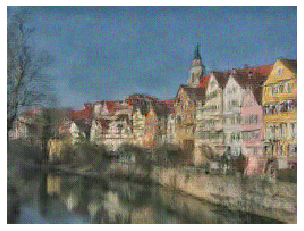

In [54]:
# Feature Inversion -- Starry Night + Tubingen
params_inv = {
    'content_image' : 'styles/tubingen.jpg',
    'style_image' : 'styles/starry_night.jpg',
    'image_size' : 192,
    'style_size' : 192,
    'content_layer' : 3,
    'content_weight' : 6e-2,
    'style_layers' : [1, 4, 6, 7],
    'style_weights' : [0, 0, 0, 0], # we discard any contributions from style to the loss
    'tv_weight' : 2e-2,
    'init_random': True # we want to initialize our image to be random
}

style_transfer(**params_inv)